In [1]:
import os, sys, random, math, re, time
import numpy as np
import cv2
import matplotlib
import matplotlib.pyplot as plt
from tqdm import tqdm
# Root directory of the project
ROOT_DIR = os.path.abspath("../../")

# Import Mask RCNN
sys.path.append(ROOT_DIR)  # To find local version of the library
from mrcnn.config import Config
from mrcnn import utils
import mrcnn.model as modellib
from mrcnn import visualize
from mrcnn.model import log

%matplotlib inline 

# Directory to save logs and trained model
MODEL_DIR = os.path.join(ROOT_DIR, "logs")

# Local path to trained weights file
COCO_MODEL_PATH = os.path.join(ROOT_DIR, "mask_rcnn_coco.h5")
# Download COCO trained weights from Releases if needed
if not os.path.exists(COCO_MODEL_PATH):
    utils.download_trained_weights(COCO_MODEL_PATH)

/usr/local/lib/python3.6/dist-packages/dask/config.py:168: YAMLLoadWarning: calling yaml.load() without Loader=... is deprecated, as the default Loader is unsafe. Please read https://msg.pyyaml.org/load for full details.
  data = yaml.load(f.read()) or {}
Using TensorFlow backend.


In [2]:
from shapes_mine import ShapesConfig, BrainDataset, read_datasets, get_model
config = ShapesConfig()
#config.display()

In [3]:
def get_ax(rows=1, cols=1, size=8):
    """Return a Matplotlib Axes array to be used in
    all visualizations in the notebook. Provide a
    central point to control graph sizes.
    
    Change the default size attribute to control the size
    of rendered images
    """
    _, ax = plt.subplots(rows, cols, figsize=(size*cols, size*rows))
    return ax

In [4]:
dataset_train, dataset_val, dataset_val_14 = read_datasets()

100%|██████████| 404/404 [00:00<00:00, 306308.54it/s]


In [5]:
def display_random_sample():
    # Load and display random samples
    image_ids = [140]
    for image_id in image_ids:
        image = dataset_train.load_image(image_id)
        mask, class_ids = dataset_train.load_mask(image_id)
        visualize.display_top_masks(image, mask, class_ids, dataset_train.class_names)
    return

In [6]:
model = get_model(init_with = "last", config=config, MODEL_DIR = MODEL_DIR,
                 COCO_MODEL_PATH=COCO_MODEL_PATH)

Instructions for updating:
Colocations handled automatically by placer.
Re-starting from epoch 8


## Training

Train in two stages:
1. Only the heads. Here we're freezing all the backbone layers and training only the randomly initialized layers (i.e. the ones that we didn't use pre-trained weights from MS COCO). To train only the head layers, pass `layers='heads'` to the `train()` function.

2. Fine-tune all layers. For this simple example it's not necessary, but we're including it to show the process. Simply pass `layers="all` to train all layers.

In [14]:
train(model=model, no_epochs=[4,8], dataset_train=dataset_train, dataset_val=dataset_val,
          MODEL_DIR=MODEL_DIR,config =config)


Starting at epoch 0. LR=0.001

Checkpoint Path: /mnt/sdb1/neuroinf/mask_rcnn_fork/Mask_RCNN/logs/shapes20190325T1726/mask_rcnn_shapes_{epoch:04d}.h5
Selecting layers to train
fpn_c5p5               (Conv2D)
fpn_c4p4               (Conv2D)
fpn_c3p3               (Conv2D)
fpn_c2p2               (Conv2D)
fpn_p5                 (Conv2D)
fpn_p2                 (Conv2D)
fpn_p3                 (Conv2D)
fpn_p4                 (Conv2D)
In model:  rpn_model
    rpn_conv_shared        (Conv2D)
    rpn_class_raw          (Conv2D)
    rpn_bbox_pred          (Conv2D)
mrcnn_mask_conv1       (TimeDistributed)
mrcnn_mask_bn1         (TimeDistributed)
mrcnn_mask_conv2       (TimeDistributed)
mrcnn_mask_bn2         (TimeDistributed)
mrcnn_class_conv1      (TimeDistributed)
mrcnn_class_bn1        (TimeDistributed)
mrcnn_mask_conv3       (TimeDistributed)
mrcnn_mask_bn3         (TimeDistributed)
mrcnn_class_conv2      (TimeDistributed)
mrcnn_class_bn2        (TimeDistributed)
mrcnn_mask_conv4       (TimeD

/usr/local/lib/python3.6/dist-packages/tensorflow/python/ops/gradients_impl.py:110: UserWarning: Converting sparse IndexedSlices to a dense Tensor of unknown shape. This may consume a large amount of memory.
  "Converting sparse IndexedSlices to a dense Tensor of unknown shape. "
/usr/local/lib/python3.6/dist-packages/keras/engine/training_generator.py:47: UserWarning: Using a generator with `use_multiprocessing=True` and multiple workers may duplicate your data. Please consider using the`keras.utils.Sequence class.
  UserWarning('Using a generator with `use_multiprocessing=True`'


Epoch 1/4
100/100 [==============================] - 1471s 15s/step - loss: 0.9739 - rpn_class_loss: 0.0351 - rpn_bbox_loss: 0.3769 - mrcnn_class_loss: 0.1615 - mrcnn_bbox_loss: 0.1779 - mrcnn_mask_loss: 0.2226 - val_loss: 0.3698 - val_rpn_class_loss: 0.0089 - val_rpn_bbox_loss: 0.1522 - val_mrcnn_class_loss: 0.0823 - val_mrcnn_bbox_loss: 0.0374 - val_mrcnn_mask_loss: 0.0889
Epoch 2/4
100/100 [==============================] - 1430s 14s/step - loss: 0.2401 - rpn_class_loss: 0.0075 - rpn_bbox_loss: 0.0456 - mrcnn_class_loss: 0.0809 - mrcnn_bbox_loss: 0.0352 - mrcnn_mask_loss: 0.0710 - val_loss: 0.2463 - val_rpn_class_loss: 0.0060 - val_rpn_bbox_loss: 0.0326 - val_mrcnn_class_loss: 0.1129 - val_mrcnn_bbox_loss: 0.0327 - val_mrcnn_mask_loss: 0.0621
Epoch 3/4
100/100 [==============================] - 1427s 14s/step - loss: 0.1736 - rpn_class_loss: 0.0052 - rpn_bbox_loss: 0.0221 - mrcnn_class_loss: 0.0657 - mrcnn_bbox_loss: 0.0212 - mrcnn_mask_loss: 0.0594 - val_loss: 0.1331 - val_rpn_clas

## Detection

In [9]:
from shapes_mine import InferenceConfig, load_inference_model

inference_config = InferenceConfig()
model = load_inference_model(inference_config=inference_config, MODEL_DIR=MODEL_DIR)

Loading weights from  /mnt/sdb1/neuroinf/mask_rcnn_fork/Mask_RCNN/logs/shapes20190325T1726/mask_rcnn_shapes_0008.h5
Re-starting from epoch 8


original_image           shape: (128, 128, 3)         min:    0.00000  max:   74.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (2,)                  min:    1.00000  max:    2.00000  int32
gt_bbox                  shape: (2, 4)                min:   13.00000  max:   94.00000  int32
gt_mask                  shape: (128, 128, 2)         min:    0.00000  max:    1.00000  bool


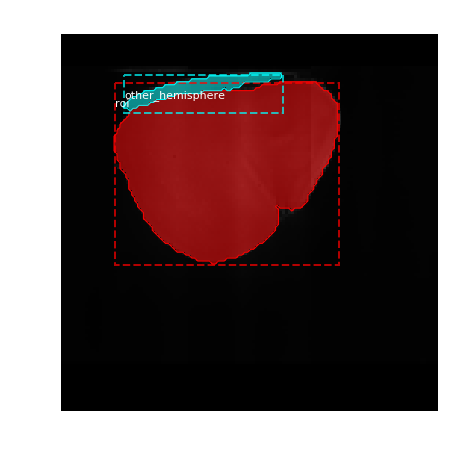

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   74.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -29.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


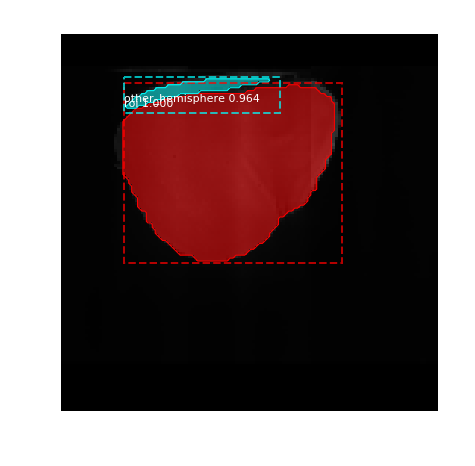

In [12]:
# Test on a random image
def test_no_random_val_image(dataset_val=None, dataset_train=None,
                            inference_config=None):
    image_id = random.choice(dataset_val.image_ids)
    original_image, image_meta, gt_class_id, gt_bbox, gt_mask =\
    modellib.load_image_gt(dataset_val, inference_config, 
                           image_id, use_mini_mask=False)
    log("original_image", original_image)
    log("image_meta", image_meta)
    log("gt_class_id", gt_class_id)
    log("gt_bbox", gt_bbox)
    log("gt_mask", gt_mask)
    visualize.display_instances(original_image, gt_bbox, gt_mask, gt_class_id, 
                            dataset_train.class_names, figsize=(8, 8))
    results = model.detect([original_image], verbose=1)
    r = results[0]
    visualize.display_instances(original_image, r['rois'], r['masks'], r['class_ids'], 
                            dataset_val.class_names, r['scores'], ax=get_ax())
    return

test_no_random_val_image(dataset_val=dataset_val, dataset_train=dataset_train,
    inference_config=inference_config)

In [22]:
dataset_val_14.image_ids

array([  0,   1,   2,   3,   4,   5,   6,   7,   8,   9,  10,  11,  12,
        13,  14,  15,  16,  17,  18,  19,  20,  21,  22,  23,  24,  25,
        26,  27,  28,  29,  30,  31,  32,  33,  34,  35,  36,  37,  38,
        39,  40,  41,  42,  43,  44,  45,  46,  47,  48,  49,  50,  51,
        52,  53,  54,  55,  56,  57,  58,  59,  60,  61,  62,  63,  64,
        65,  66,  67,  68,  69,  70,  71,  72,  73,  74,  75,  76,  77,
        78,  79,  80,  81,  82,  83,  84,  85,  86,  87,  88,  89,  90,
        91,  92,  93,  94,  95,  96,  97,  98,  99, 100, 101, 102, 103,
       104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116,
       117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129,
       130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142,
       143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155,
       156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168,
       169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 18

  0%|          | 0/404 [00:00<?, ?it/s]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   81.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


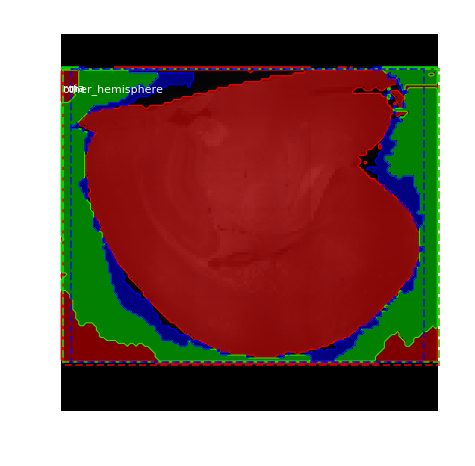

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   81.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -22.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


  0%|          | 1/404 [00:01<11:39,  1.74s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   84.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  342.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


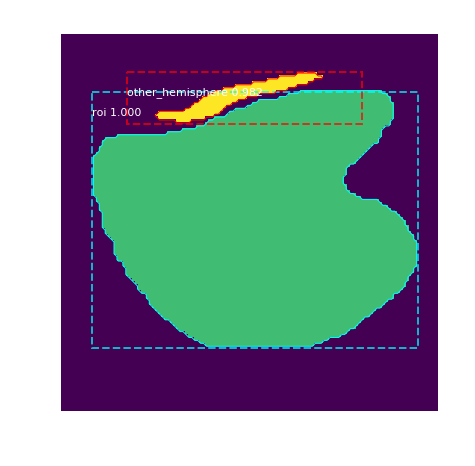

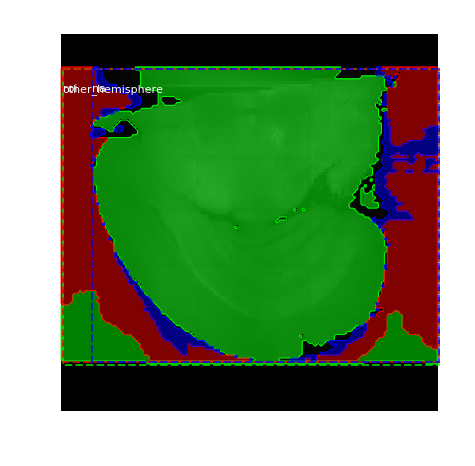

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   84.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -19.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


  0%|          | 2/404 [00:03<11:46,  1.76s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   70.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


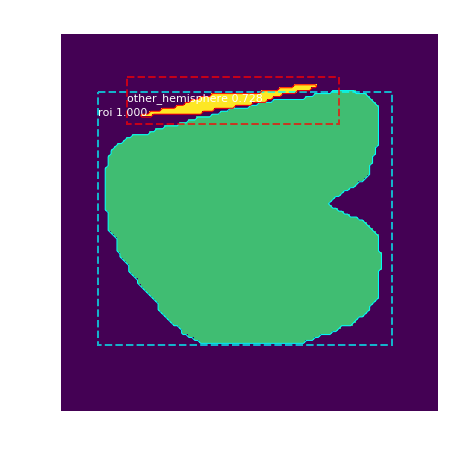

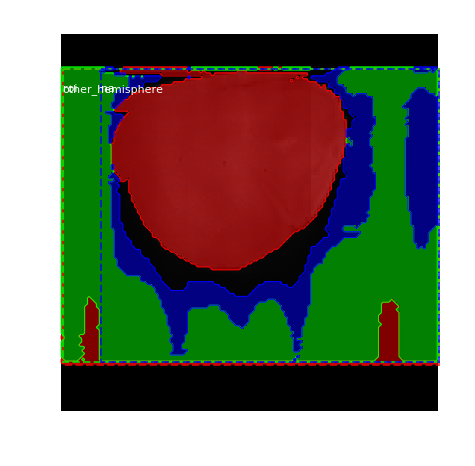

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   70.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -33.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


  1%|          | 3/404 [00:05<12:02,  1.80s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   82.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


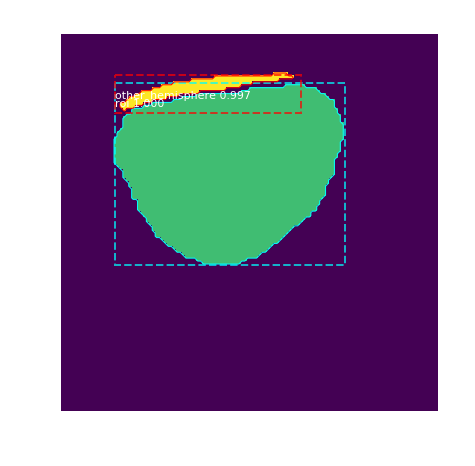

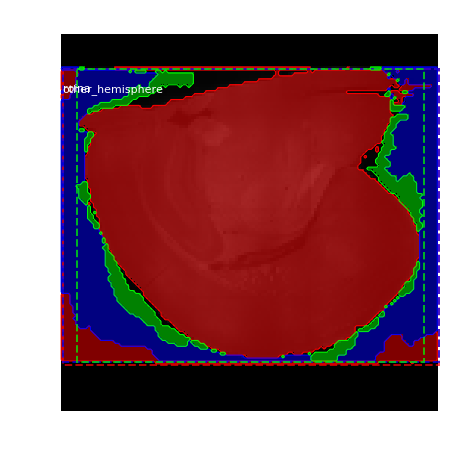

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   82.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -21.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


  1%|          | 4/404 [00:07<12:00,  1.80s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   55.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


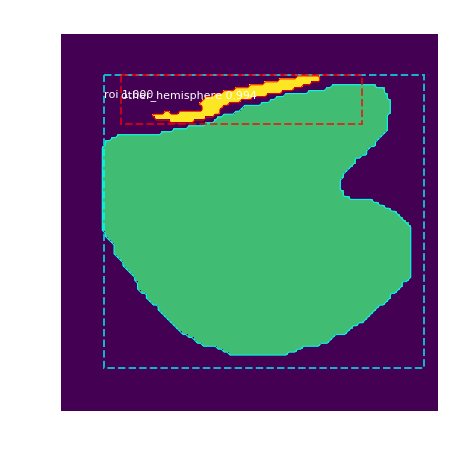

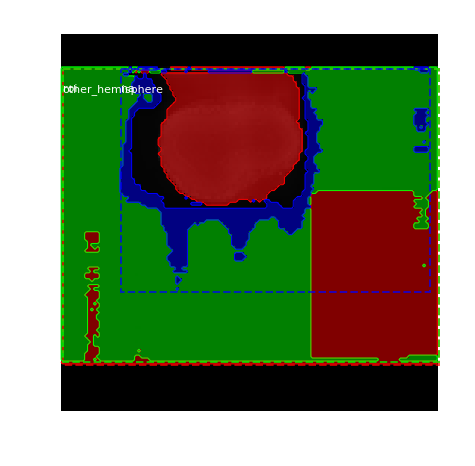

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   55.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -48.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


  1%|          | 5/404 [00:09<12:06,  1.82s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   60.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


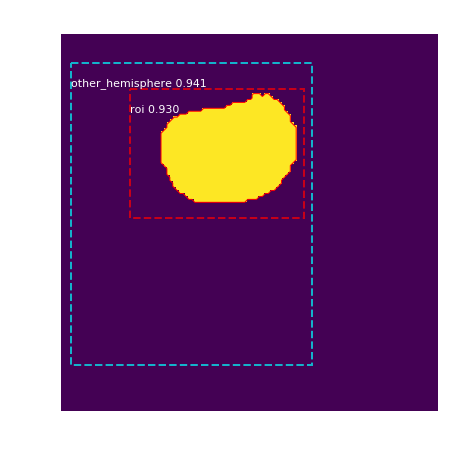

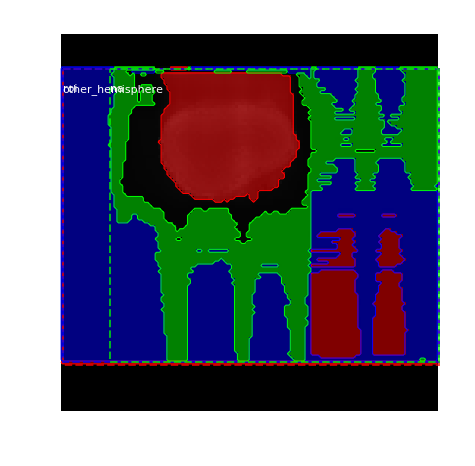

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   60.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -43.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


  1%|▏         | 6/404 [00:10<11:56,  1.80s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   55.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


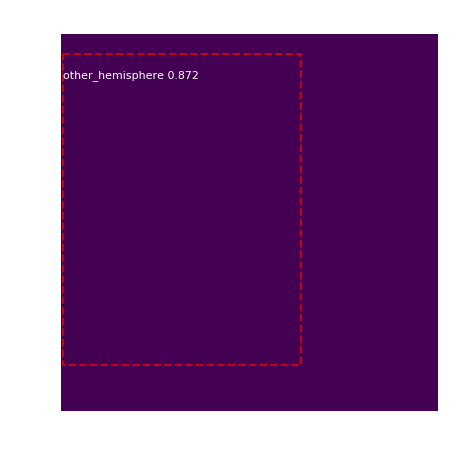

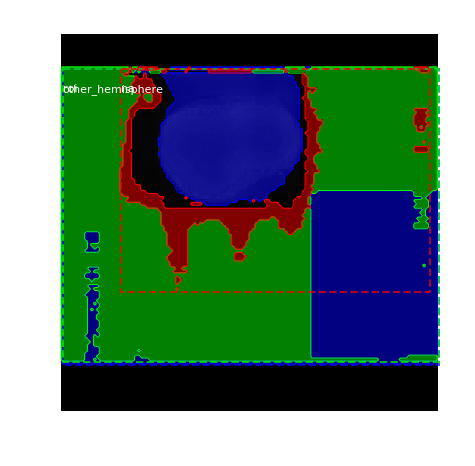

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   55.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -48.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


  2%|▏         | 7/404 [00:12<11:52,  1.79s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   72.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


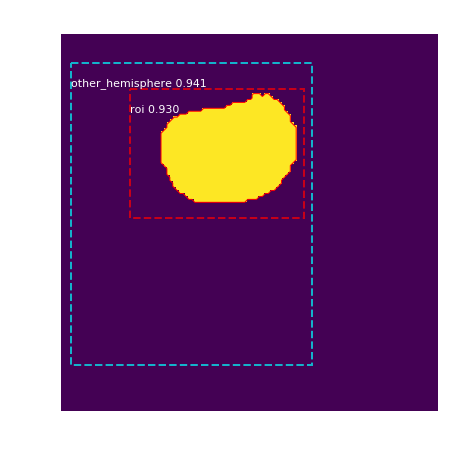

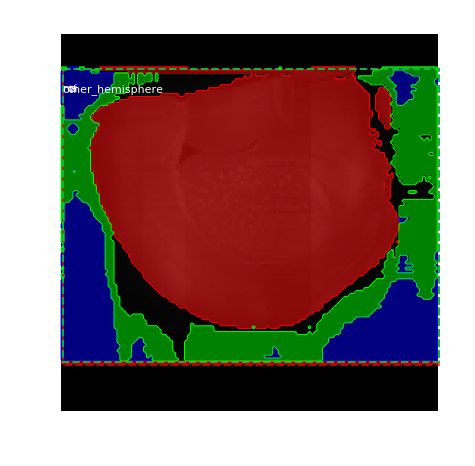

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   72.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -31.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


  2%|▏         | 8/404 [00:14<11:58,  1.81s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   72.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


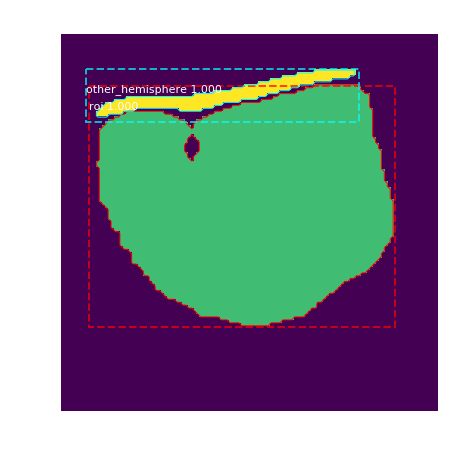

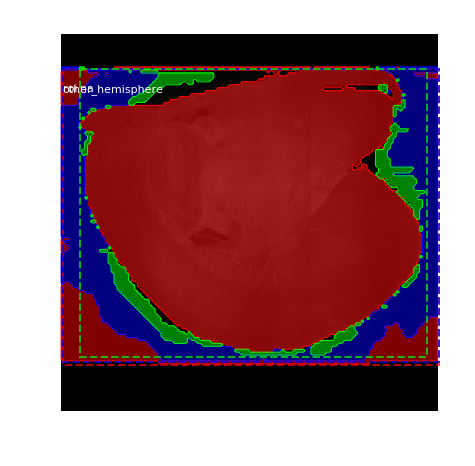

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   72.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -31.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


  2%|▏         | 9/404 [00:16<11:39,  1.77s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:  100.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  320.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


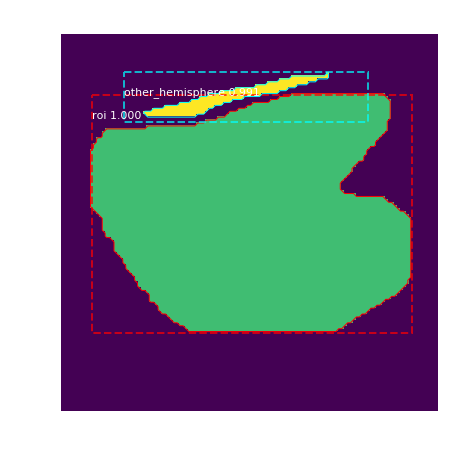

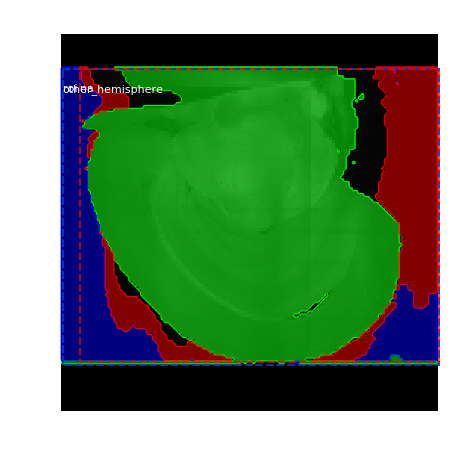

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:  100.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:   -3.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


  2%|▏         | 10/404 [00:17<11:28,  1.75s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   83.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  360.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


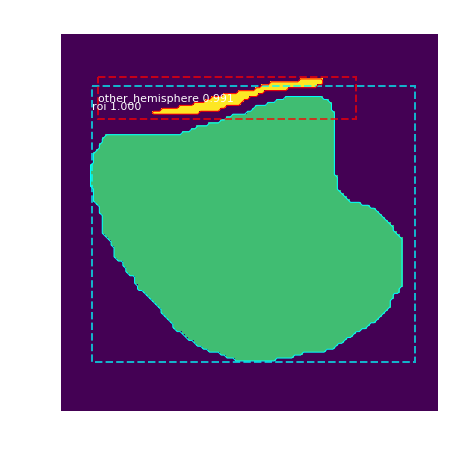

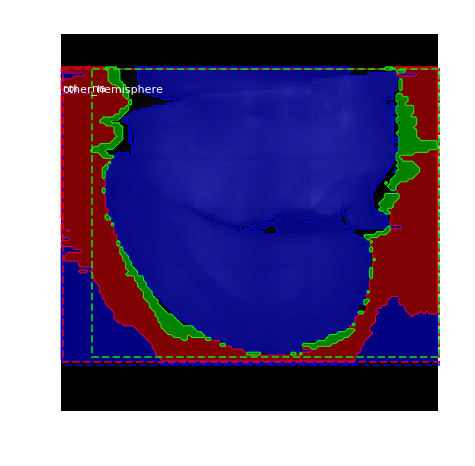

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   83.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -20.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


  3%|▎         | 11/404 [00:19<11:21,  1.73s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   72.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


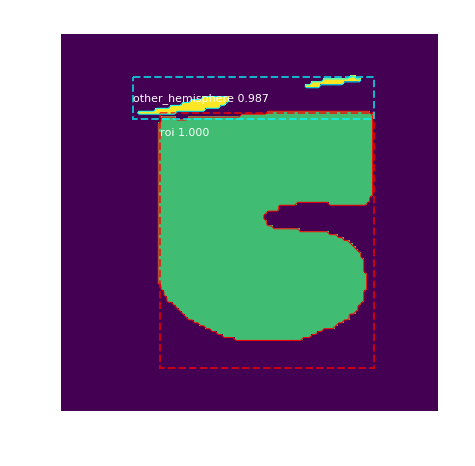

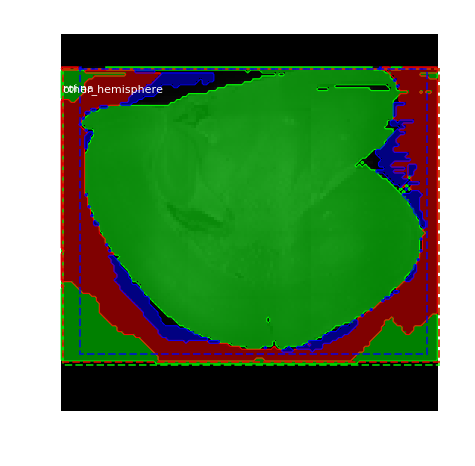

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   72.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -31.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


  3%|▎         | 12/404 [00:21<11:24,  1.75s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   55.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


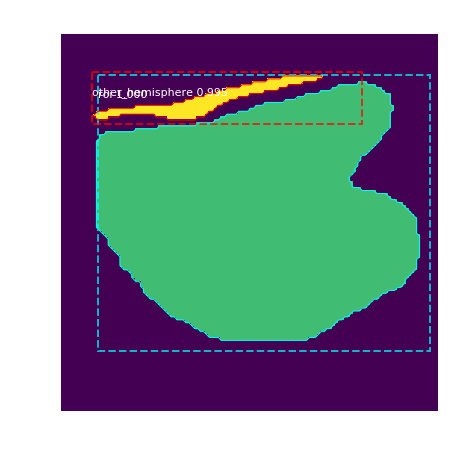

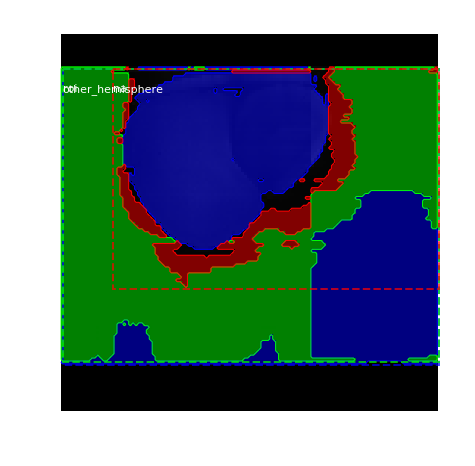

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   55.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -48.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


  3%|▎         | 13/404 [00:23<11:21,  1.74s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   64.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


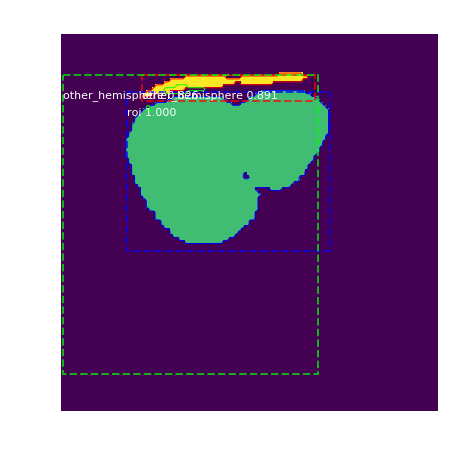

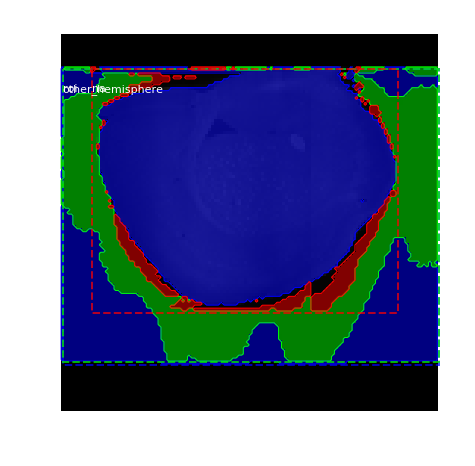

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   64.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -39.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


  3%|▎         | 14/404 [00:24<11:07,  1.71s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   61.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


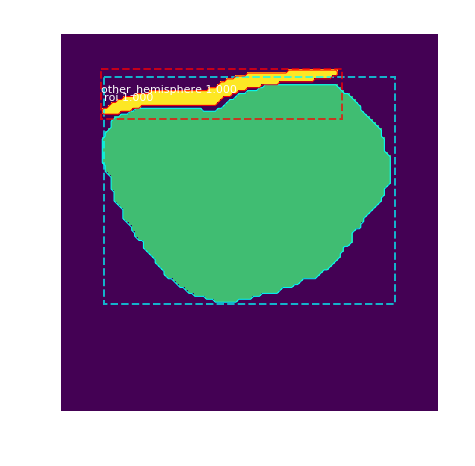

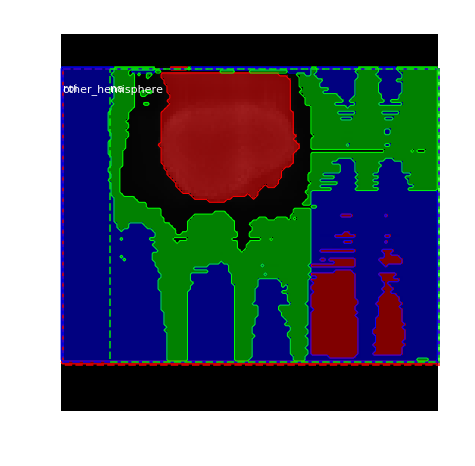

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   61.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -42.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


  4%|▎         | 15/404 [00:26<11:03,  1.71s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   55.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


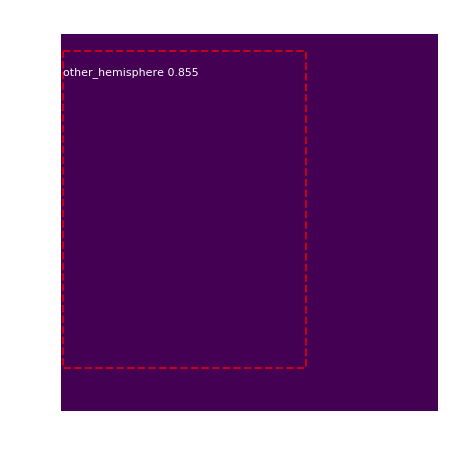

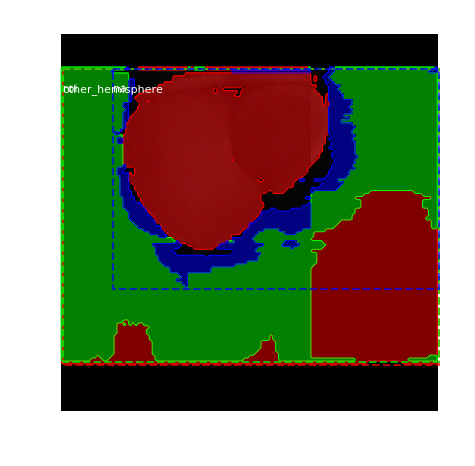

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   55.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -48.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


  4%|▍         | 16/404 [00:28<10:49,  1.67s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   99.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  327.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


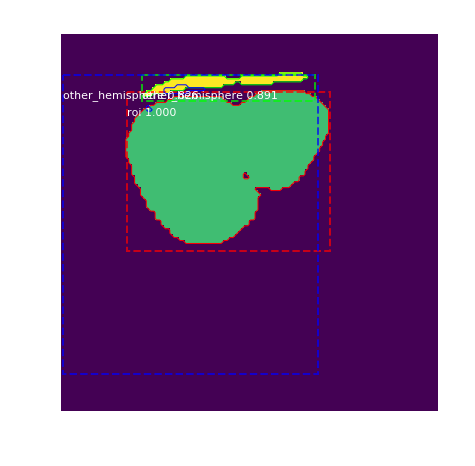

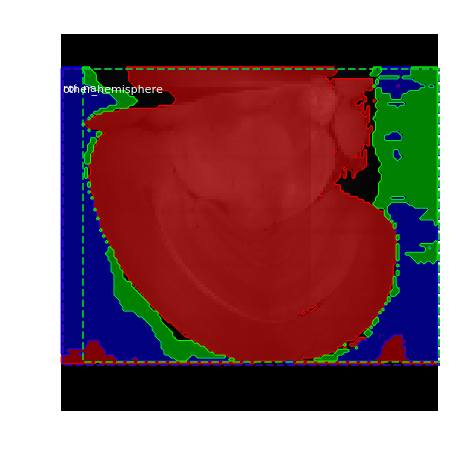

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   99.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:   -4.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


  4%|▍         | 17/404 [00:29<10:54,  1.69s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   46.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


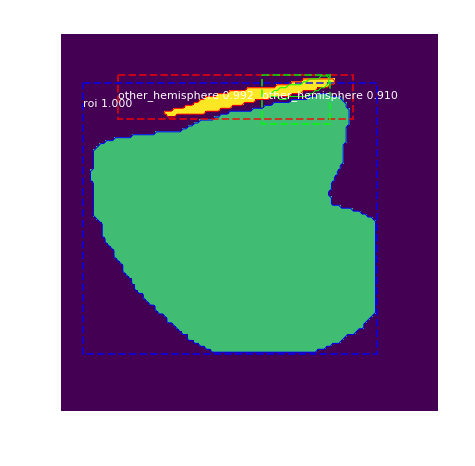

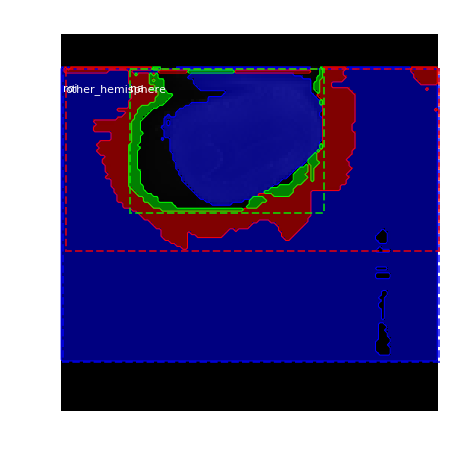

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   46.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -57.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


  4%|▍         | 18/404 [00:31<10:46,  1.67s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   68.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


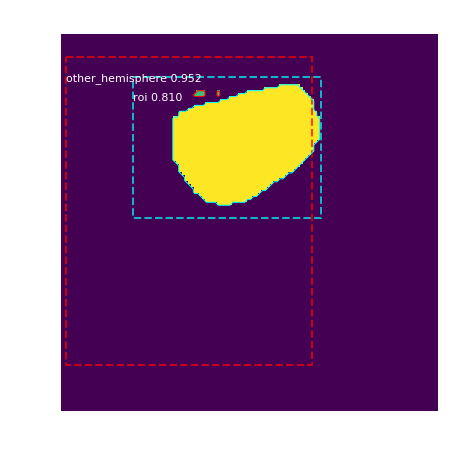

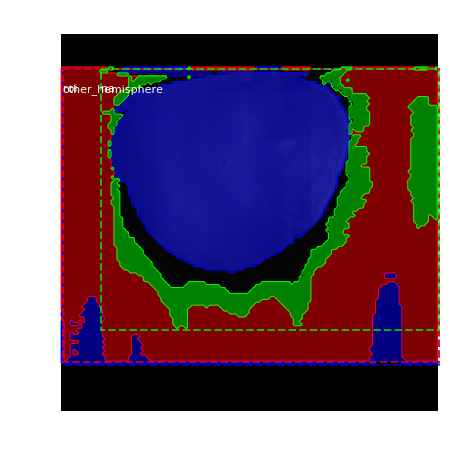

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   68.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -35.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


  5%|▍         | 19/404 [00:33<10:39,  1.66s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   45.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


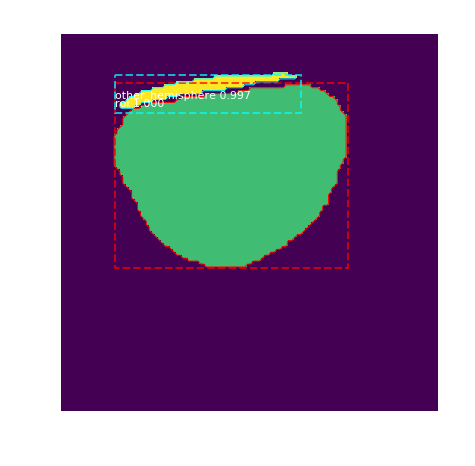

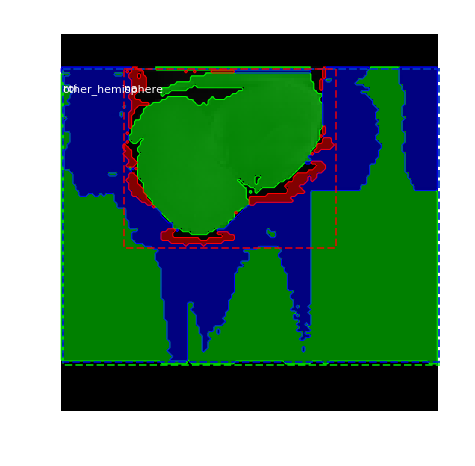

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   45.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -58.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


  5%|▍         | 20/404 [00:34<10:32,  1.65s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   66.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


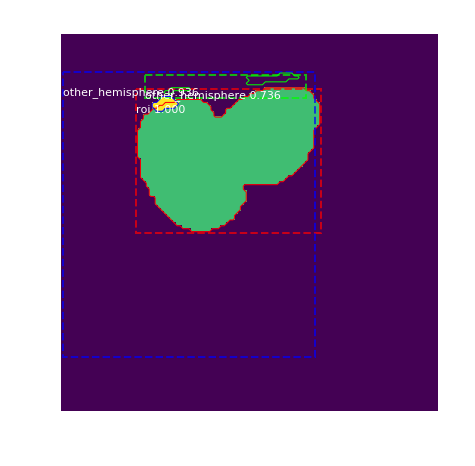

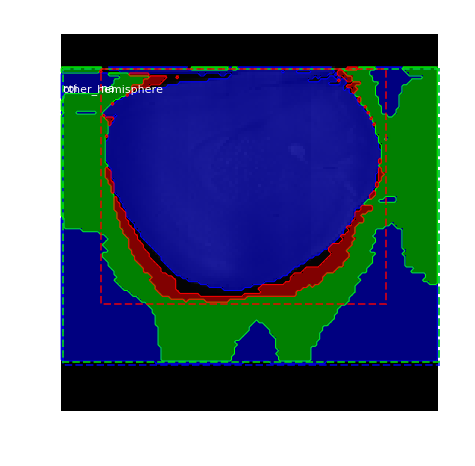

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   66.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -37.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


  5%|▌         | 21/404 [00:36<10:39,  1.67s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   86.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


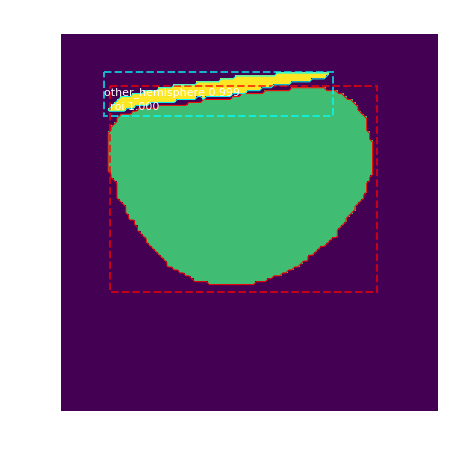

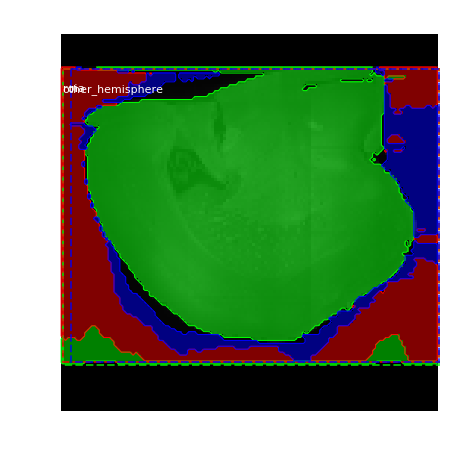

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   86.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -17.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


  5%|▌         | 22/404 [00:38<10:53,  1.71s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:  105.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  312.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


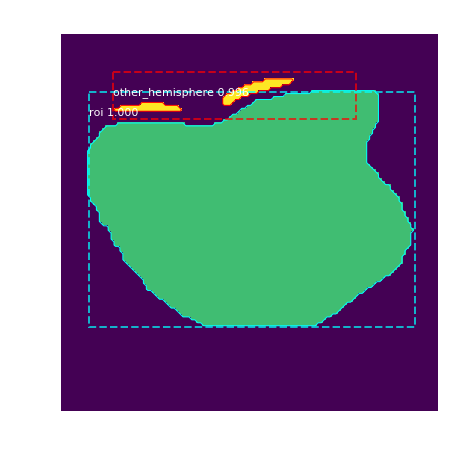

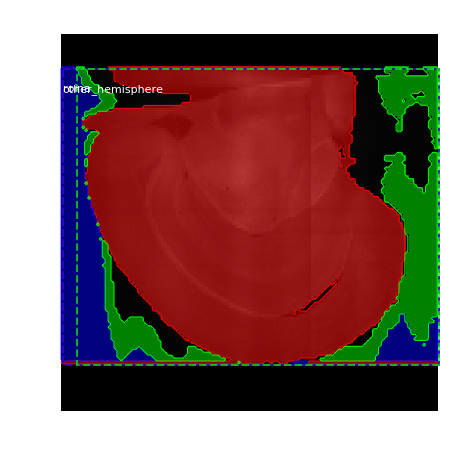

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:  105.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:    1.10000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


  6%|▌         | 23/404 [00:39<11:05,  1.75s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   73.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


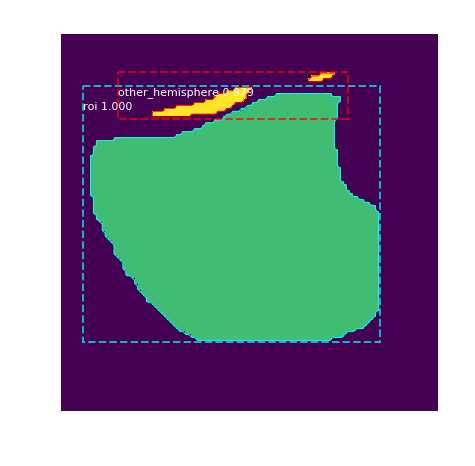

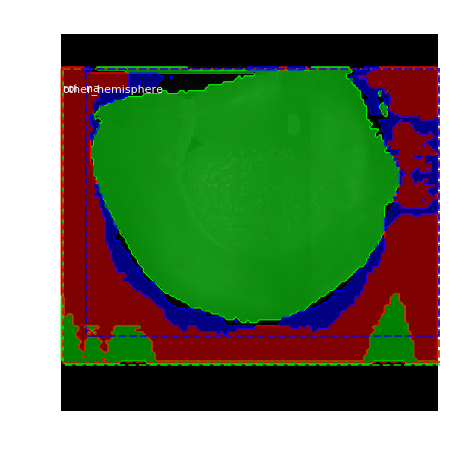

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   73.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -30.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


  6%|▌         | 24/404 [00:41<10:58,  1.73s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   51.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


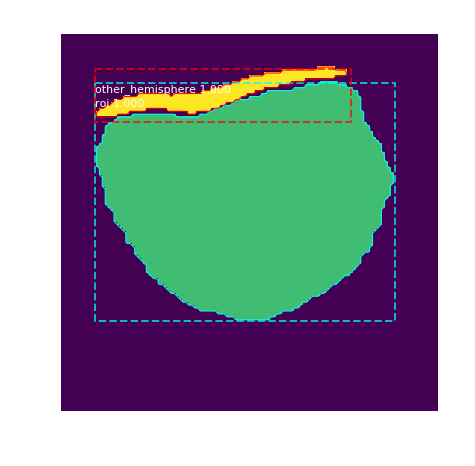

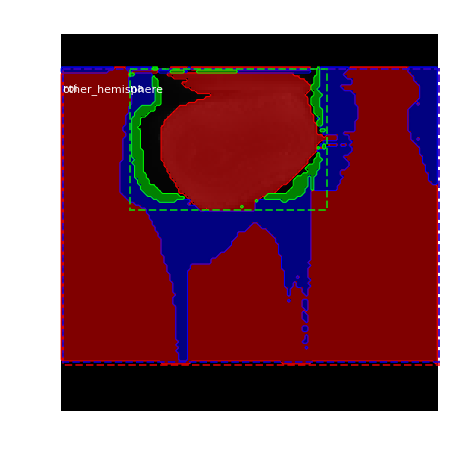

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   51.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -52.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


  6%|▌         | 25/404 [00:43<11:23,  1.80s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   51.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


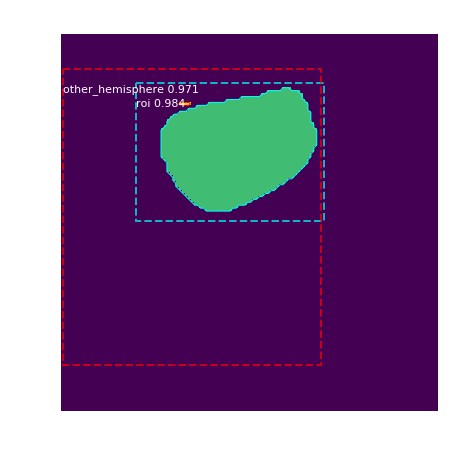

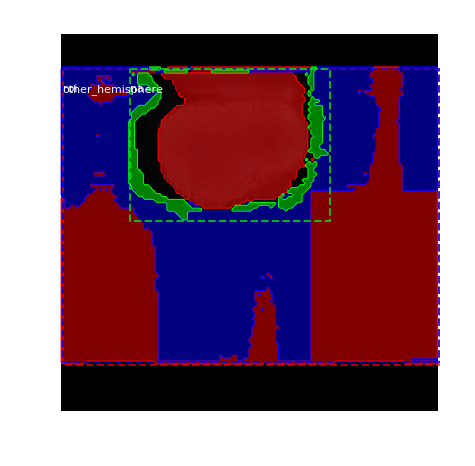

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   51.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -52.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


  6%|▋         | 26/404 [00:45<11:39,  1.85s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   75.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  287.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


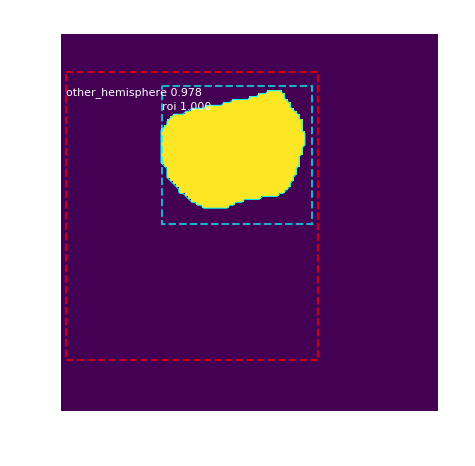

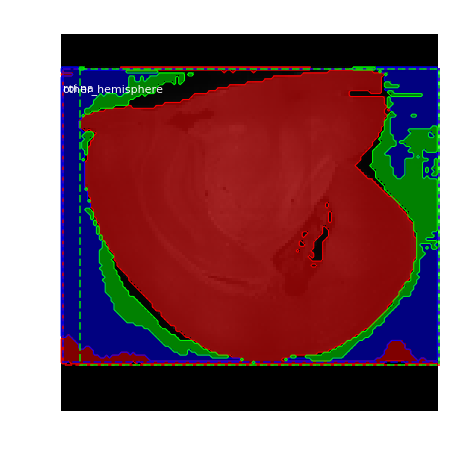

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   75.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -28.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


  7%|▋         | 27/404 [00:47<11:54,  1.90s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   81.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  281.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


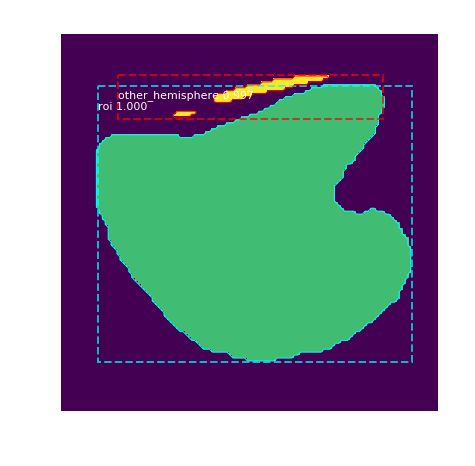

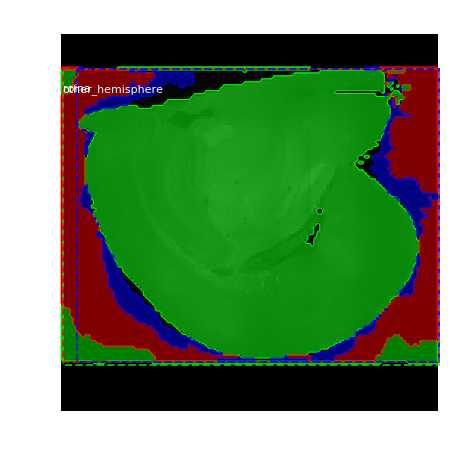

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   81.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -22.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


  7%|▋         | 28/404 [00:49<11:43,  1.87s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   77.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  369.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


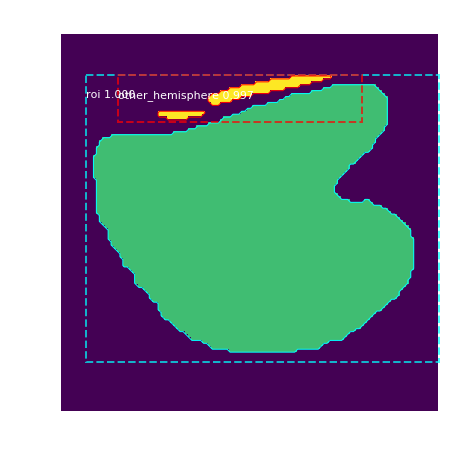

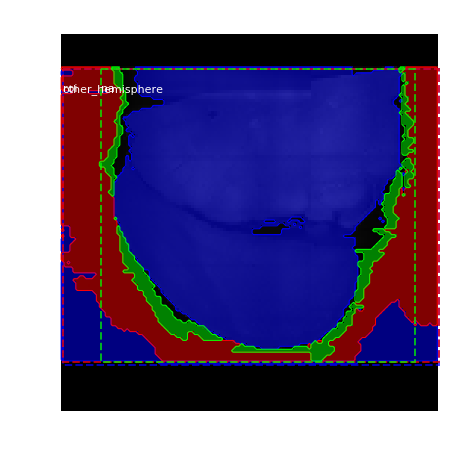

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   77.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -26.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


  7%|▋         | 29/404 [00:51<11:42,  1.87s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   70.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  367.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


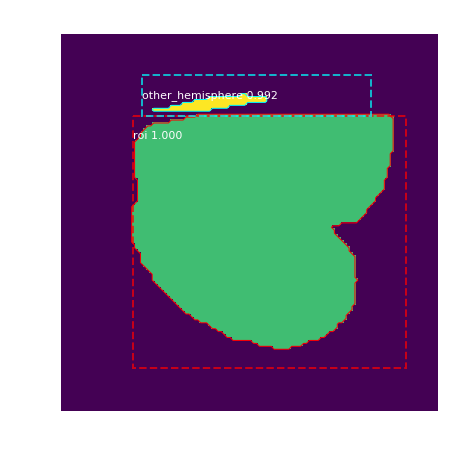

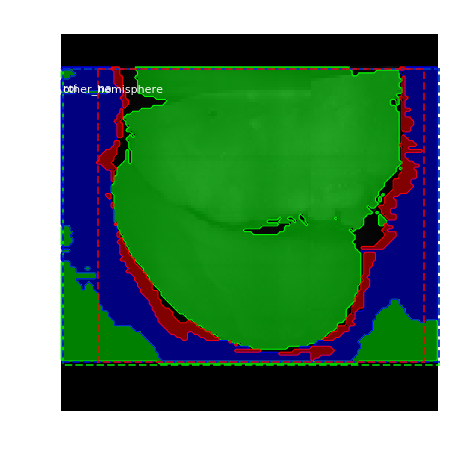

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   70.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -33.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


  7%|▋         | 30/404 [00:53<11:28,  1.84s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   76.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  348.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


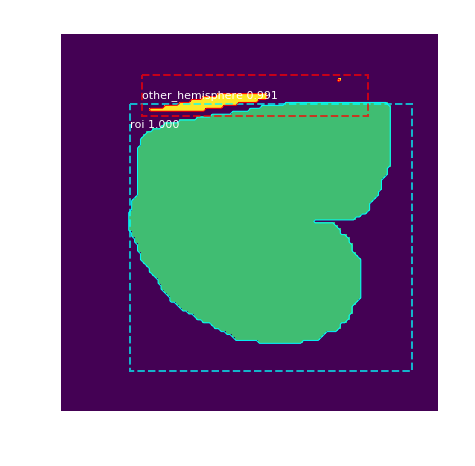

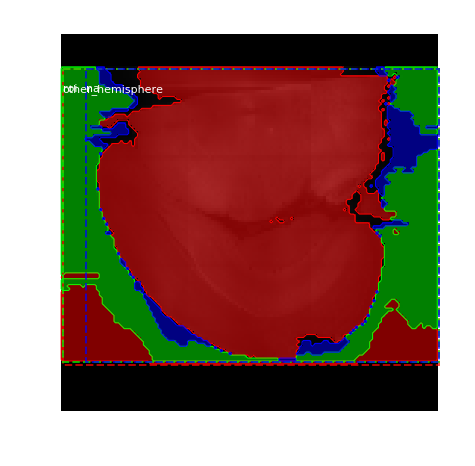

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   76.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -27.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


  8%|▊         | 31/404 [00:54<11:20,  1.82s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   68.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


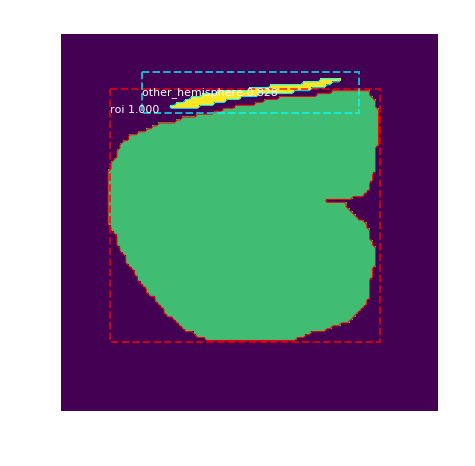

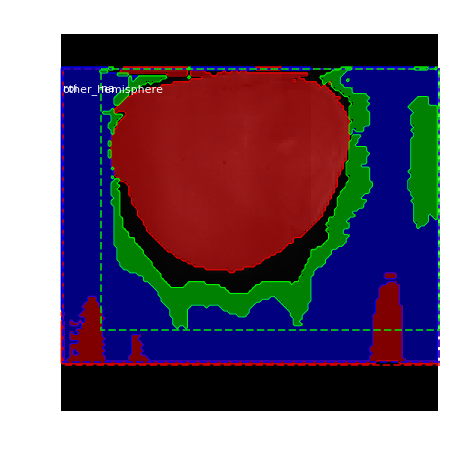

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   68.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -35.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


  8%|▊         | 32/404 [00:56<11:00,  1.78s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   70.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


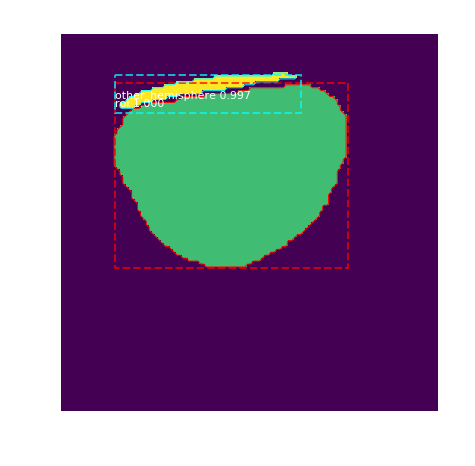

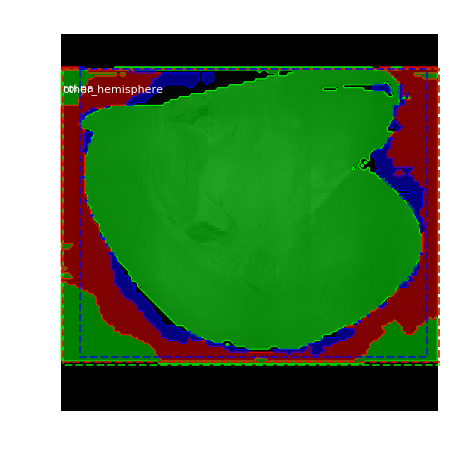

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   70.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -33.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


  8%|▊         | 33/404 [00:58<11:00,  1.78s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   89.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  383.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


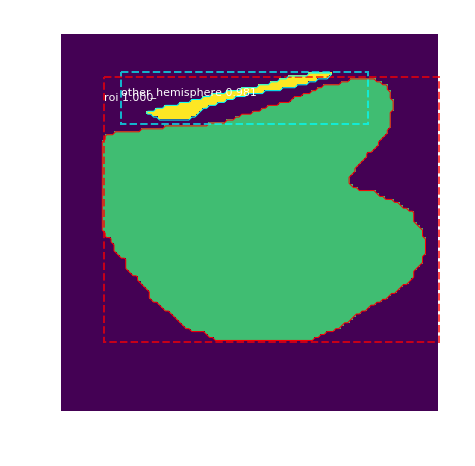

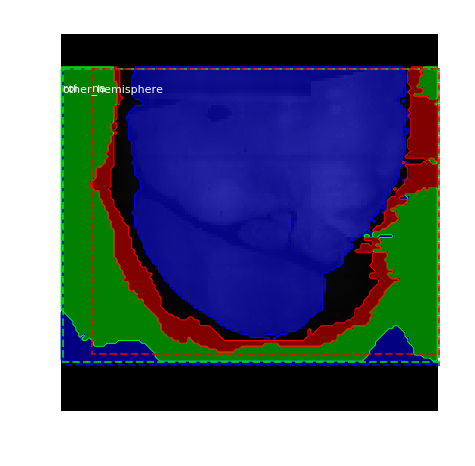

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   89.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -14.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


  8%|▊         | 34/404 [01:00<10:51,  1.76s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   99.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  327.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


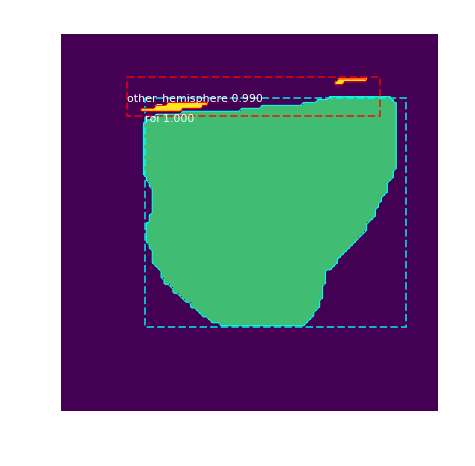

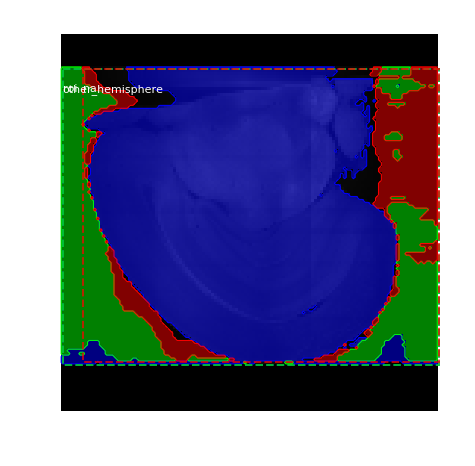

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   99.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:   -4.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


  9%|▊         | 35/404 [01:02<11:16,  1.83s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   51.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


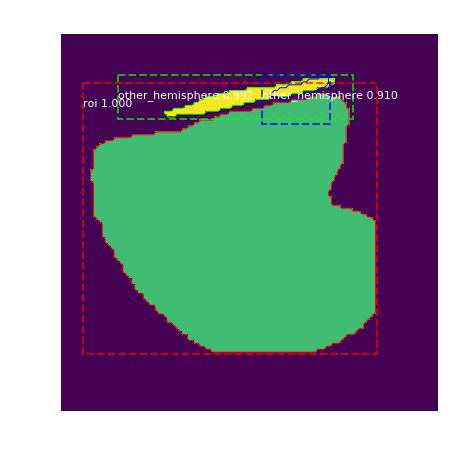

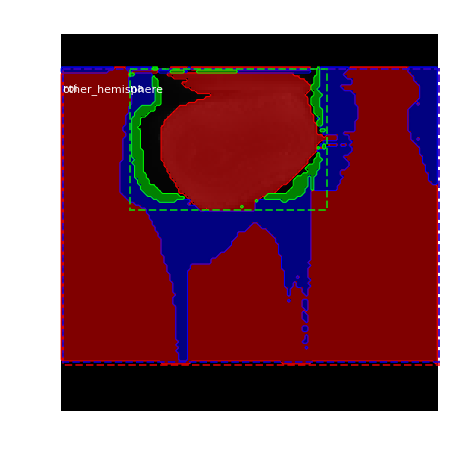

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   51.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -52.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


  9%|▉         | 36/404 [01:04<12:01,  1.96s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   86.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


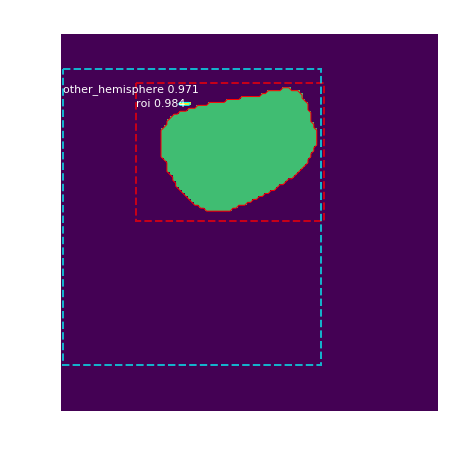

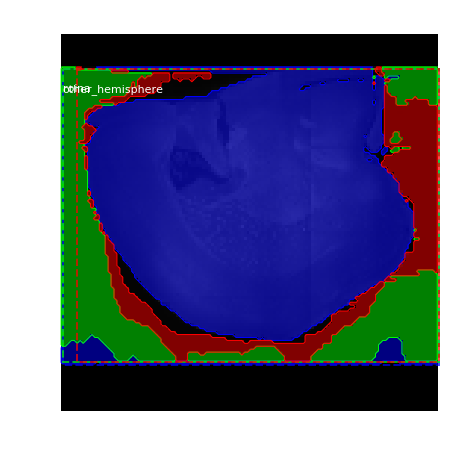

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   86.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -17.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


  9%|▉         | 37/404 [01:06<12:04,  1.97s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   76.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  348.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


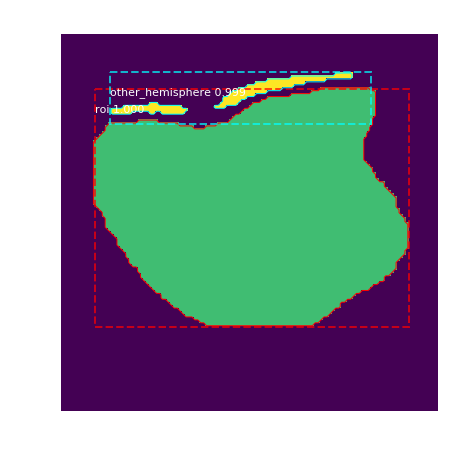

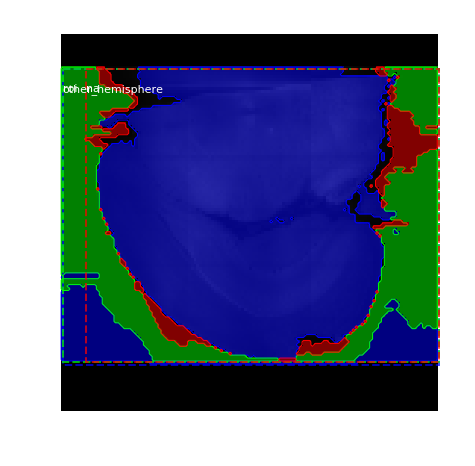

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   76.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -27.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


  9%|▉         | 38/404 [01:08<12:05,  1.98s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   93.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  399.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


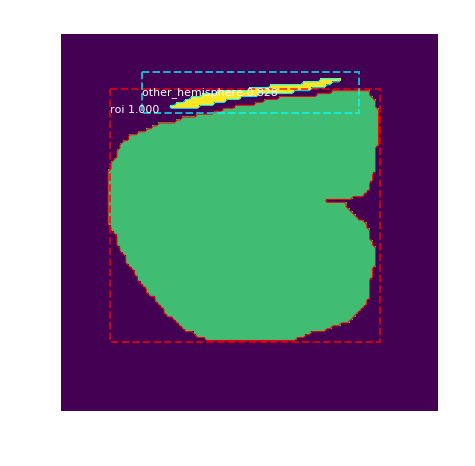

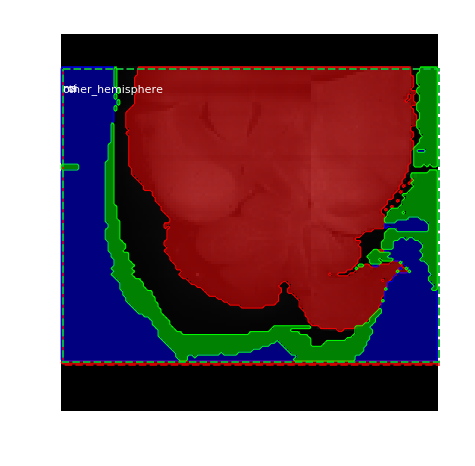

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   93.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -10.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 10%|▉         | 39/404 [01:10<12:24,  2.04s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   55.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


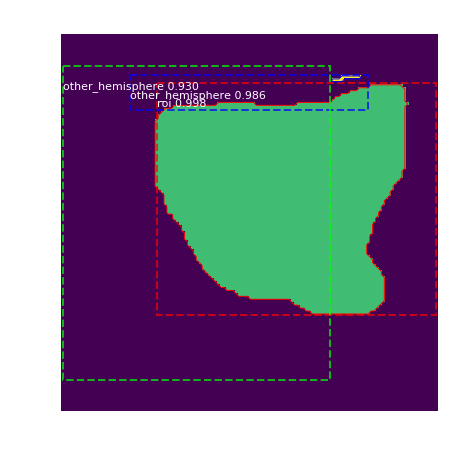

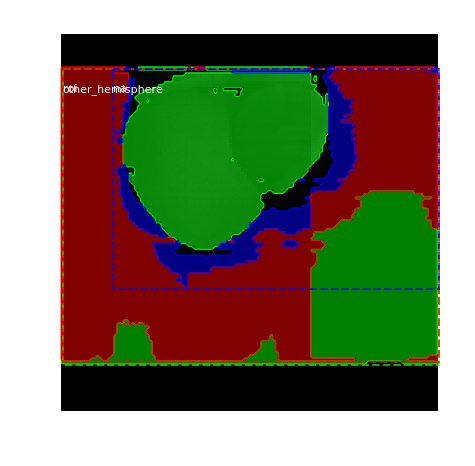

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   55.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -48.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 10%|▉         | 40/404 [01:12<11:38,  1.92s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   73.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  291.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


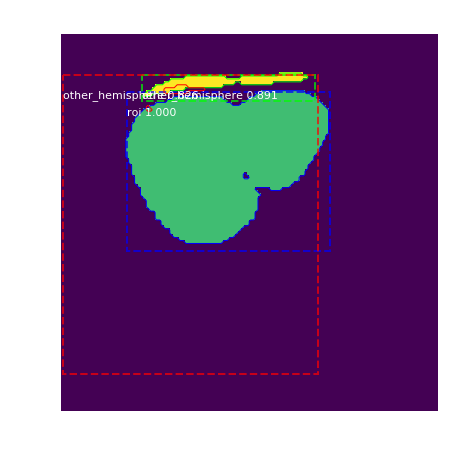

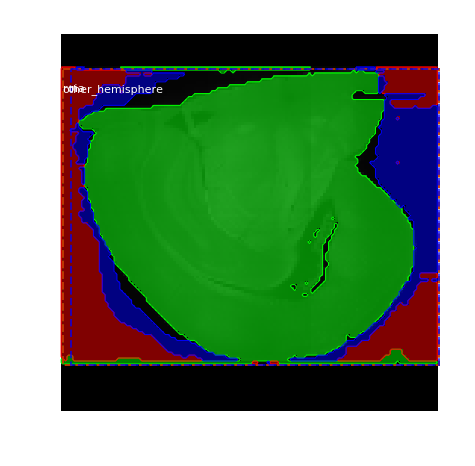

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   73.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -30.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 10%|█         | 41/404 [01:13<11:31,  1.90s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   87.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  343.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


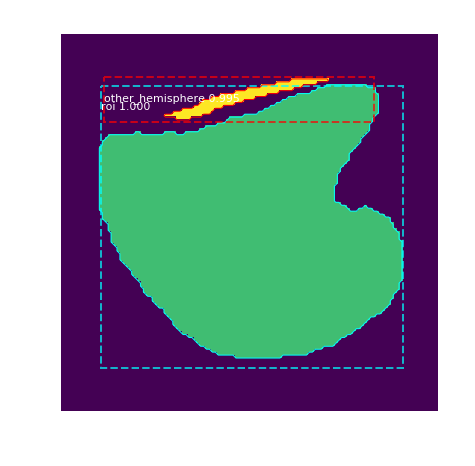

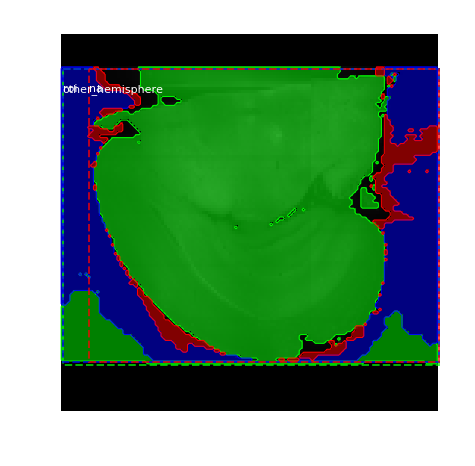

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   87.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -16.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 10%|█         | 42/404 [01:15<10:57,  1.82s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   53.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


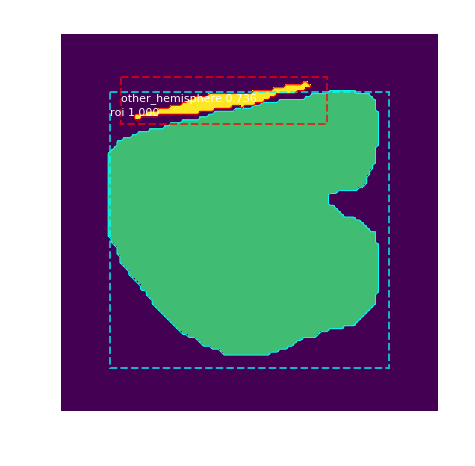

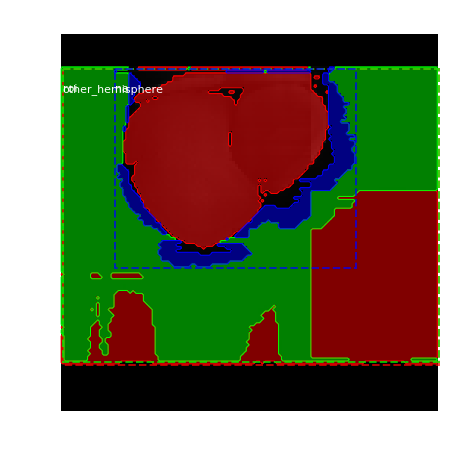

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   53.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -50.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 11%|█         | 43/404 [01:17<10:51,  1.80s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   47.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


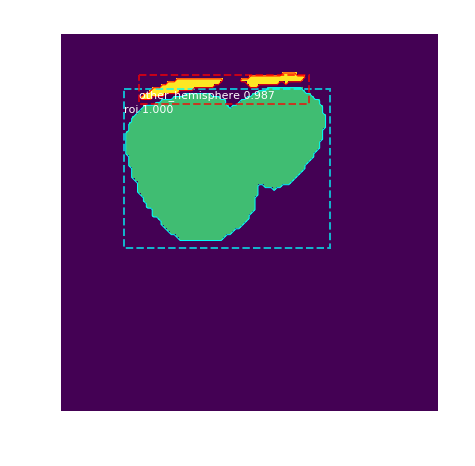

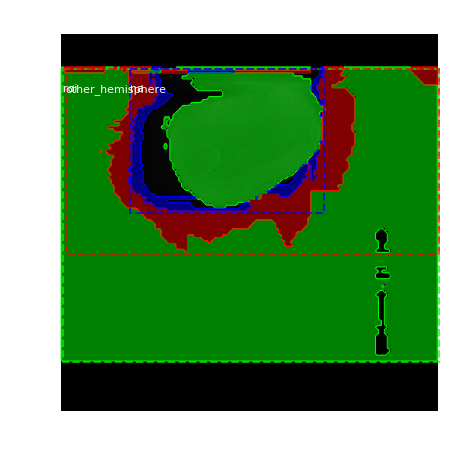

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   47.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -56.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 11%|█         | 44/404 [01:19<10:32,  1.76s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   58.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


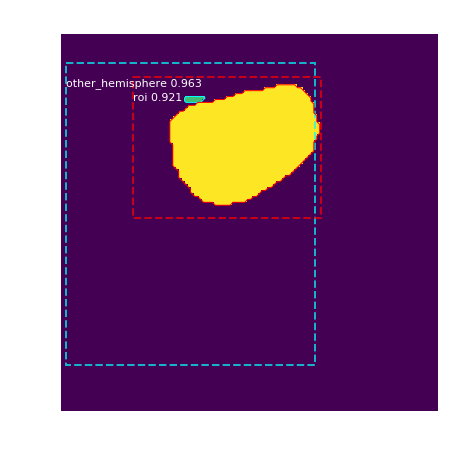

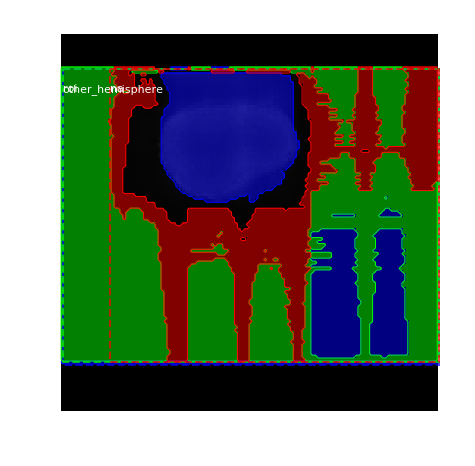

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   58.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -45.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 11%|█         | 45/404 [01:20<10:21,  1.73s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   76.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  285.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


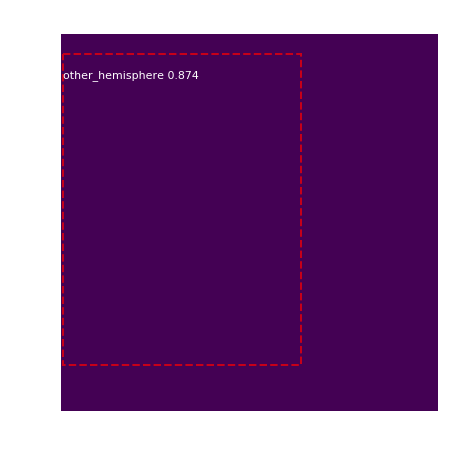

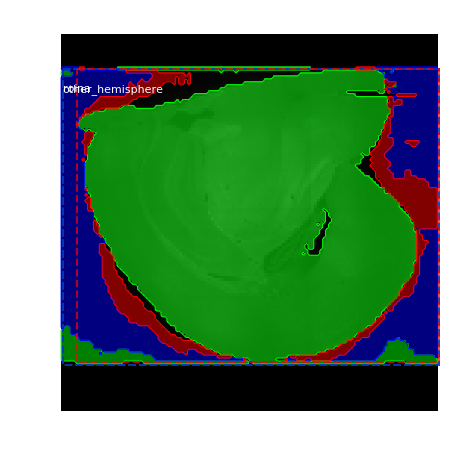

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   76.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -27.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 11%|█▏        | 46/404 [01:22<10:18,  1.73s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   44.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


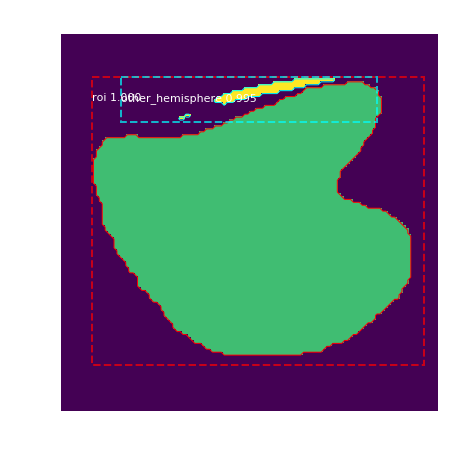

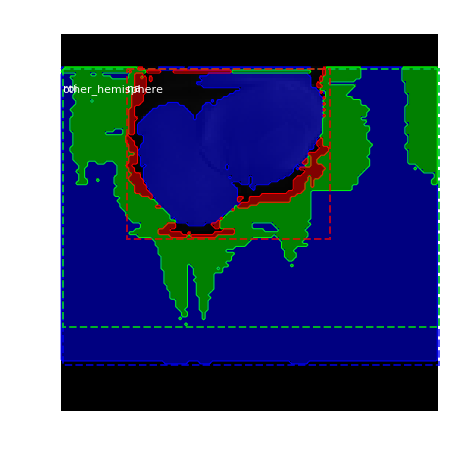

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   44.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -59.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 12%|█▏        | 47/404 [01:24<10:08,  1.70s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   46.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


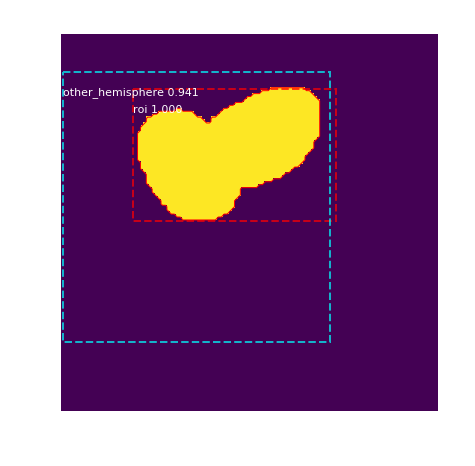

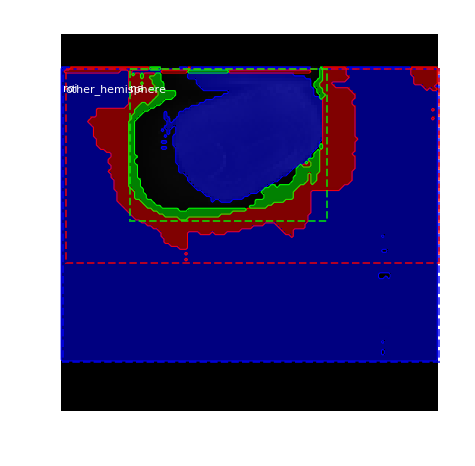

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   46.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -57.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 12%|█▏        | 48/404 [01:25<09:53,  1.67s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   49.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


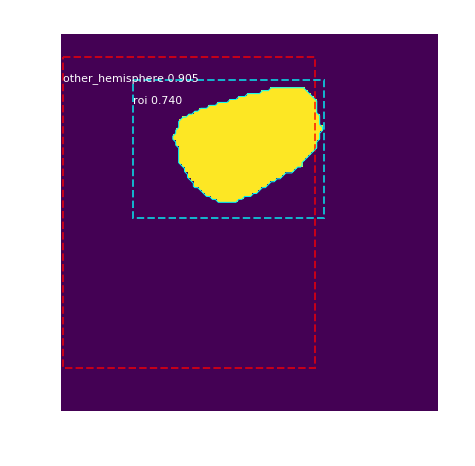

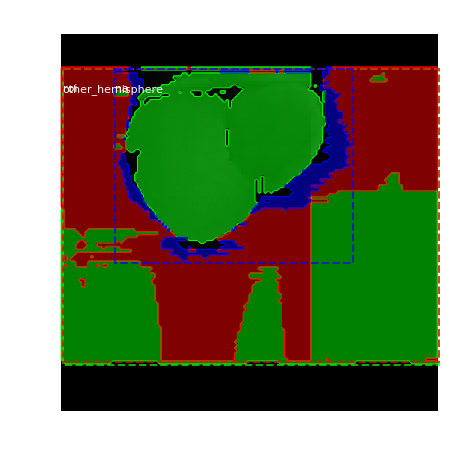

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   49.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -54.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 12%|█▏        | 49/404 [01:27<09:50,  1.66s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   53.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


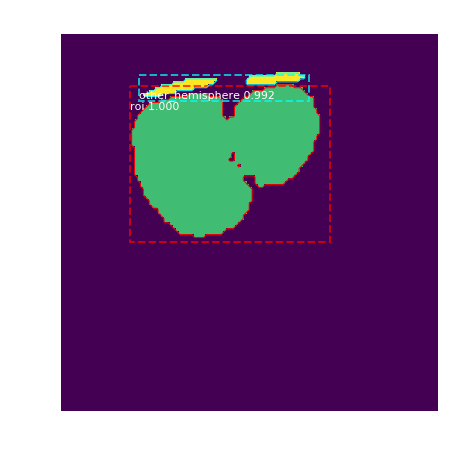

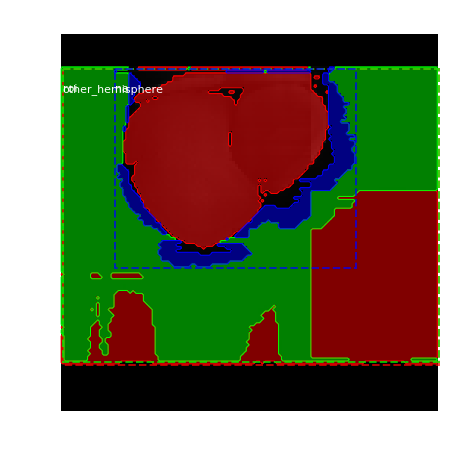

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   53.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -50.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 12%|█▏        | 50/404 [01:28<09:46,  1.66s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   50.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


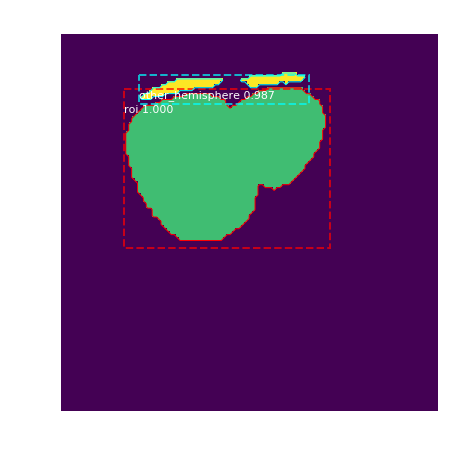

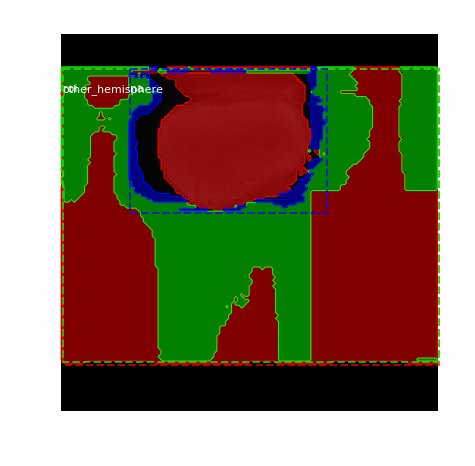

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   50.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -53.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 13%|█▎        | 51/404 [01:30<09:41,  1.65s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   72.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


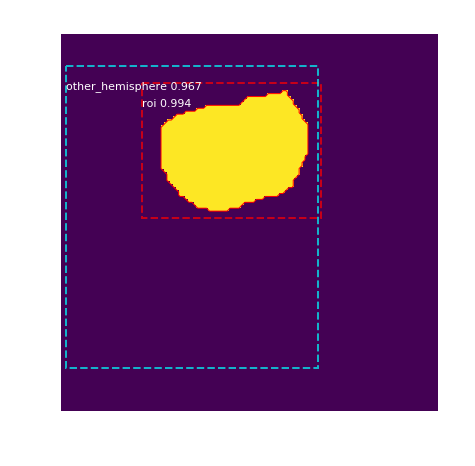

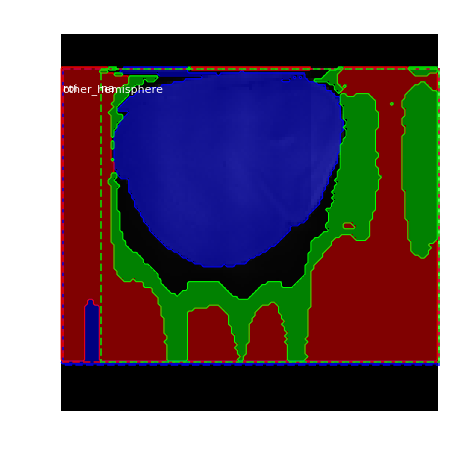

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   72.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -31.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 13%|█▎        | 52/404 [01:32<09:35,  1.64s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   68.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


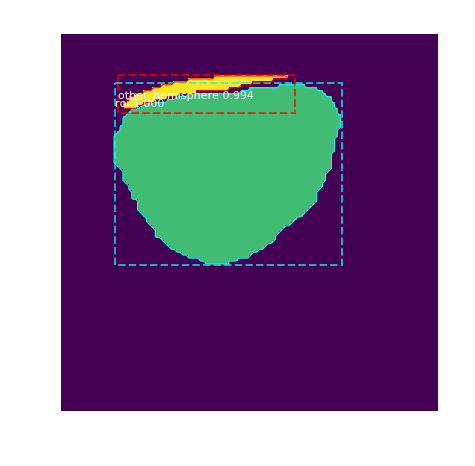

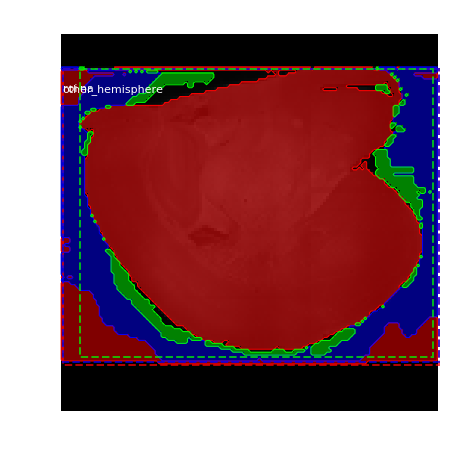

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   68.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -35.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 13%|█▎        | 53/404 [01:33<09:49,  1.68s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   46.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


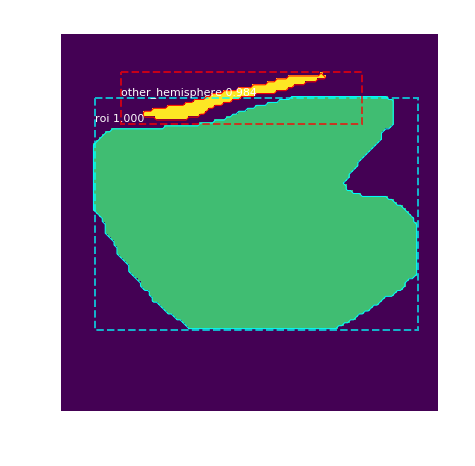

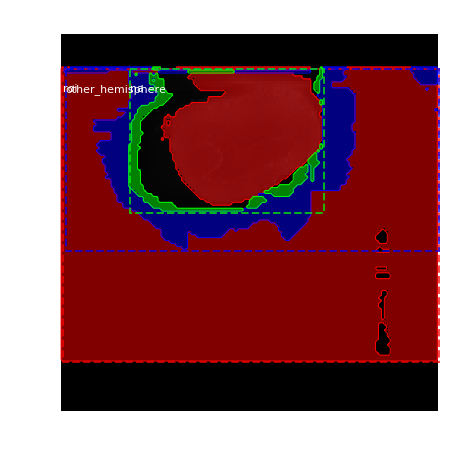

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   46.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -57.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 13%|█▎        | 54/404 [01:35<09:41,  1.66s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   68.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


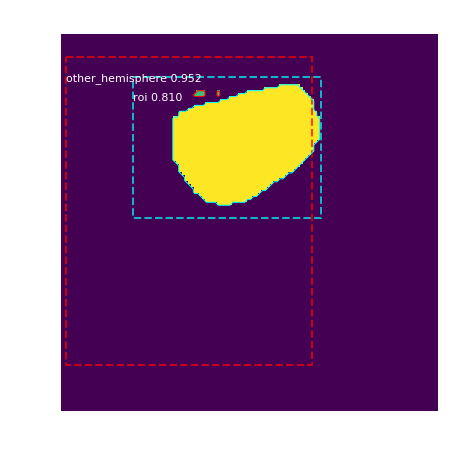

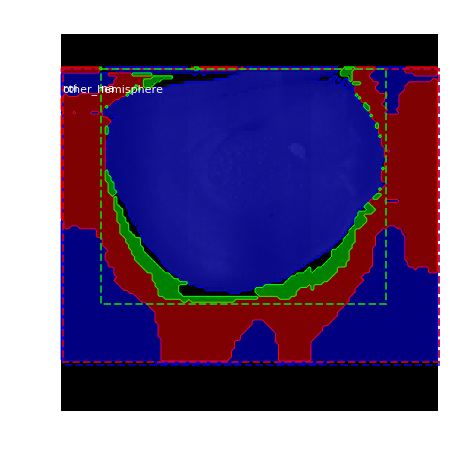

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   68.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -35.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 14%|█▎        | 55/404 [01:37<09:53,  1.70s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   76.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  371.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


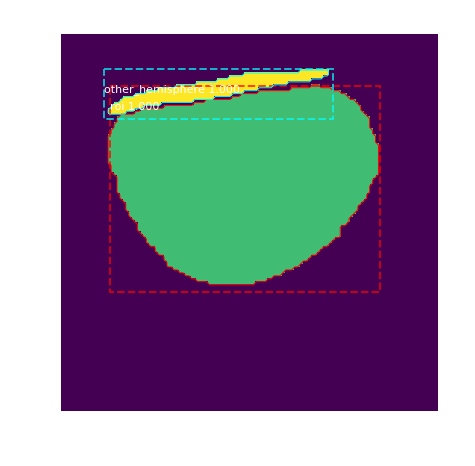

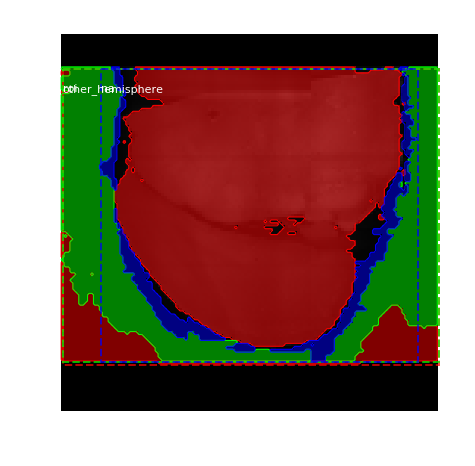

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   76.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -27.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 14%|█▍        | 56/404 [01:39<10:03,  1.73s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   65.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


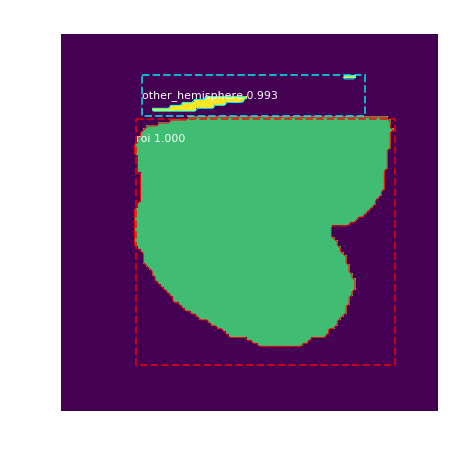

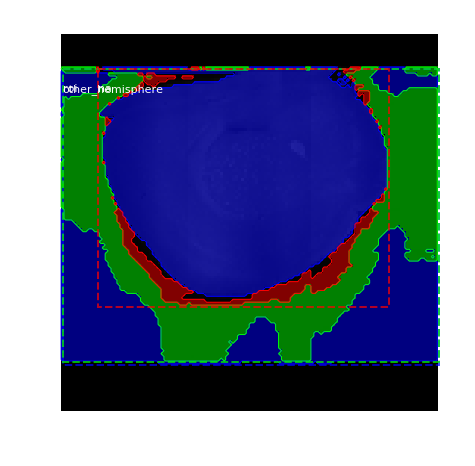

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   65.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -38.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 14%|█▍        | 57/404 [01:41<10:12,  1.77s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   68.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


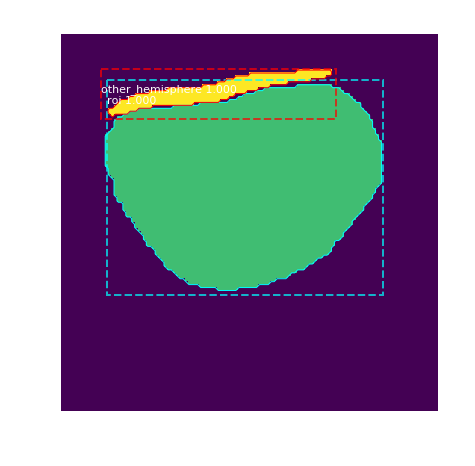

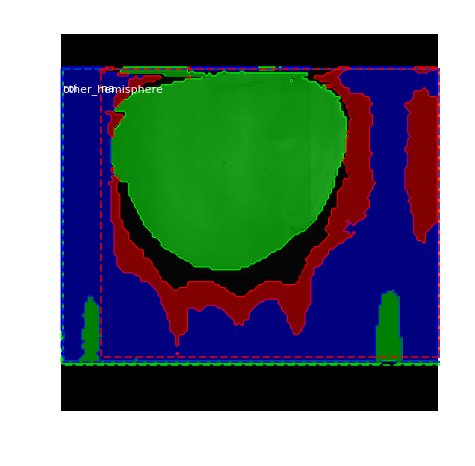

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   68.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -35.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 14%|█▍        | 58/404 [01:42<10:16,  1.78s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   97.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


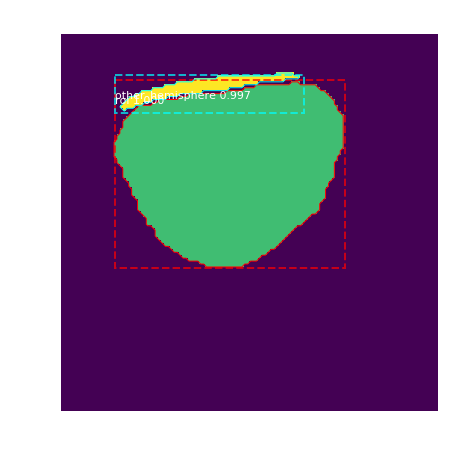

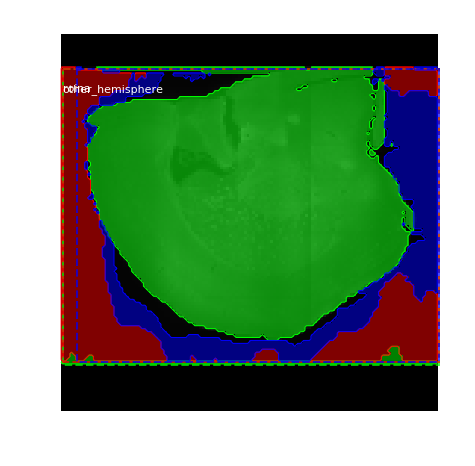

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   97.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:   -6.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 15%|█▍        | 59/404 [01:44<10:27,  1.82s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   65.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


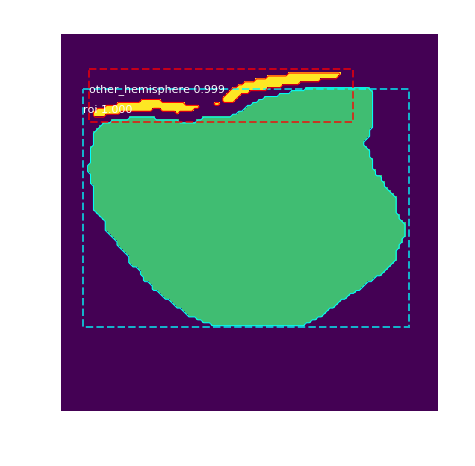

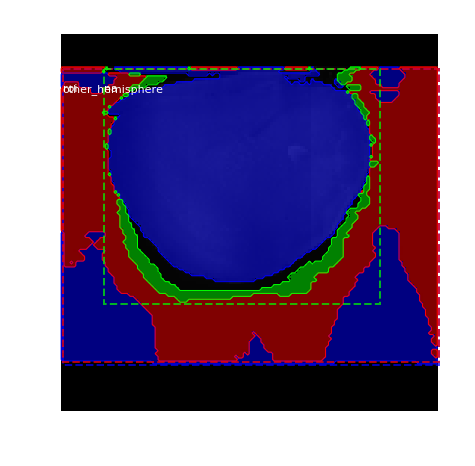

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   65.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -38.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 15%|█▍        | 60/404 [01:46<10:01,  1.75s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   98.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


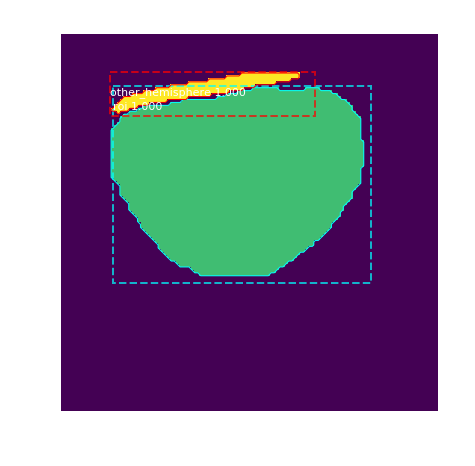

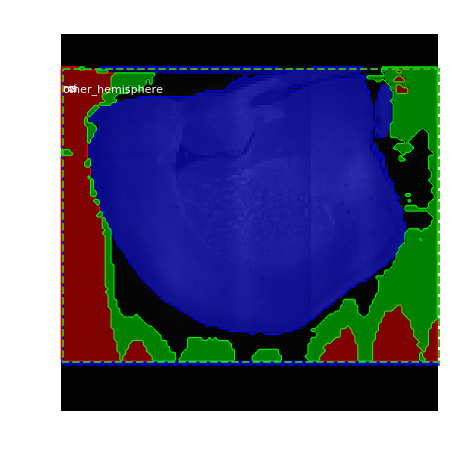

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   98.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:   -5.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 15%|█▌        | 61/404 [01:48<10:02,  1.76s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   87.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


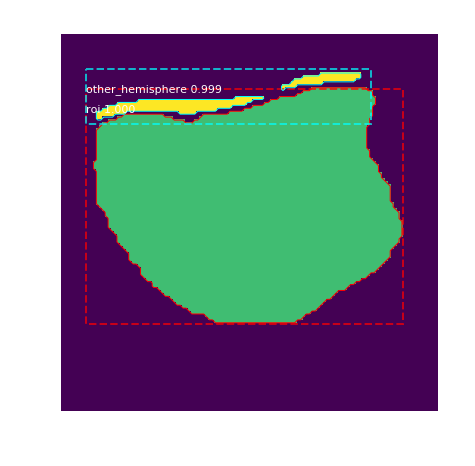

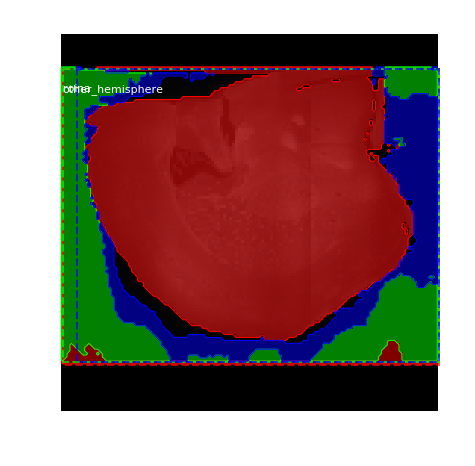

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   87.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -16.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 15%|█▌        | 62/404 [01:49<10:09,  1.78s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   62.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


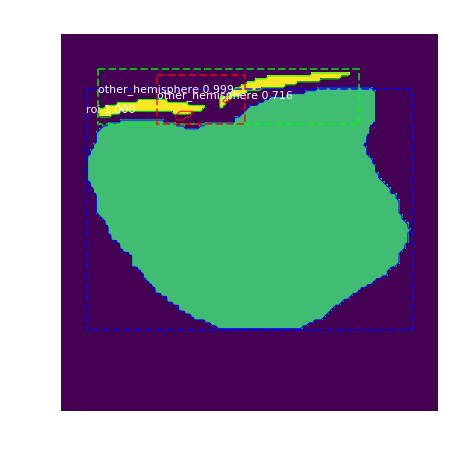

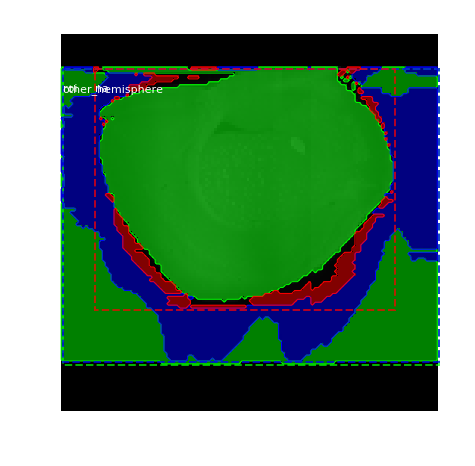

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   62.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -41.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 16%|█▌        | 63/404 [01:51<10:14,  1.80s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:  108.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  323.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


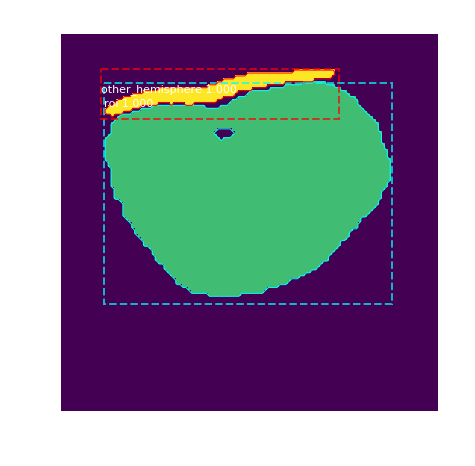

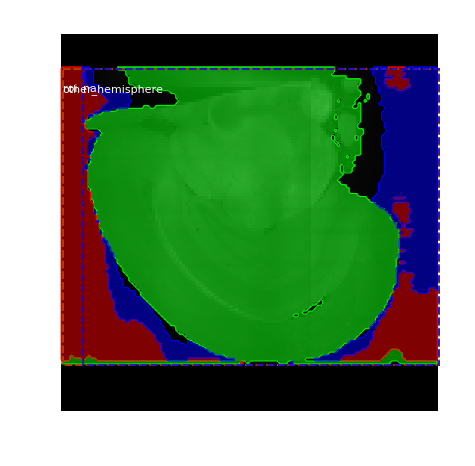

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:  108.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:    4.10000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 16%|█▌        | 64/404 [01:53<10:25,  1.84s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   67.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


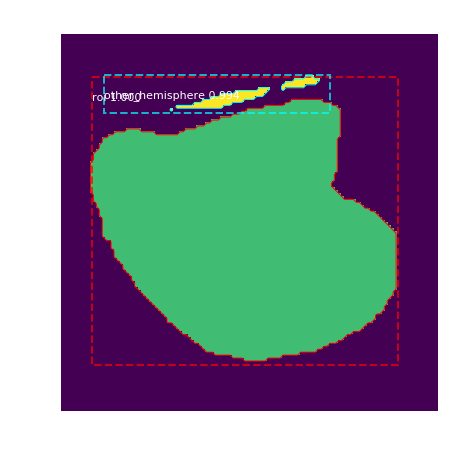

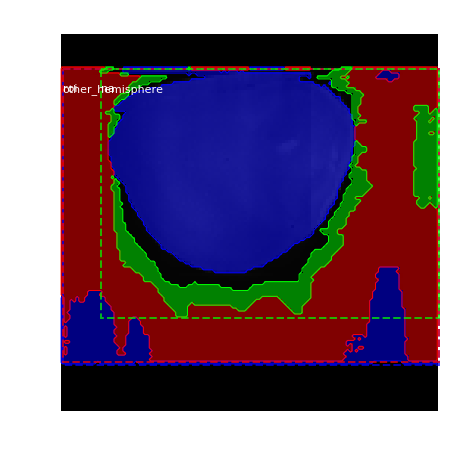

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   67.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -36.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 16%|█▌        | 65/404 [01:55<10:14,  1.81s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   74.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


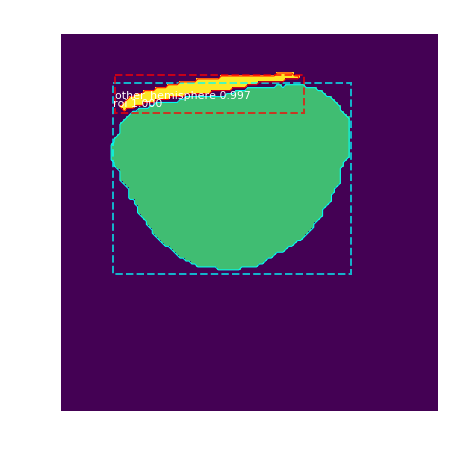

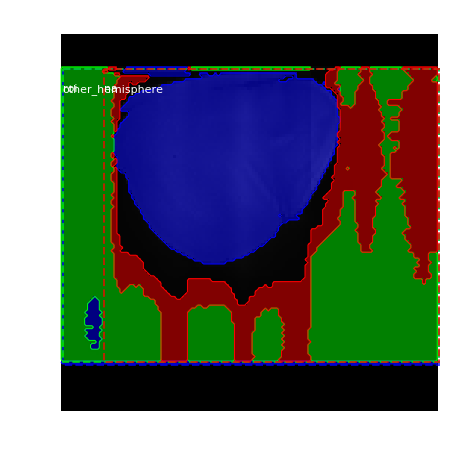

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   74.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -29.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 16%|█▋        | 66/404 [01:57<10:25,  1.85s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   77.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


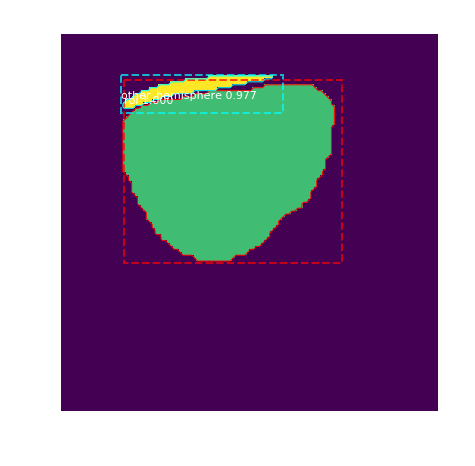

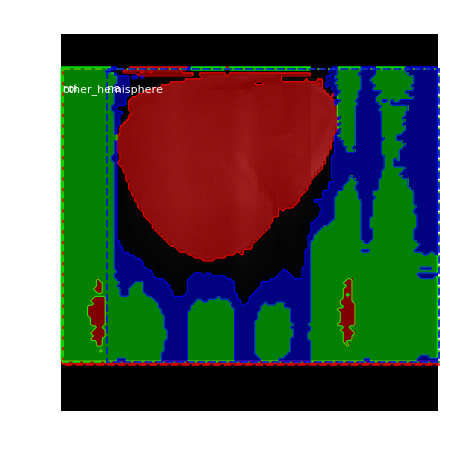

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   77.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -26.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 17%|█▋        | 67/404 [01:59<10:26,  1.86s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   67.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


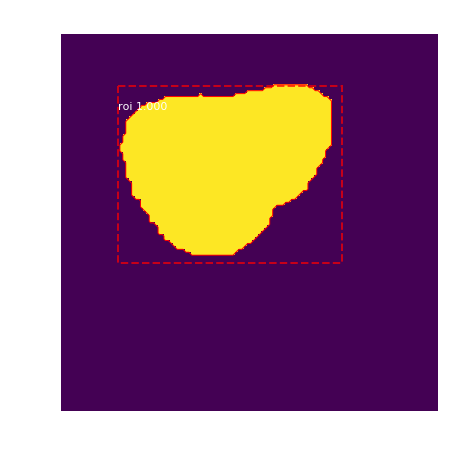

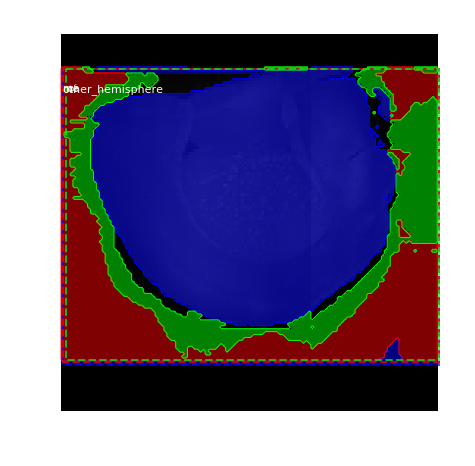

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   67.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -36.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 17%|█▋        | 68/404 [02:01<10:25,  1.86s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   73.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


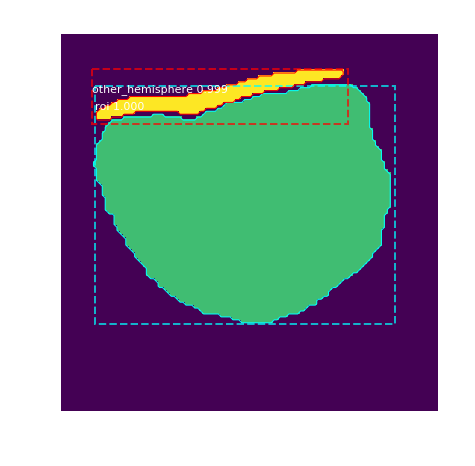

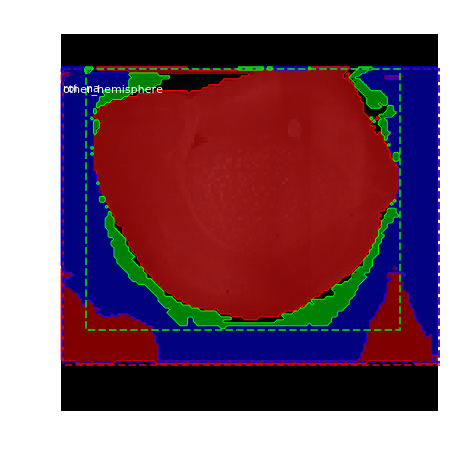

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   73.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -30.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 17%|█▋        | 69/404 [02:02<10:08,  1.82s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   84.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  361.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


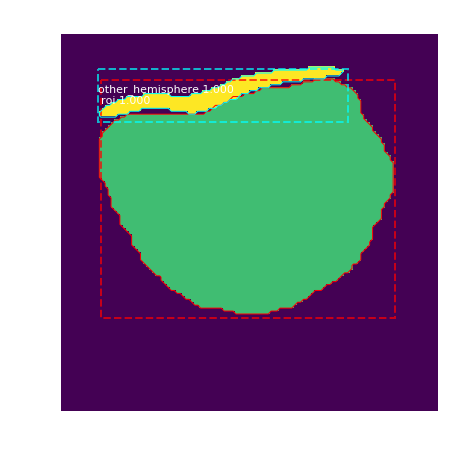

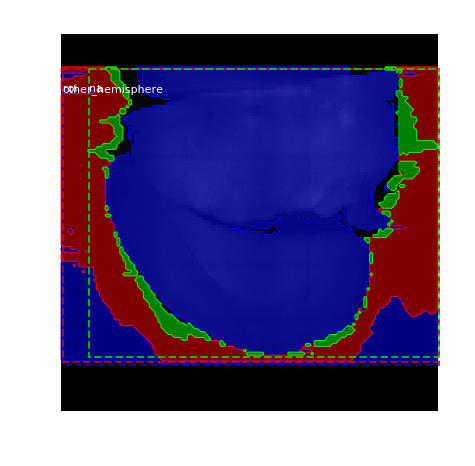

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   84.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -19.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 17%|█▋        | 70/404 [02:04<09:56,  1.79s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   64.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


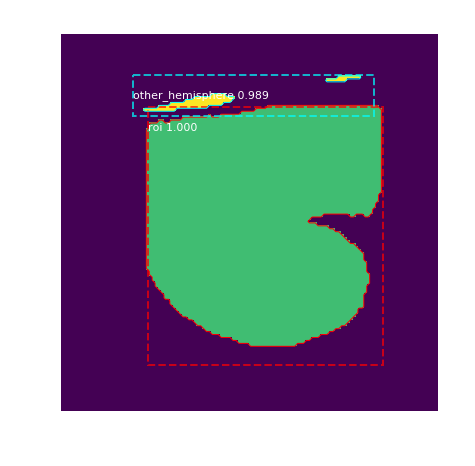

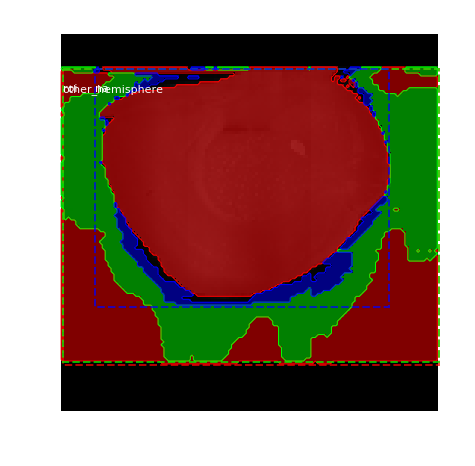

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   64.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -39.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 18%|█▊        | 71/404 [02:06<09:56,  1.79s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   77.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  349.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


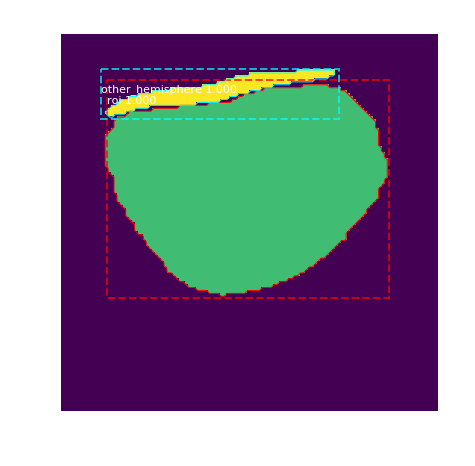

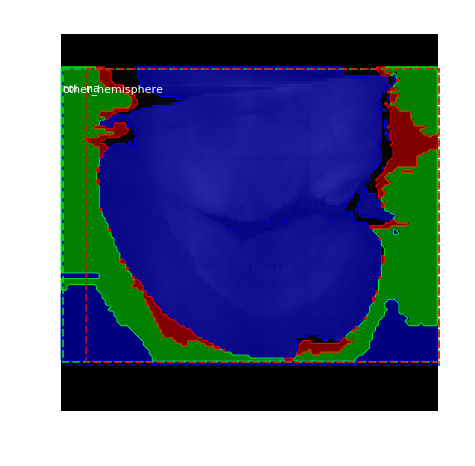

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   77.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -26.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 18%|█▊        | 72/404 [02:08<09:51,  1.78s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   47.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


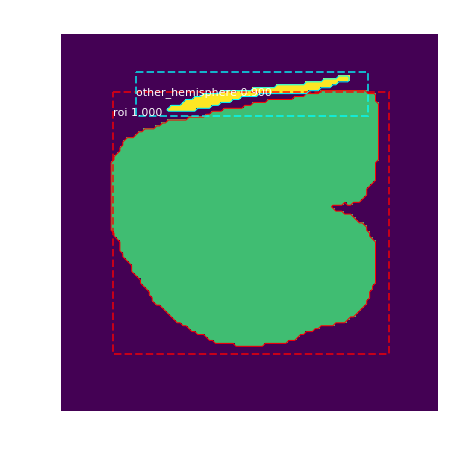

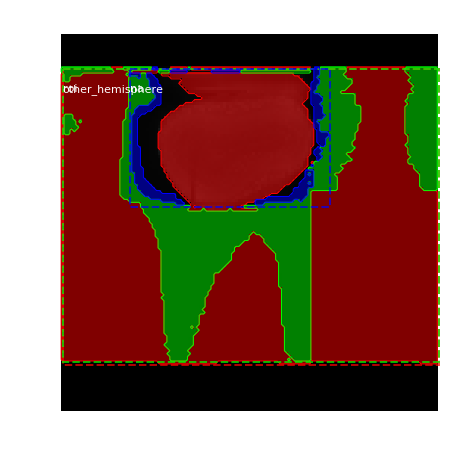

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   47.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -56.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 18%|█▊        | 73/404 [02:10<10:02,  1.82s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   48.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


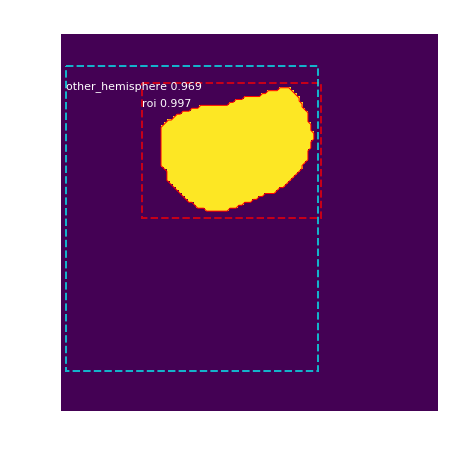

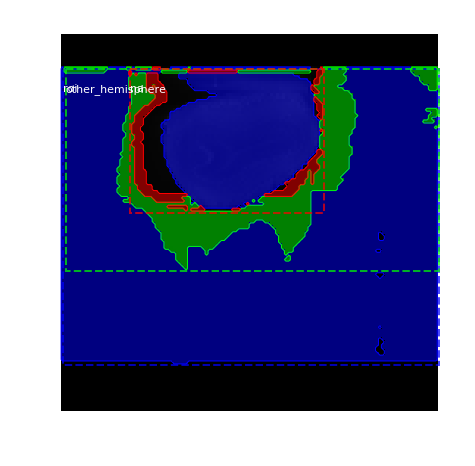

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   48.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -55.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 18%|█▊        | 74/404 [02:11<09:50,  1.79s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   74.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


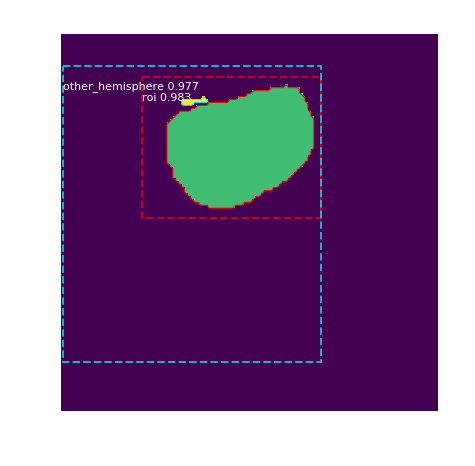

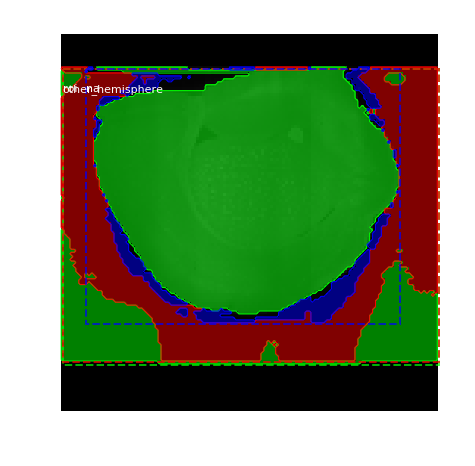

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   74.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -29.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 19%|█▊        | 75/404 [02:13<09:47,  1.79s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:  109.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  305.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


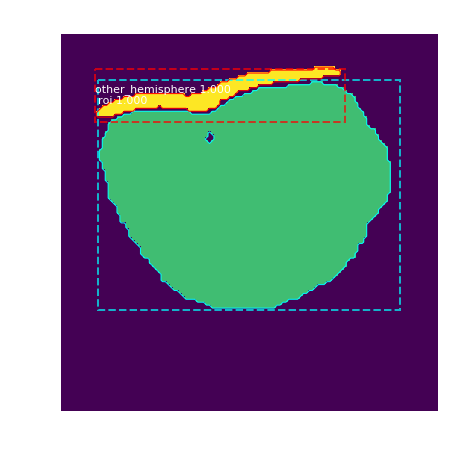

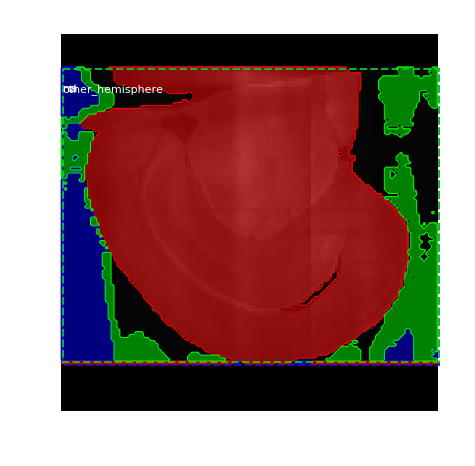

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:  109.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:    5.10000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 19%|█▉        | 76/404 [02:15<09:49,  1.80s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   49.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


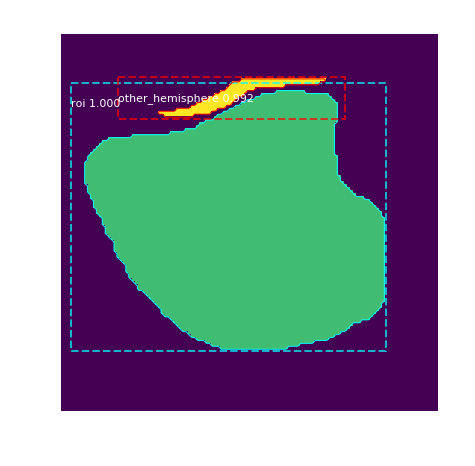

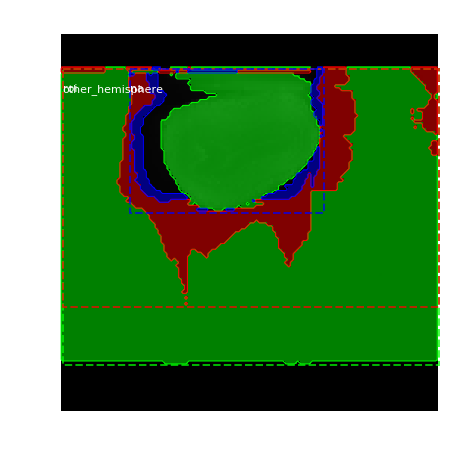

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   49.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -54.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 19%|█▉        | 77/404 [02:17<10:02,  1.84s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   88.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


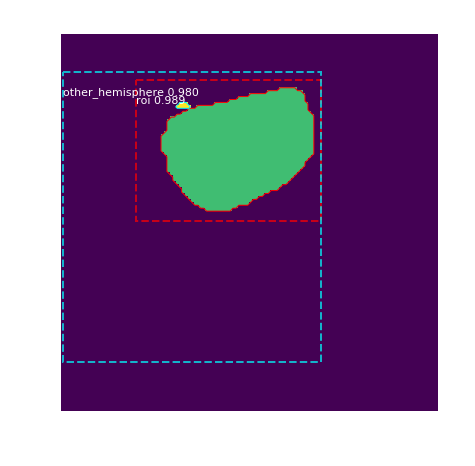

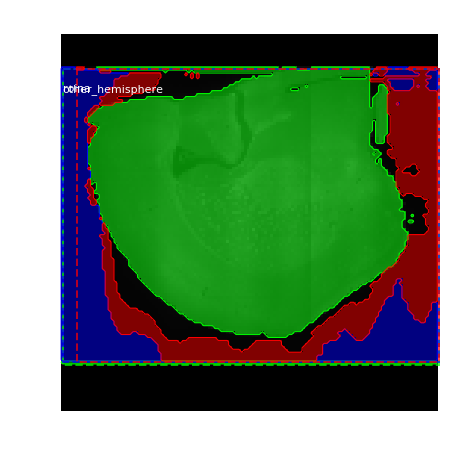

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   88.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -15.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 19%|█▉        | 78/404 [02:19<10:20,  1.90s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   87.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


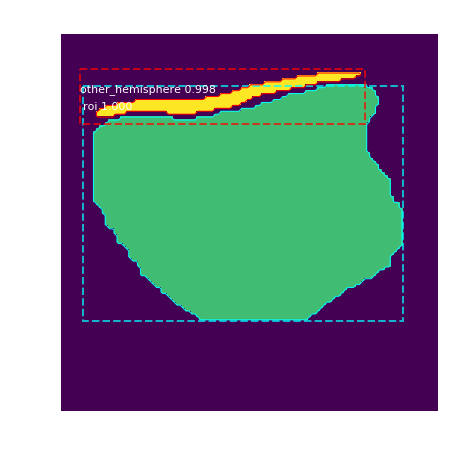

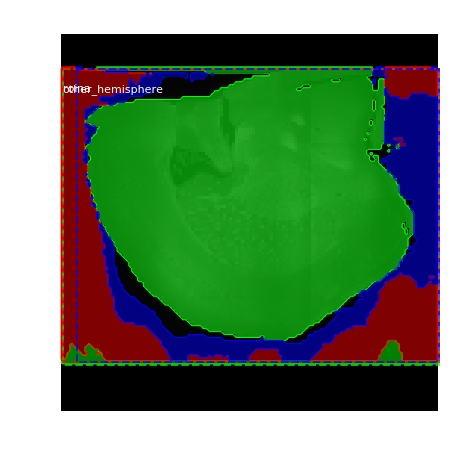

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   87.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -16.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 20%|█▉        | 79/404 [02:21<10:24,  1.92s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:  103.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


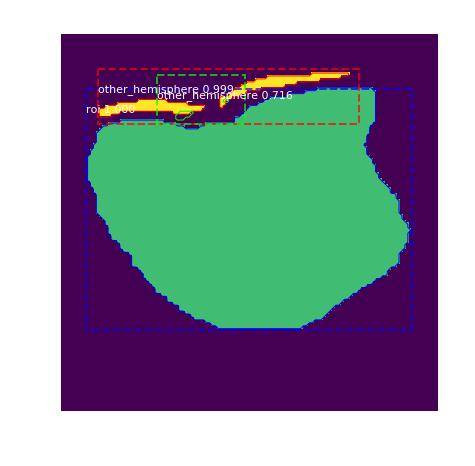

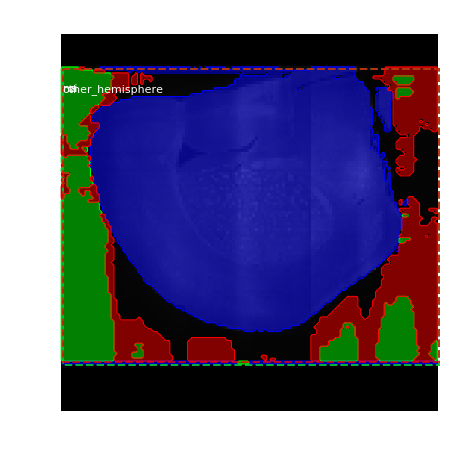

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:  103.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:   -0.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 20%|█▉        | 80/404 [02:23<10:01,  1.86s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   80.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  352.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


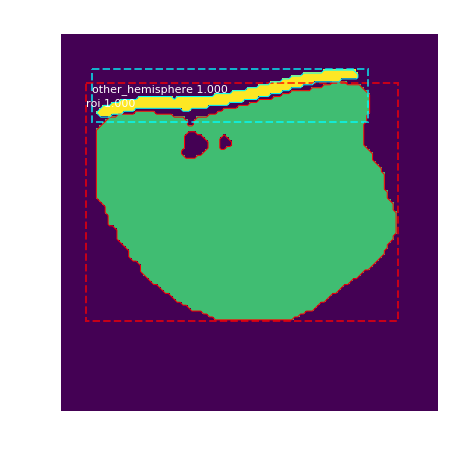

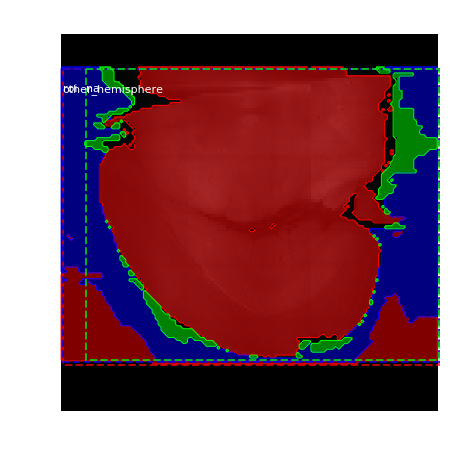

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   80.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -23.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 20%|██        | 81/404 [02:24<09:59,  1.86s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   65.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


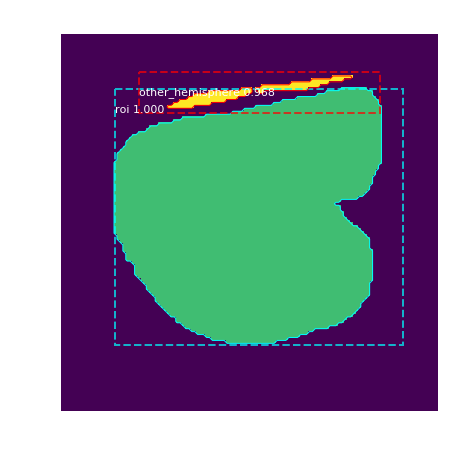

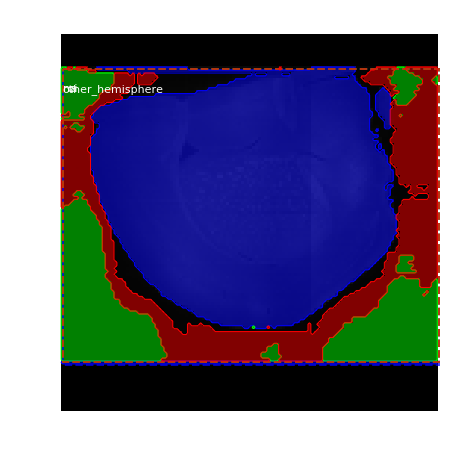

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   65.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -38.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 20%|██        | 82/404 [02:26<09:38,  1.80s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   73.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


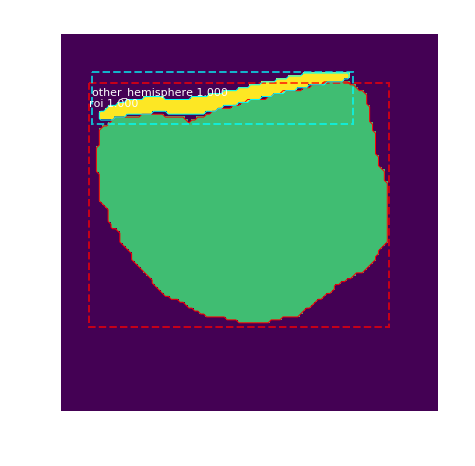

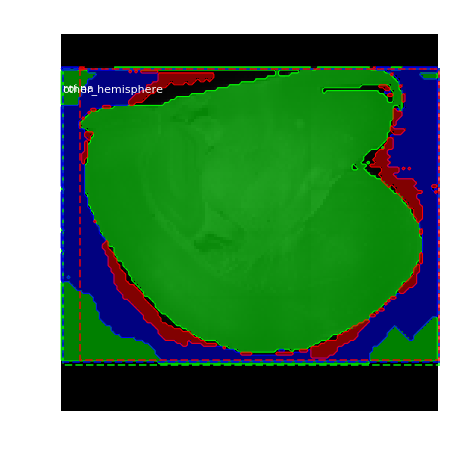

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   73.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -30.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 21%|██        | 83/404 [02:28<09:30,  1.78s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   64.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


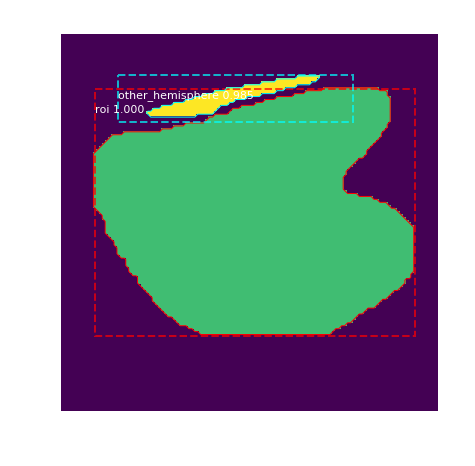

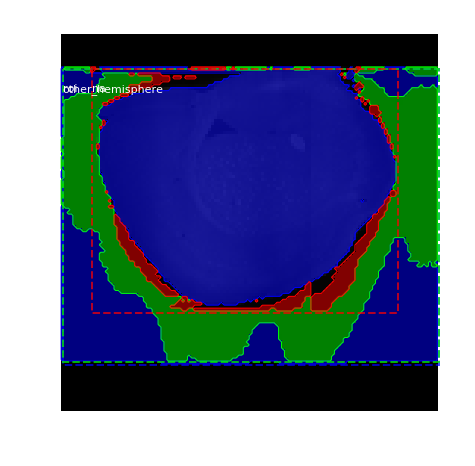

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   64.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -39.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 21%|██        | 84/404 [02:29<09:24,  1.76s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   84.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  342.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


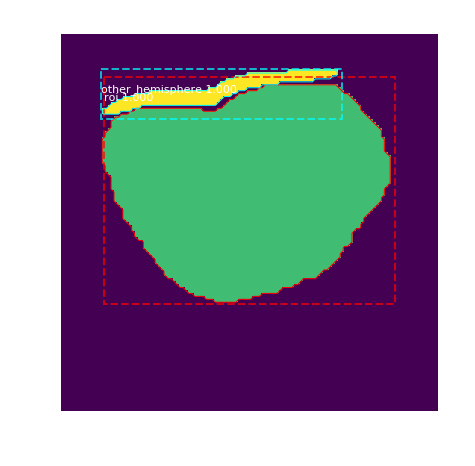

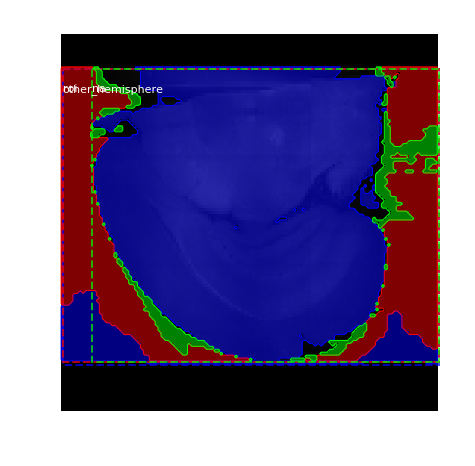

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   84.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -19.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 21%|██        | 85/404 [02:31<09:19,  1.75s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   86.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  374.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


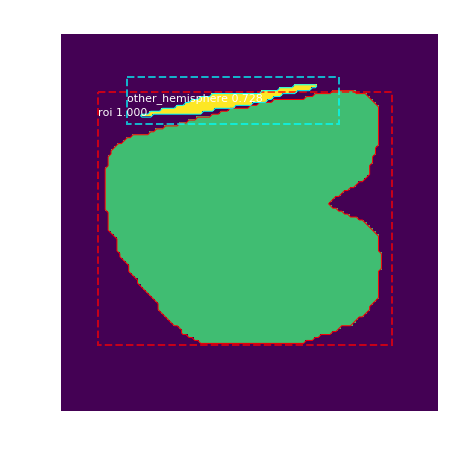

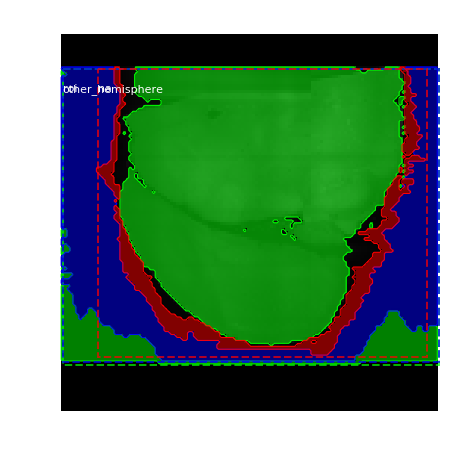

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   86.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -17.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 21%|██▏       | 86/404 [02:33<09:08,  1.72s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   93.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  387.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


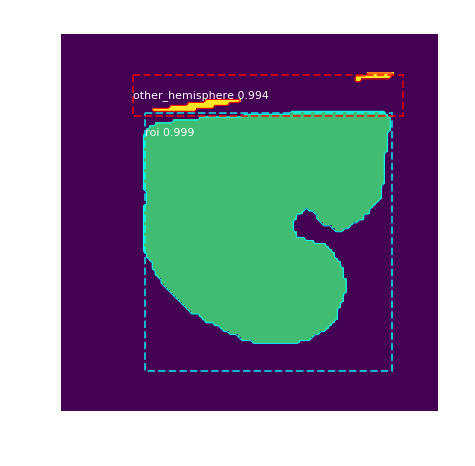

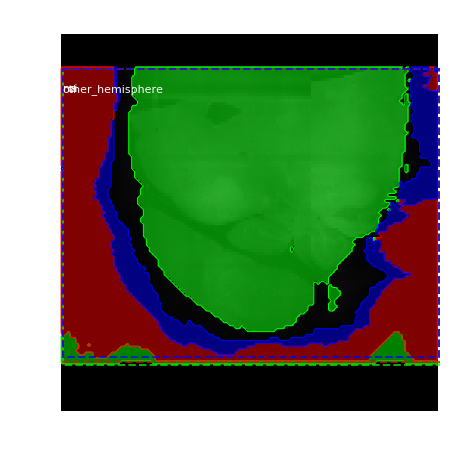

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   93.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -10.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 22%|██▏       | 87/404 [02:35<09:04,  1.72s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   66.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


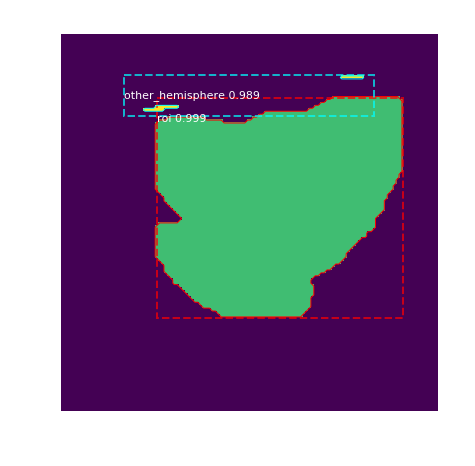

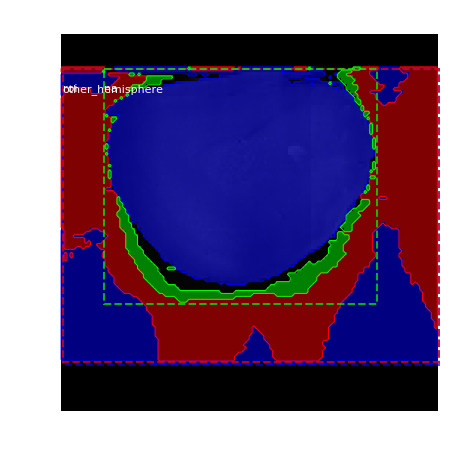

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   66.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -37.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 22%|██▏       | 88/404 [02:36<08:58,  1.70s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   44.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


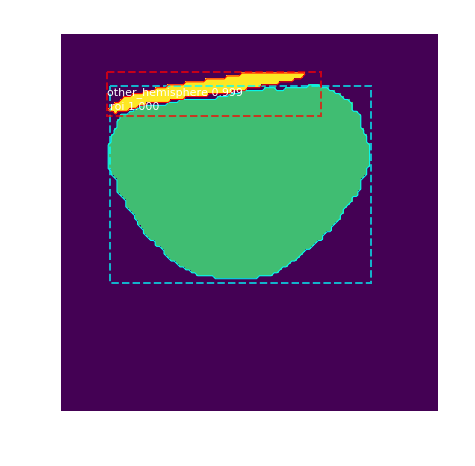

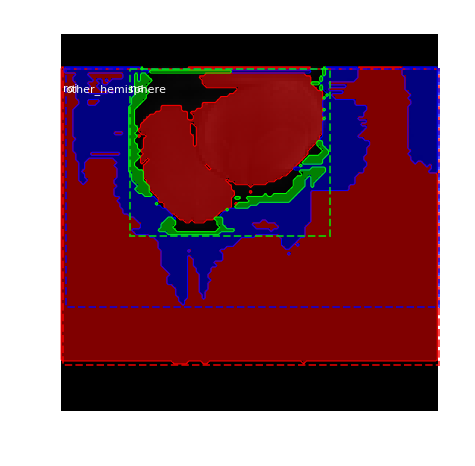

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   44.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -59.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 22%|██▏       | 89/404 [02:38<09:12,  1.75s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   90.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  336.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


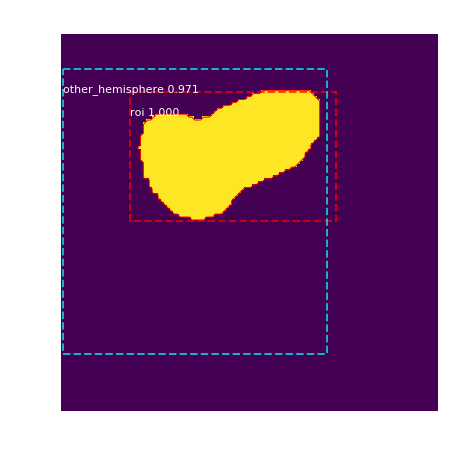

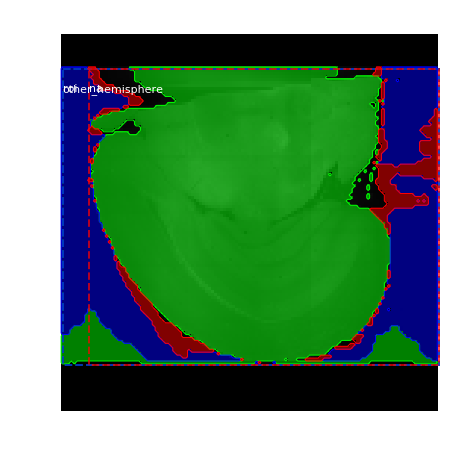

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   90.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -13.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 22%|██▏       | 90/404 [02:40<09:13,  1.76s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   43.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


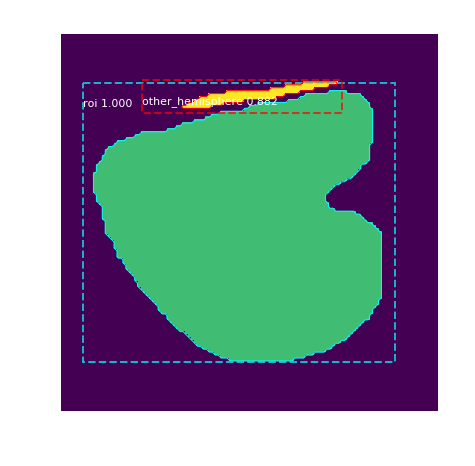

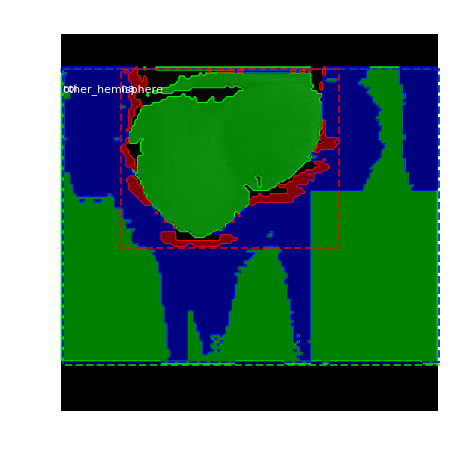

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   43.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -60.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 23%|██▎       | 91/404 [02:42<09:05,  1.74s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   63.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


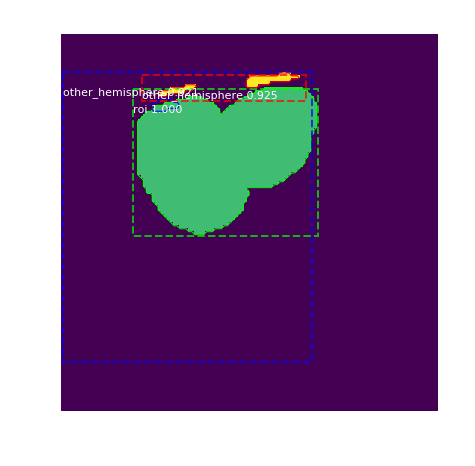

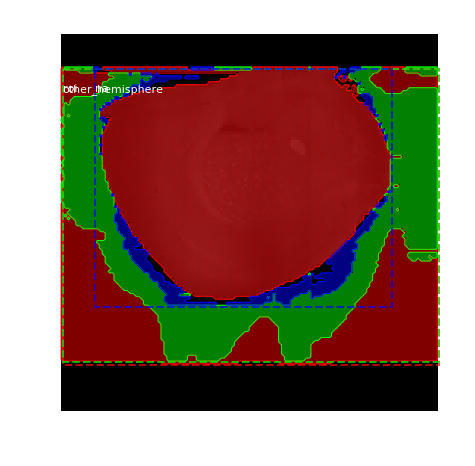

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   63.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -40.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 23%|██▎       | 92/404 [02:43<08:55,  1.72s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   83.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


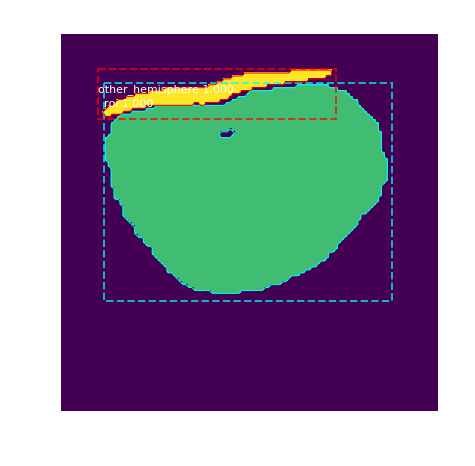

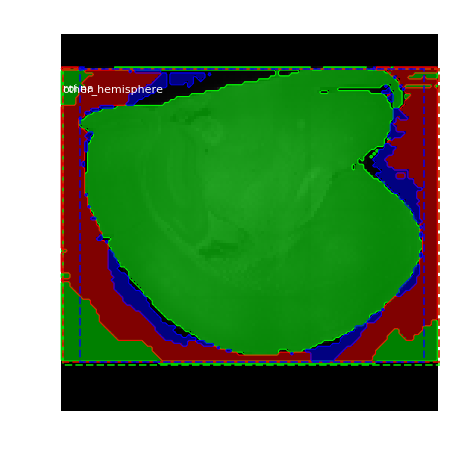

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   83.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -20.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 23%|██▎       | 93/404 [02:45<08:55,  1.72s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   76.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  347.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


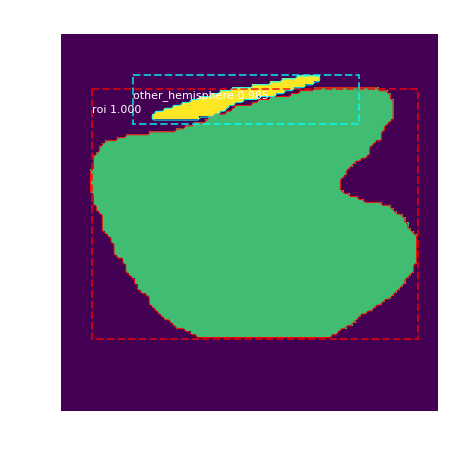

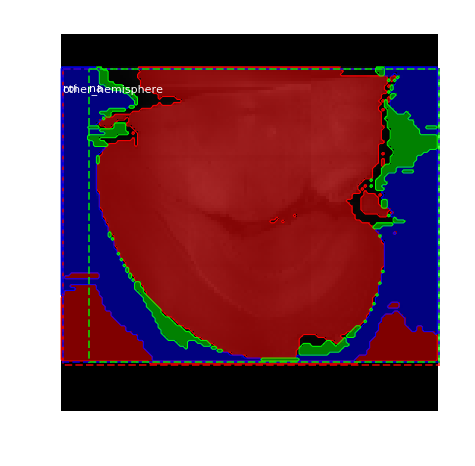

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   76.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -27.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 23%|██▎       | 94/404 [02:47<08:50,  1.71s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   75.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


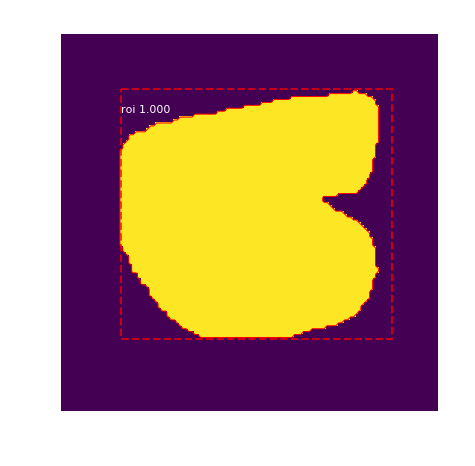

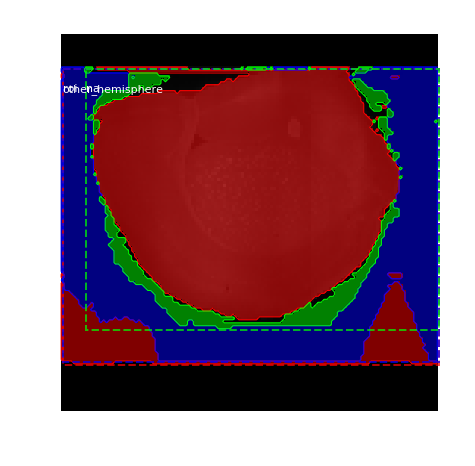

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   75.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -28.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 24%|██▎       | 95/404 [02:48<08:50,  1.72s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   44.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


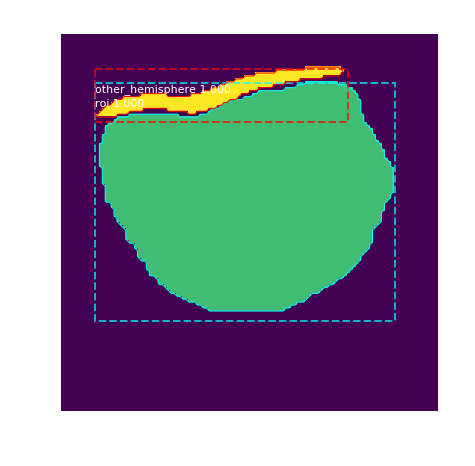

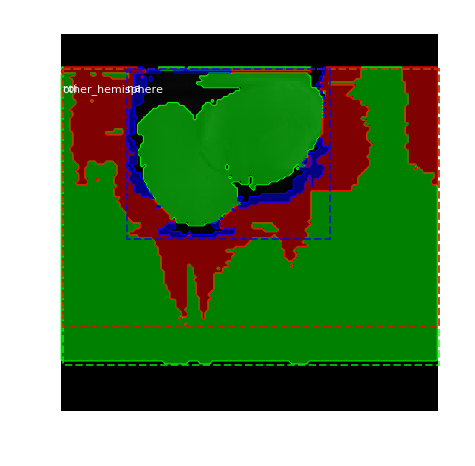

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   44.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -59.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 24%|██▍       | 96/404 [02:50<08:46,  1.71s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   93.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  395.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


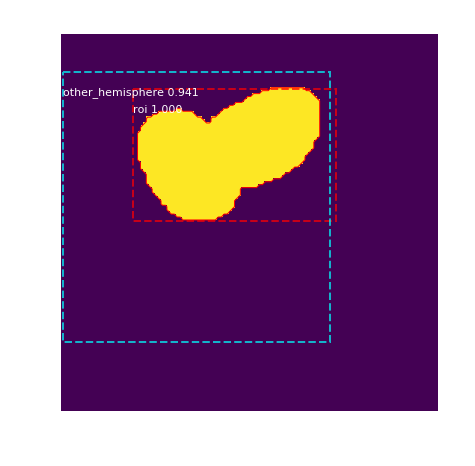

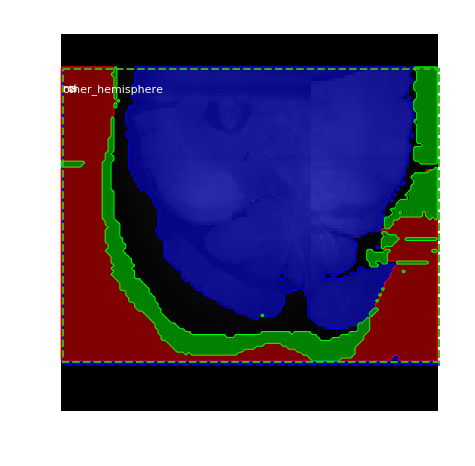

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   93.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -10.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 24%|██▍       | 97/404 [02:52<08:45,  1.71s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   82.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


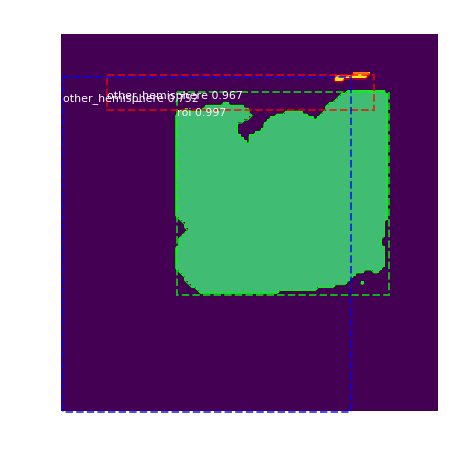

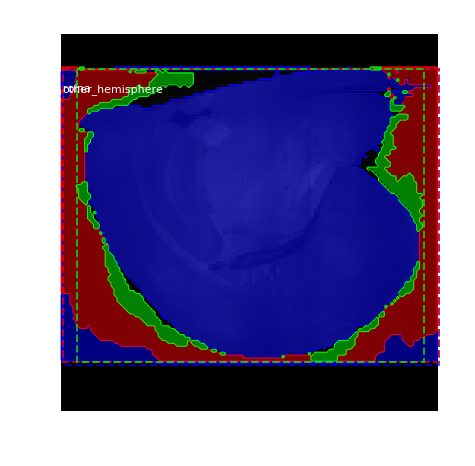

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   82.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -21.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 24%|██▍       | 98/404 [02:54<08:42,  1.71s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   78.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


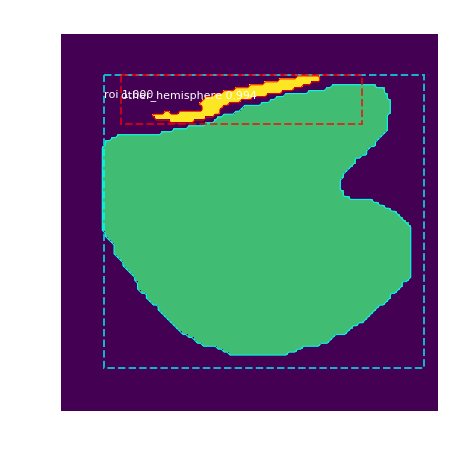

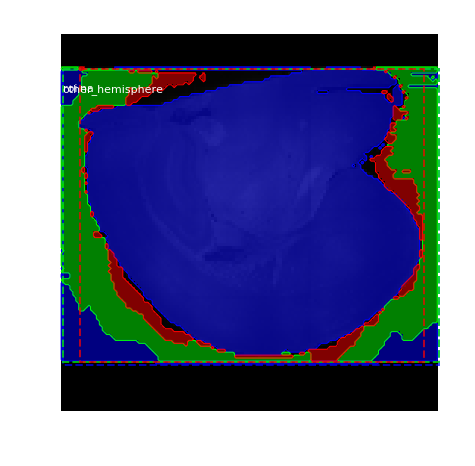

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   78.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -25.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 25%|██▍       | 99/404 [02:55<08:41,  1.71s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:  204.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


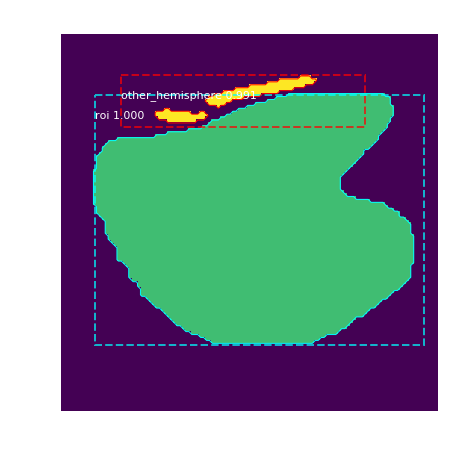

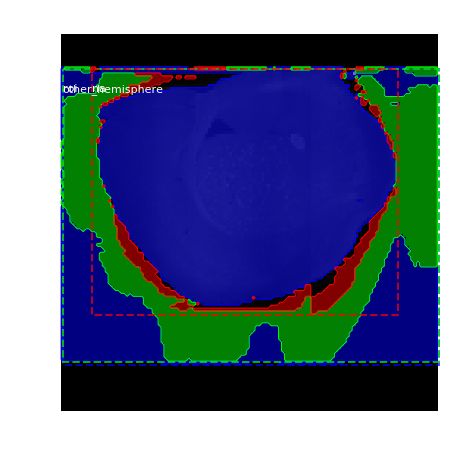

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:  204.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  100.10000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 25%|██▍       | 100/404 [02:57<08:36,  1.70s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   73.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


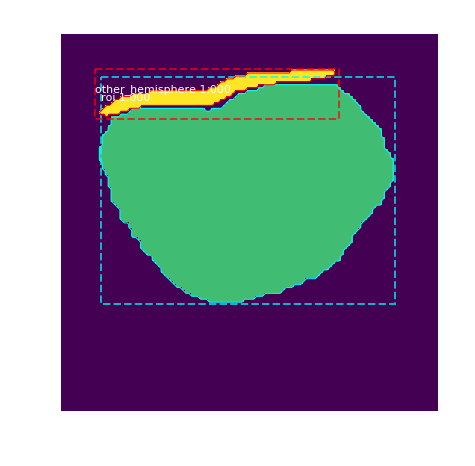

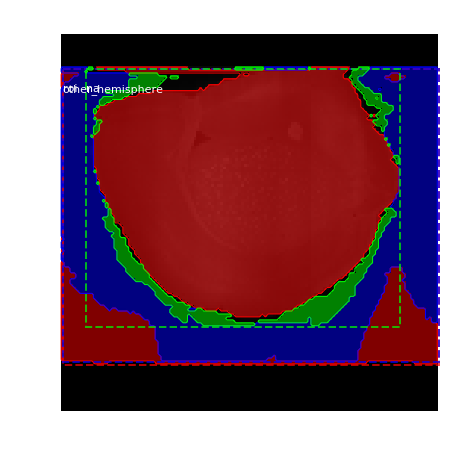

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   73.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -30.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 25%|██▌       | 101/404 [02:59<08:37,  1.71s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   76.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  371.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


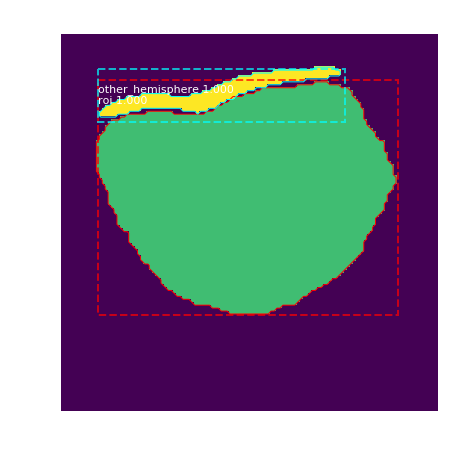

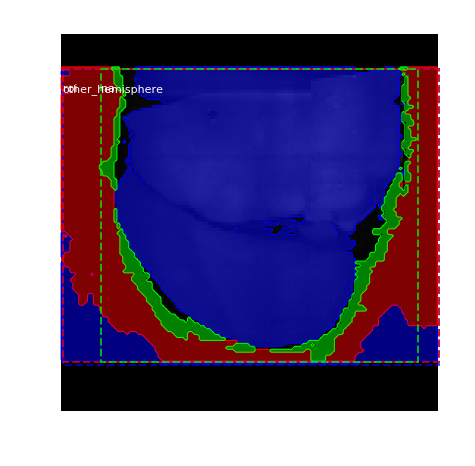

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   76.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -27.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 25%|██▌       | 102/404 [03:00<08:29,  1.69s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   66.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


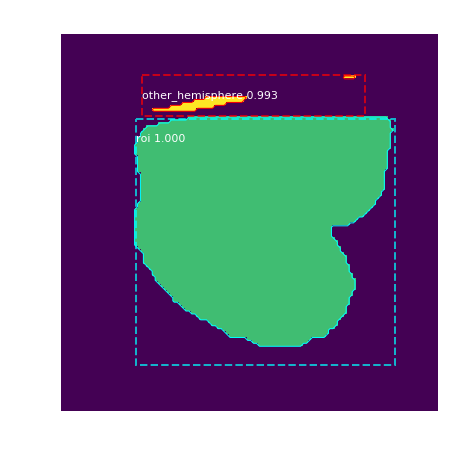

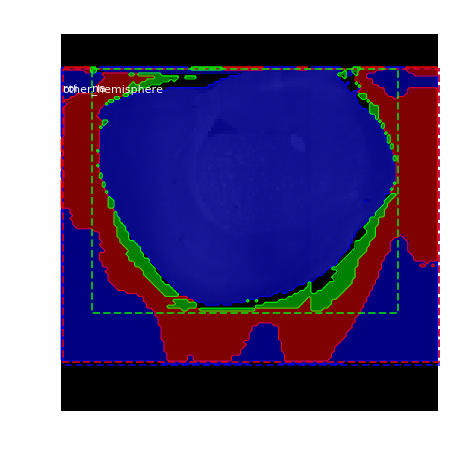

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   66.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -37.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 25%|██▌       | 103/404 [03:02<08:29,  1.69s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   81.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  355.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


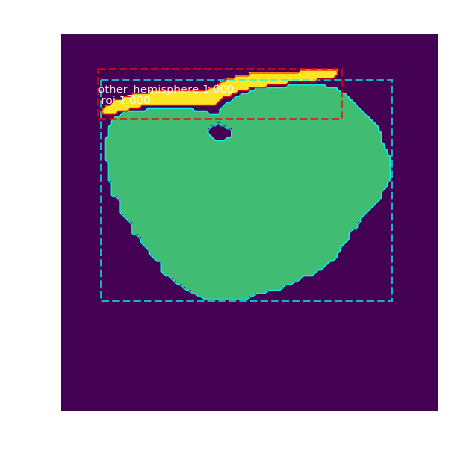

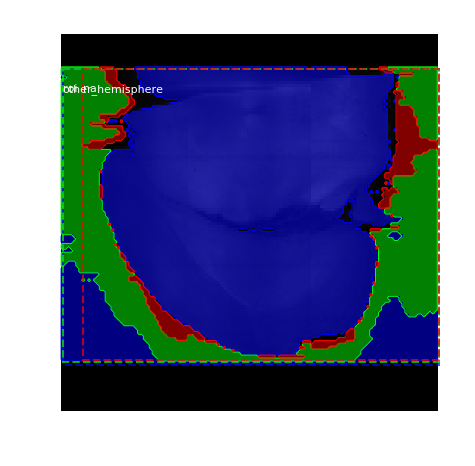

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   81.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -22.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 26%|██▌       | 104/404 [03:04<08:28,  1.69s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   48.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


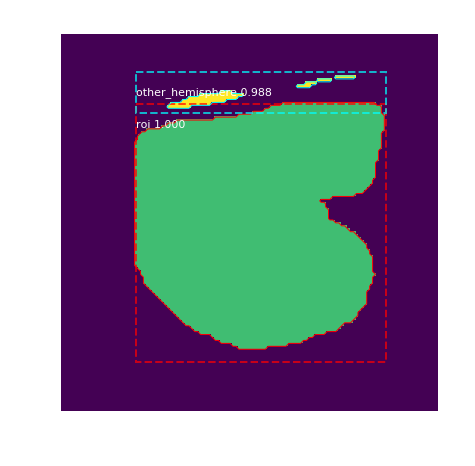

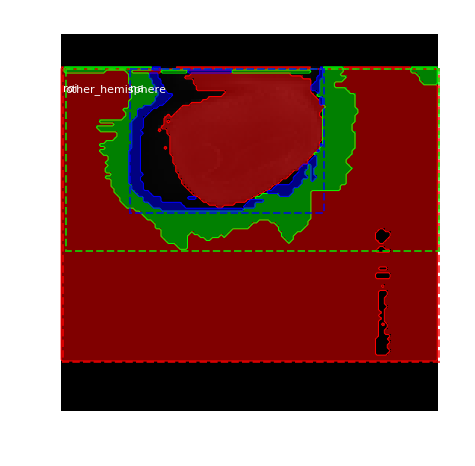

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   48.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -55.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 26%|██▌       | 105/404 [03:05<08:32,  1.71s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   86.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  344.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


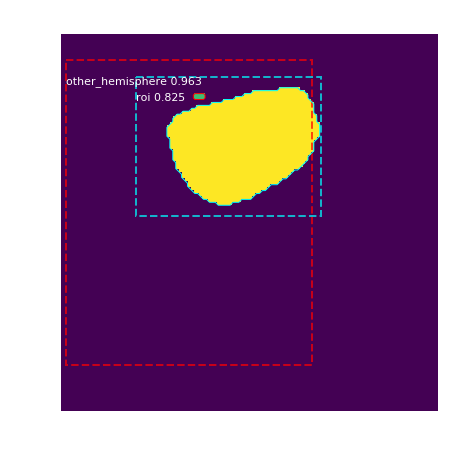

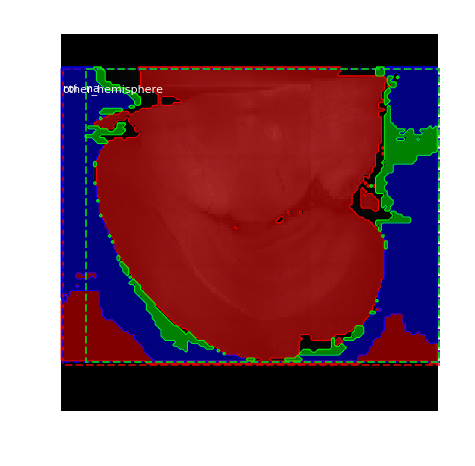

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   86.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -17.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 26%|██▌       | 106/404 [03:07<08:33,  1.72s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   70.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  367.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


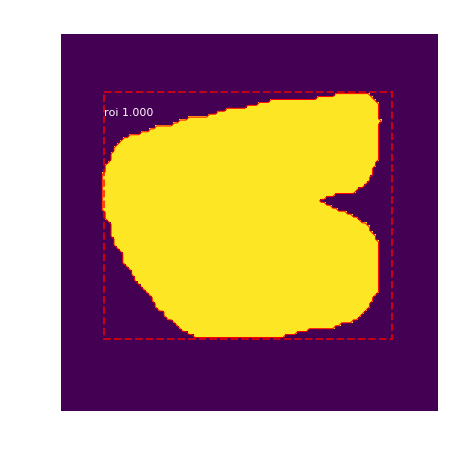

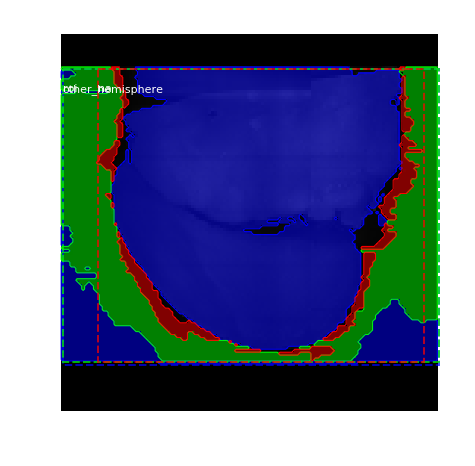

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   70.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -33.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 26%|██▋       | 107/404 [03:09<08:32,  1.73s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   77.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


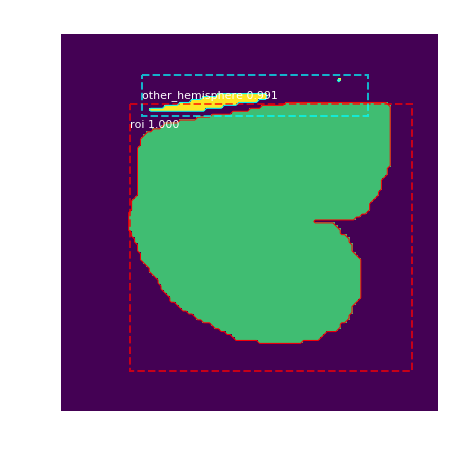

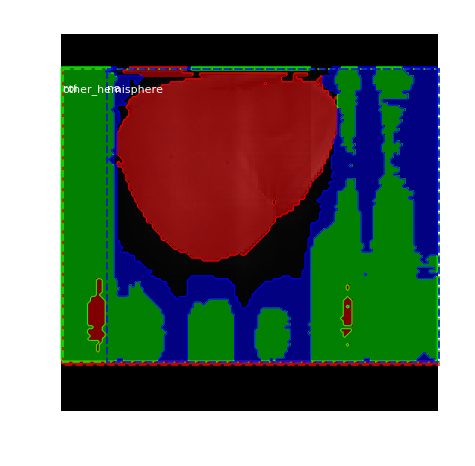

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   77.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -26.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 27%|██▋       | 108/404 [03:11<08:35,  1.74s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   88.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  385.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


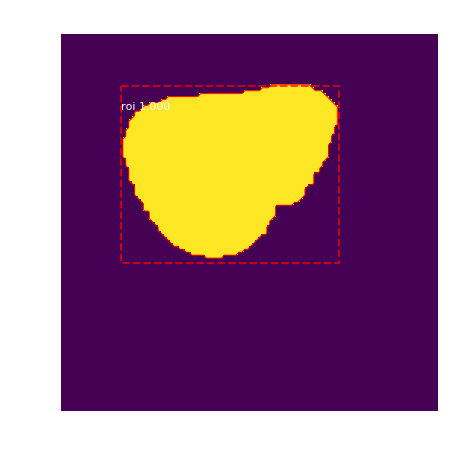

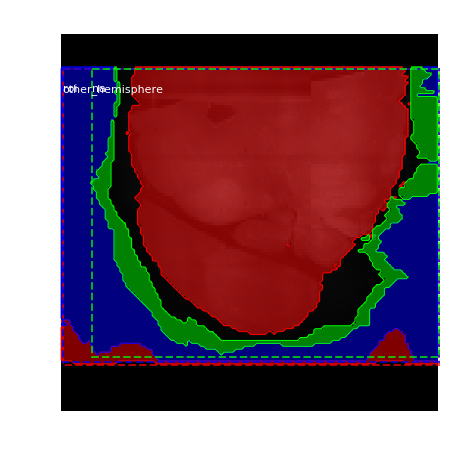

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   88.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -15.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 27%|██▋       | 109/404 [03:12<08:30,  1.73s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   80.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  364.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


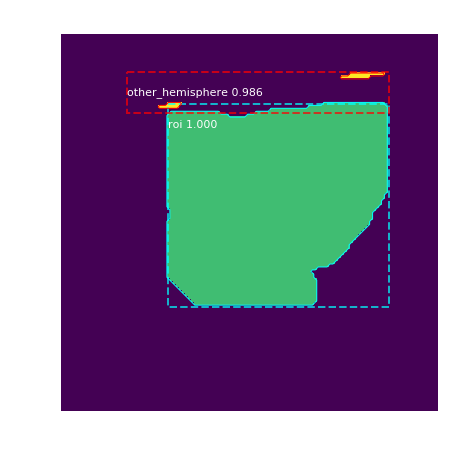

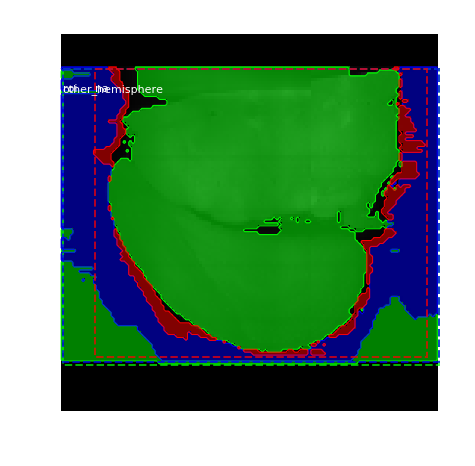

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   80.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -23.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 27%|██▋       | 110/404 [03:14<08:25,  1.72s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   87.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  343.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


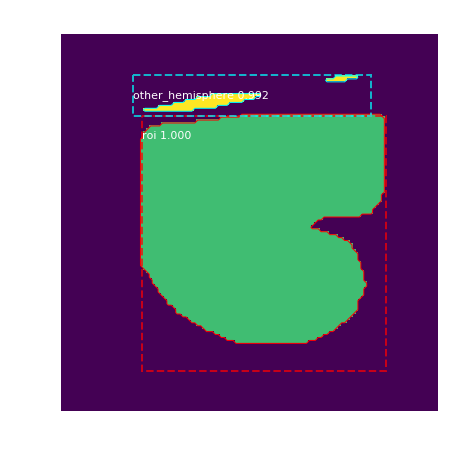

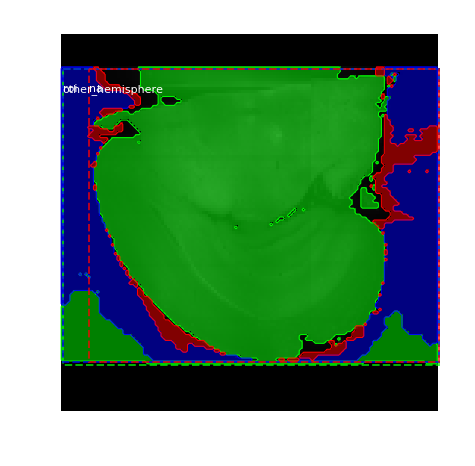

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   87.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -16.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 27%|██▋       | 111/404 [03:16<08:24,  1.72s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:  137.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


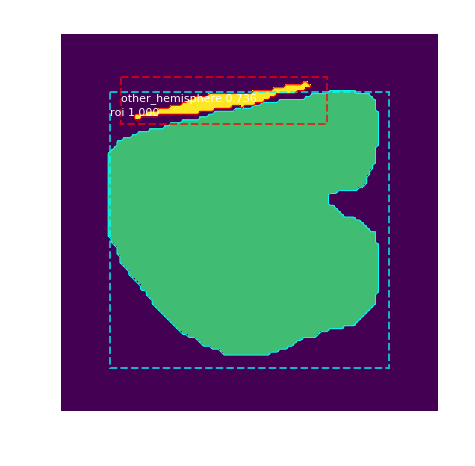

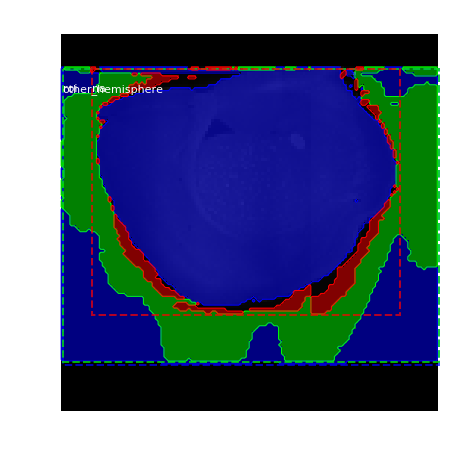

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:  137.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:   33.10000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 28%|██▊       | 112/404 [03:17<08:16,  1.70s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   88.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


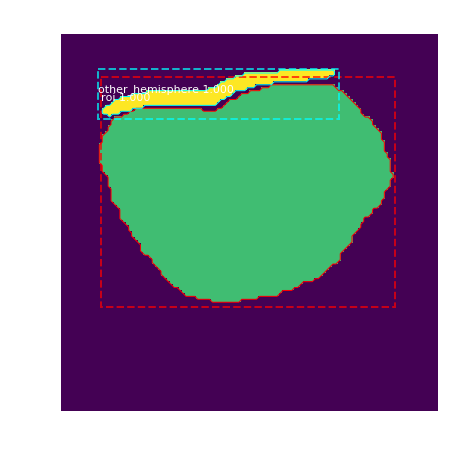

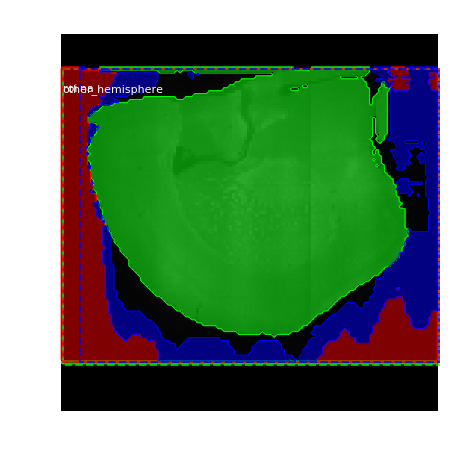

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   88.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -15.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 28%|██▊       | 113/404 [03:19<08:06,  1.67s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   68.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


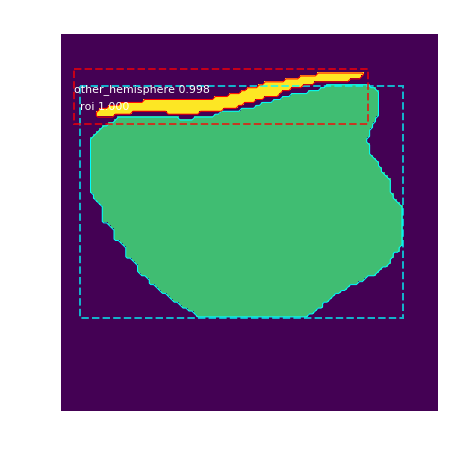

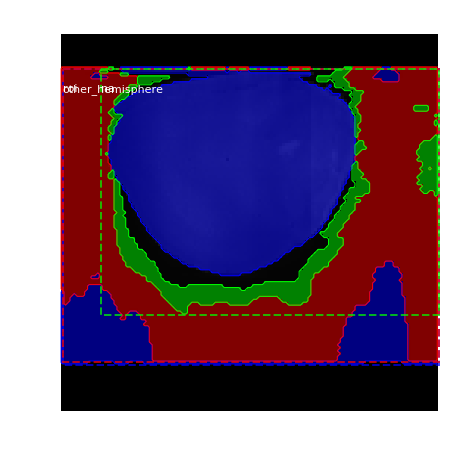

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   68.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -35.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 28%|██▊       | 114/404 [03:21<07:57,  1.65s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   93.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  387.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


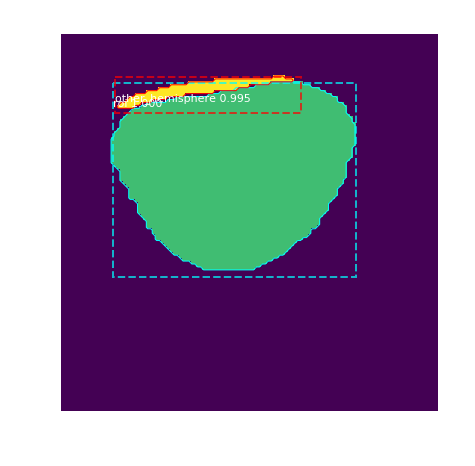

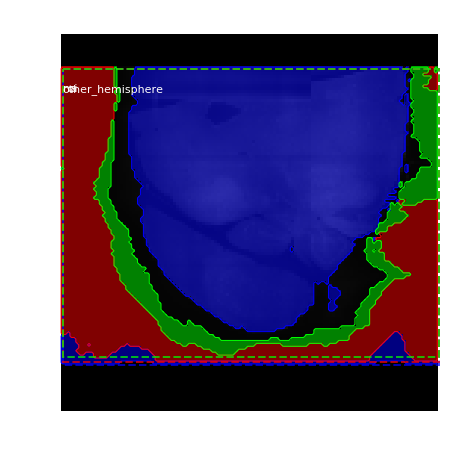

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   93.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -10.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 28%|██▊       | 115/404 [03:22<07:59,  1.66s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   67.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


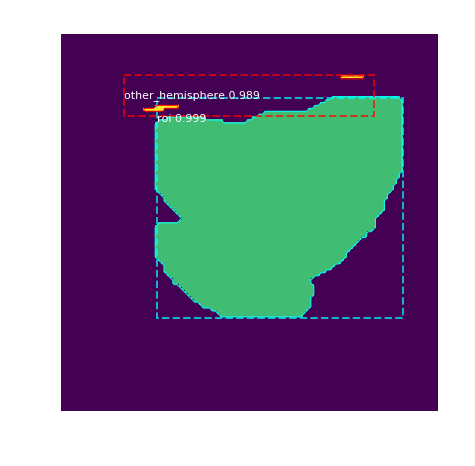

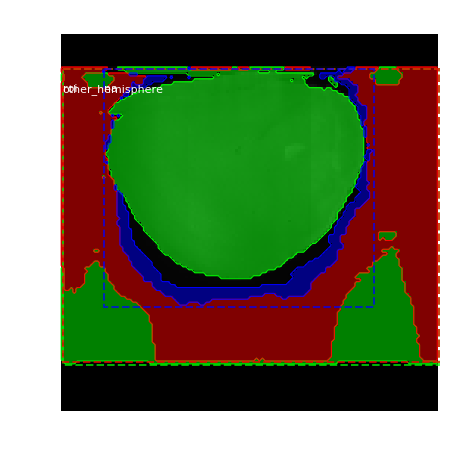

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   67.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -36.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 29%|██▊       | 116/404 [03:24<08:01,  1.67s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   63.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


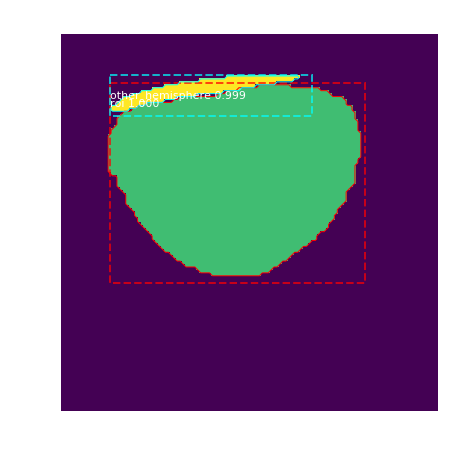

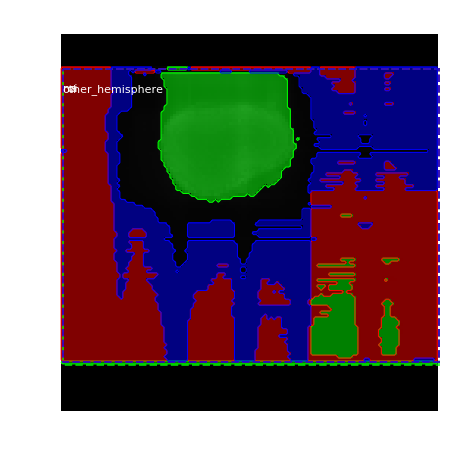

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   63.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -40.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 29%|██▉       | 117/404 [03:26<07:59,  1.67s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   75.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  287.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


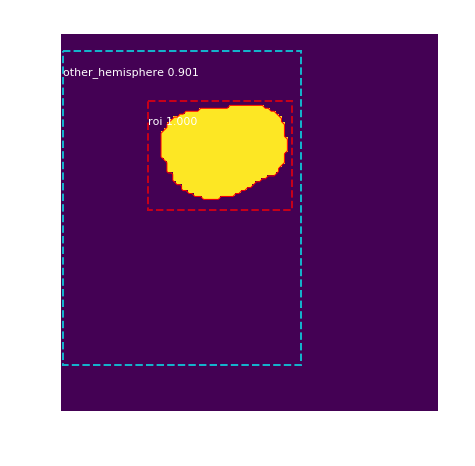

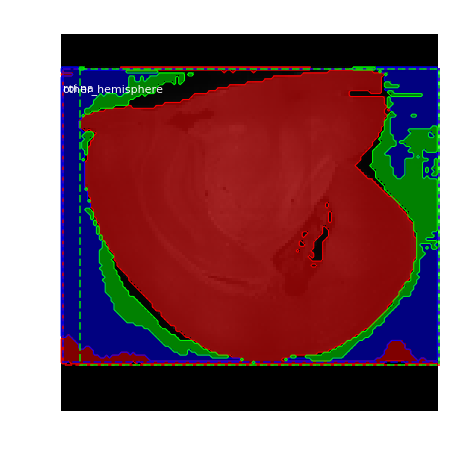

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   75.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -28.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 29%|██▉       | 118/404 [03:27<07:54,  1.66s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   64.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


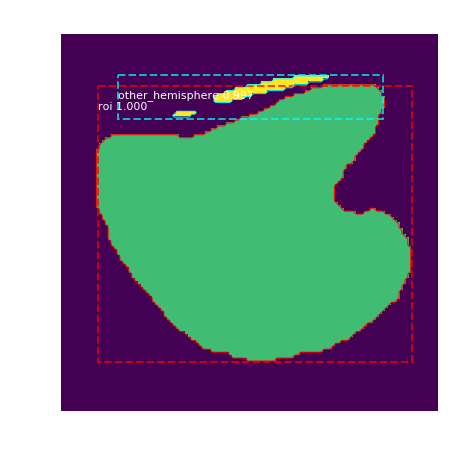

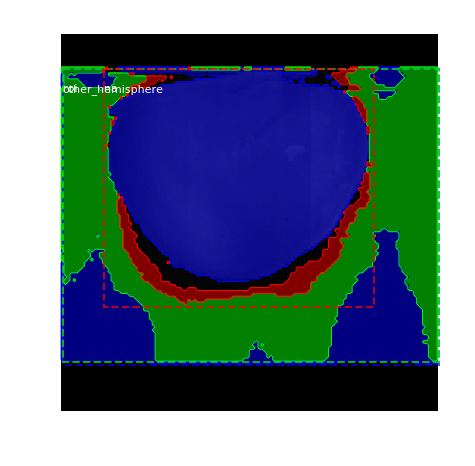

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   64.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -39.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 29%|██▉       | 119/404 [03:29<07:55,  1.67s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   77.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


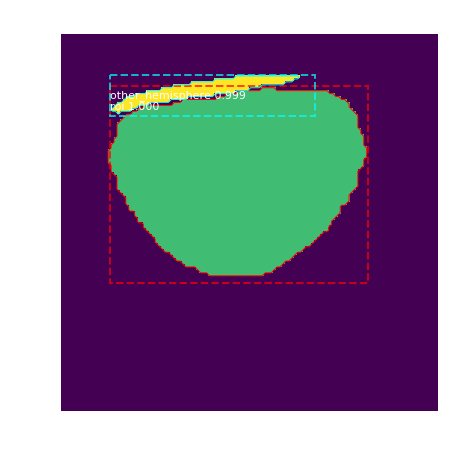

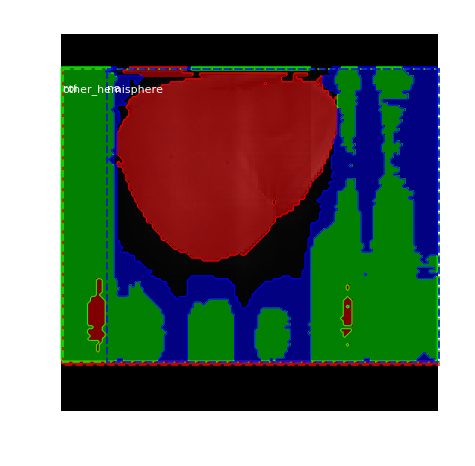

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   77.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -26.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 30%|██▉       | 120/404 [03:31<07:59,  1.69s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   86.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


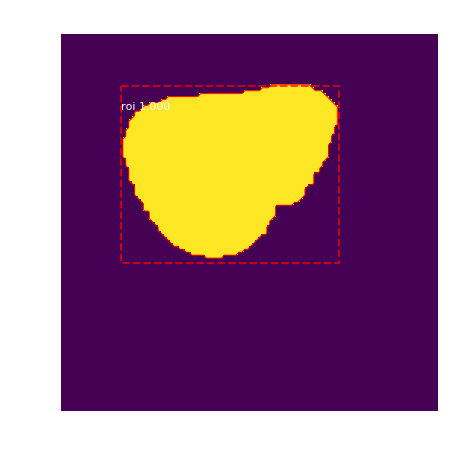

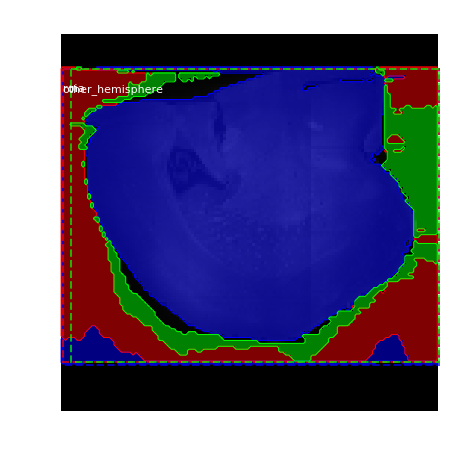

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   86.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -17.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 30%|██▉       | 121/404 [03:32<07:57,  1.69s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   66.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


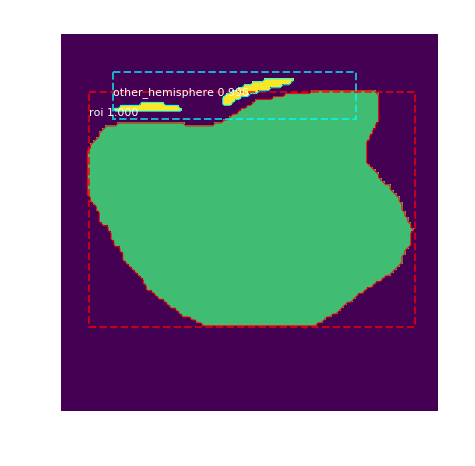

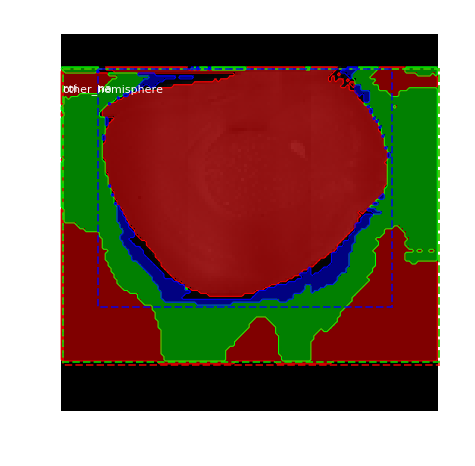

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   66.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -37.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 30%|███       | 122/404 [03:34<08:03,  1.71s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   71.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  296.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


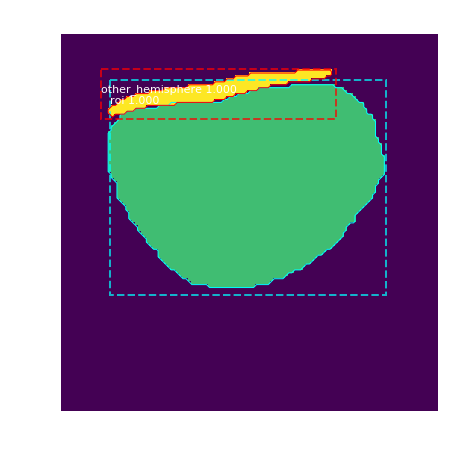

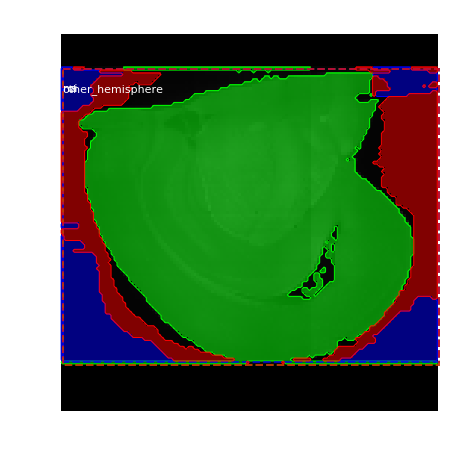

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   71.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -32.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 30%|███       | 123/404 [03:36<08:15,  1.76s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   50.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


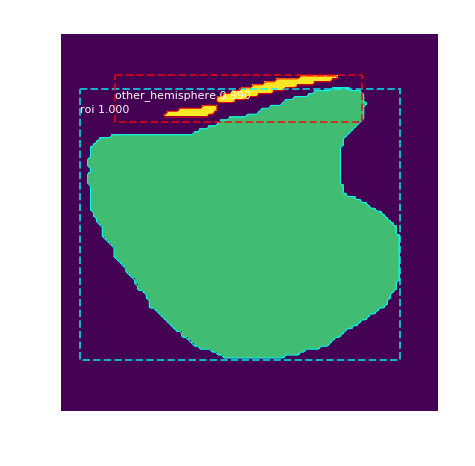

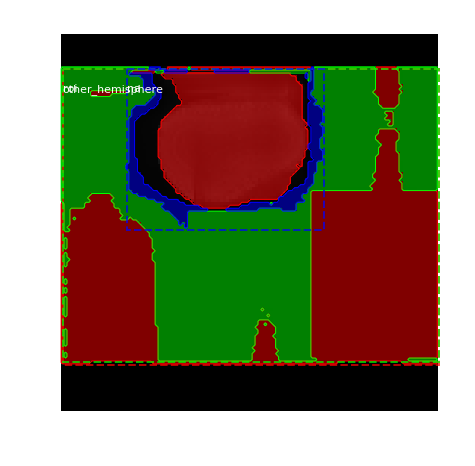

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   50.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -53.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 31%|███       | 124/404 [03:38<08:22,  1.79s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   86.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  374.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


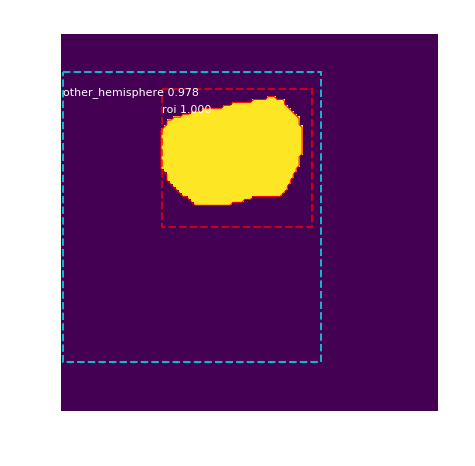

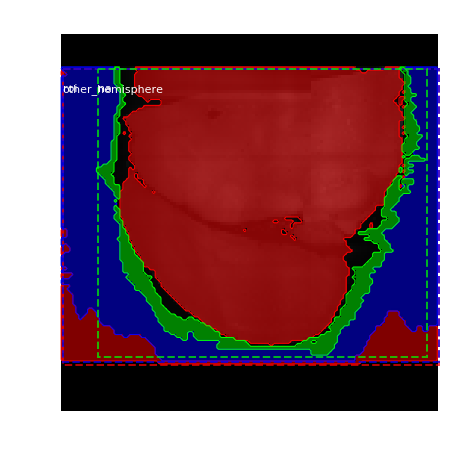

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   86.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -17.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 31%|███       | 125/404 [03:40<08:20,  1.79s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:  103.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  317.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


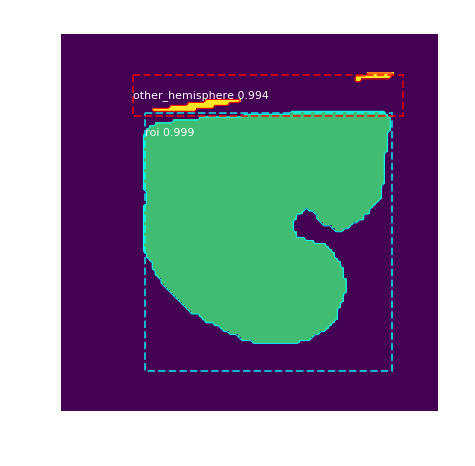

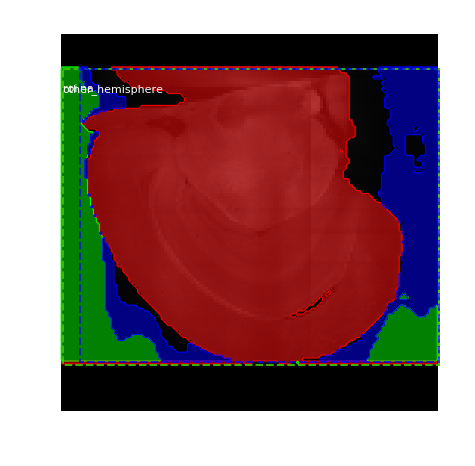

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:  103.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:   -0.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 31%|███       | 126/404 [03:41<08:08,  1.76s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   96.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  390.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


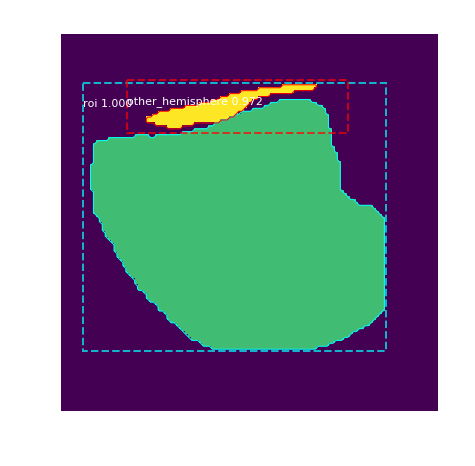

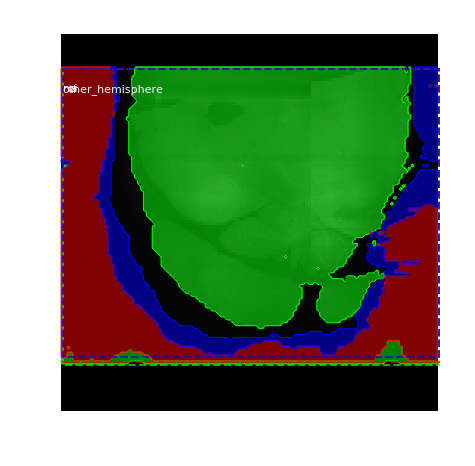

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   96.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:   -7.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 31%|███▏      | 127/404 [03:44<08:47,  1.91s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   52.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


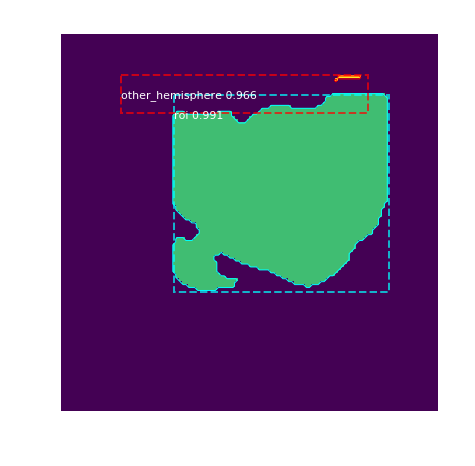

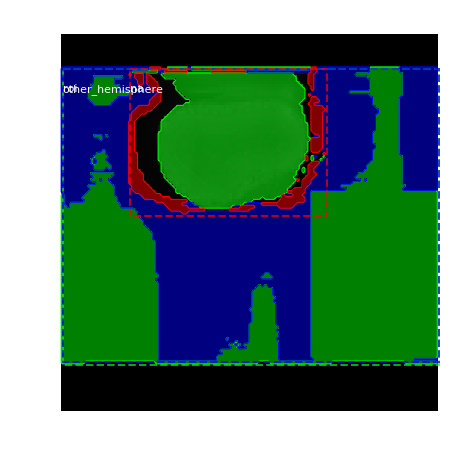

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   52.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -51.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 32%|███▏      | 128/404 [03:45<08:20,  1.81s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   56.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


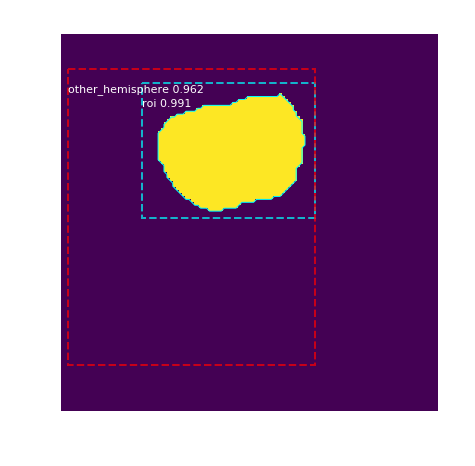

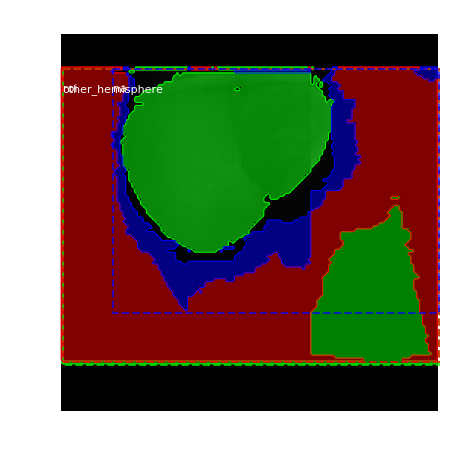

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   56.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -47.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 32%|███▏      | 129/404 [03:47<07:59,  1.74s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   58.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


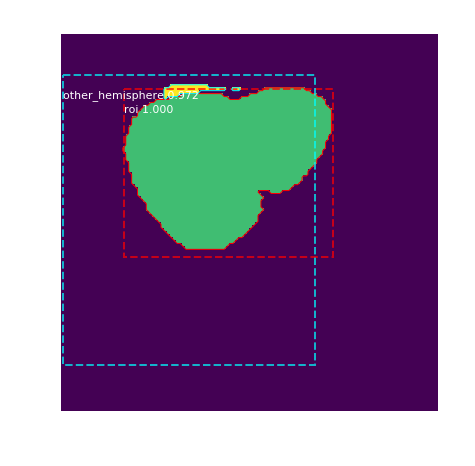

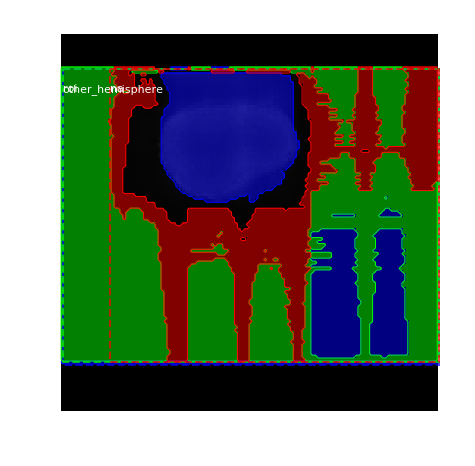

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   58.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -45.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 32%|███▏      | 130/404 [03:48<07:45,  1.70s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   98.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  321.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


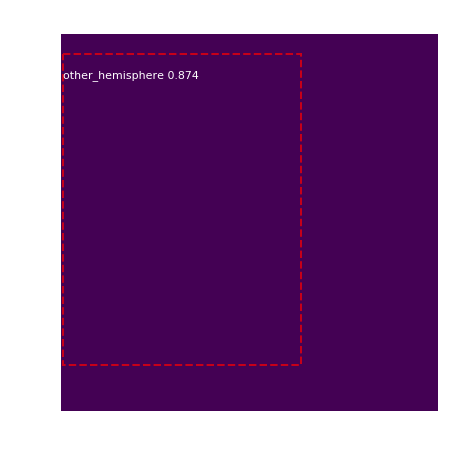

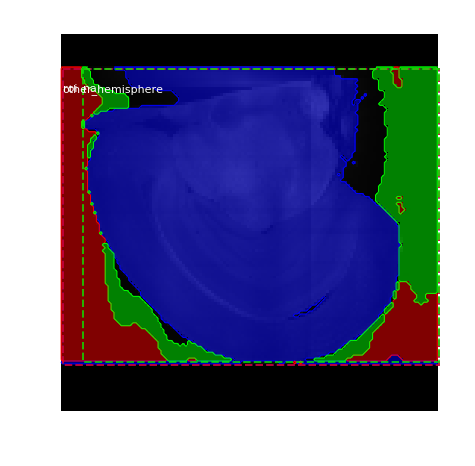

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   98.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:   -5.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 32%|███▏      | 131/404 [03:50<07:34,  1.67s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   81.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  355.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


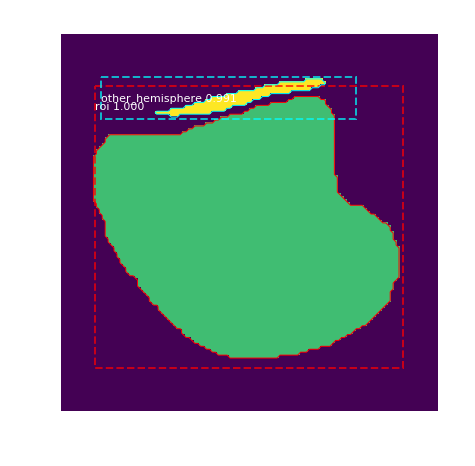

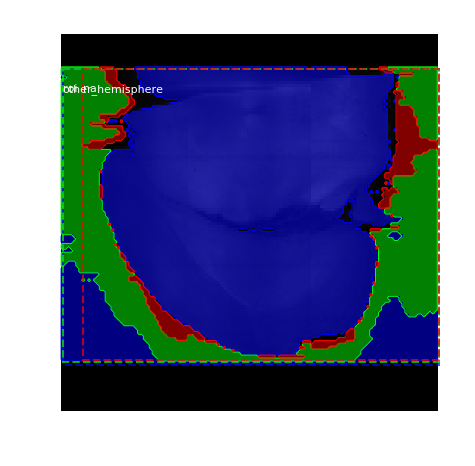

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   81.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -22.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 33%|███▎      | 132/404 [03:52<07:28,  1.65s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   73.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


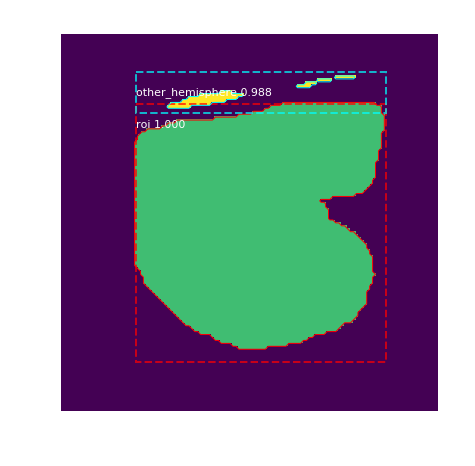

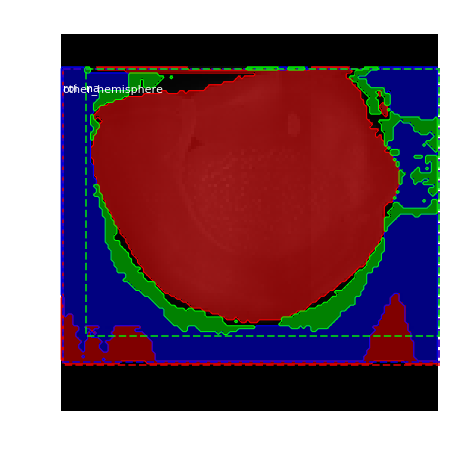

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   73.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -30.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 33%|███▎      | 133/404 [03:53<07:27,  1.65s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   73.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


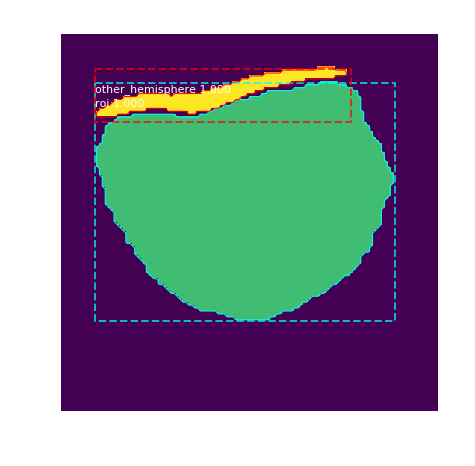

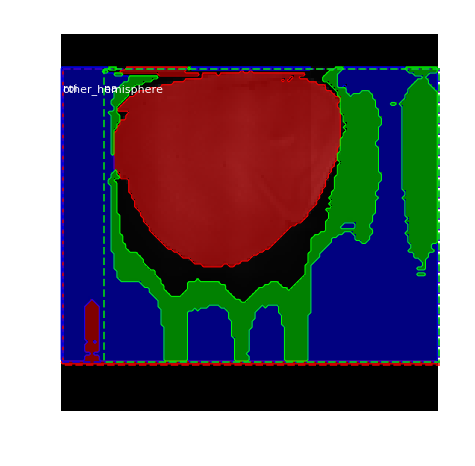

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   73.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -30.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 33%|███▎      | 134/404 [03:55<07:20,  1.63s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   77.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  369.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


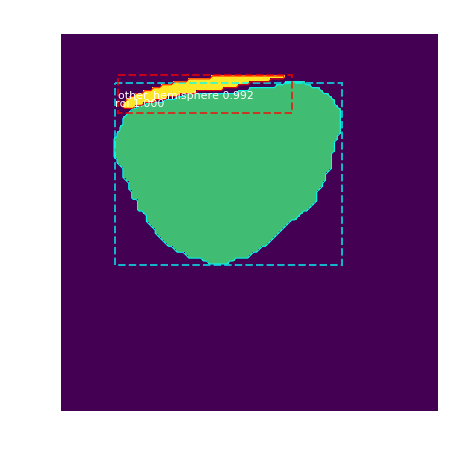

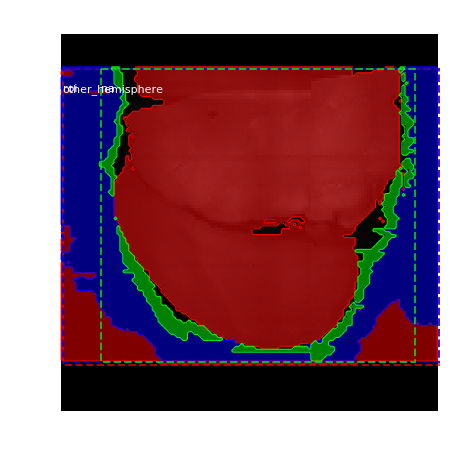

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   77.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -26.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 33%|███▎      | 135/404 [03:57<07:23,  1.65s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   64.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


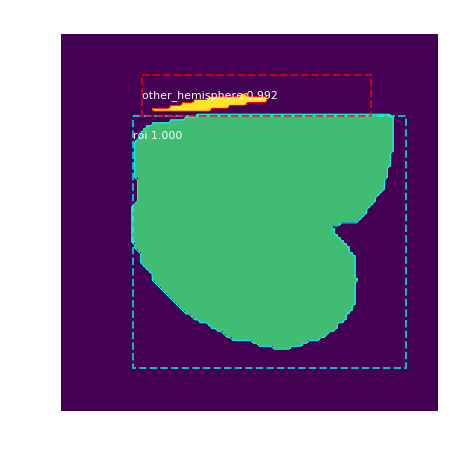

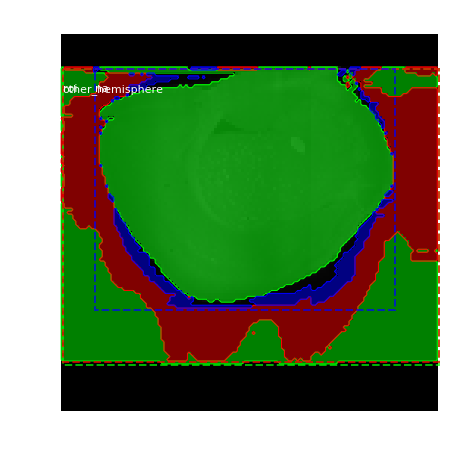

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   64.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -39.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 34%|███▎      | 136/404 [03:58<07:30,  1.68s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:  107.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


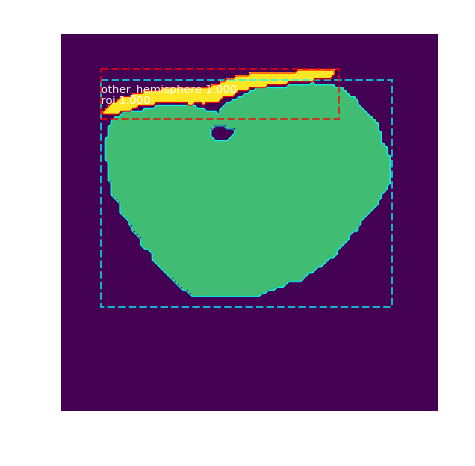

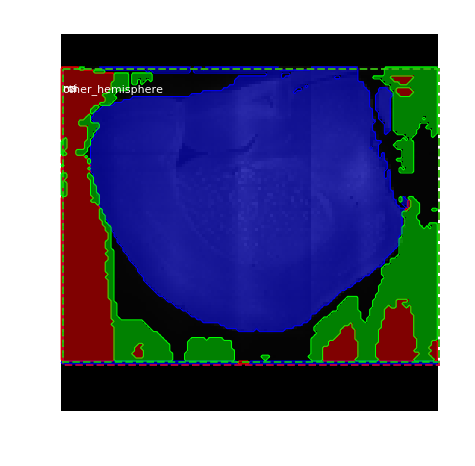

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:  107.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:    3.10000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 34%|███▍      | 137/404 [04:00<07:47,  1.75s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   72.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


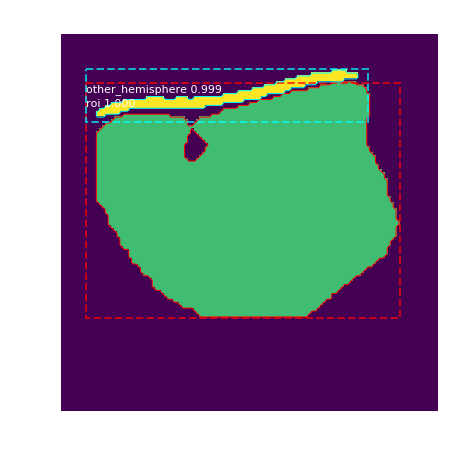

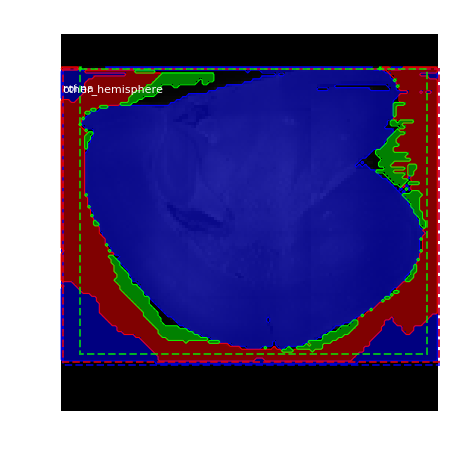

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   72.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -31.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 34%|███▍      | 138/404 [04:02<07:36,  1.72s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   83.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


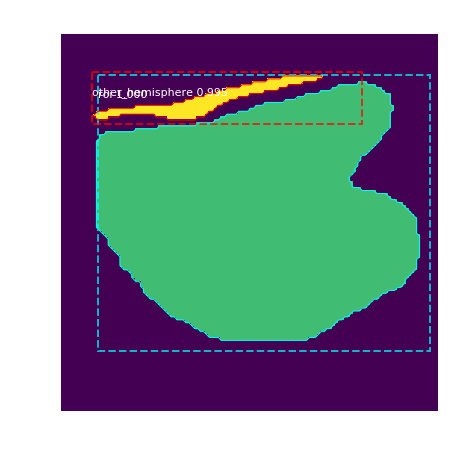

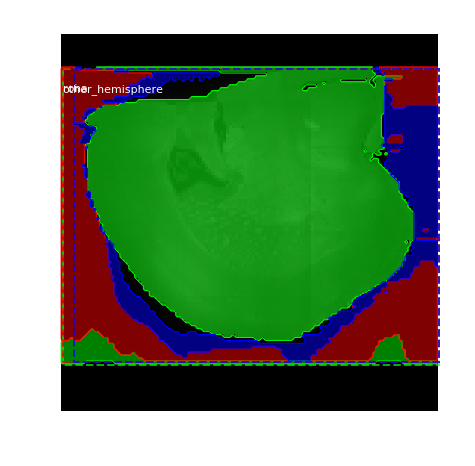

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   83.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -20.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 34%|███▍      | 139/404 [04:04<07:46,  1.76s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   96.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


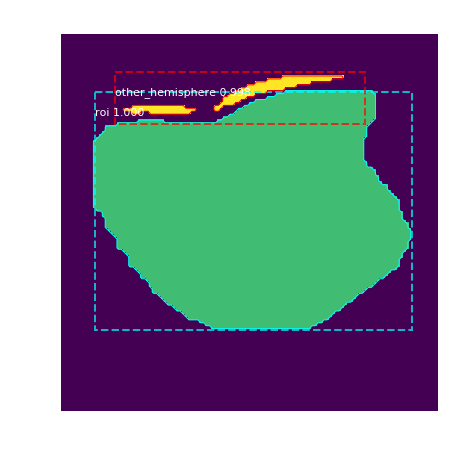

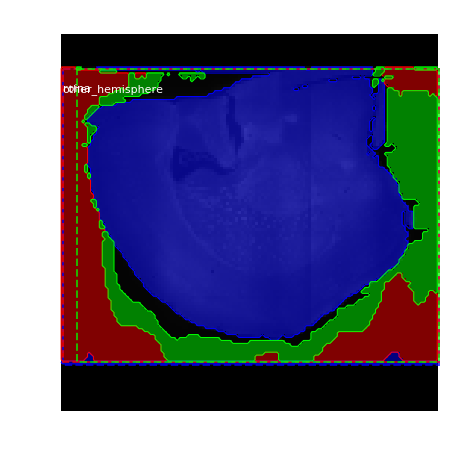

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   96.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:   -7.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 35%|███▍      | 140/404 [04:06<08:03,  1.83s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   80.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


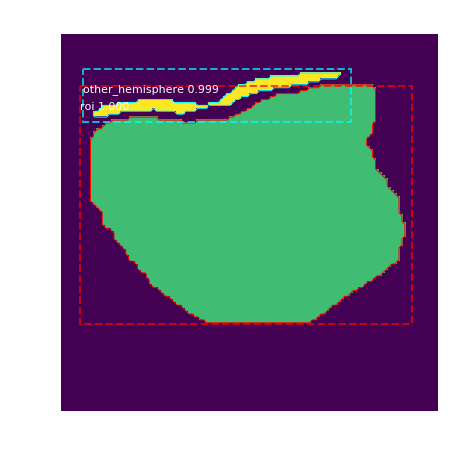

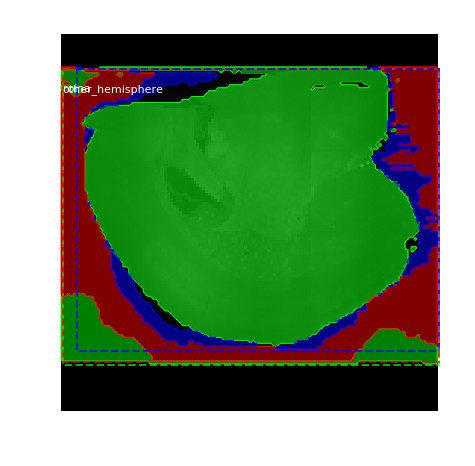

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   80.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -23.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 35%|███▍      | 141/404 [04:07<07:53,  1.80s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   72.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


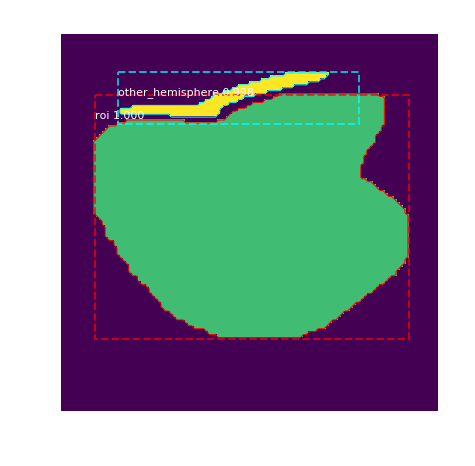

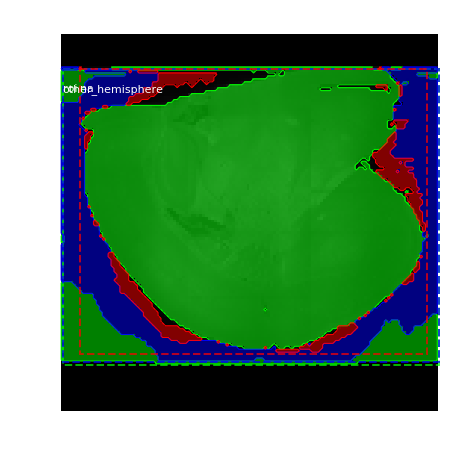

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   72.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -31.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 35%|███▌      | 142/404 [04:09<07:49,  1.79s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   66.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


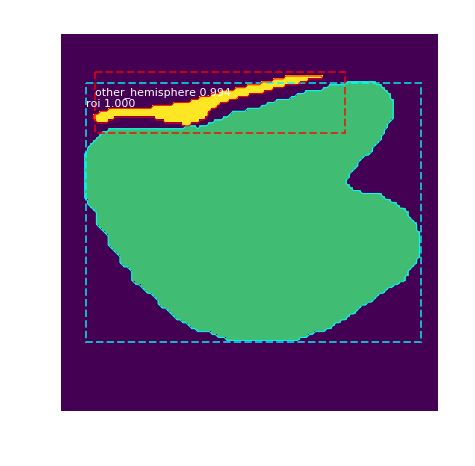

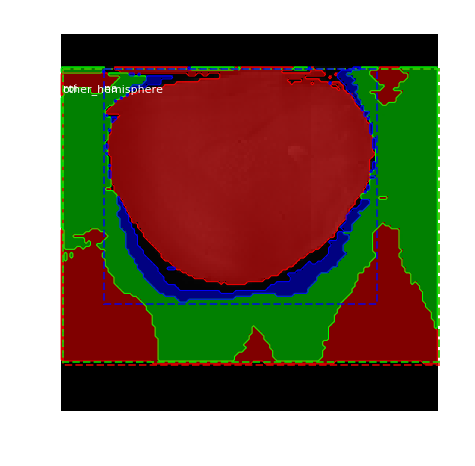

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   66.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -37.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 35%|███▌      | 143/404 [04:11<07:54,  1.82s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   69.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


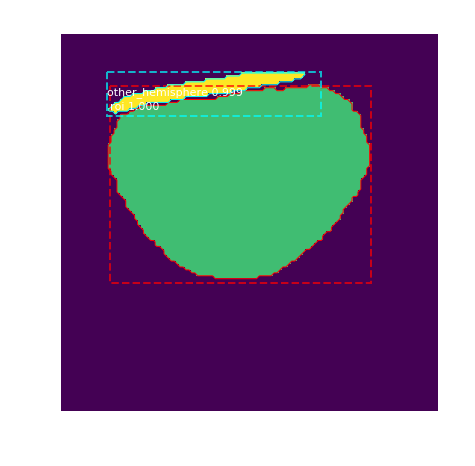

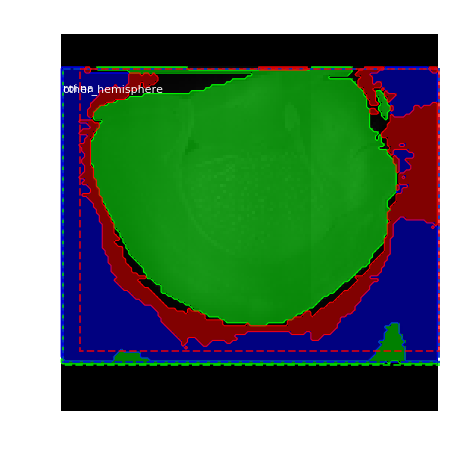

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   69.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -34.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 36%|███▌      | 144/404 [04:13<07:55,  1.83s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   70.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


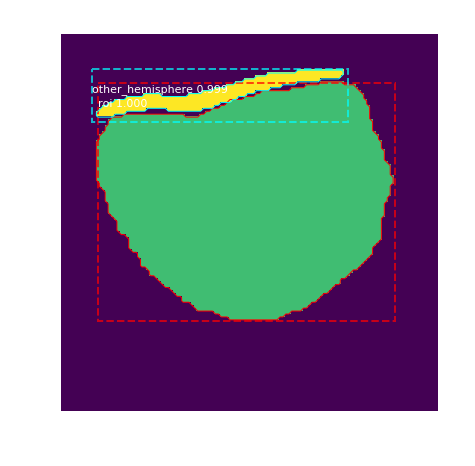

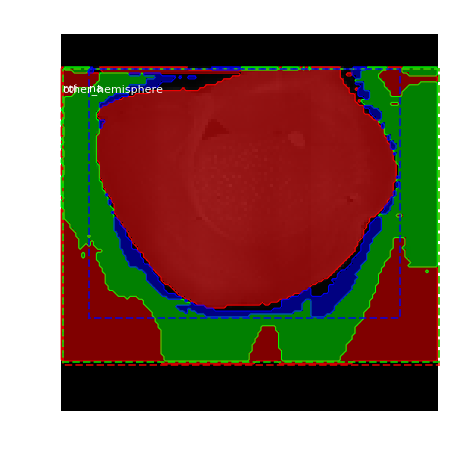

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   70.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -33.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 36%|███▌      | 145/404 [04:15<07:59,  1.85s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:  132.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  308.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


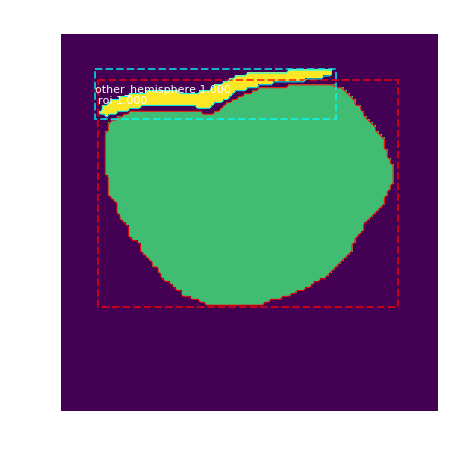

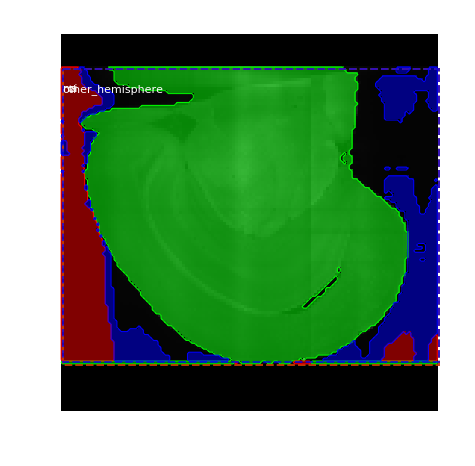

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:  132.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:   28.10000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 36%|███▌      | 146/404 [04:17<07:58,  1.86s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   73.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


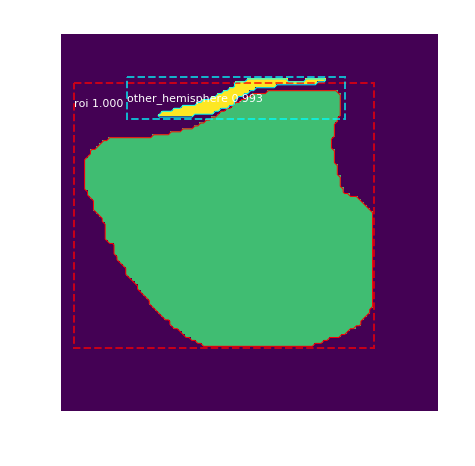

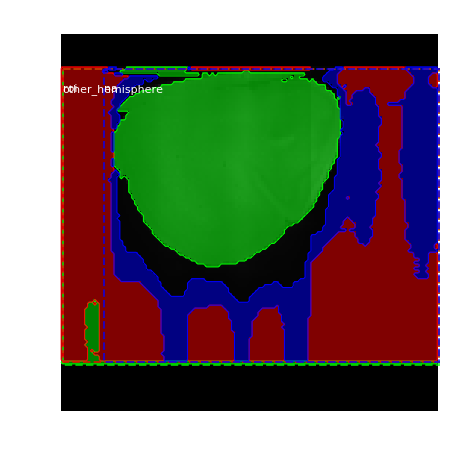

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   73.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -30.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 36%|███▋      | 147/404 [04:19<07:55,  1.85s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   65.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


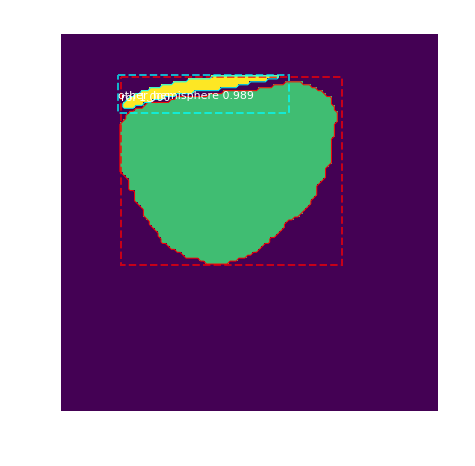

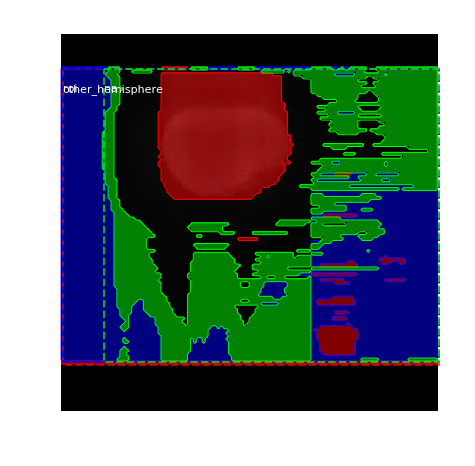

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   65.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -38.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 37%|███▋      | 148/404 [04:20<07:41,  1.80s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   87.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  329.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


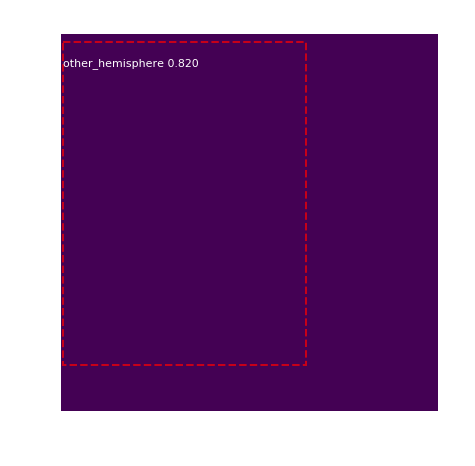

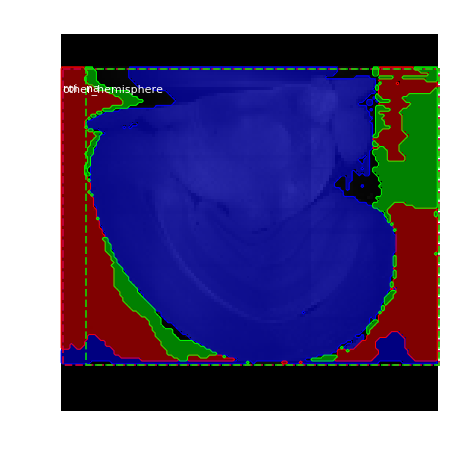

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   87.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -16.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 37%|███▋      | 149/404 [04:22<07:45,  1.83s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   48.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


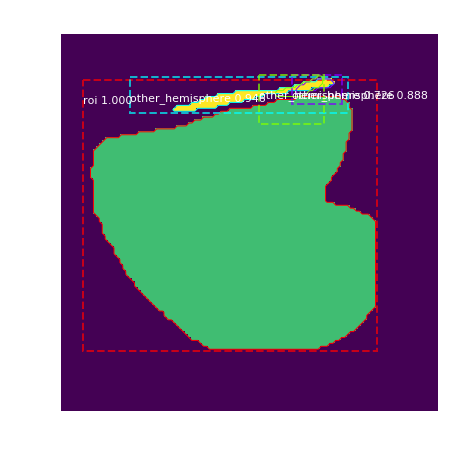

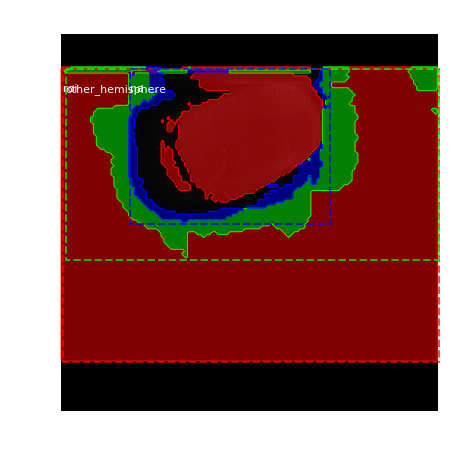

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   48.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -55.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 37%|███▋      | 150/404 [04:24<07:39,  1.81s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   73.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


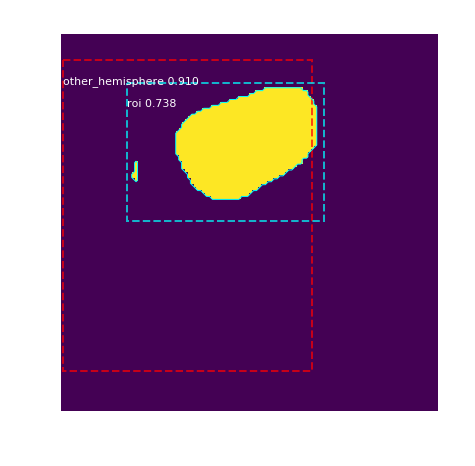

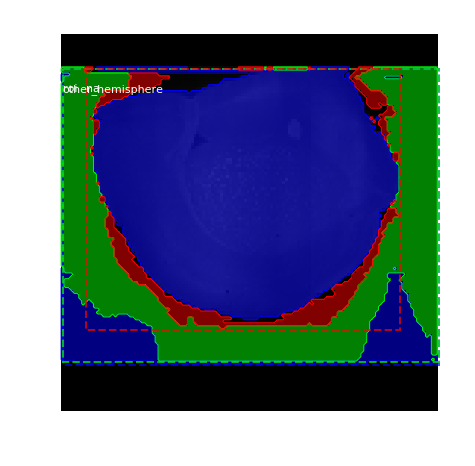

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   73.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -30.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 37%|███▋      | 151/404 [04:26<07:28,  1.77s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   62.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


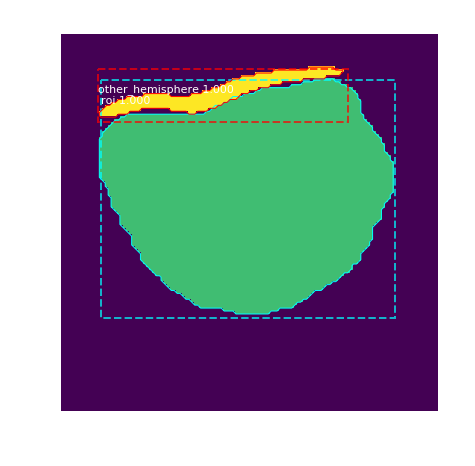

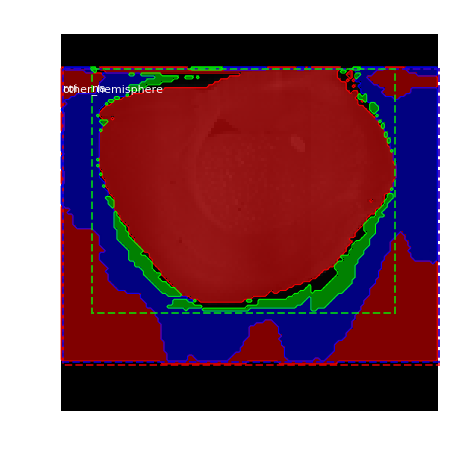

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   62.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -41.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 38%|███▊      | 152/404 [04:27<07:16,  1.73s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   80.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  333.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


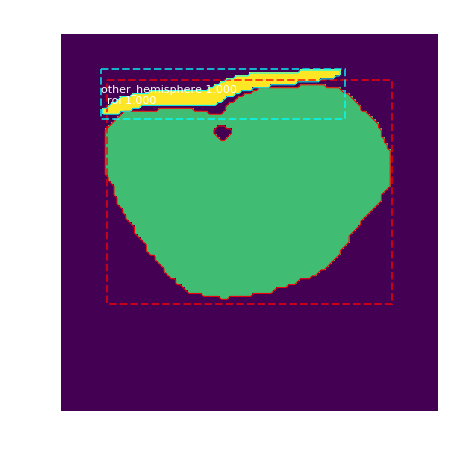

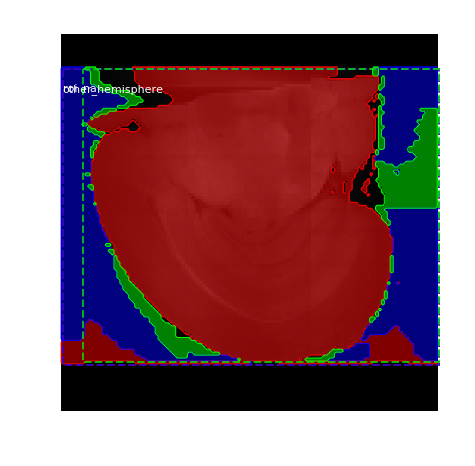

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   80.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -23.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 38%|███▊      | 153/404 [04:29<07:36,  1.82s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:  105.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


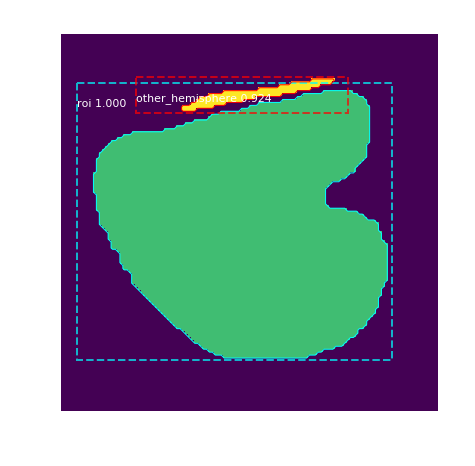

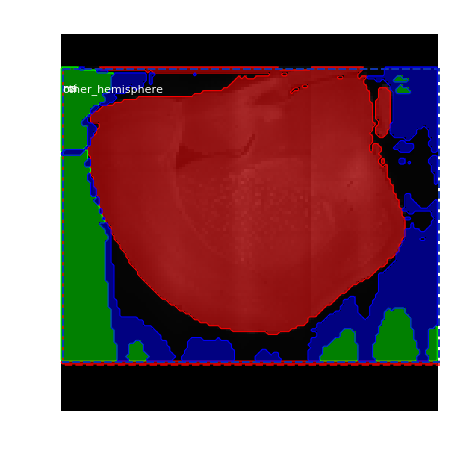

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:  105.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:    1.10000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 38%|███▊      | 154/404 [04:31<07:19,  1.76s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   73.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


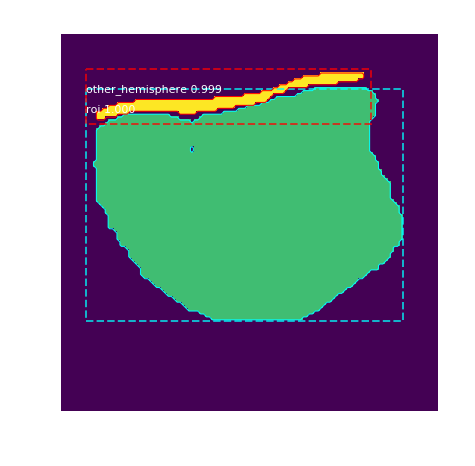

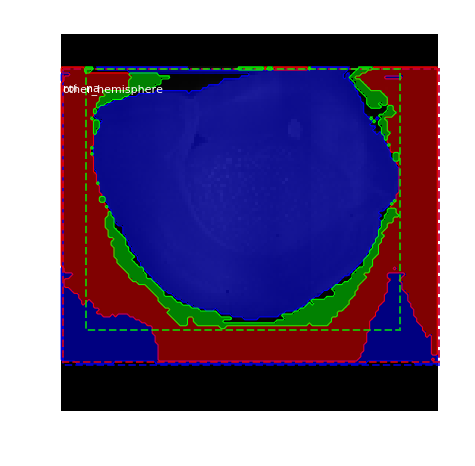

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   73.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -30.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 38%|███▊      | 155/404 [04:33<07:06,  1.71s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   47.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


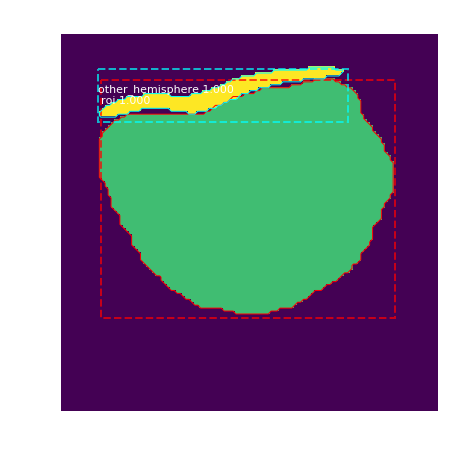

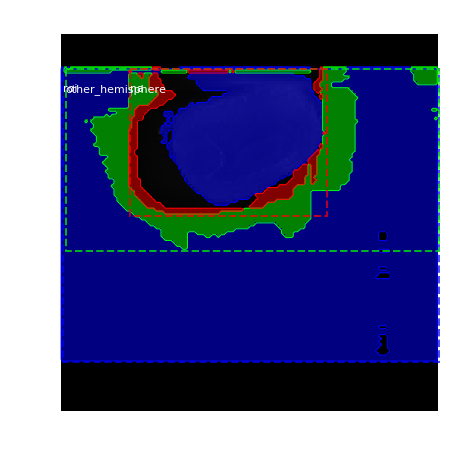

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   47.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -56.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 39%|███▊      | 156/404 [04:34<06:59,  1.69s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   72.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


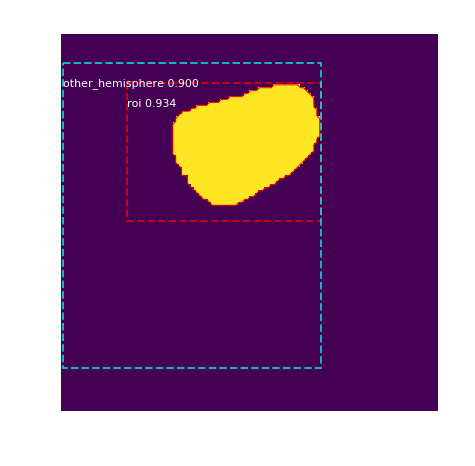

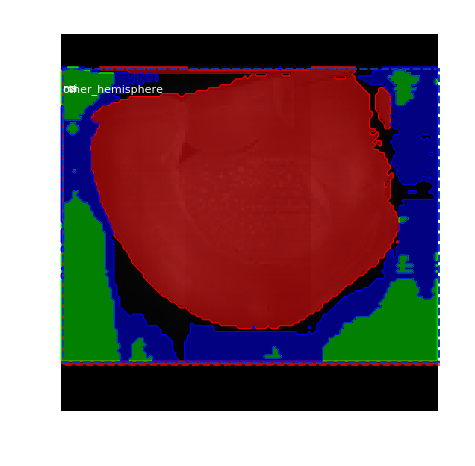

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   72.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -31.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 39%|███▉      | 157/404 [04:36<07:14,  1.76s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   45.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


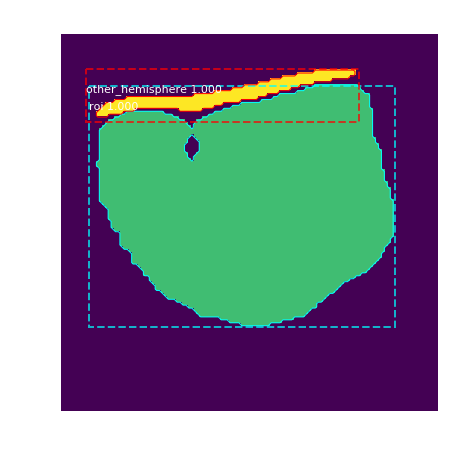

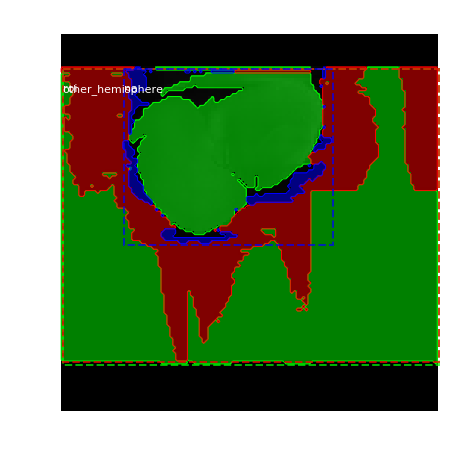

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   45.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -58.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 39%|███▉      | 158/404 [04:38<07:03,  1.72s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   67.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


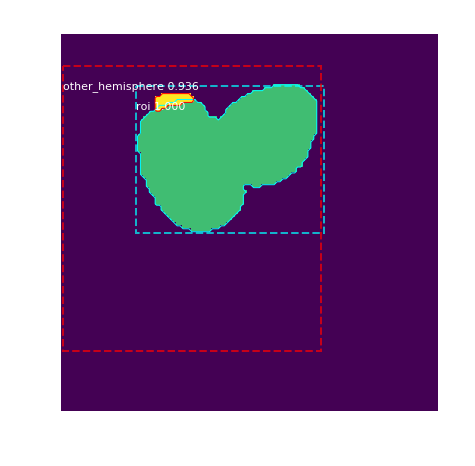

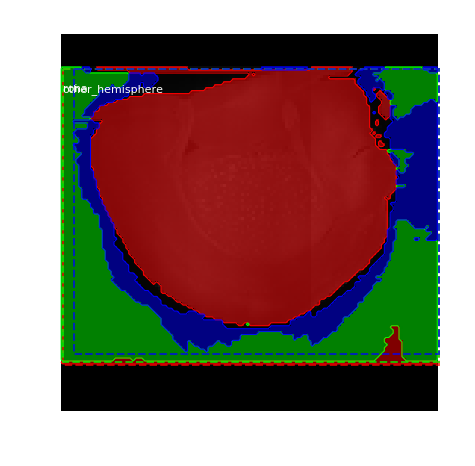

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   67.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -36.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 39%|███▉      | 159/404 [04:40<07:12,  1.77s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   51.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


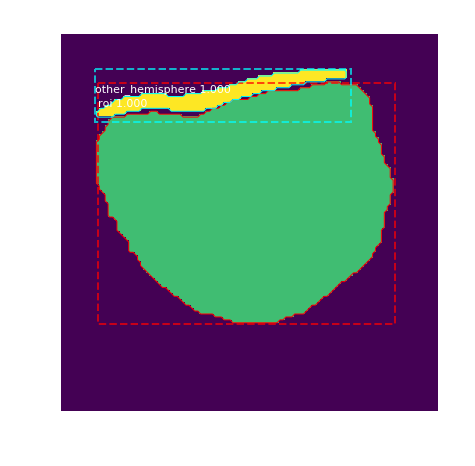

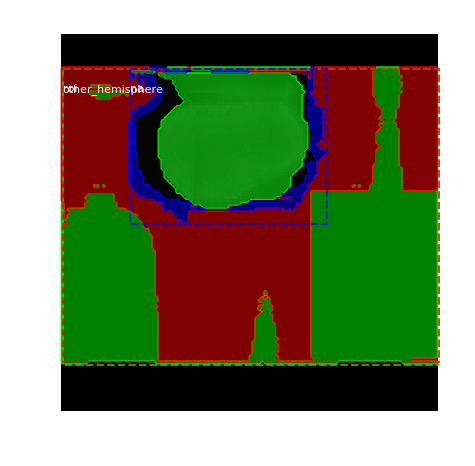

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   51.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -52.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 40%|███▉      | 160/404 [04:41<07:11,  1.77s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   46.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


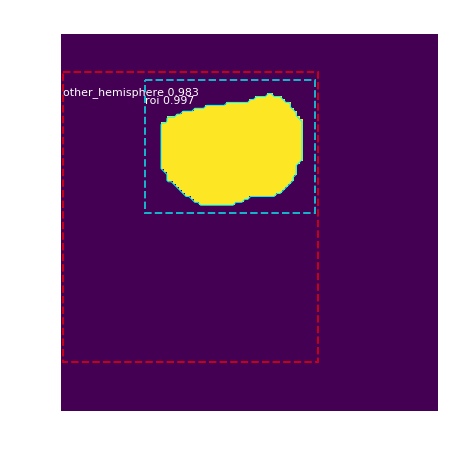

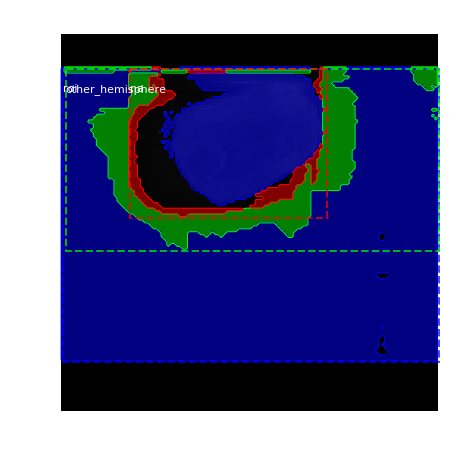

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   46.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -57.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 40%|███▉      | 161/404 [04:43<07:09,  1.77s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   58.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


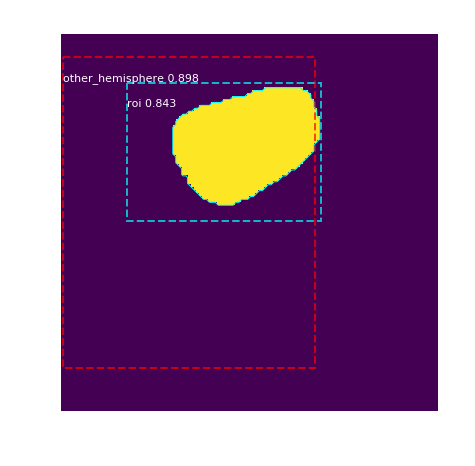

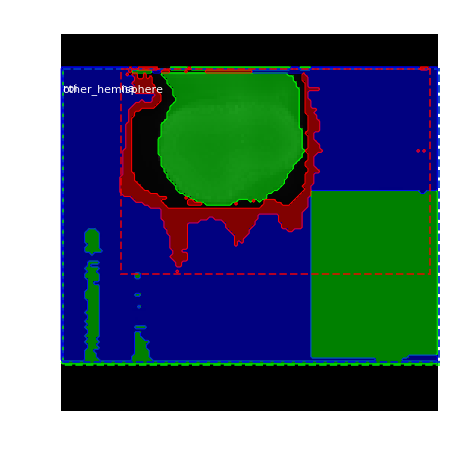

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   58.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -45.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 40%|████      | 162/404 [04:45<07:06,  1.76s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   80.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


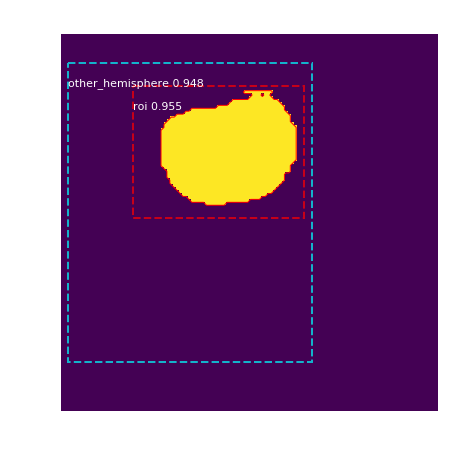

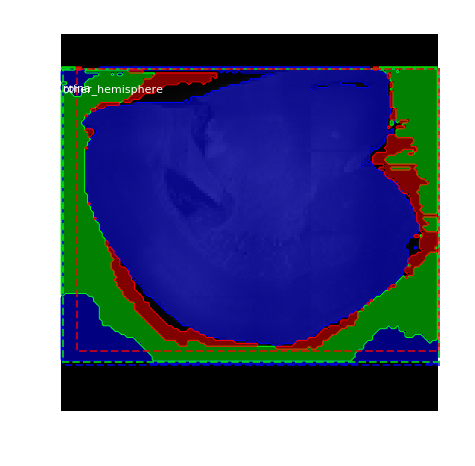

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   80.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -23.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 40%|████      | 163/404 [04:47<07:12,  1.79s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   75.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


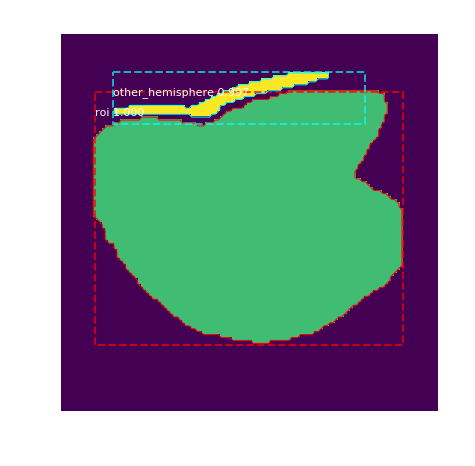

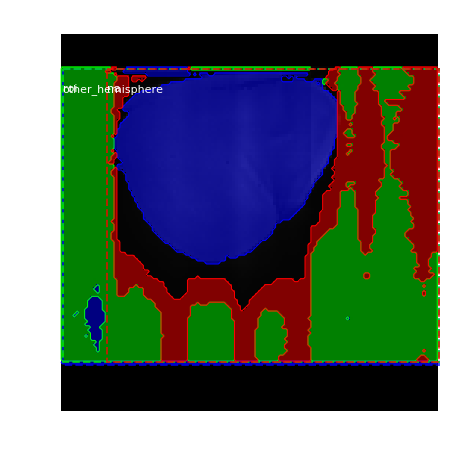

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   75.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -28.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 41%|████      | 164/404 [04:48<07:00,  1.75s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   74.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


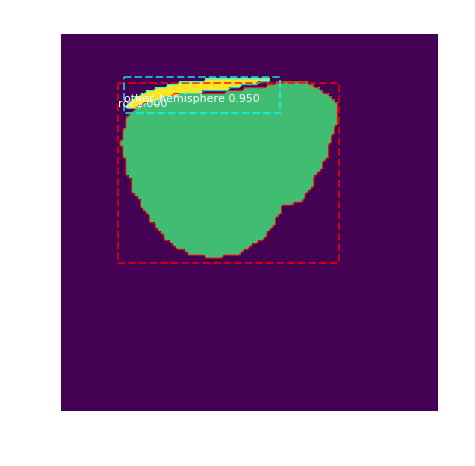

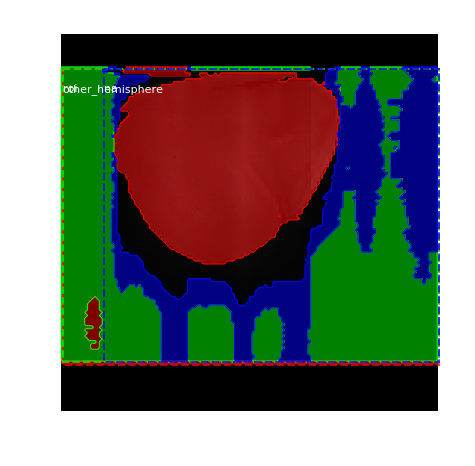

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   74.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -29.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 41%|████      | 165/404 [04:50<06:48,  1.71s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   56.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


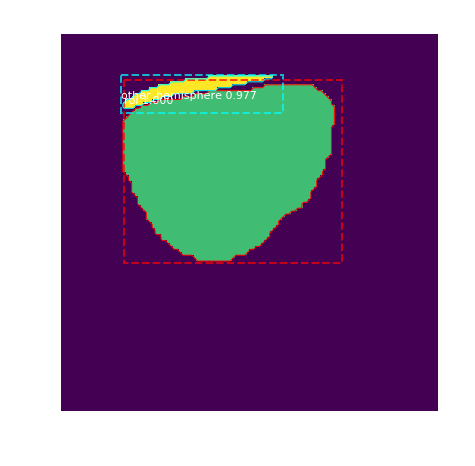

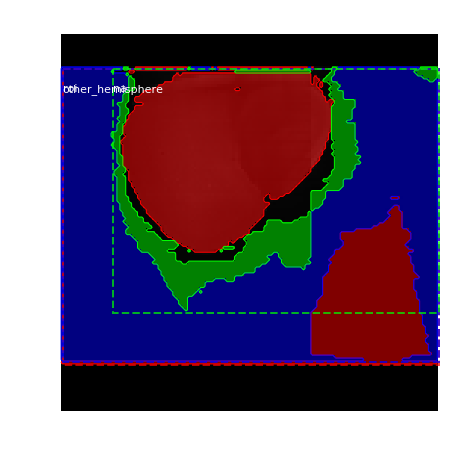

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   56.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -47.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 41%|████      | 166/404 [04:52<06:41,  1.69s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   50.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


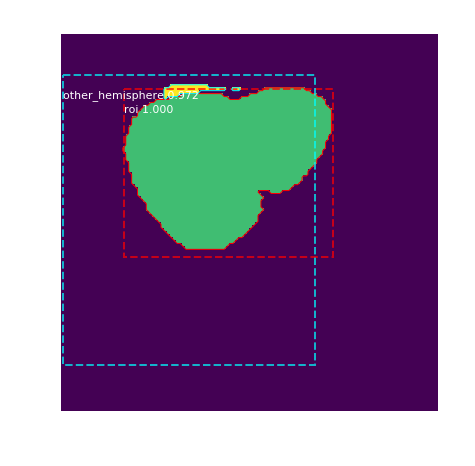

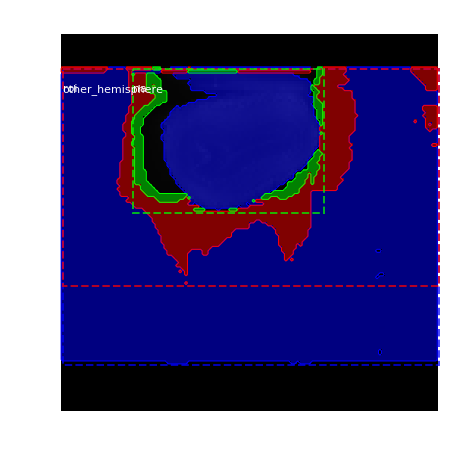

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   50.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -53.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 41%|████▏     | 167/404 [04:53<06:51,  1.74s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   84.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  331.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


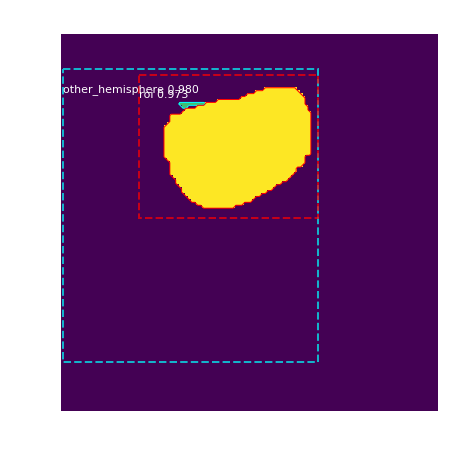

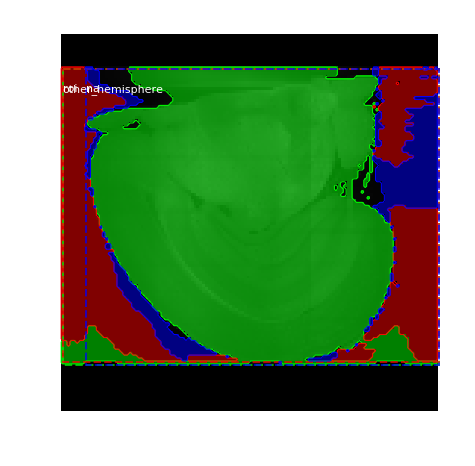

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   84.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -19.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 42%|████▏     | 168/404 [04:55<06:51,  1.75s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   96.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  390.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


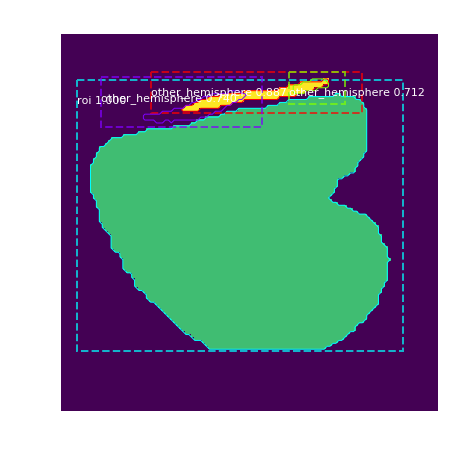

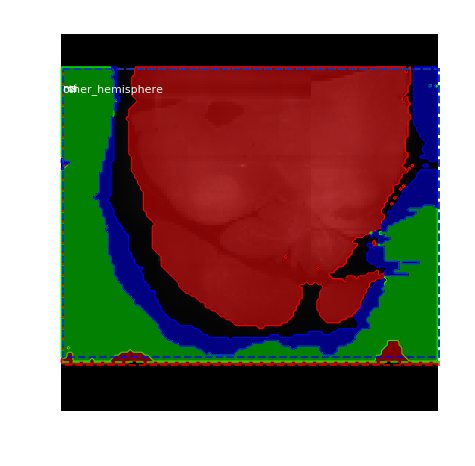

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   96.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:   -7.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 42%|████▏     | 169/404 [04:57<06:59,  1.78s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   75.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  287.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


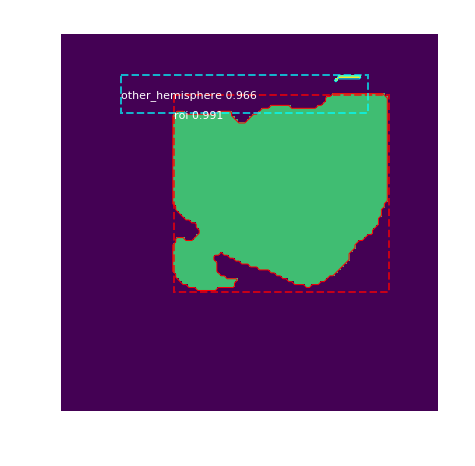

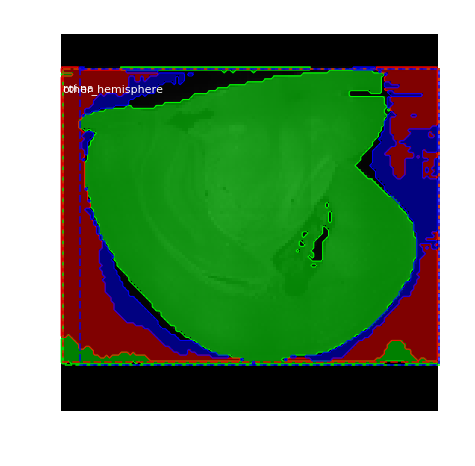

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   75.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -28.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 42%|████▏     | 170/404 [04:59<07:00,  1.80s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   88.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  375.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


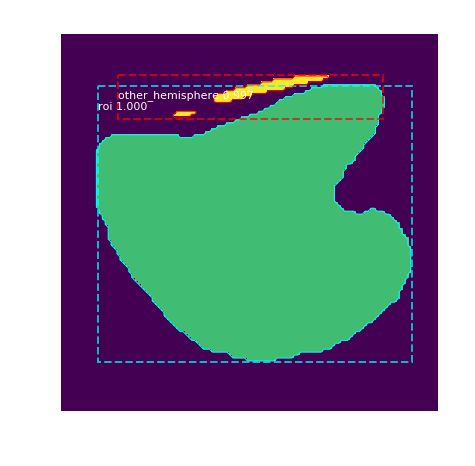

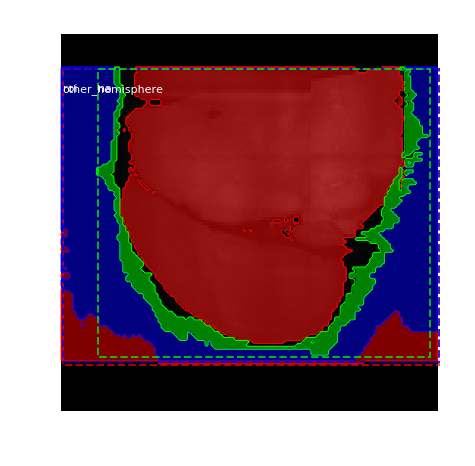

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   88.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -15.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 42%|████▏     | 171/404 [05:01<07:01,  1.81s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   90.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


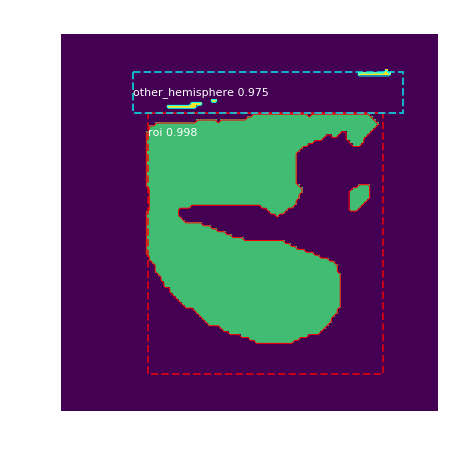

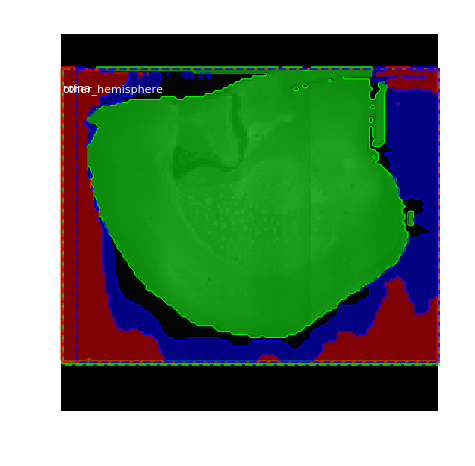

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   90.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -13.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 43%|████▎     | 172/404 [05:03<06:59,  1.81s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   66.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


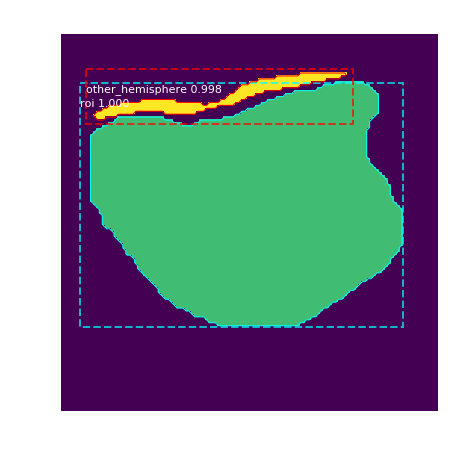

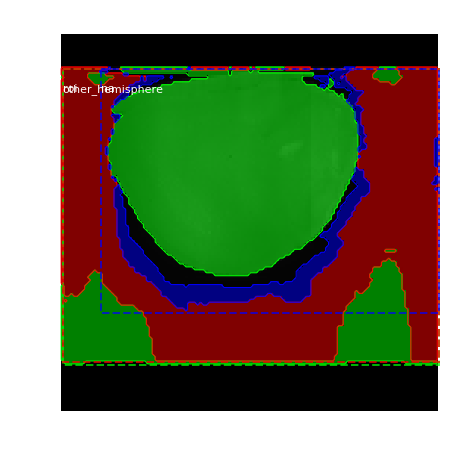

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   66.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -37.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 43%|████▎     | 173/404 [05:04<06:58,  1.81s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:  109.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  306.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


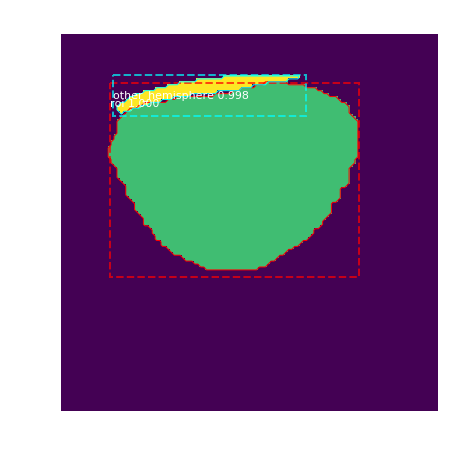

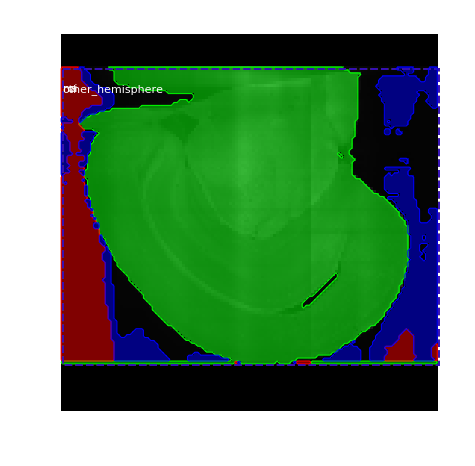

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:  109.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:    5.10000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 43%|████▎     | 174/404 [05:06<06:54,  1.80s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   50.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


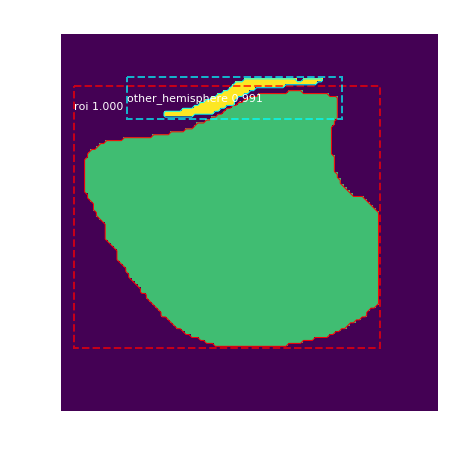

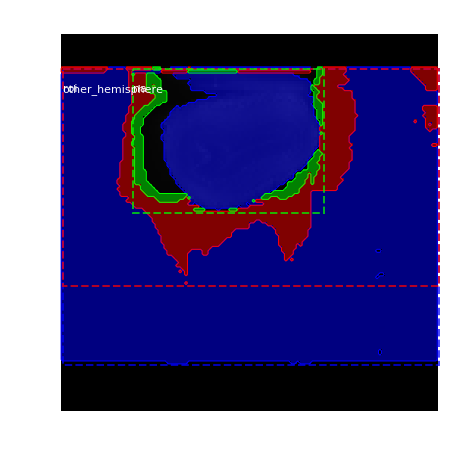

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   50.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -53.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 43%|████▎     | 175/404 [05:08<06:53,  1.81s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   80.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


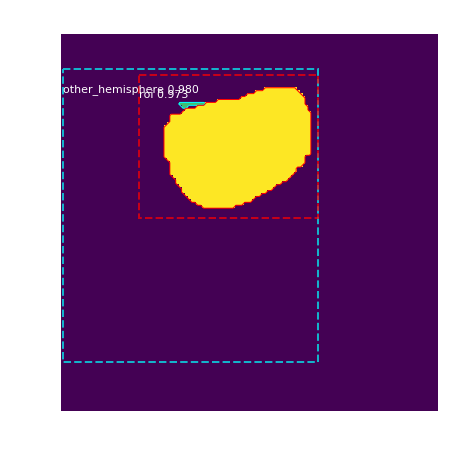

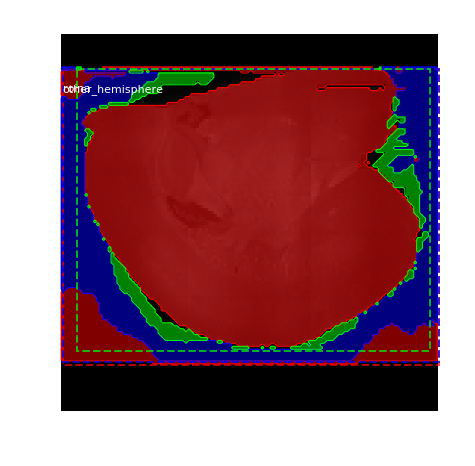

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   80.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -23.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 44%|████▎     | 176/404 [05:10<06:52,  1.81s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   79.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  356.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


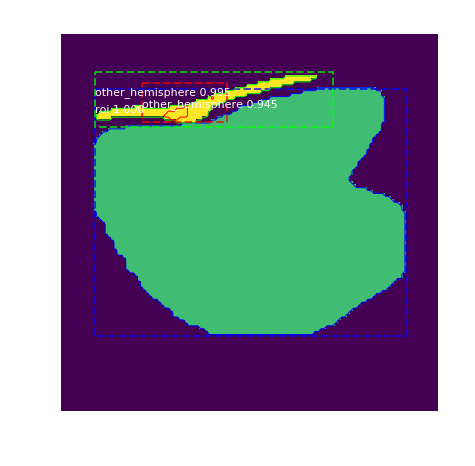

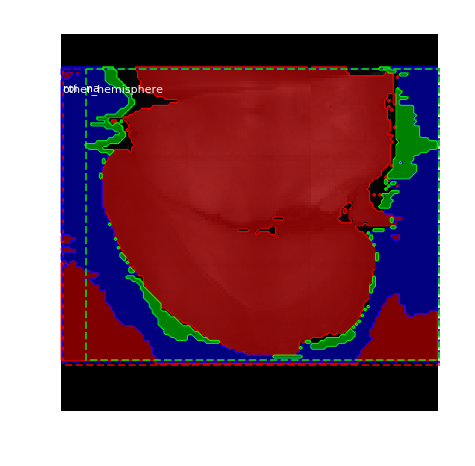

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   79.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -24.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 44%|████▍     | 177/404 [05:12<06:59,  1.85s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:  103.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  317.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


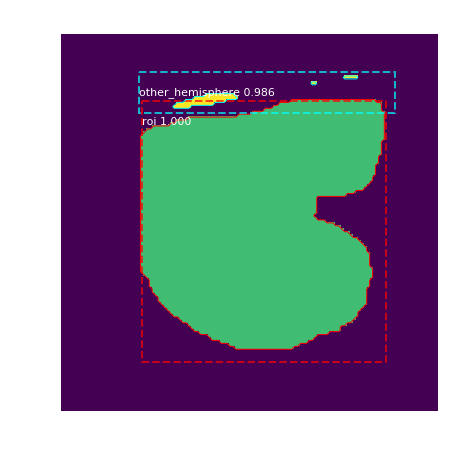

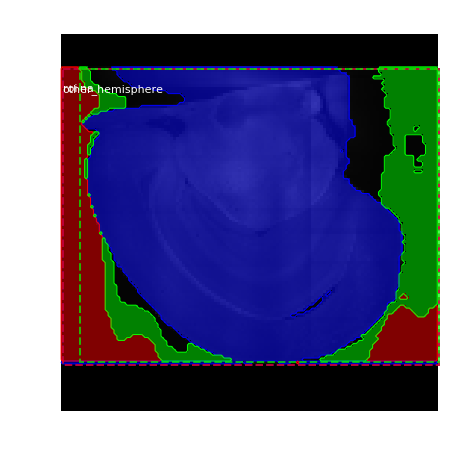

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:  103.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:   -0.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 44%|████▍     | 178/404 [05:14<06:50,  1.82s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   49.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


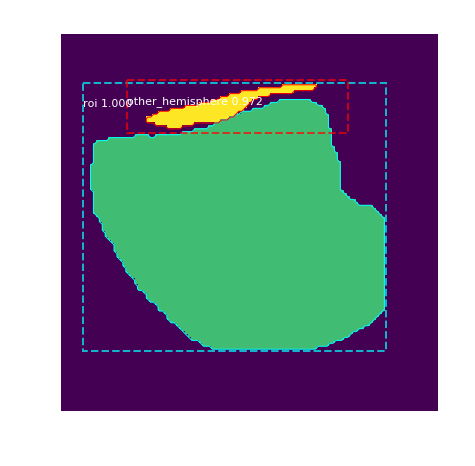

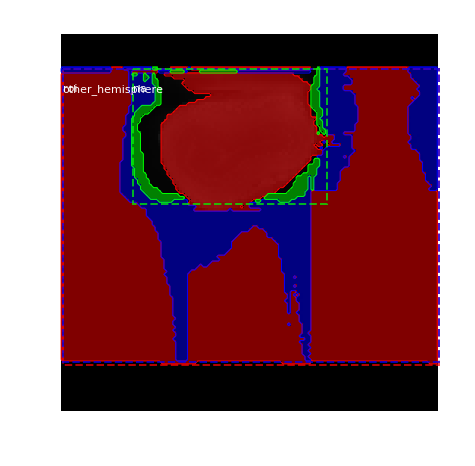

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   49.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -54.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 44%|████▍     | 179/404 [05:15<06:45,  1.80s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   81.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


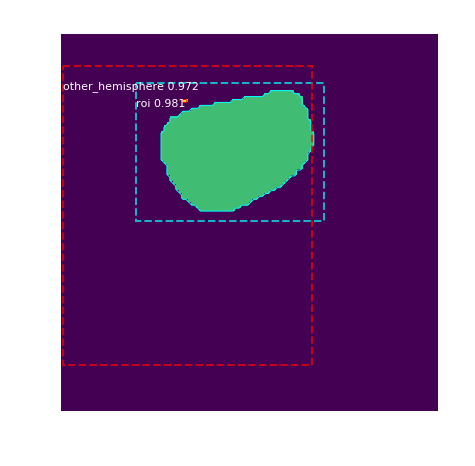

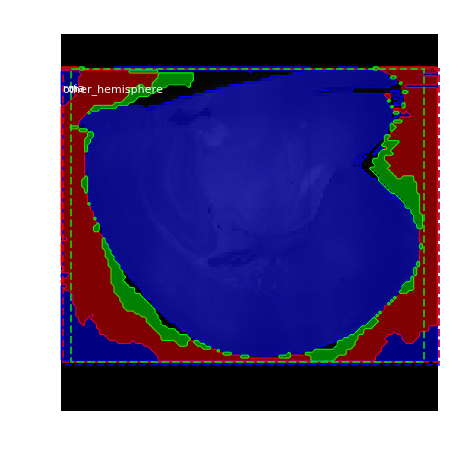

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   81.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -22.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 45%|████▍     | 180/404 [05:17<06:43,  1.80s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:  108.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


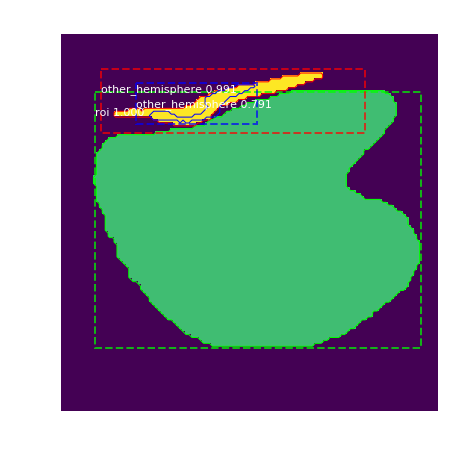

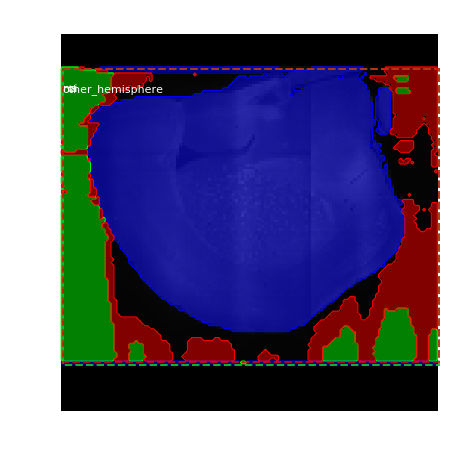

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:  108.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:    4.10000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 45%|████▍     | 181/404 [05:19<06:43,  1.81s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   88.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  375.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


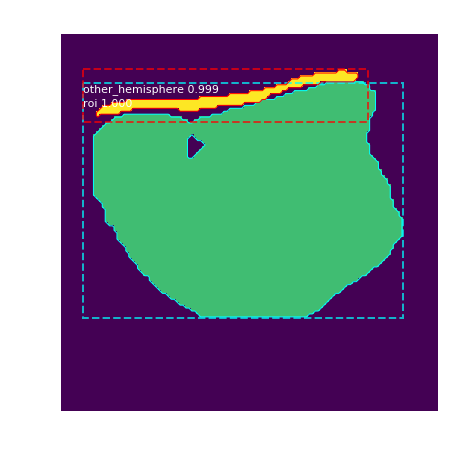

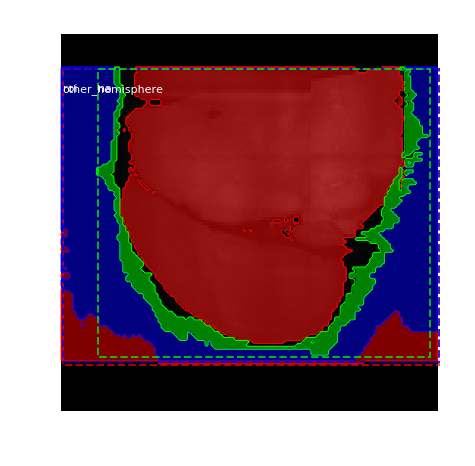

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   88.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -15.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 45%|████▌     | 182/404 [05:21<06:42,  1.81s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   91.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  401.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


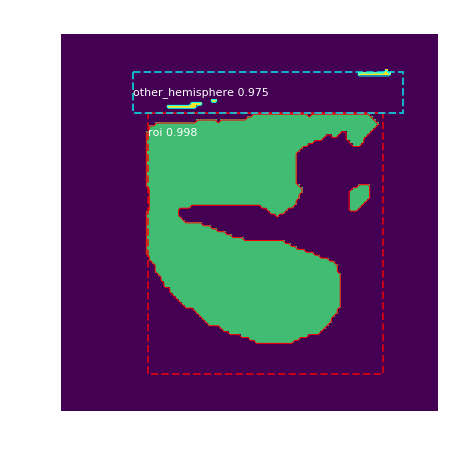

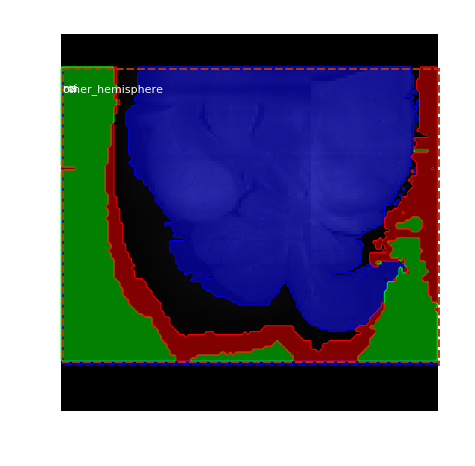

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   91.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -12.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 45%|████▌     | 183/404 [05:23<06:44,  1.83s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:  102.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


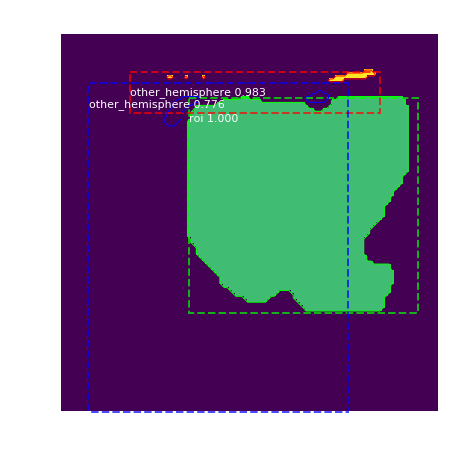

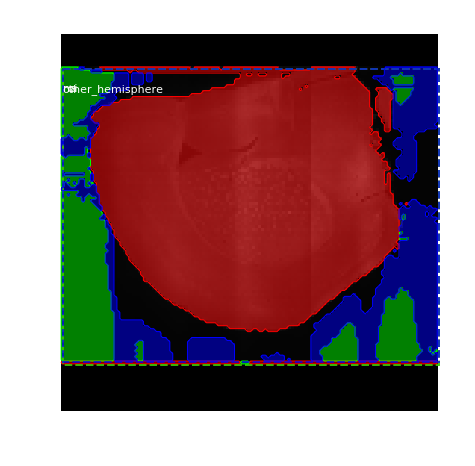

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:  102.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:   -1.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 46%|████▌     | 184/404 [05:24<06:44,  1.84s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   48.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


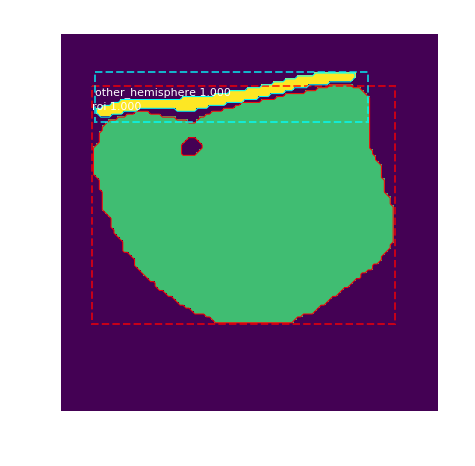

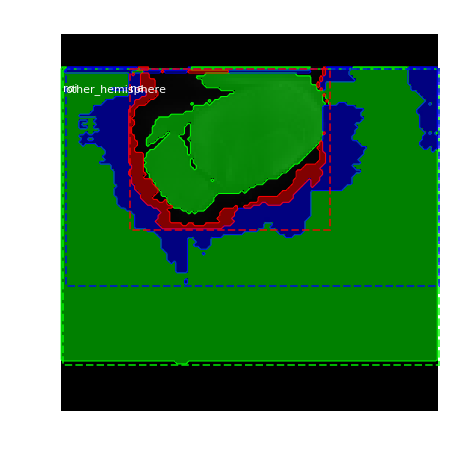

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   48.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -55.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 46%|████▌     | 185/404 [05:26<06:42,  1.84s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   81.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


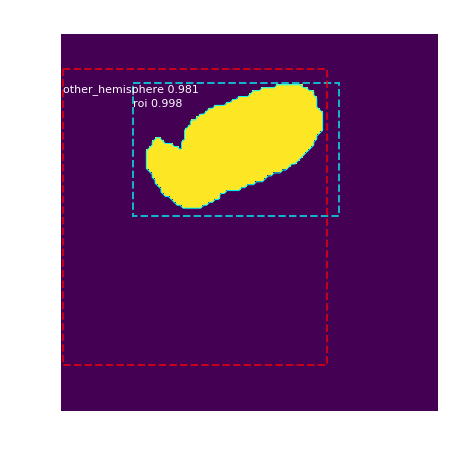

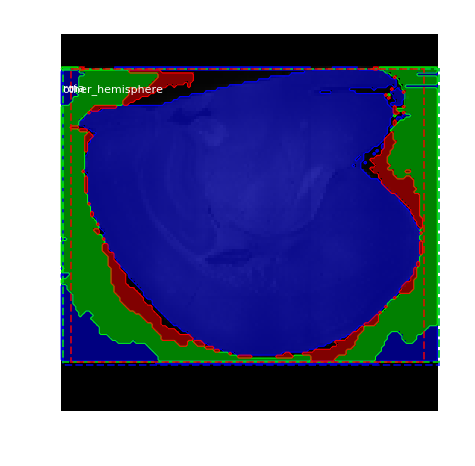

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   81.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -22.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 46%|████▌     | 186/404 [05:28<06:42,  1.84s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   65.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


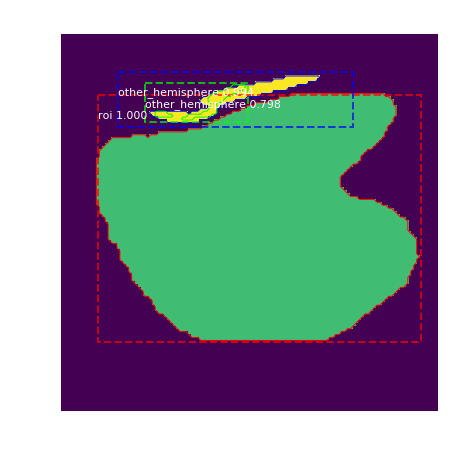

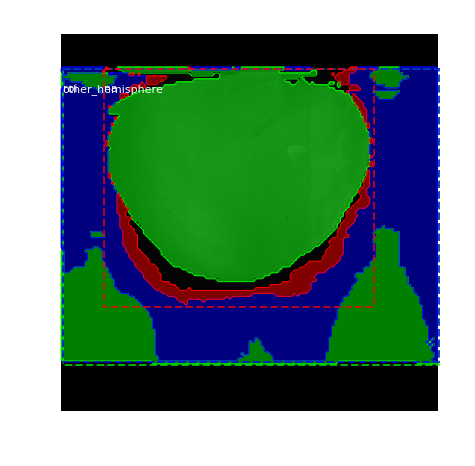

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   65.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -38.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 46%|████▋     | 187/404 [05:30<06:43,  1.86s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:  108.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


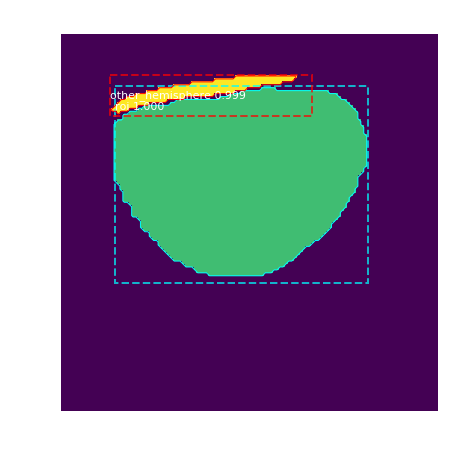

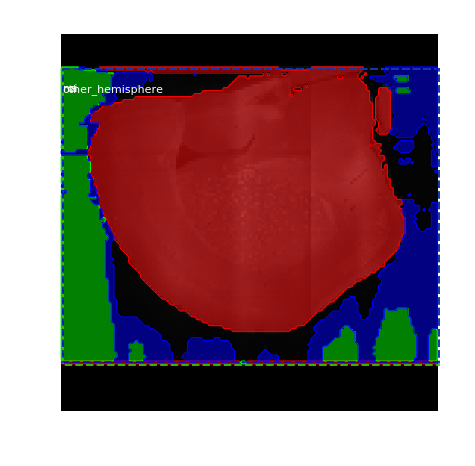

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:  108.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:    4.10000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 47%|████▋     | 188/404 [05:32<06:38,  1.84s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   43.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


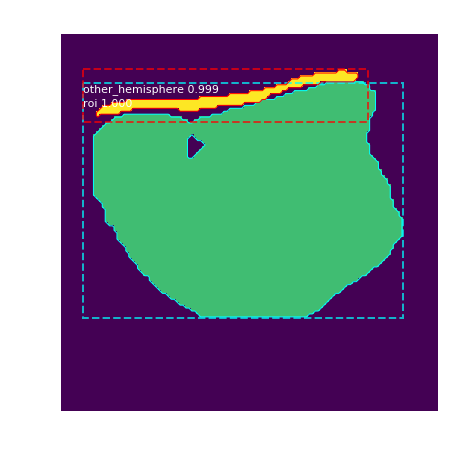

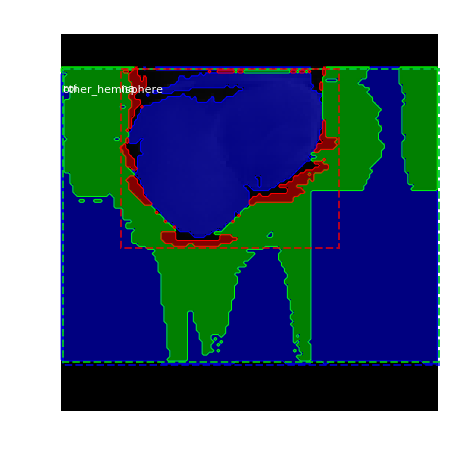

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   43.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -60.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 47%|████▋     | 189/404 [05:34<06:40,  1.86s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   55.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


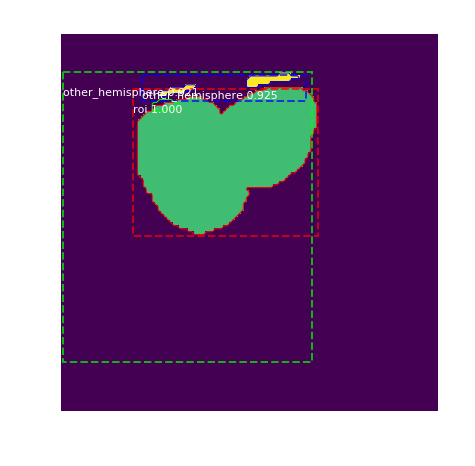

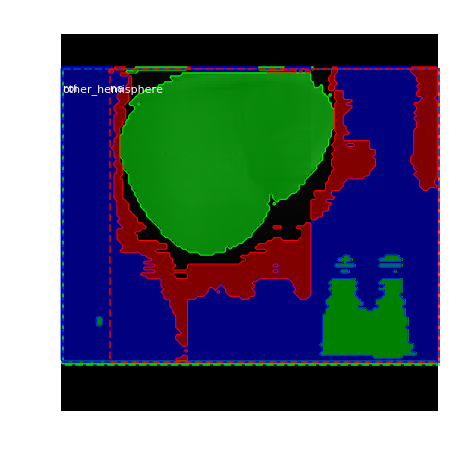

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   55.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -48.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 47%|████▋     | 190/404 [05:36<06:50,  1.92s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:  103.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  324.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


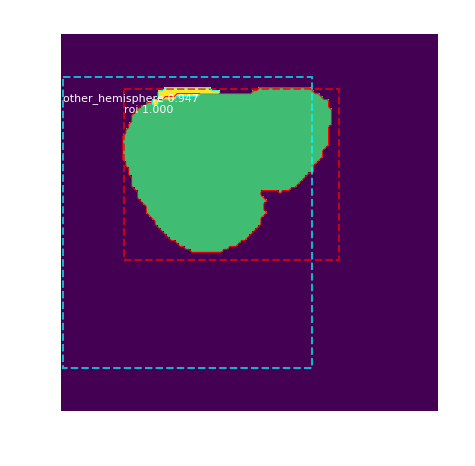

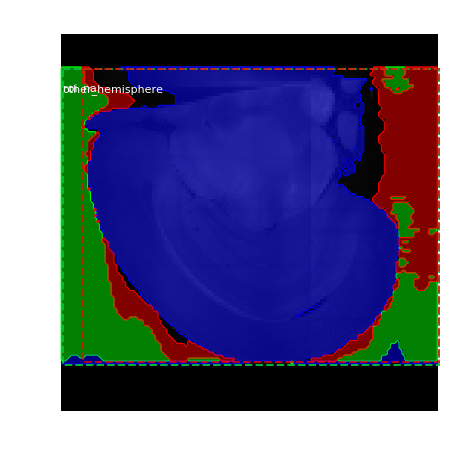

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:  103.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:   -0.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 47%|████▋     | 191/404 [05:38<07:02,  1.98s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   66.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


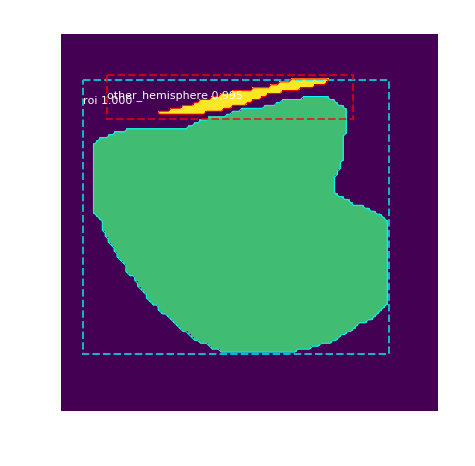

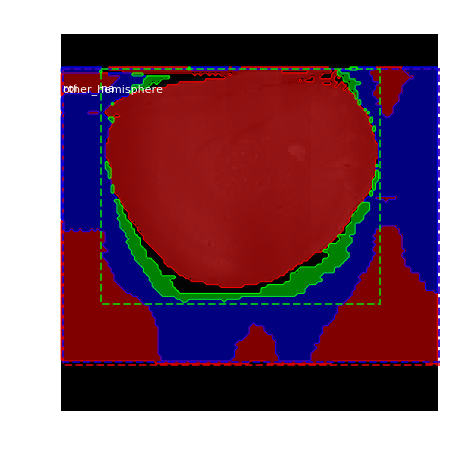

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   66.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -37.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 48%|████▊     | 192/404 [05:40<06:46,  1.92s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   85.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  332.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


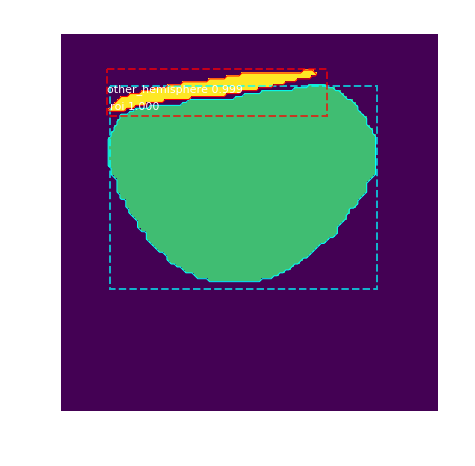

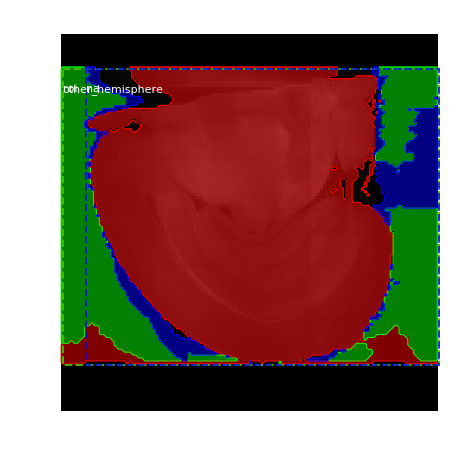

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   85.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -18.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 48%|████▊     | 193/404 [05:42<06:39,  1.89s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:  103.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  324.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


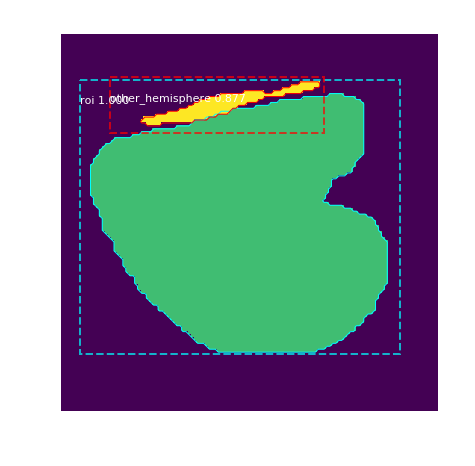

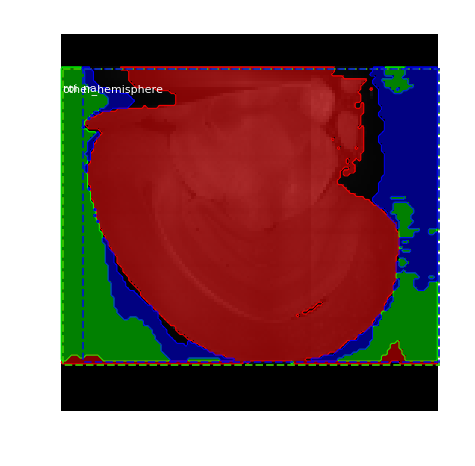

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:  103.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:   -0.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 48%|████▊     | 194/404 [05:43<06:25,  1.84s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   97.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  394.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


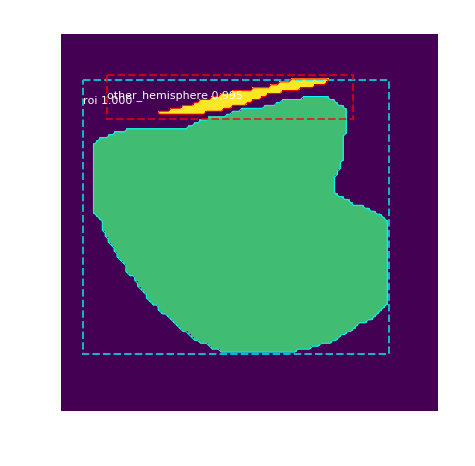

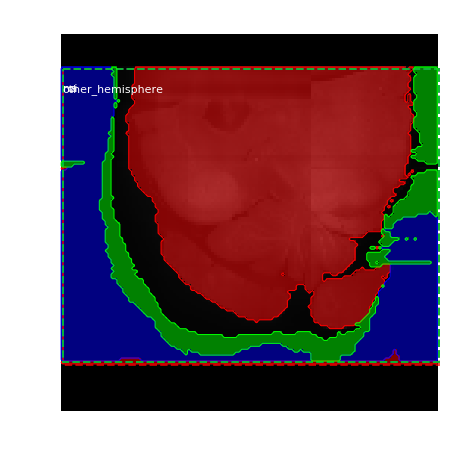

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   97.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:   -6.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 48%|████▊     | 195/404 [05:45<06:15,  1.80s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   70.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


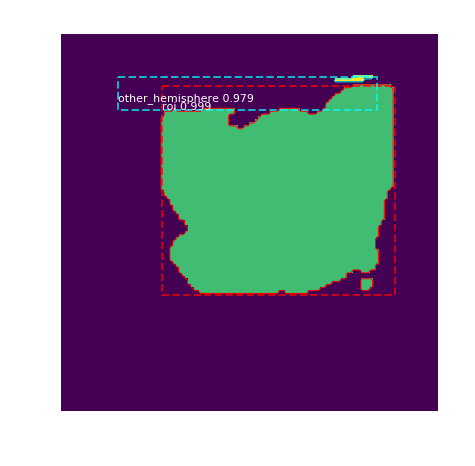

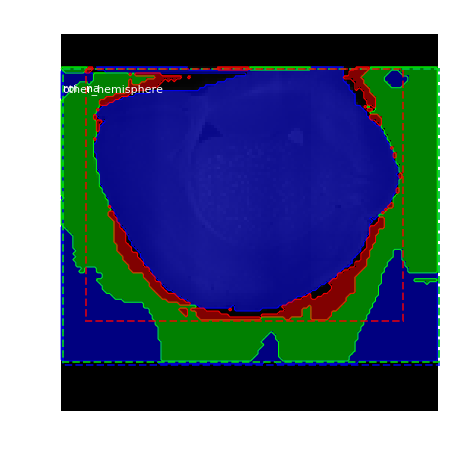

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   70.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -33.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 49%|████▊     | 196/404 [05:47<06:17,  1.81s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   62.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


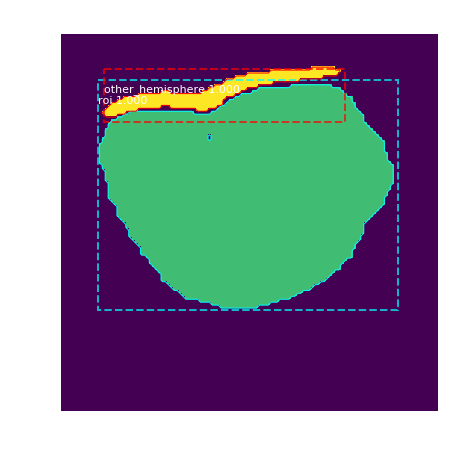

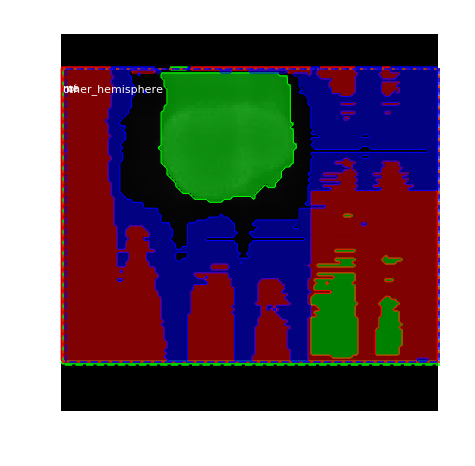

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   62.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -41.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 49%|████▉     | 197/404 [05:49<06:17,  1.83s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   84.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  341.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


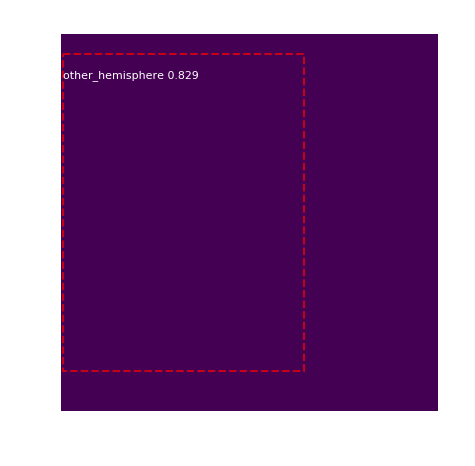

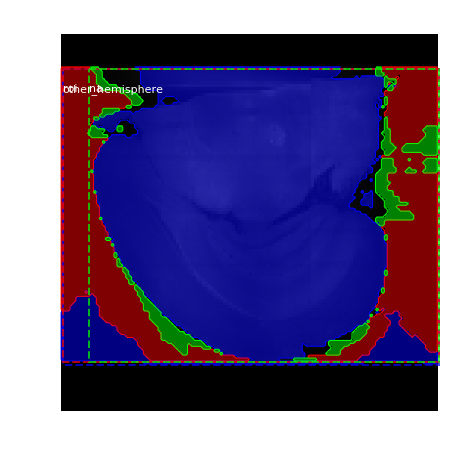

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   84.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -19.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 49%|████▉     | 198/404 [05:50<06:07,  1.79s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:  105.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


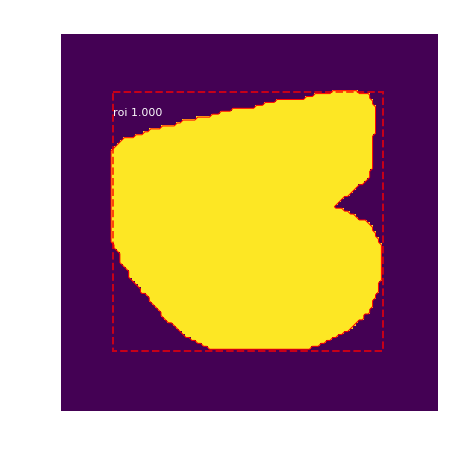

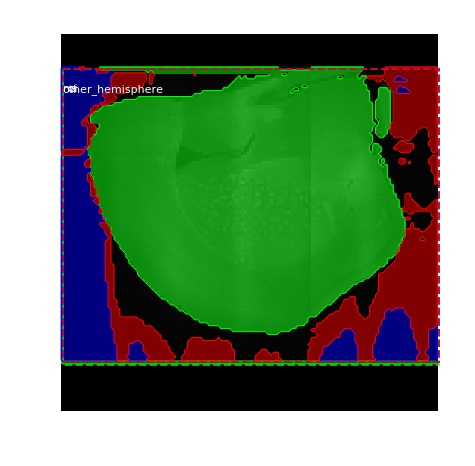

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:  105.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:    1.10000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 49%|████▉     | 199/404 [05:52<05:55,  1.73s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   67.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


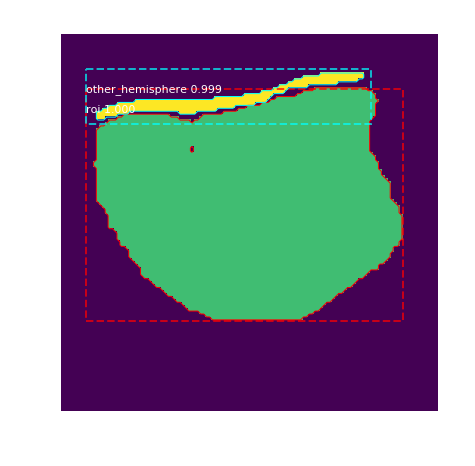

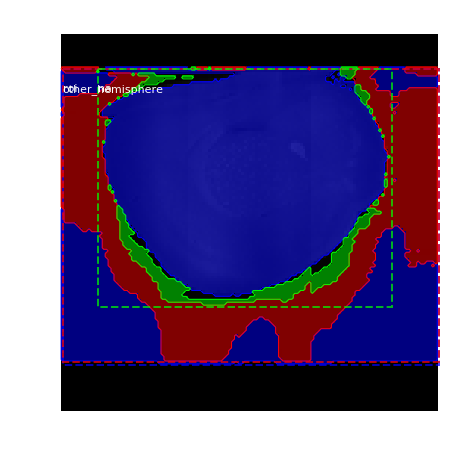

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   67.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -36.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 50%|████▉     | 200/404 [05:54<05:49,  1.71s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   83.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


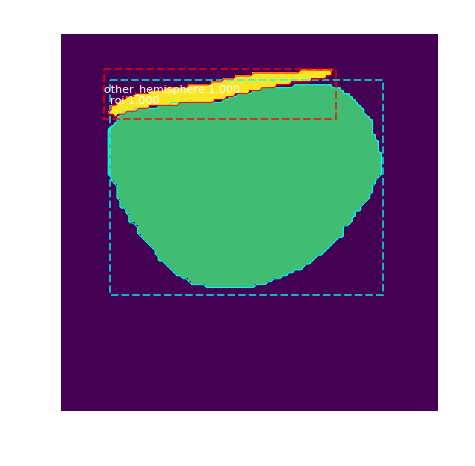

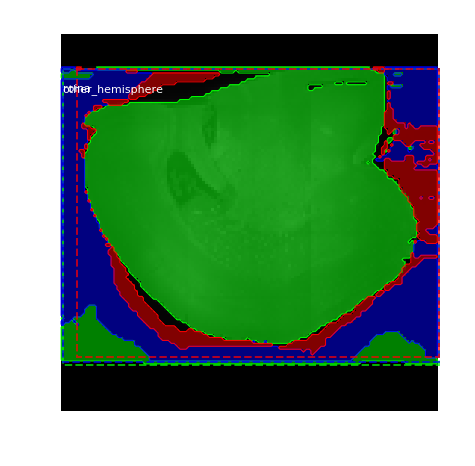

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   83.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -20.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 50%|████▉     | 201/404 [05:55<05:54,  1.75s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   62.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


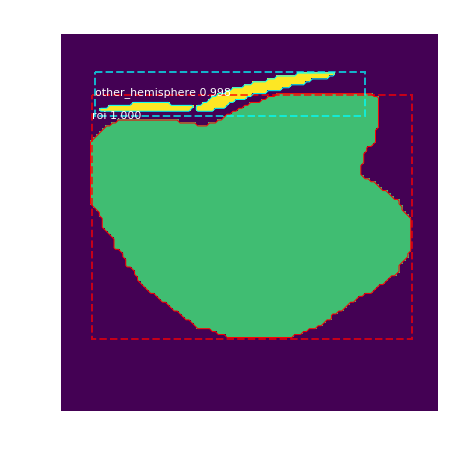

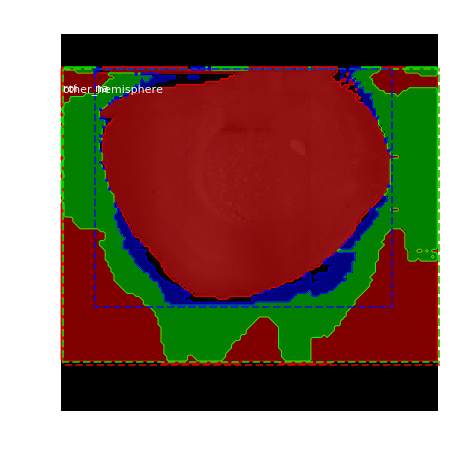

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   62.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -41.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 50%|█████     | 202/404 [05:57<05:47,  1.72s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   77.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  369.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


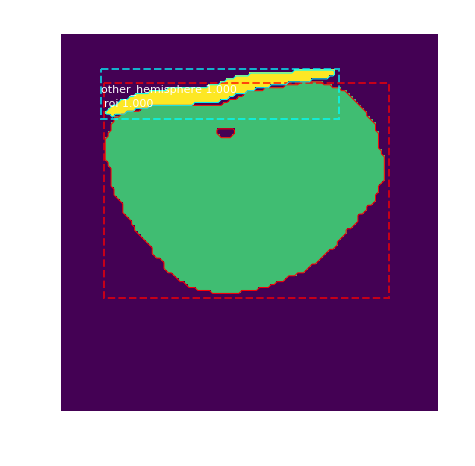

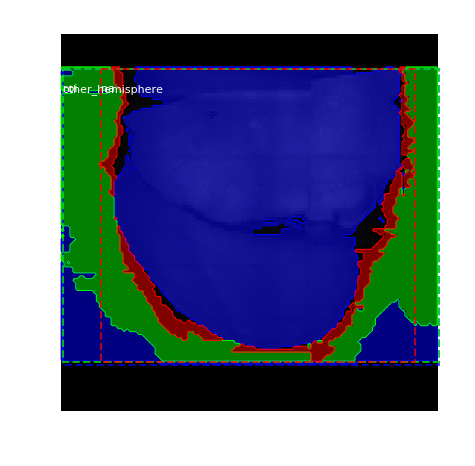

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   77.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -26.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 50%|█████     | 203/404 [05:59<05:45,  1.72s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   70.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


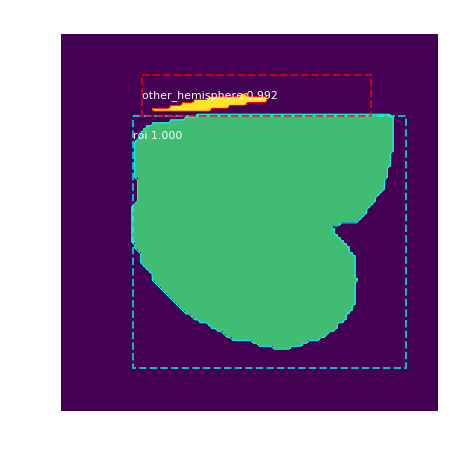

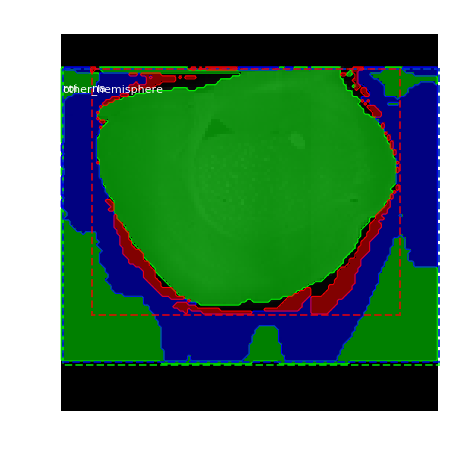

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   70.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -33.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 50%|█████     | 204/404 [06:01<05:50,  1.75s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   45.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


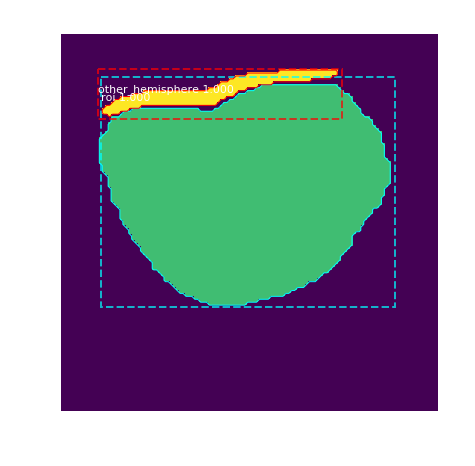

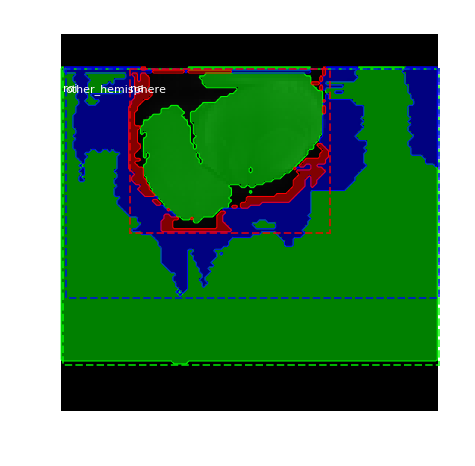

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   45.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -58.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 51%|█████     | 205/404 [06:02<05:50,  1.76s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   71.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


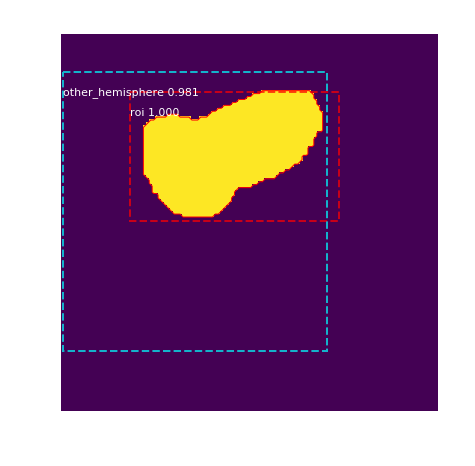

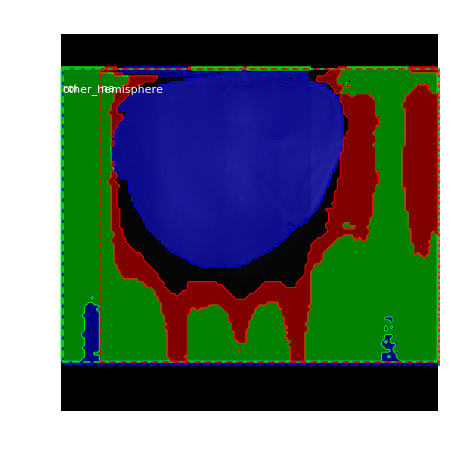

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   71.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -32.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 51%|█████     | 206/404 [06:04<05:53,  1.79s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   46.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


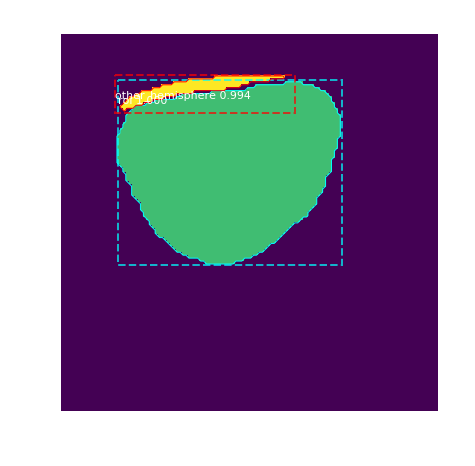

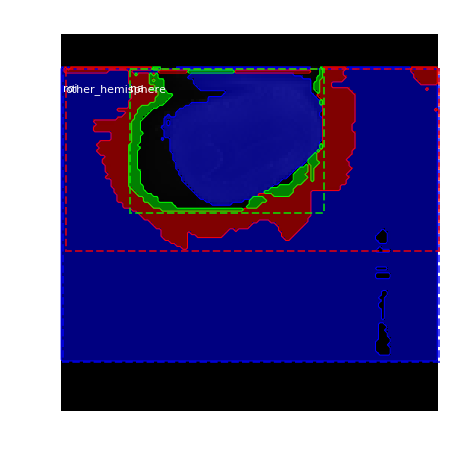

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   46.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -57.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 51%|█████     | 207/404 [06:06<06:01,  1.83s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   70.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  300.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


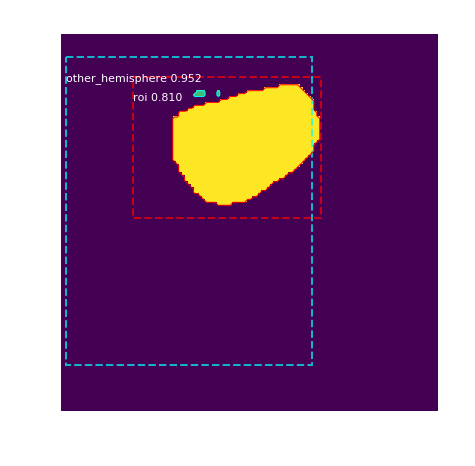

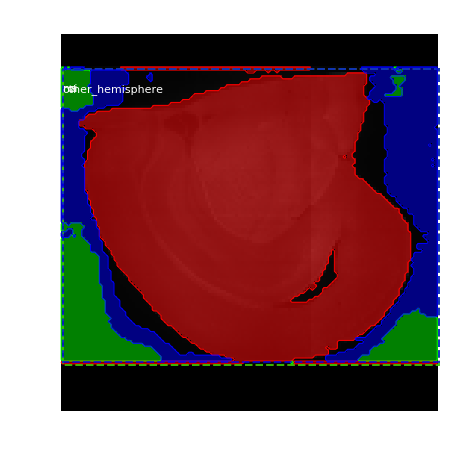

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   70.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -33.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 51%|█████▏    | 208/404 [06:08<05:51,  1.79s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   87.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  329.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


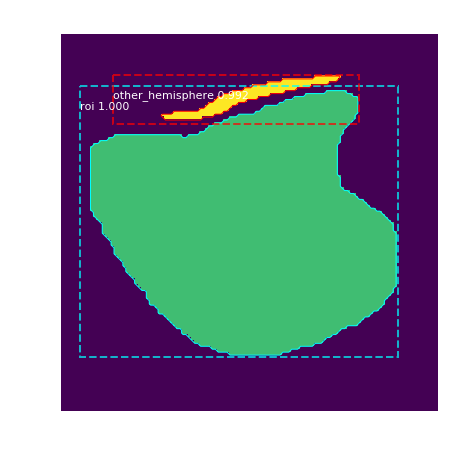

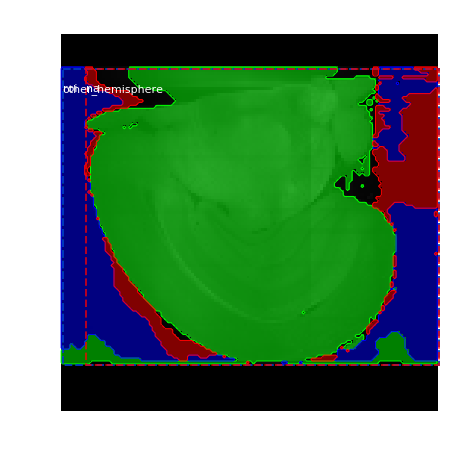

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   87.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -16.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 52%|█████▏    | 209/404 [06:10<05:40,  1.75s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   89.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  383.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


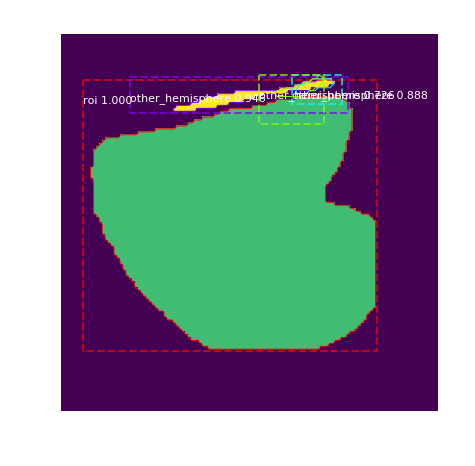

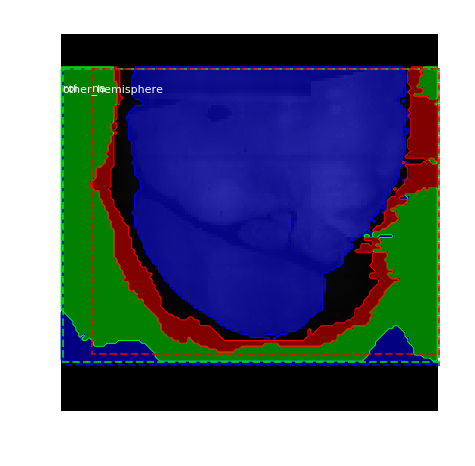

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   89.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -14.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 52%|█████▏    | 210/404 [06:11<05:30,  1.71s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:  100.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  314.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


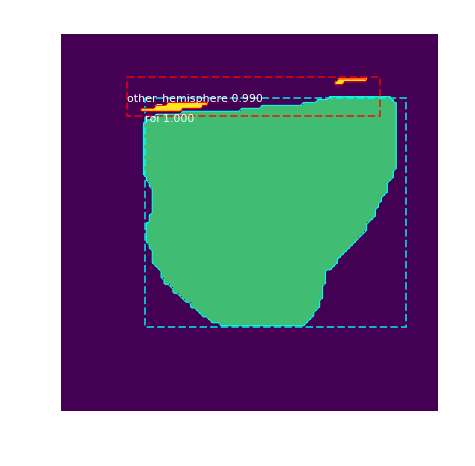

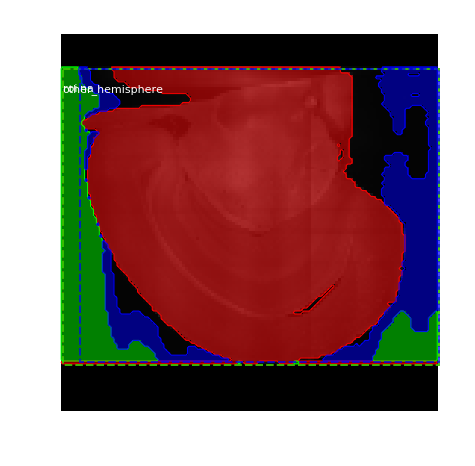

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:  100.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:   -3.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 52%|█████▏    | 211/404 [06:13<05:28,  1.70s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   85.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  358.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


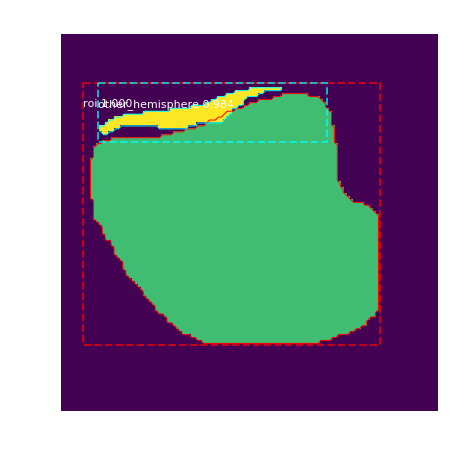

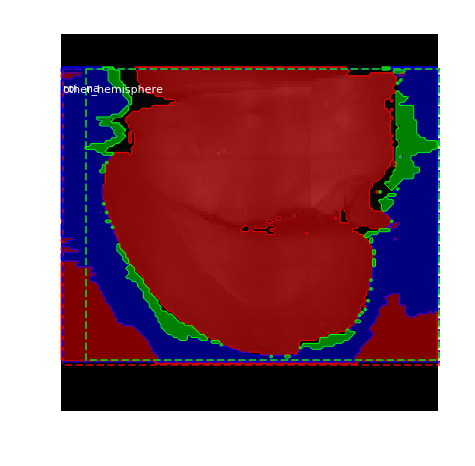

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   85.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -18.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 52%|█████▏    | 212/404 [06:15<05:32,  1.73s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   50.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


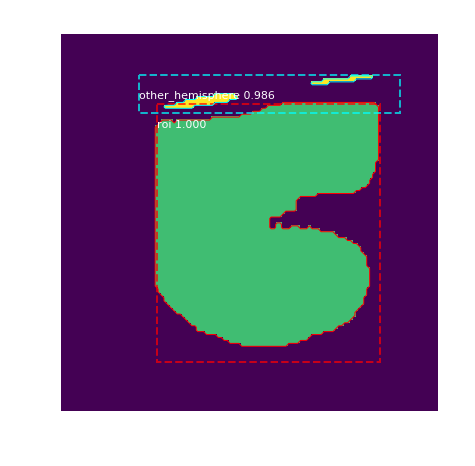

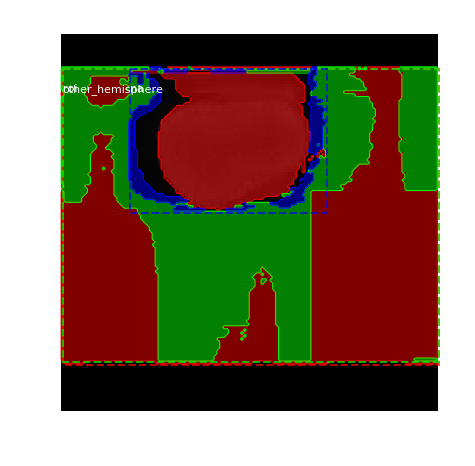

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   50.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -53.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 53%|█████▎    | 213/404 [06:17<05:36,  1.76s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   44.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


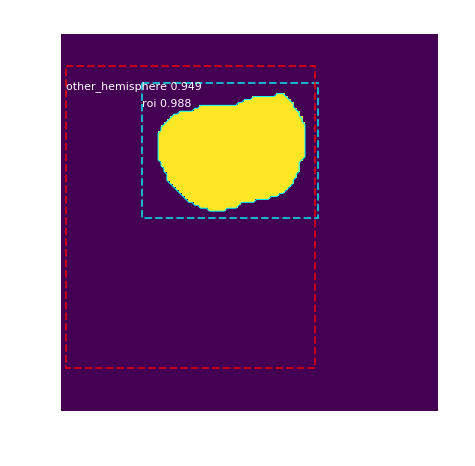

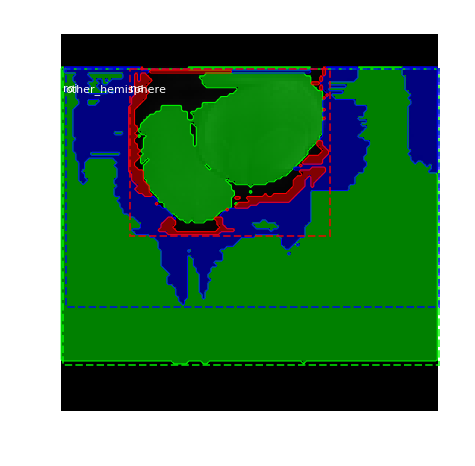

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   44.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -59.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 53%|█████▎    | 214/404 [06:18<05:30,  1.74s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   68.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


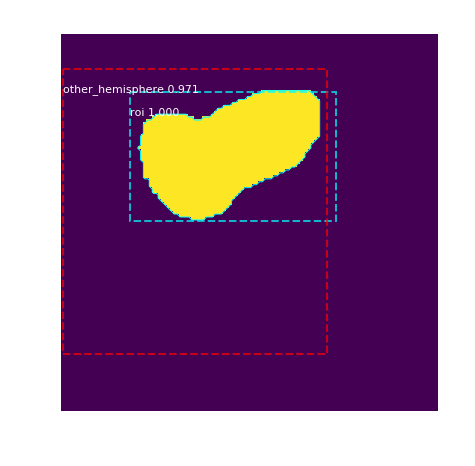

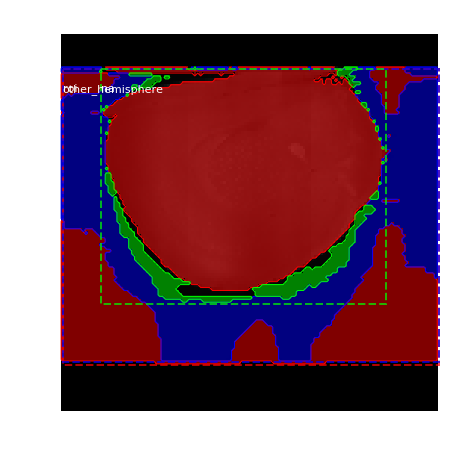

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   68.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -35.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 53%|█████▎    | 215/404 [06:20<05:36,  1.78s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   76.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


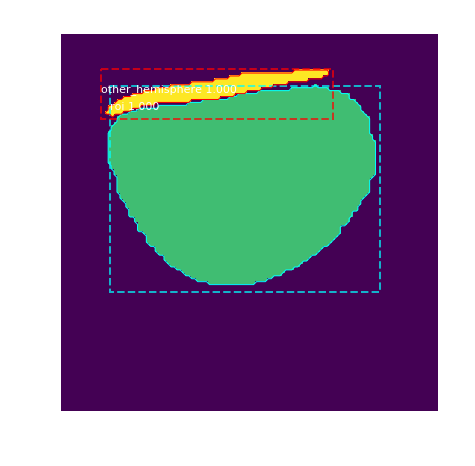

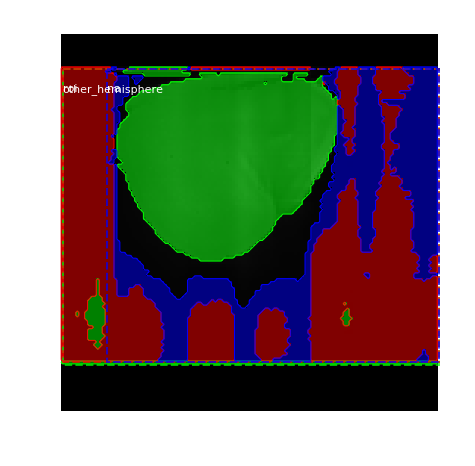

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   76.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -27.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 53%|█████▎    | 216/404 [06:22<05:28,  1.75s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   86.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  340.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


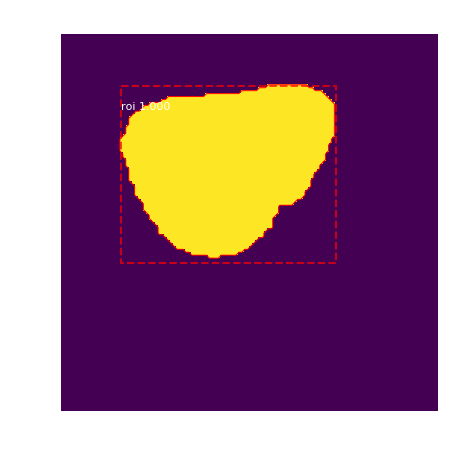

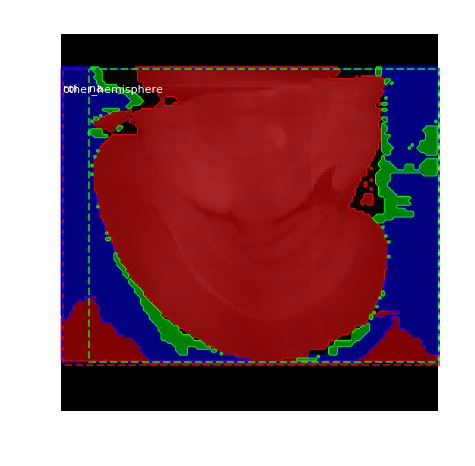

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   86.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -17.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 54%|█████▎    | 217/404 [06:24<05:35,  1.80s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   70.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


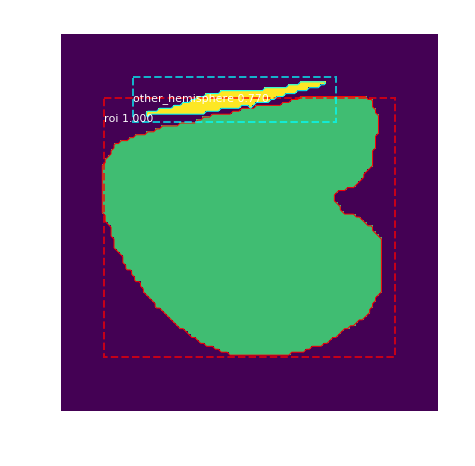

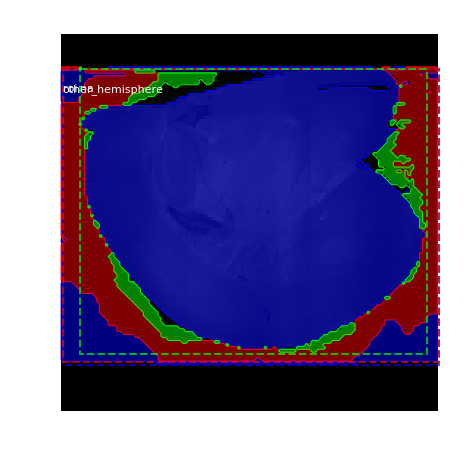

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   70.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -33.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 54%|█████▍    | 218/404 [06:26<05:52,  1.90s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   64.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


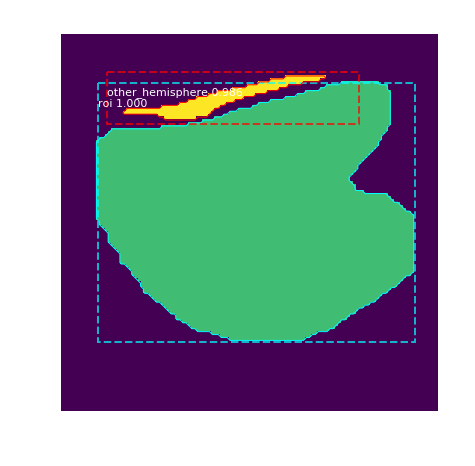

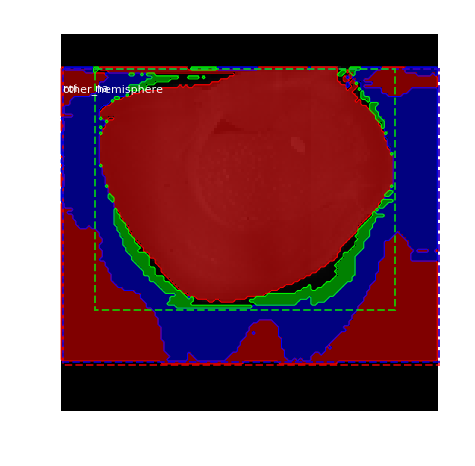

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   64.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -39.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 54%|█████▍    | 219/404 [06:28<05:50,  1.89s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   45.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


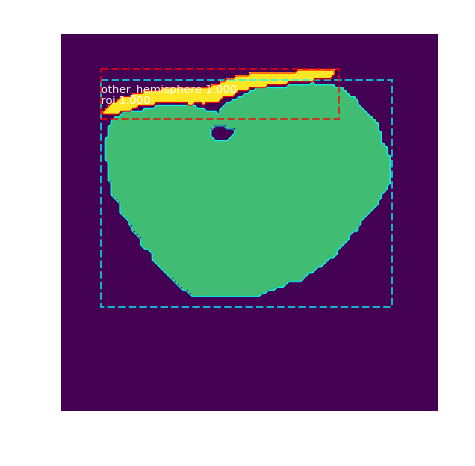

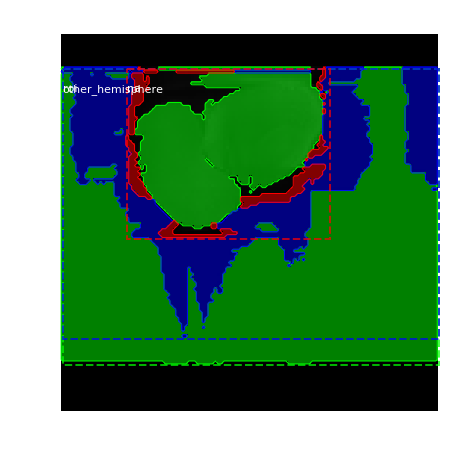

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   45.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -58.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 54%|█████▍    | 220/404 [06:30<05:49,  1.90s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   72.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


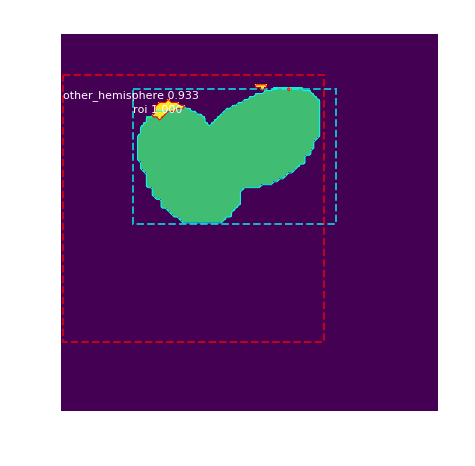

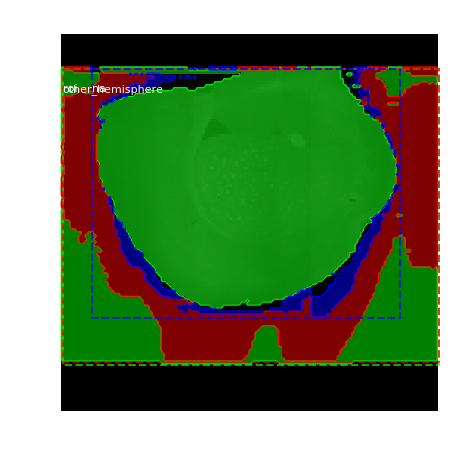

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   72.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -31.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 55%|█████▍    | 221/404 [06:31<05:43,  1.88s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   89.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  378.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


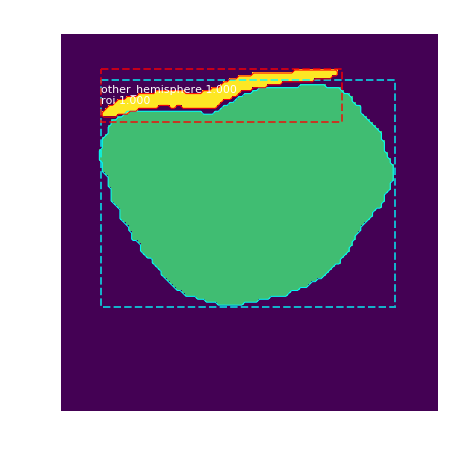

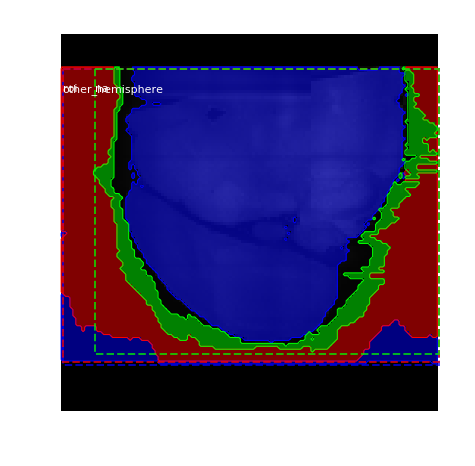

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   89.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -14.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 55%|█████▍    | 222/404 [06:33<05:33,  1.83s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   68.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


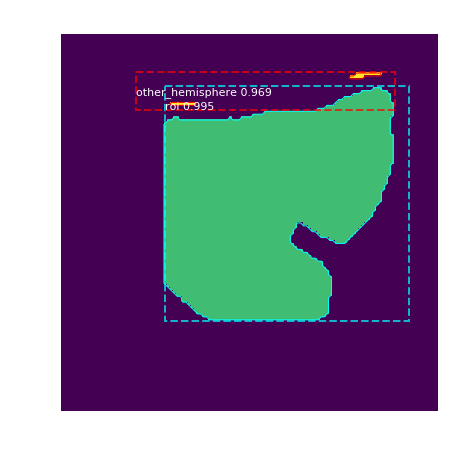

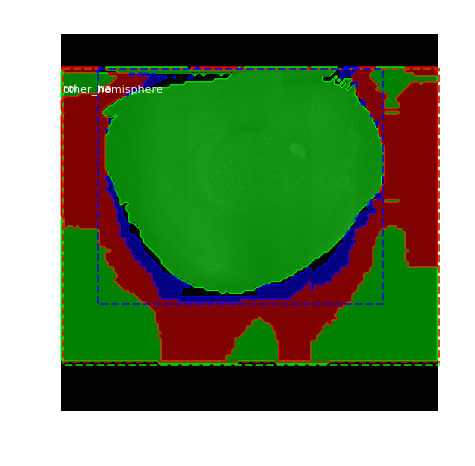

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   68.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -35.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 55%|█████▌    | 223/404 [06:35<05:29,  1.82s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   55.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


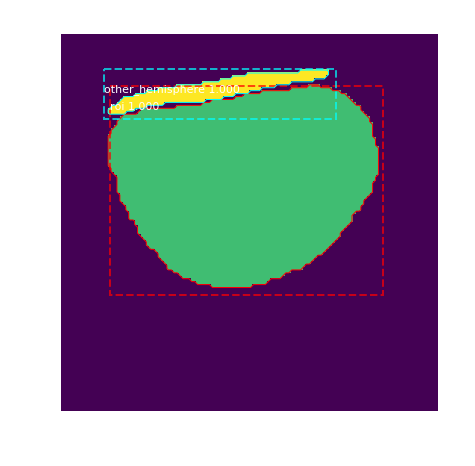

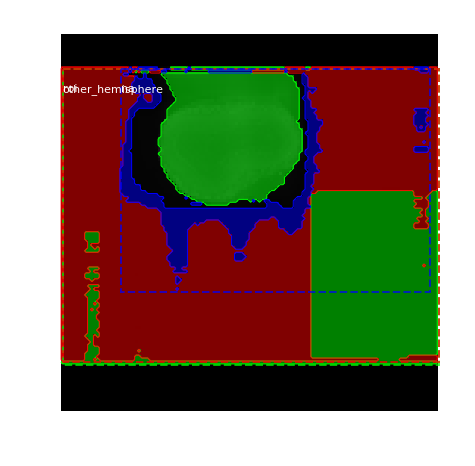

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   55.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -48.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 55%|█████▌    | 224/404 [06:37<05:17,  1.76s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   79.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


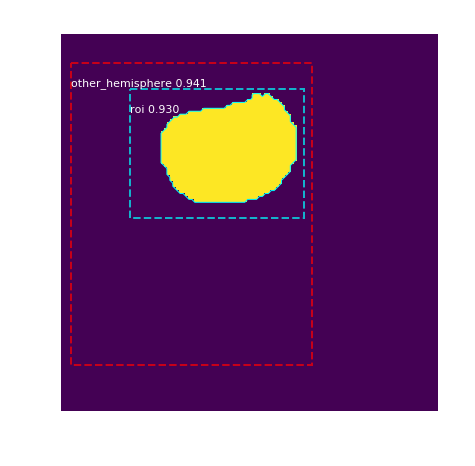

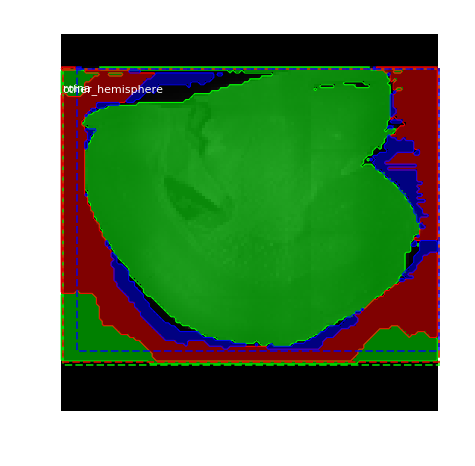

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   79.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -24.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 56%|█████▌    | 225/404 [06:38<05:12,  1.75s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   87.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  339.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


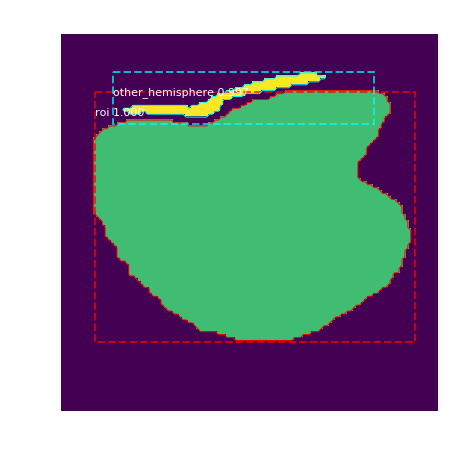

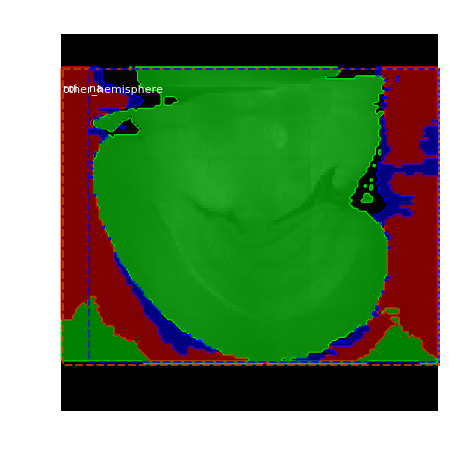

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   87.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -16.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 56%|█████▌    | 226/404 [06:40<05:18,  1.79s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   80.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  282.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


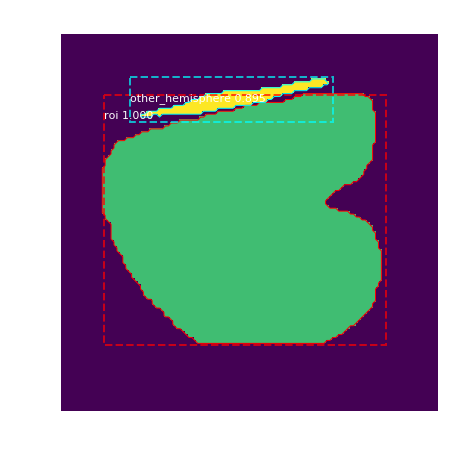

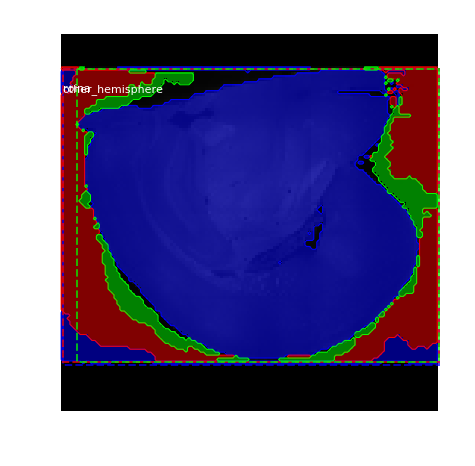

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   80.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -23.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 56%|█████▌    | 227/404 [06:42<05:12,  1.77s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:  107.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  310.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


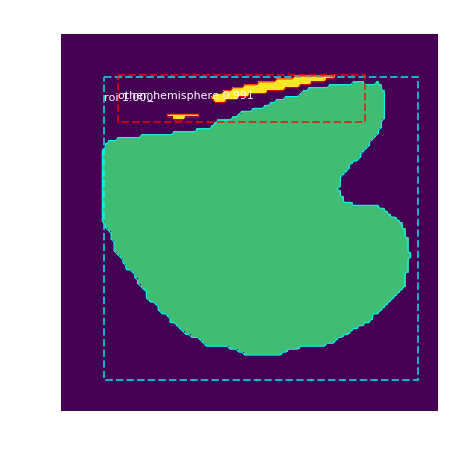

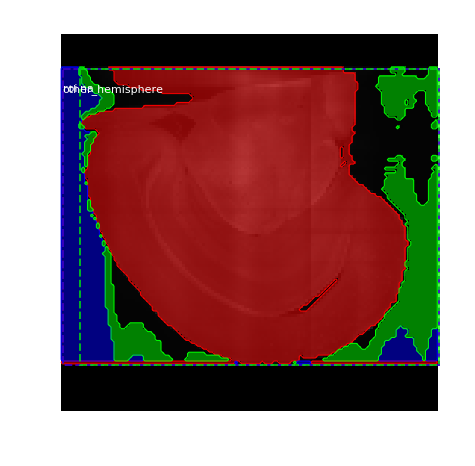

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:  107.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:    3.10000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 56%|█████▋    | 228/404 [06:44<05:12,  1.78s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   88.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  375.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


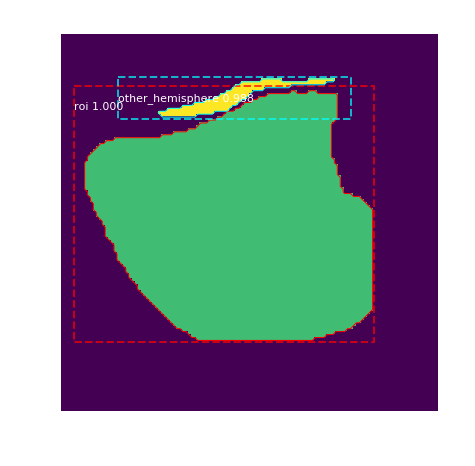

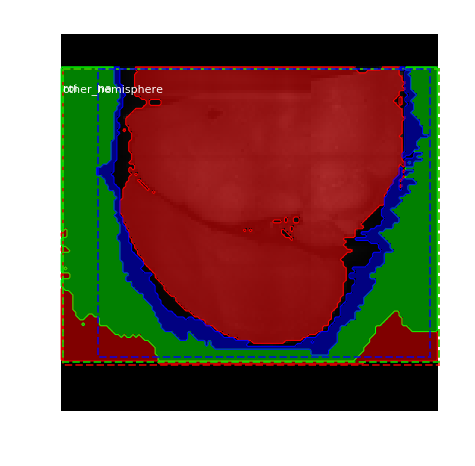

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   88.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -15.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 57%|█████▋    | 229/404 [06:46<05:23,  1.85s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   67.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


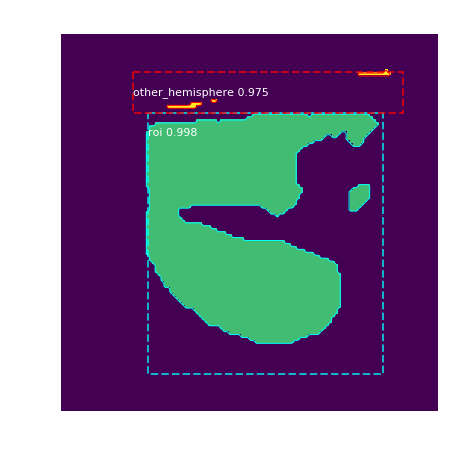

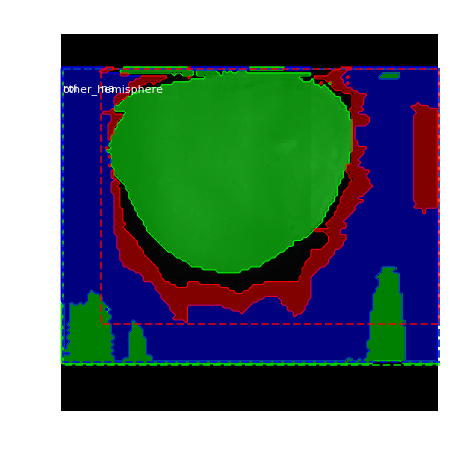

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   67.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -36.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 57%|█████▋    | 230/404 [06:47<05:18,  1.83s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   58.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


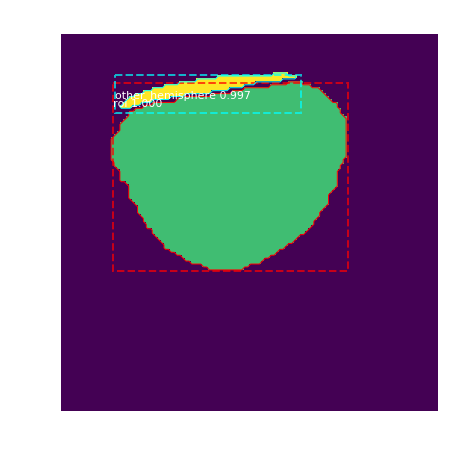

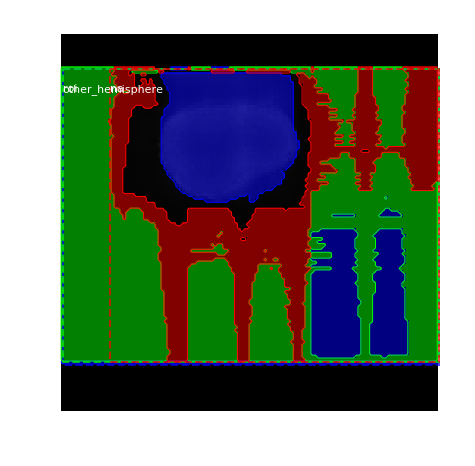

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   58.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -45.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 57%|█████▋    | 231/404 [06:49<05:07,  1.78s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   97.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


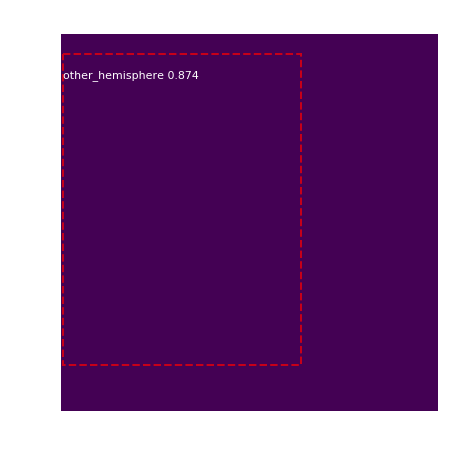

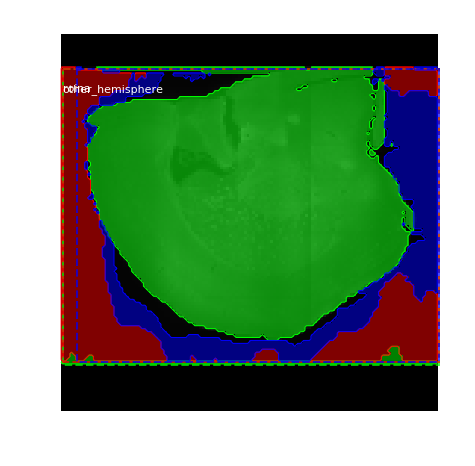

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   97.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:   -6.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 57%|█████▋    | 232/404 [06:51<05:00,  1.75s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   65.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


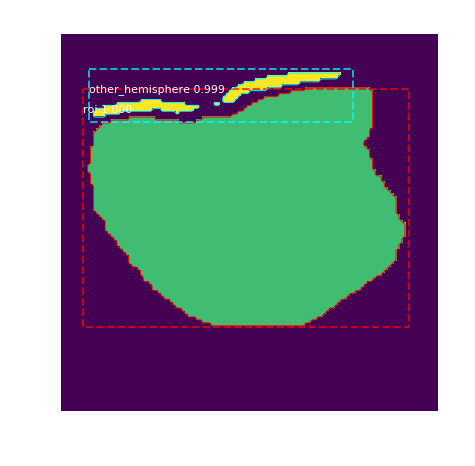

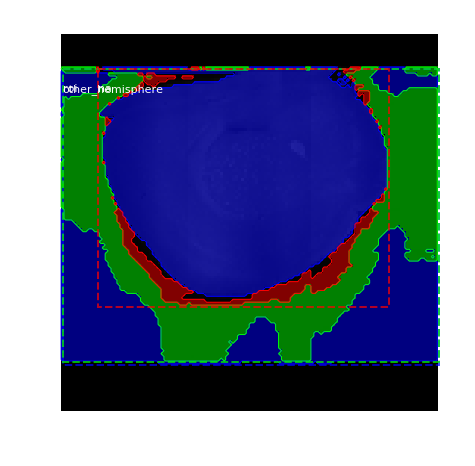

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   65.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -38.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 58%|█████▊    | 233/404 [06:53<05:01,  1.76s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   92.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  328.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


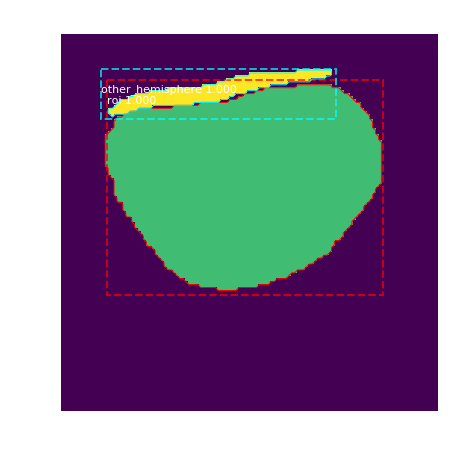

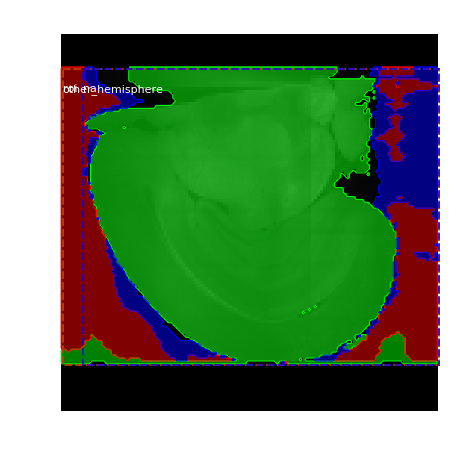

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   92.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -11.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 58%|█████▊    | 234/404 [06:54<05:00,  1.77s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   53.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


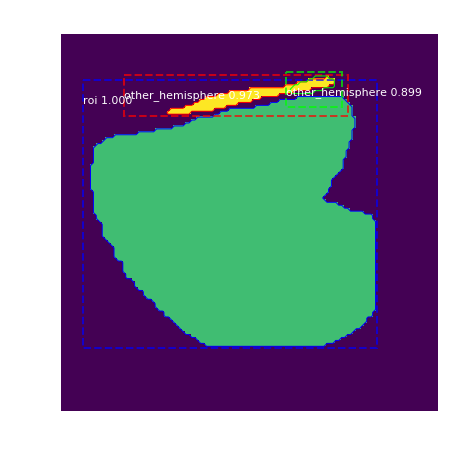

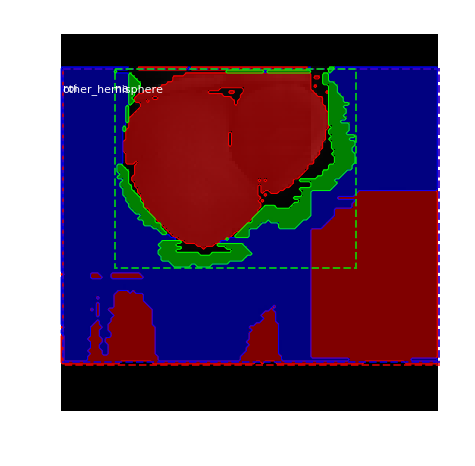

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   53.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -50.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 58%|█████▊    | 235/404 [06:56<05:04,  1.80s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   73.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


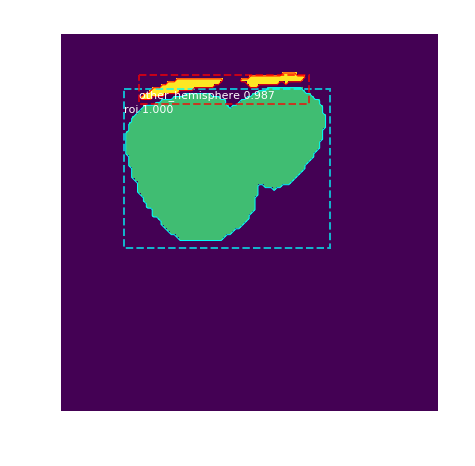

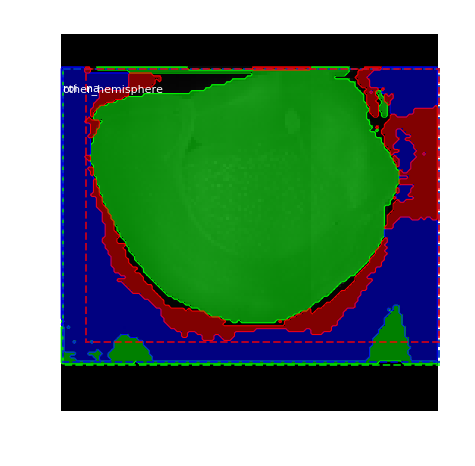

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   73.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -30.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 58%|█████▊    | 236/404 [06:58<04:59,  1.78s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   59.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


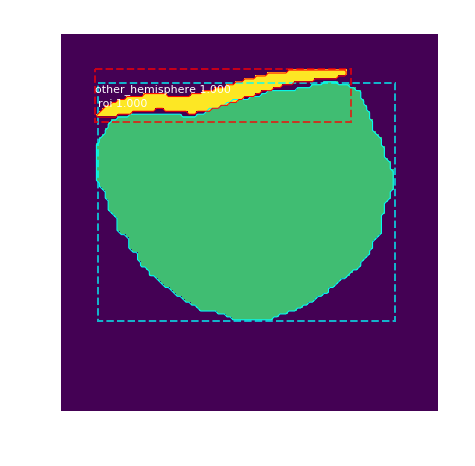

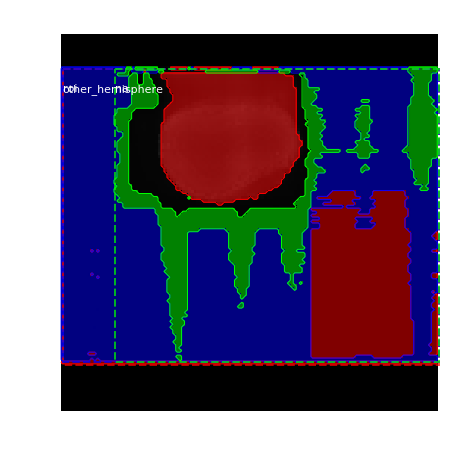

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   59.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -44.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 59%|█████▊    | 237/404 [07:00<05:05,  1.83s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   51.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


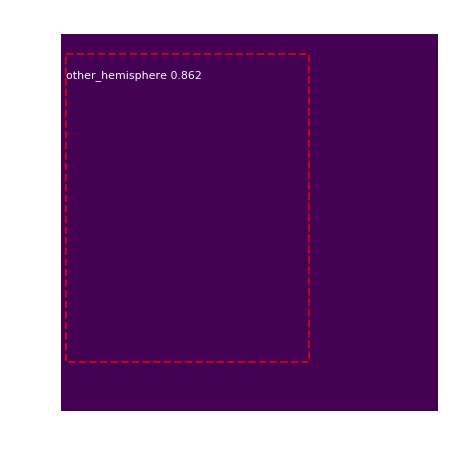

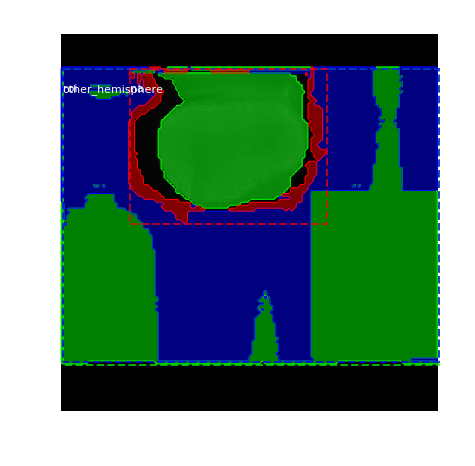

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   51.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -52.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 59%|█████▉    | 238/404 [07:02<04:56,  1.79s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:  101.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  313.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


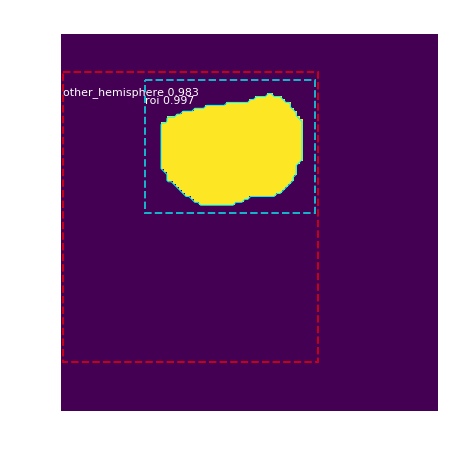

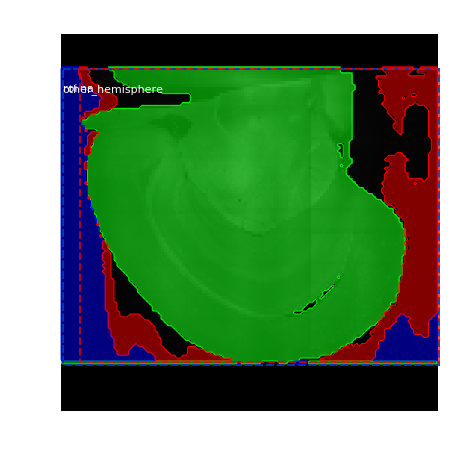

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:  101.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:   -2.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 59%|█████▉    | 239/404 [07:03<04:57,  1.80s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:  104.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  311.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


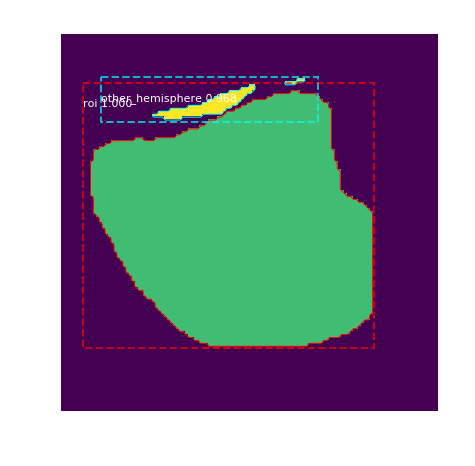

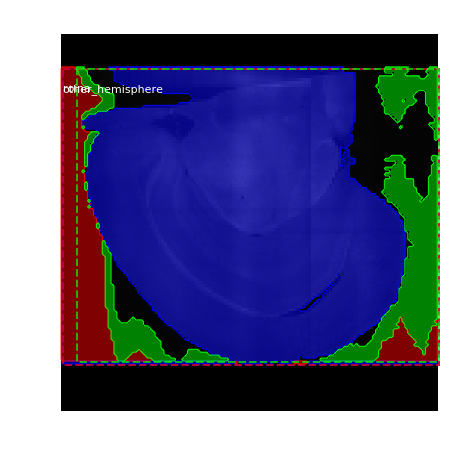

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:  104.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:    0.10000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 59%|█████▉    | 240/404 [07:05<05:01,  1.84s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:  100.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


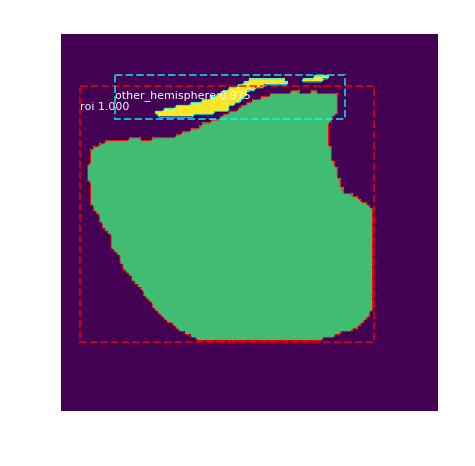

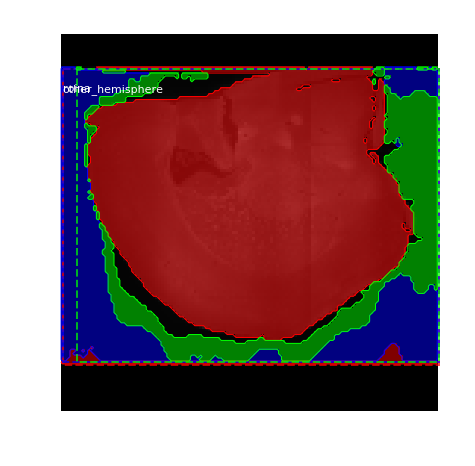

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:  100.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:   -3.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 60%|█████▉    | 241/404 [07:07<04:59,  1.84s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   60.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


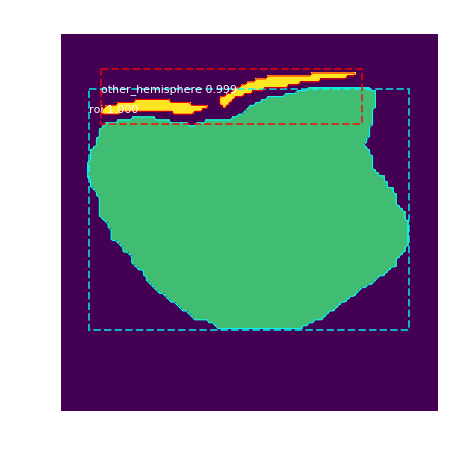

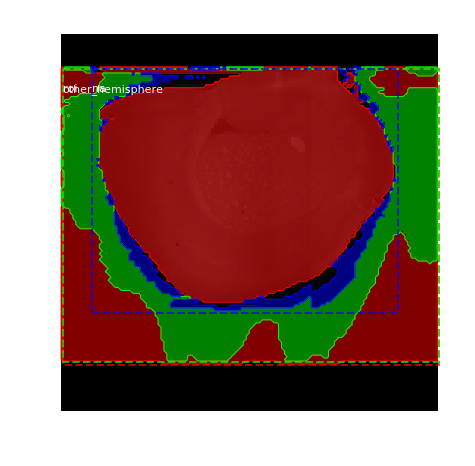

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   60.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -43.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 60%|█████▉    | 242/404 [07:09<04:59,  1.85s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   76.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


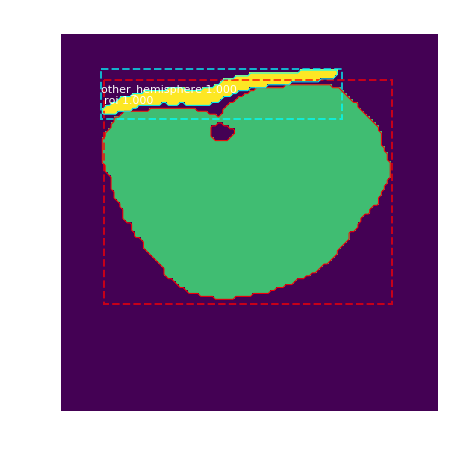

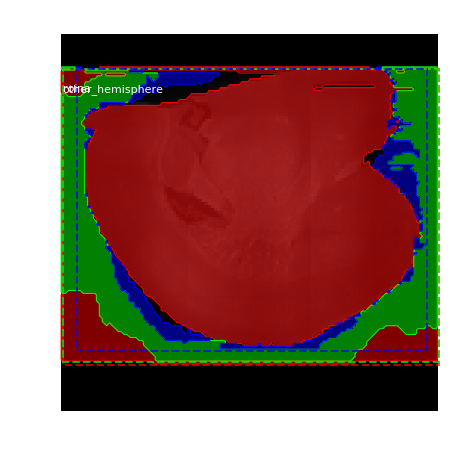

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   76.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -27.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 60%|██████    | 243/404 [07:11<05:03,  1.88s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   55.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


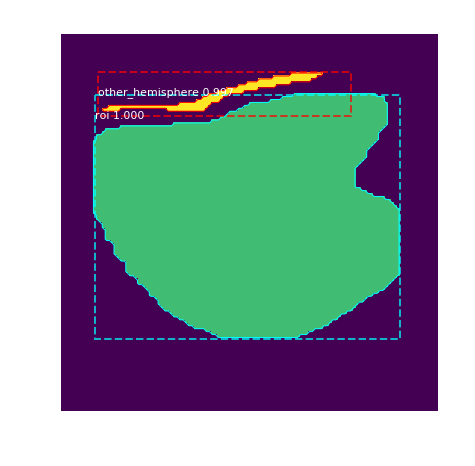

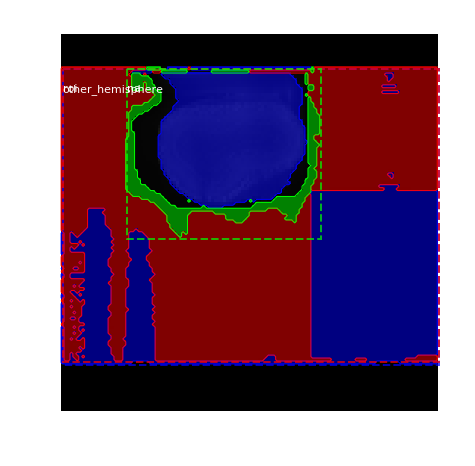

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   55.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -48.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 60%|██████    | 244/404 [07:13<05:09,  1.93s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   47.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


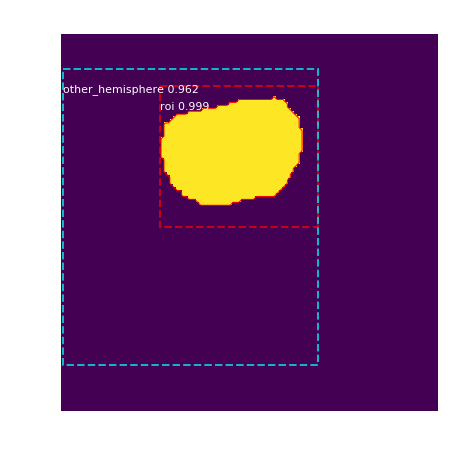

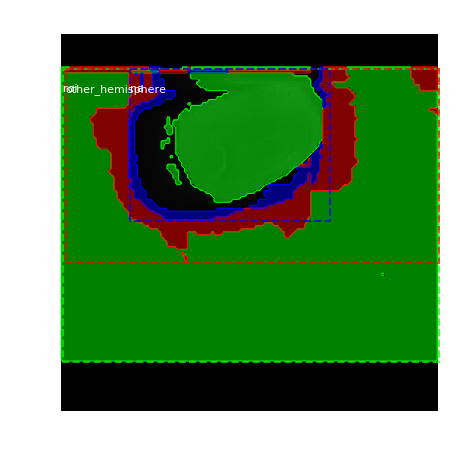

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   47.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -56.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 61%|██████    | 245/404 [07:15<05:01,  1.90s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   73.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


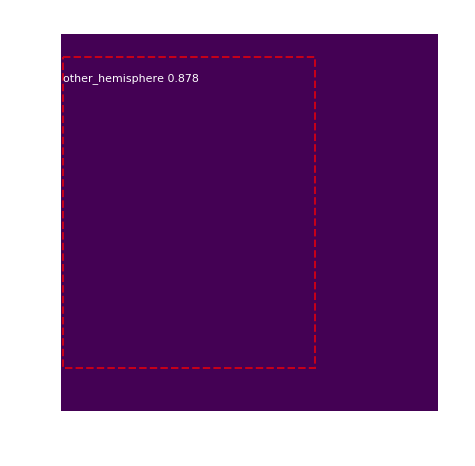

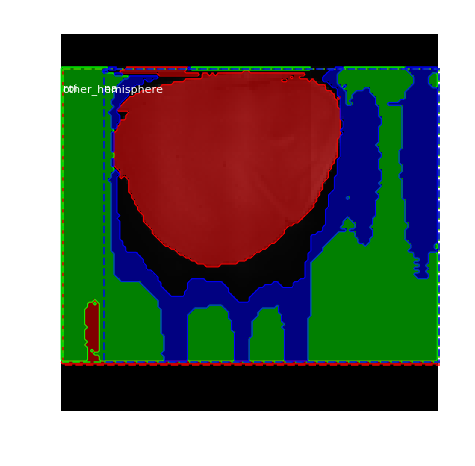

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   73.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -30.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 61%|██████    | 246/404 [07:17<04:54,  1.86s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   72.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


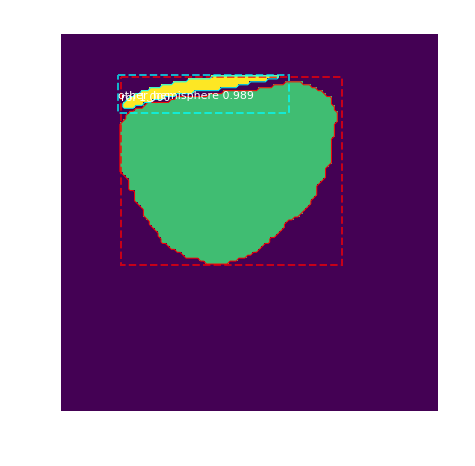

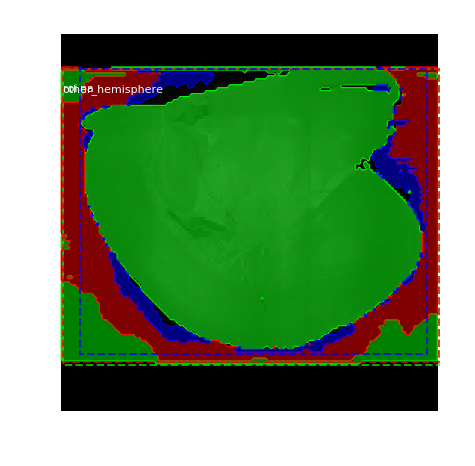

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   72.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -31.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 61%|██████    | 247/404 [07:18<04:44,  1.81s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   68.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


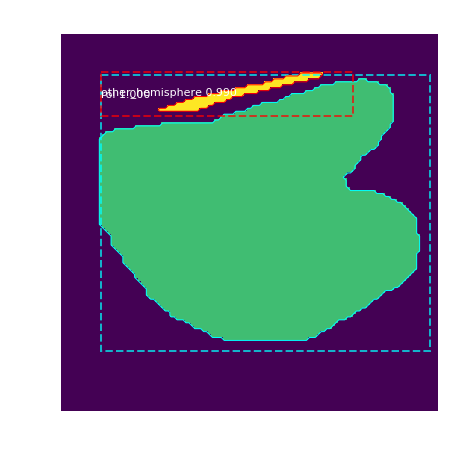

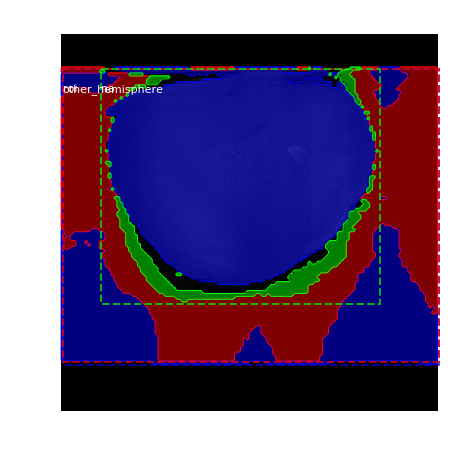

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   68.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -35.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 61%|██████▏   | 248/404 [07:20<04:46,  1.84s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   47.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


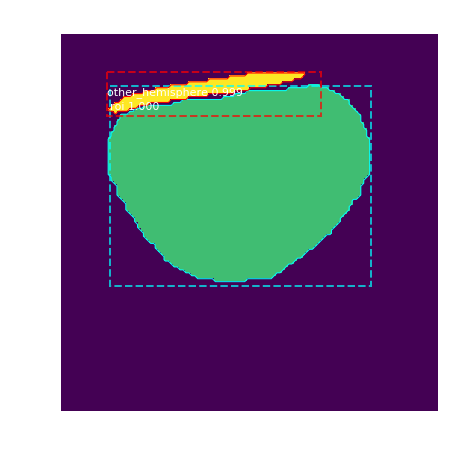

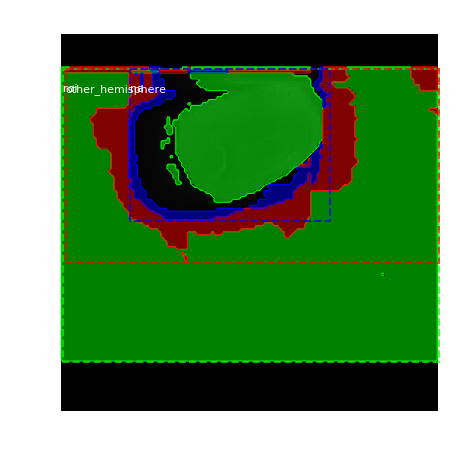

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   47.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -56.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 62%|██████▏   | 249/404 [07:22<04:42,  1.82s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   84.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  361.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


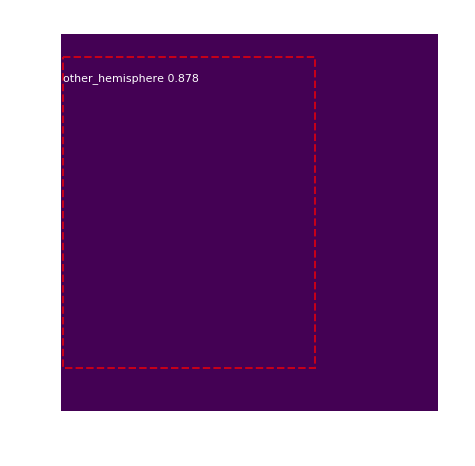

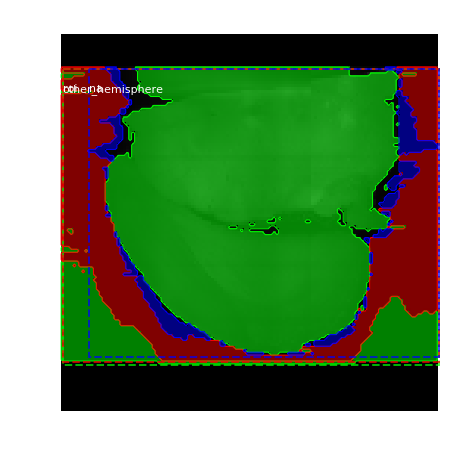

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   84.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -19.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 62%|██████▏   | 250/404 [07:24<04:38,  1.81s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   47.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


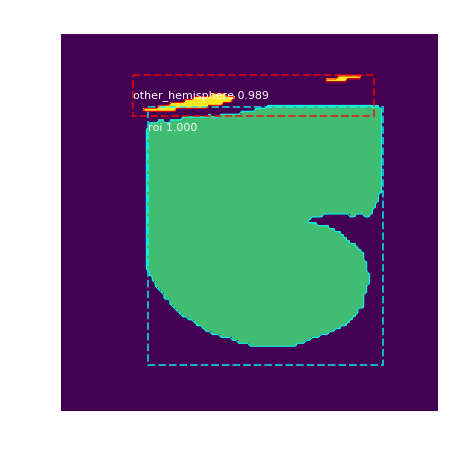

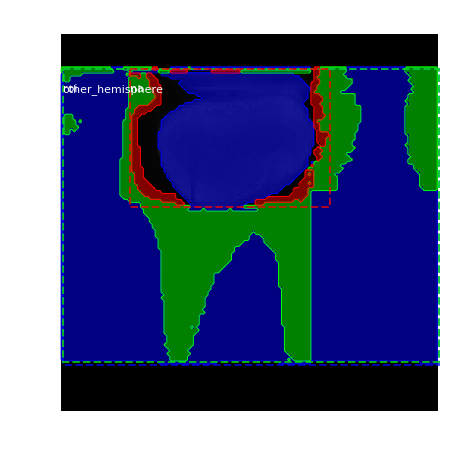

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   47.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -56.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 62%|██████▏   | 251/404 [07:26<04:40,  1.84s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:  136.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  382.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


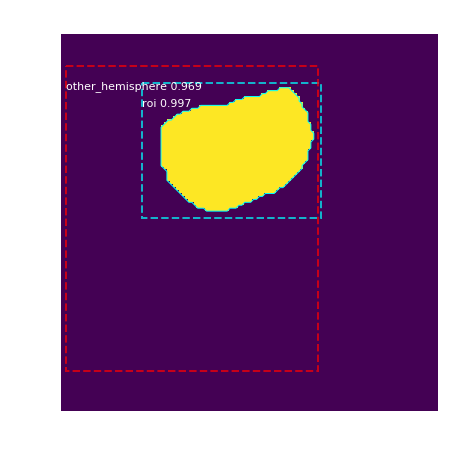

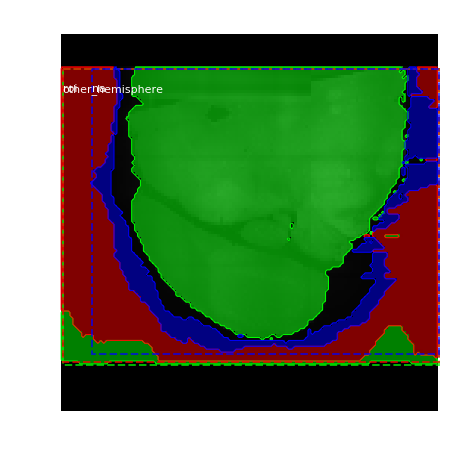

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:  136.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:   32.10000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 62%|██████▏   | 252/404 [07:28<04:42,  1.86s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   89.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  383.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


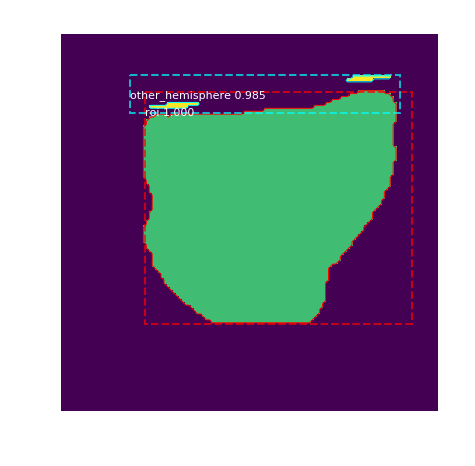

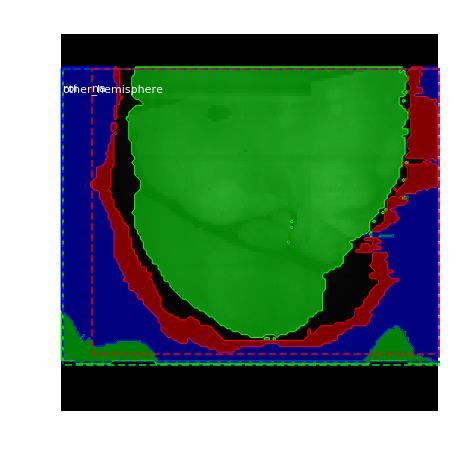

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   89.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -14.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 63%|██████▎   | 253/404 [07:29<04:32,  1.80s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   75.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  370.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


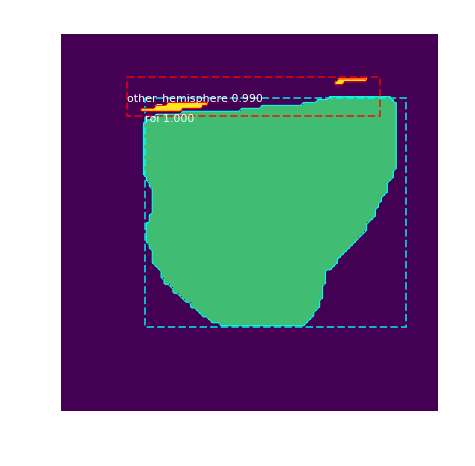

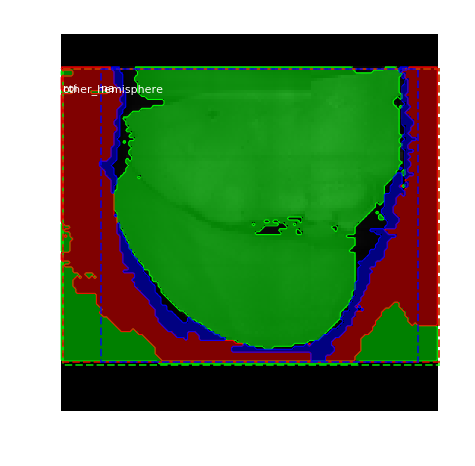

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   75.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -28.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 63%|██████▎   | 254/404 [07:31<04:23,  1.76s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   75.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  287.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


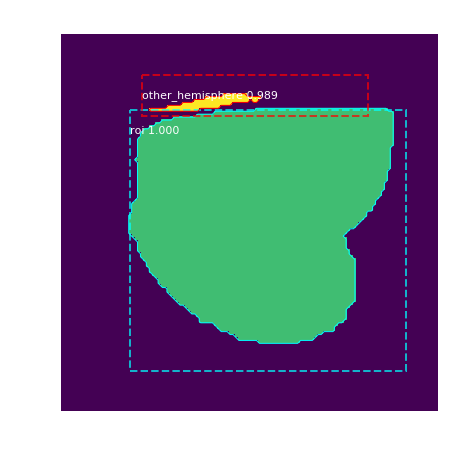

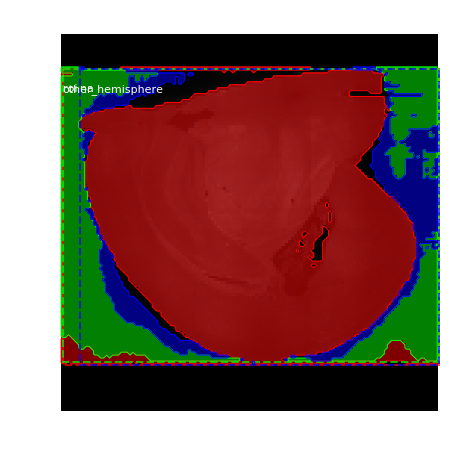

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   75.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -28.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 63%|██████▎   | 255/404 [07:33<04:29,  1.81s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   84.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  342.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


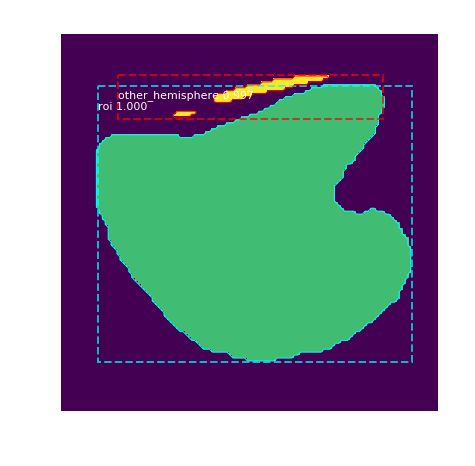

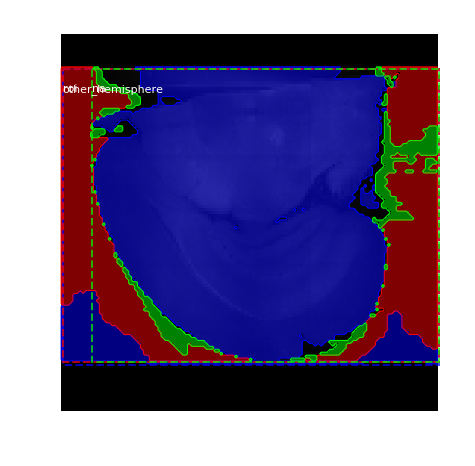

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   84.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -19.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 63%|██████▎   | 256/404 [07:35<04:35,  1.86s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   69.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


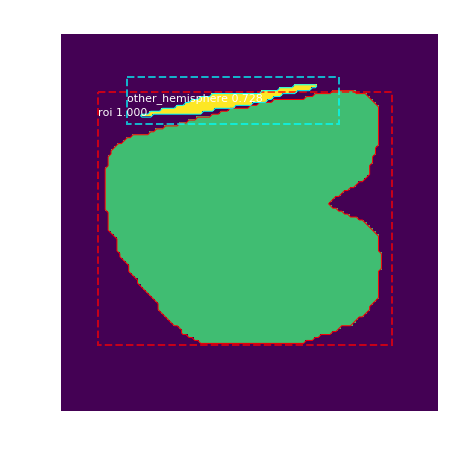

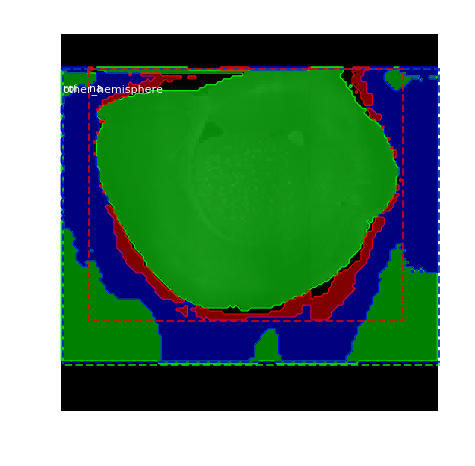

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   69.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -34.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 64%|██████▎   | 257/404 [07:37<04:45,  1.94s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   54.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


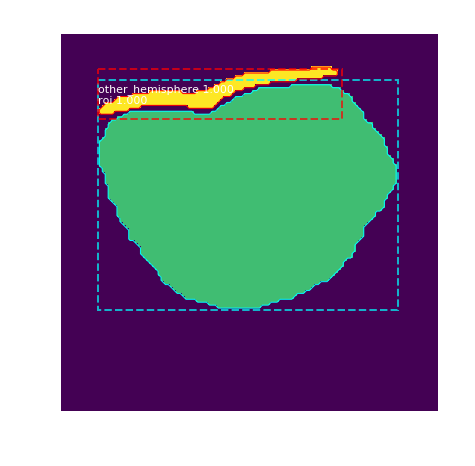

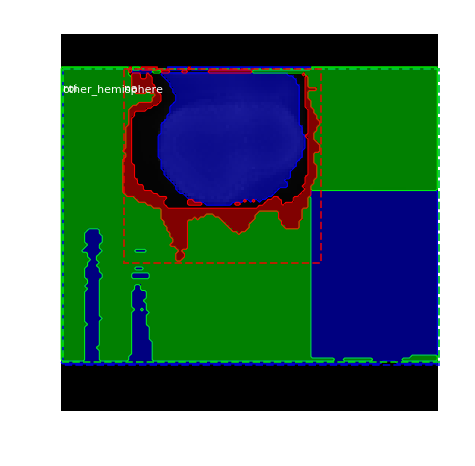

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   54.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -49.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 64%|██████▍   | 258/404 [07:39<04:45,  1.95s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   92.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  400.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


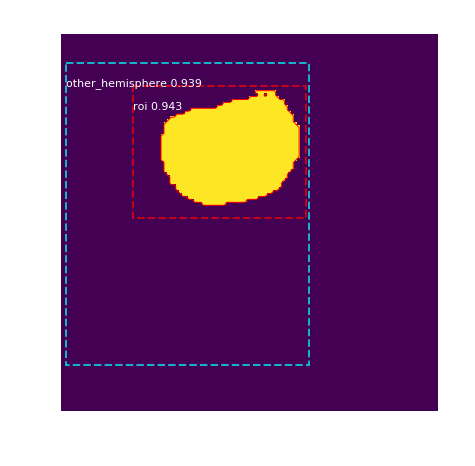

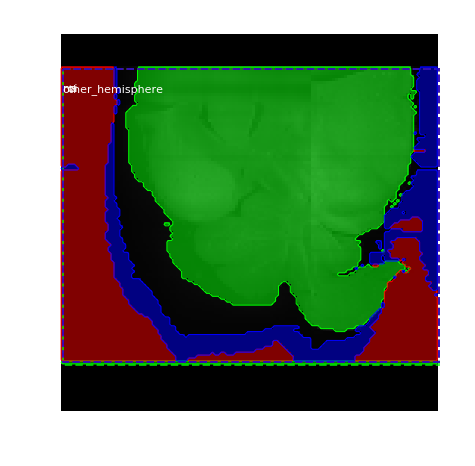

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   92.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -11.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 64%|██████▍   | 259/404 [07:41<04:32,  1.88s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:  109.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  305.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


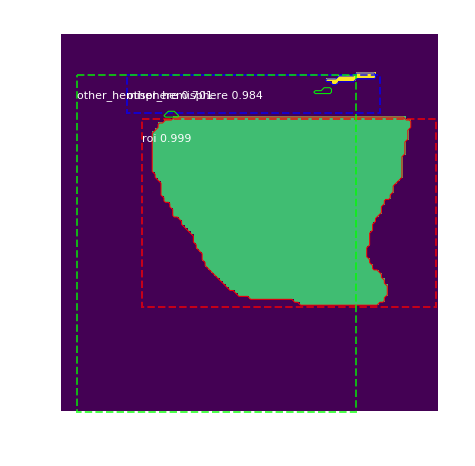

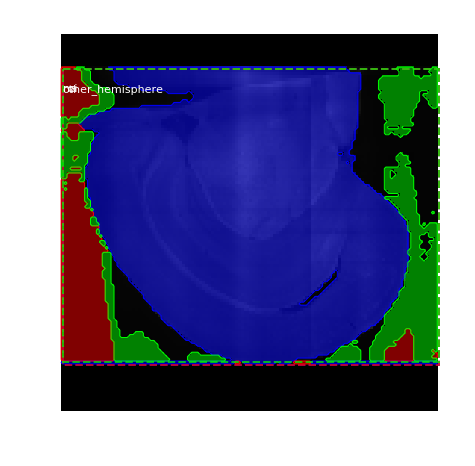

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:  109.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:    5.10000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 64%|██████▍   | 260/404 [07:42<04:20,  1.81s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   75.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


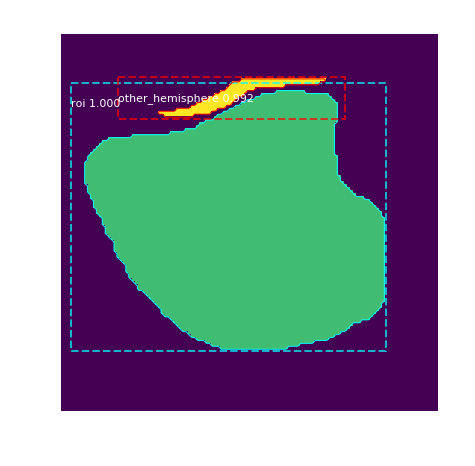

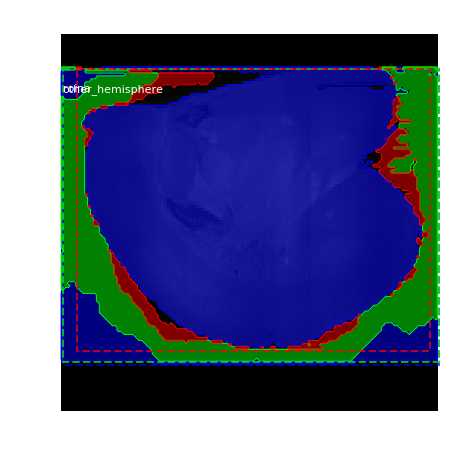

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   75.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -28.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 65%|██████▍   | 261/404 [07:44<04:27,  1.87s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   52.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


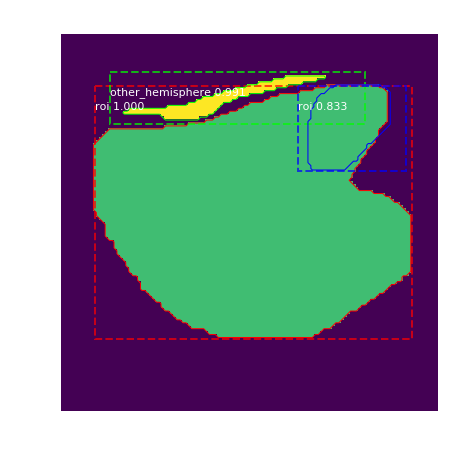

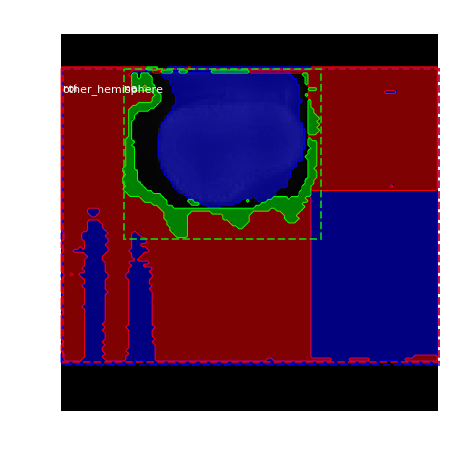

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   52.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -51.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 65%|██████▍   | 262/404 [07:46<04:23,  1.86s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:  103.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


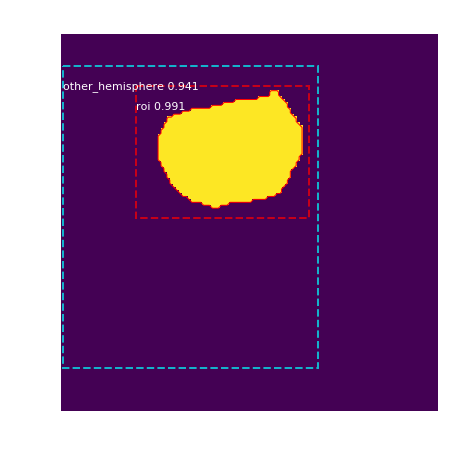

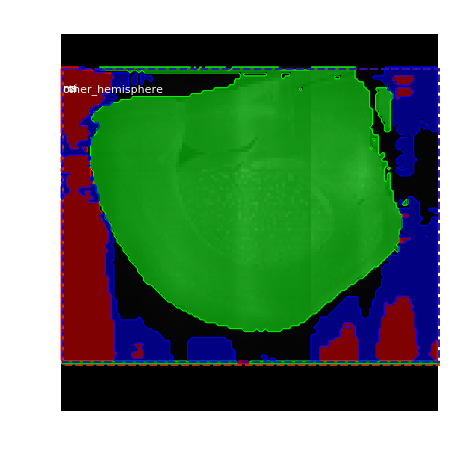

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:  103.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:   -0.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 65%|██████▌   | 263/404 [07:48<04:24,  1.88s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   72.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


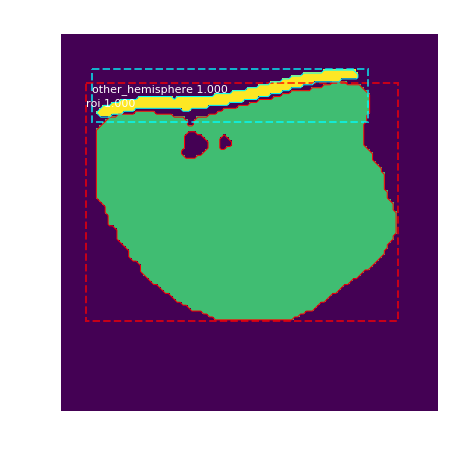

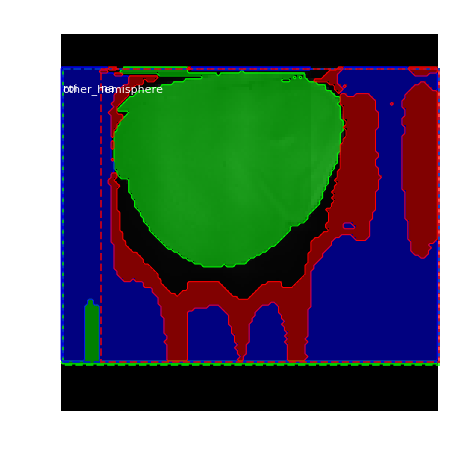

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   72.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -31.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 65%|██████▌   | 264/404 [07:50<04:18,  1.85s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   43.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


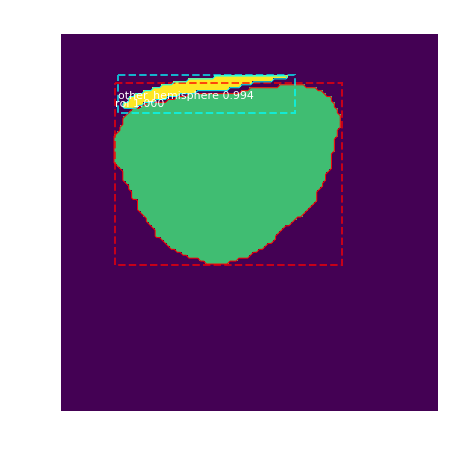

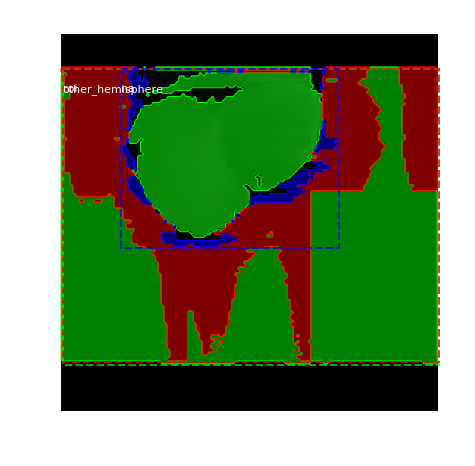

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   43.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -60.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 66%|██████▌   | 265/404 [07:52<04:24,  1.90s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   45.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


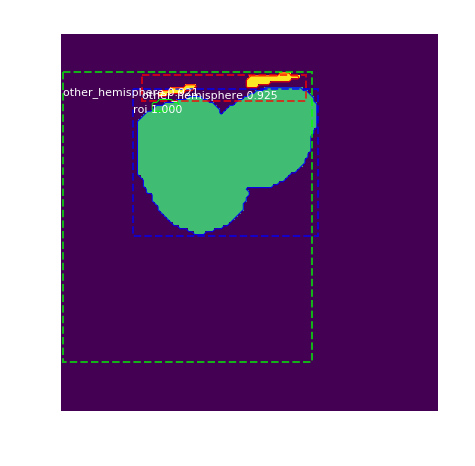

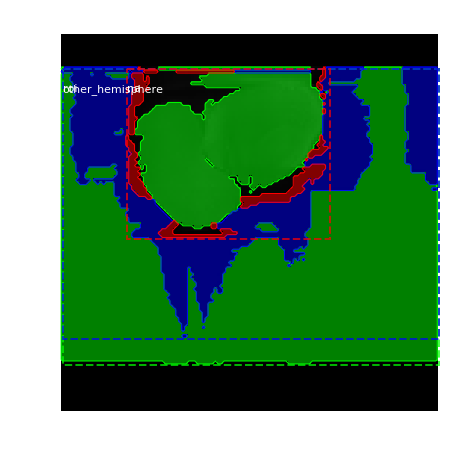

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   45.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -58.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 66%|██████▌   | 266/404 [07:54<04:16,  1.86s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   66.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


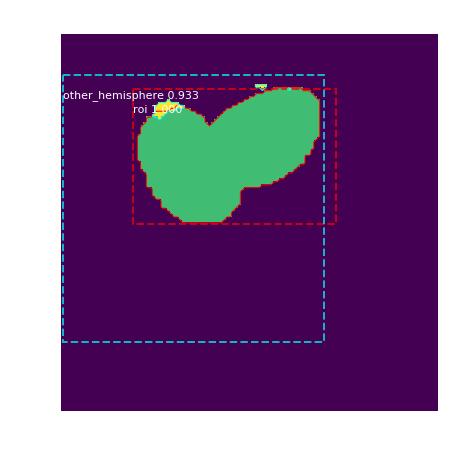

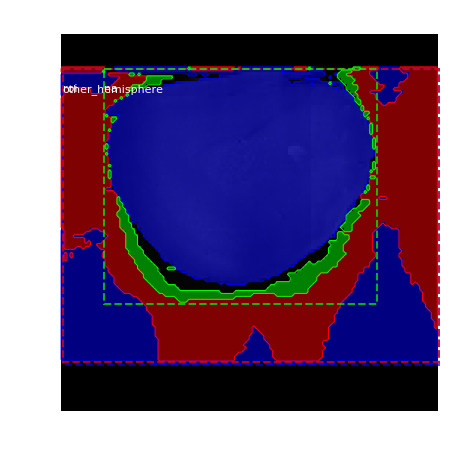

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   66.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -37.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 66%|██████▌   | 267/404 [07:56<04:13,  1.85s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   45.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


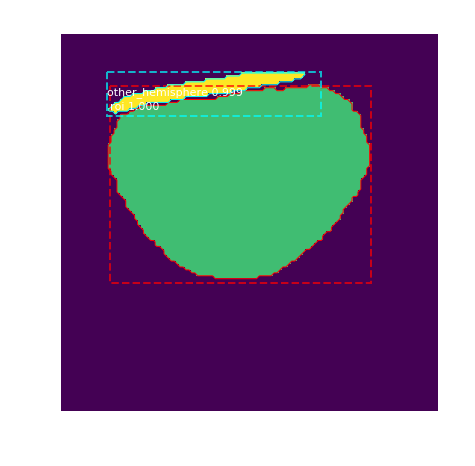

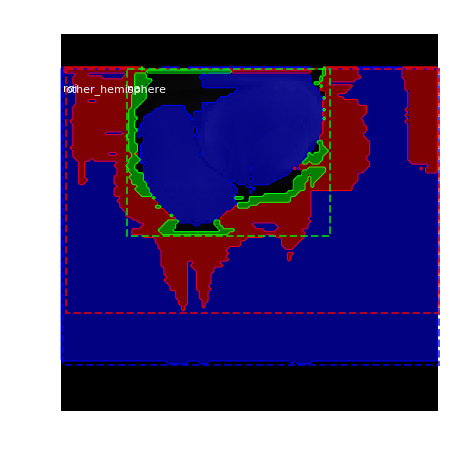

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   45.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -58.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 66%|██████▋   | 268/404 [07:57<04:09,  1.83s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   70.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


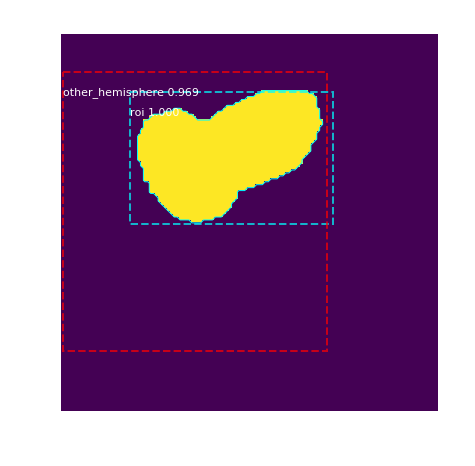

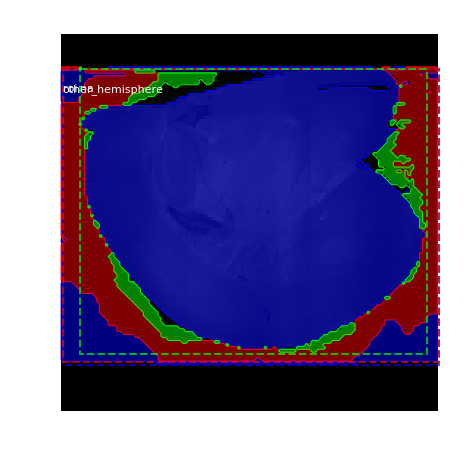

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   70.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -33.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 67%|██████▋   | 269/404 [07:59<04:00,  1.78s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   83.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


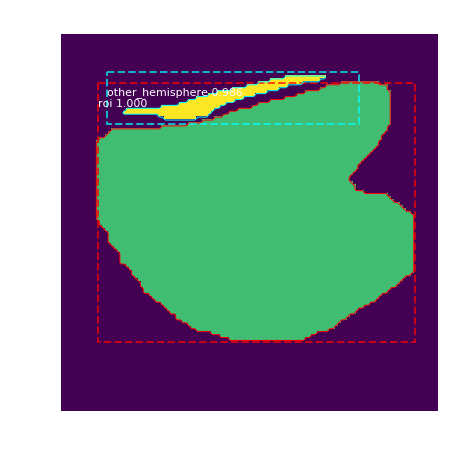

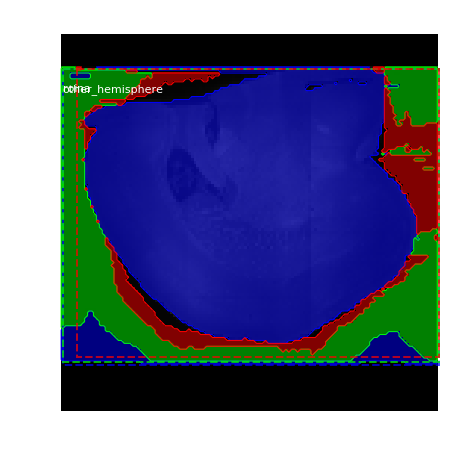

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   83.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -20.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 67%|██████▋   | 270/404 [08:01<03:57,  1.77s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   73.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


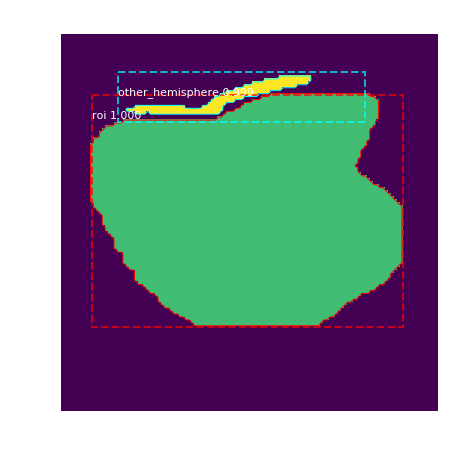

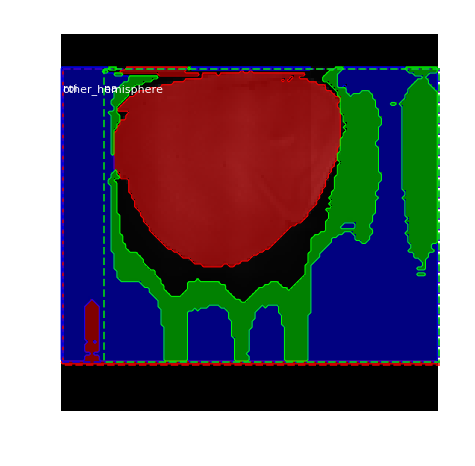

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   73.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -30.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 67%|██████▋   | 271/404 [08:03<03:59,  1.80s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   64.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


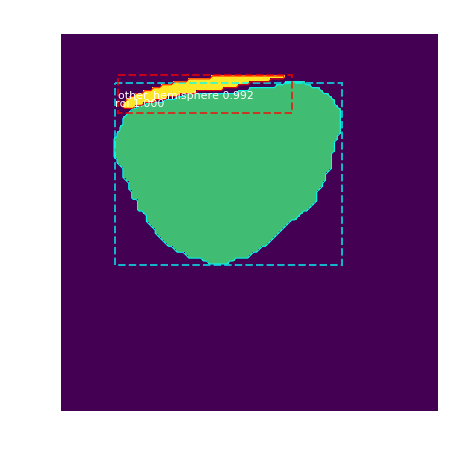

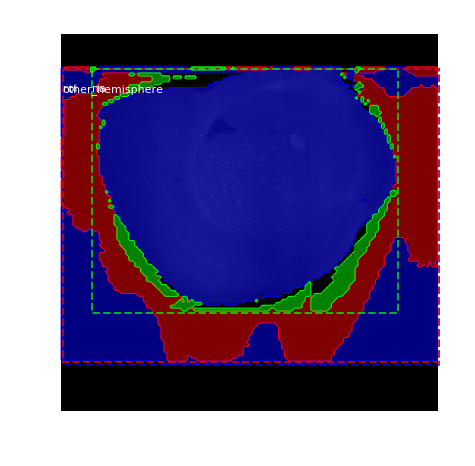

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   64.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -39.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 67%|██████▋   | 272/404 [08:04<03:57,  1.80s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   85.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  358.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


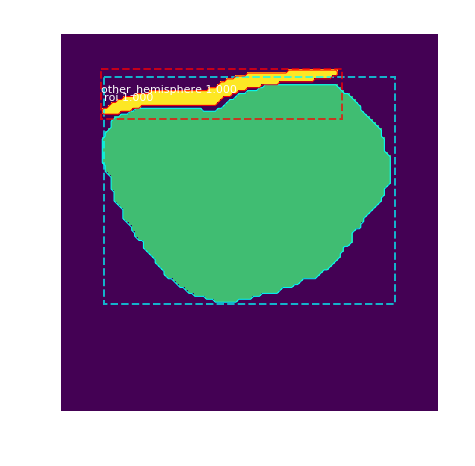

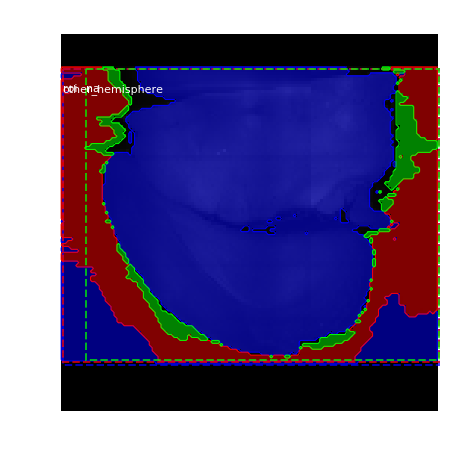

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   85.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -18.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 68%|██████▊   | 273/404 [08:06<03:56,  1.80s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   64.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


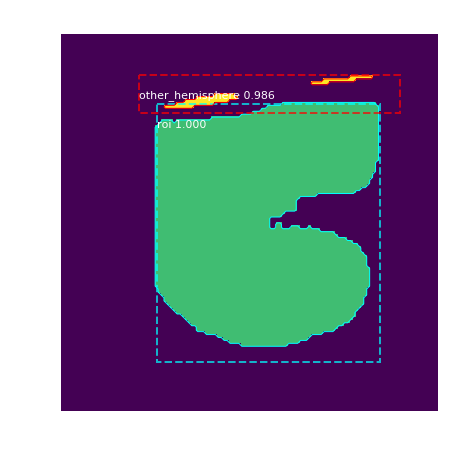

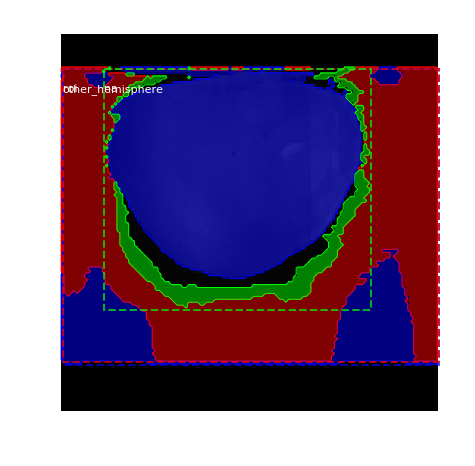

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   64.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -39.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 68%|██████▊   | 274/404 [08:08<03:55,  1.81s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   63.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


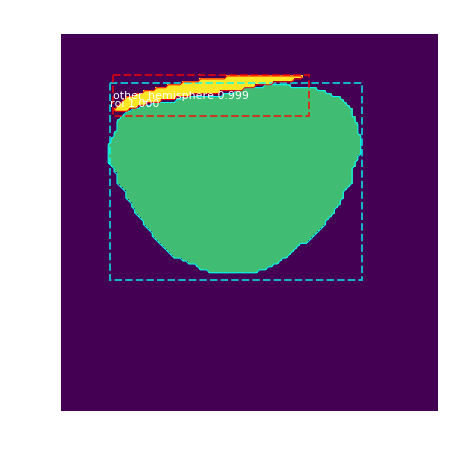

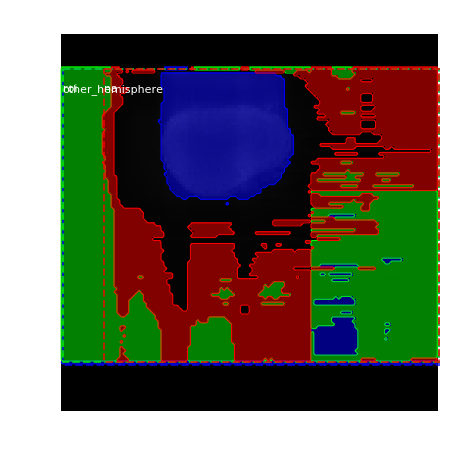

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   63.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -40.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 68%|██████▊   | 275/404 [08:10<03:53,  1.81s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   67.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


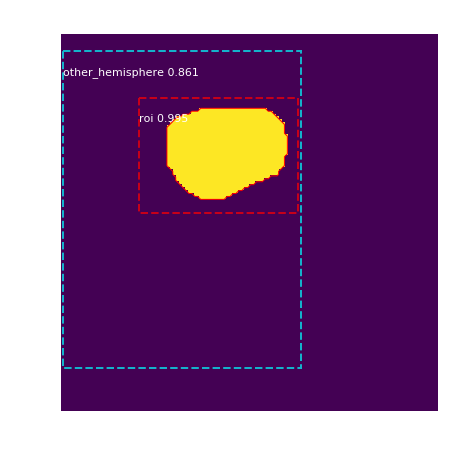

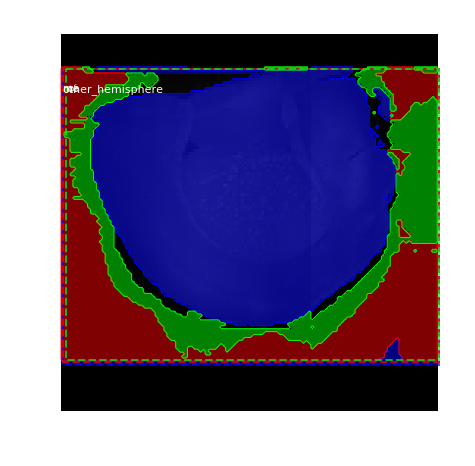

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   67.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -36.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 68%|██████▊   | 276/404 [08:11<03:44,  1.76s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   66.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


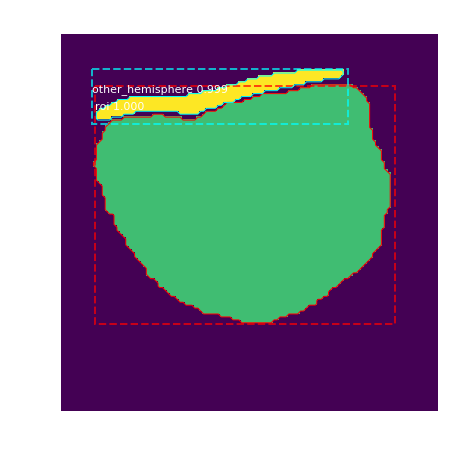

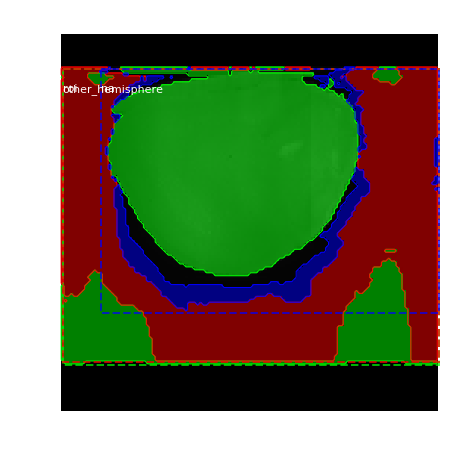

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   66.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -37.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 69%|██████▊   | 277/404 [08:13<03:45,  1.78s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   96.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  390.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


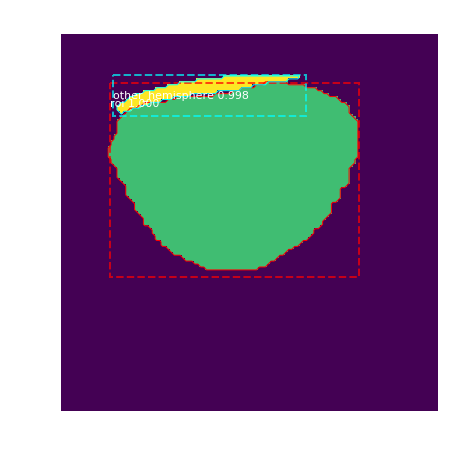

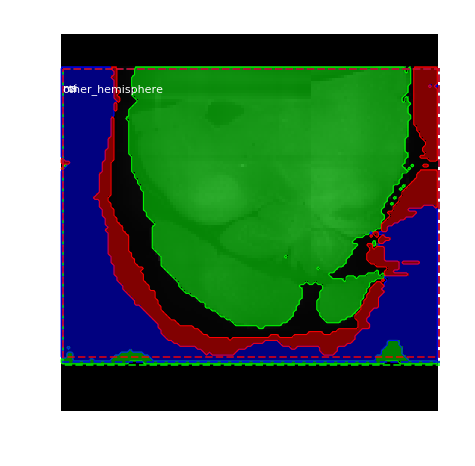

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   96.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:   -7.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 69%|██████▉   | 278/404 [08:15<03:46,  1.80s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   70.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  367.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


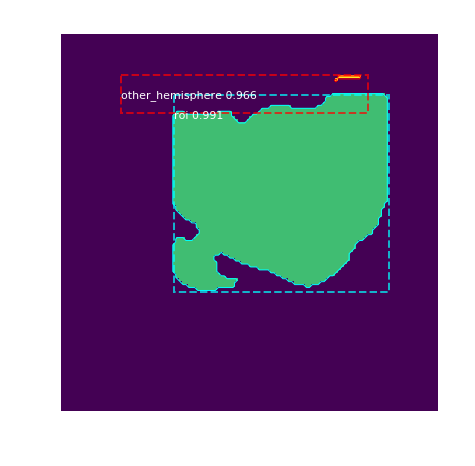

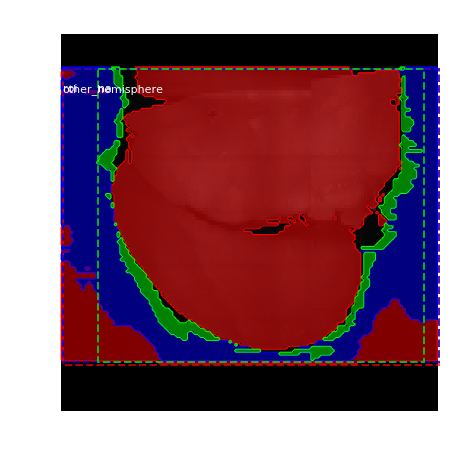

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   70.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -33.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 69%|██████▉   | 279/404 [08:17<03:43,  1.79s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   84.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


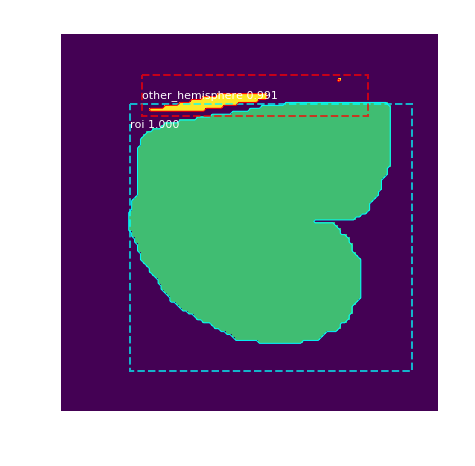

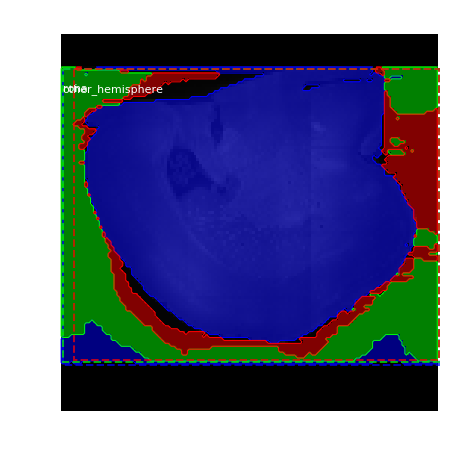

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   84.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -19.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 69%|██████▉   | 280/404 [08:19<03:37,  1.75s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   48.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


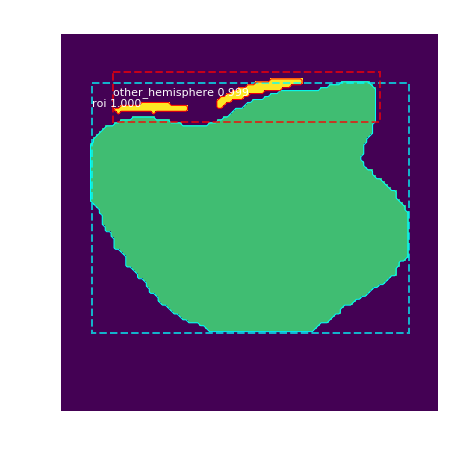

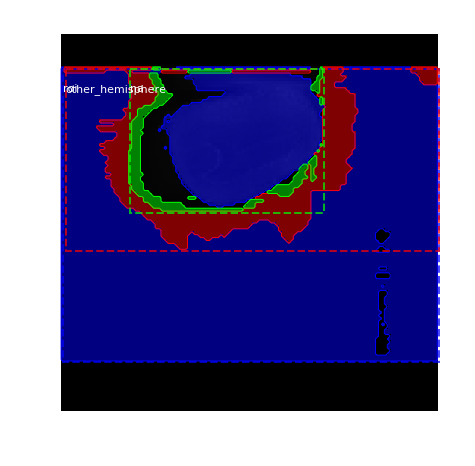

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   48.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -55.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 70%|██████▉   | 281/404 [08:20<03:39,  1.79s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   67.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


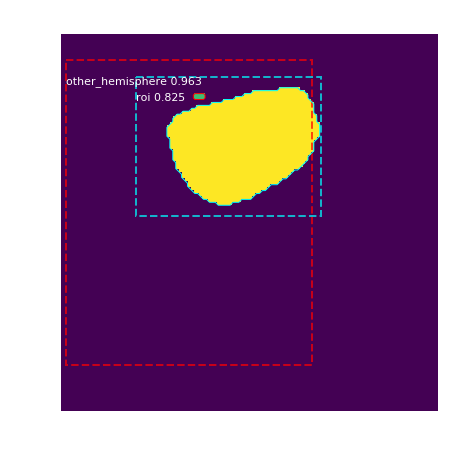

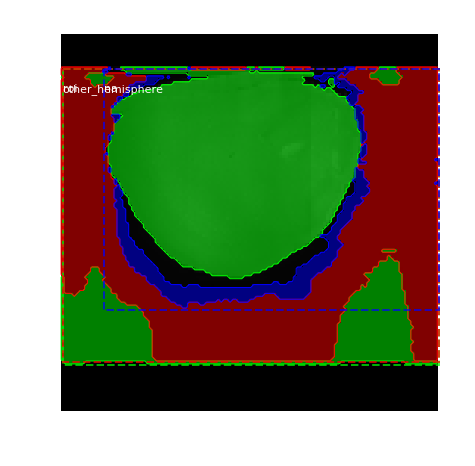

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   67.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -36.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 70%|██████▉   | 282/404 [08:22<03:42,  1.83s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   69.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


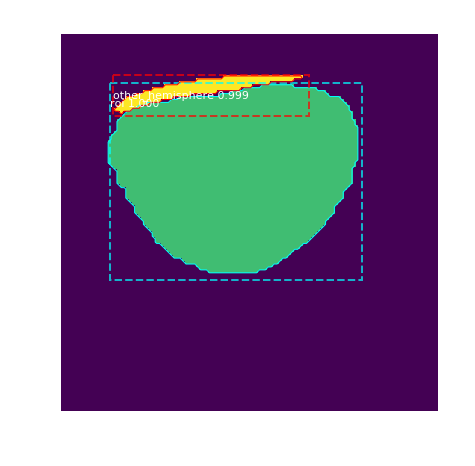

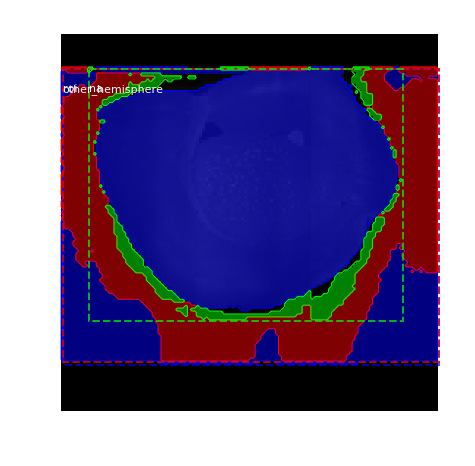

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   69.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -34.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 70%|███████   | 283/404 [08:24<03:41,  1.83s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   58.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


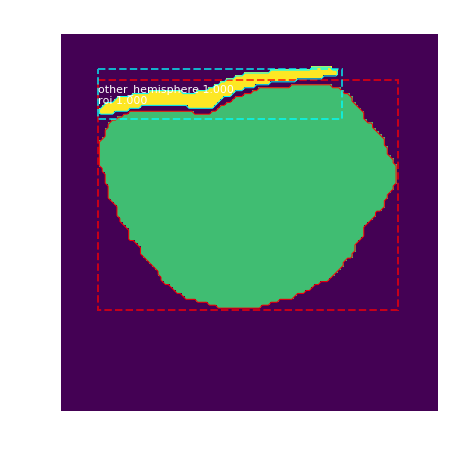

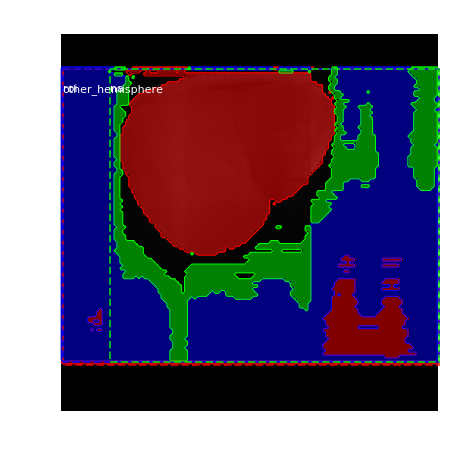

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   58.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -45.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 70%|███████   | 284/404 [08:26<03:41,  1.84s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   92.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  400.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


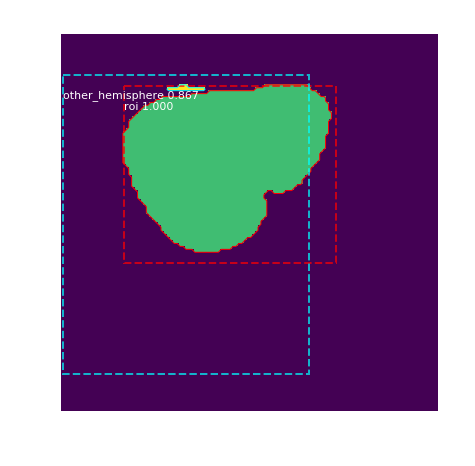

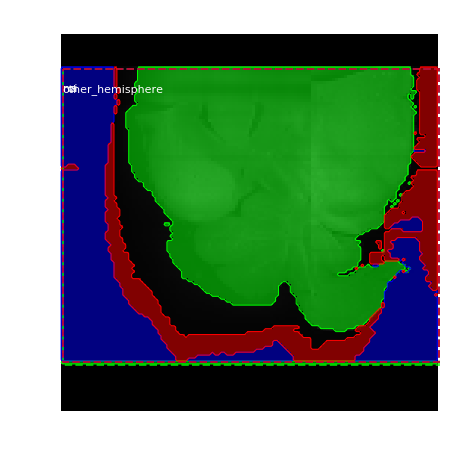

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   92.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -11.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 71%|███████   | 285/404 [08:28<03:41,  1.86s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   69.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


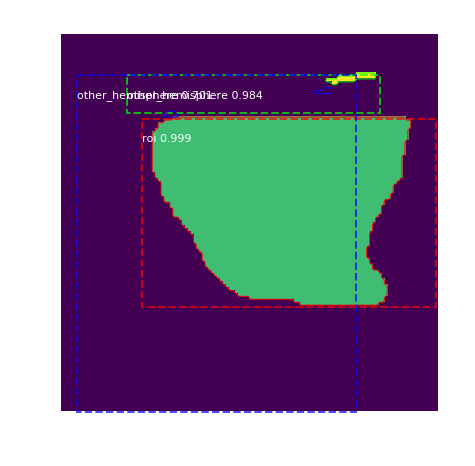

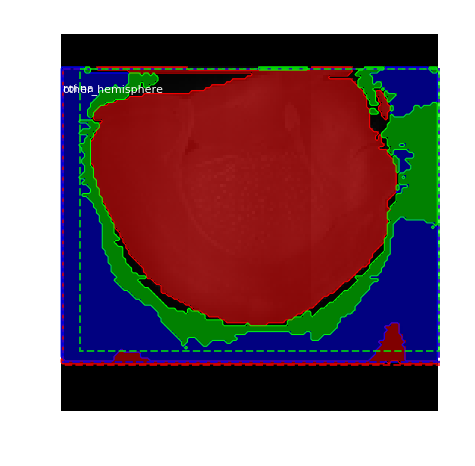

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   69.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -34.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 71%|███████   | 286/404 [08:30<03:36,  1.83s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   67.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


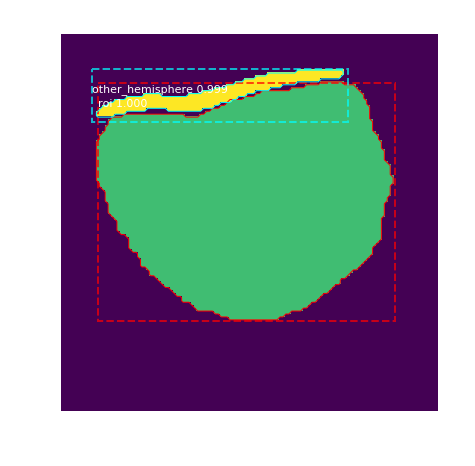

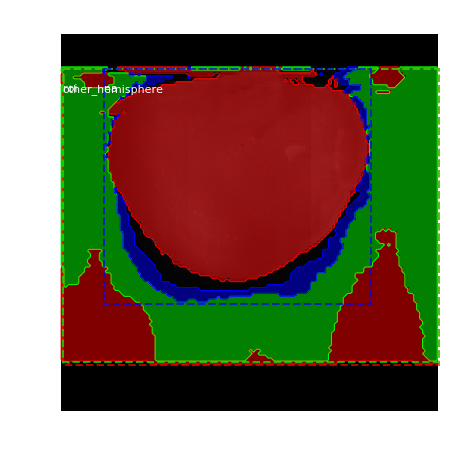

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   67.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -36.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 71%|███████   | 287/404 [08:32<03:37,  1.86s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   77.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


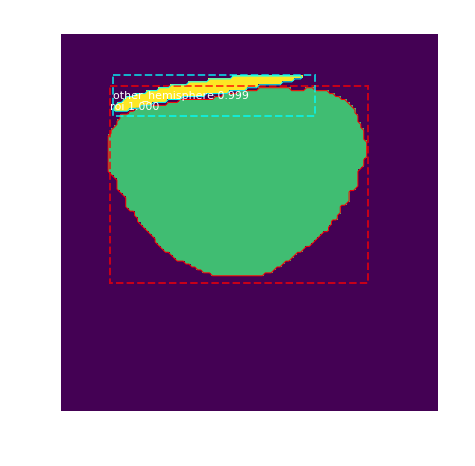

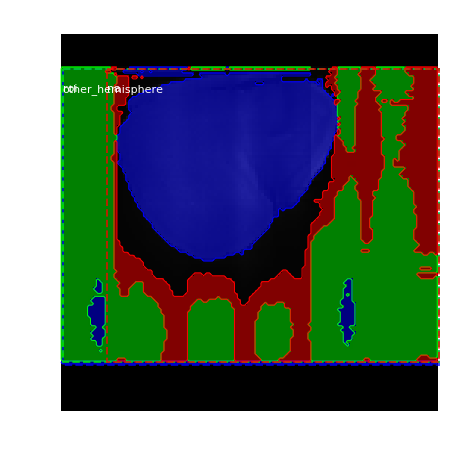

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   77.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -26.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 71%|███████▏  | 288/404 [08:33<03:33,  1.84s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   67.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


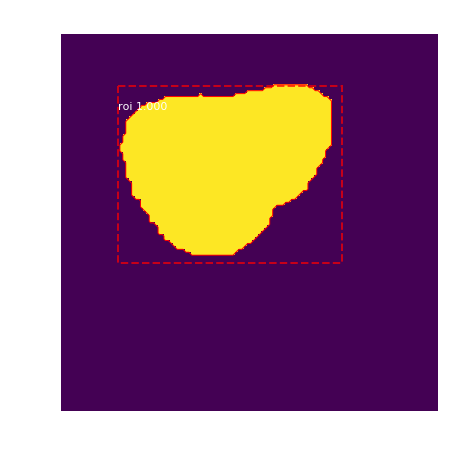

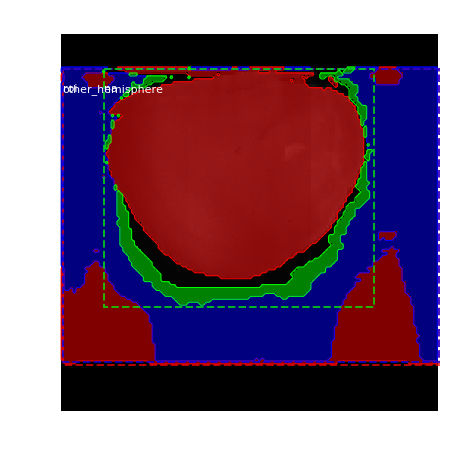

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   67.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -36.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 72%|███████▏  | 289/404 [08:36<03:38,  1.90s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   64.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


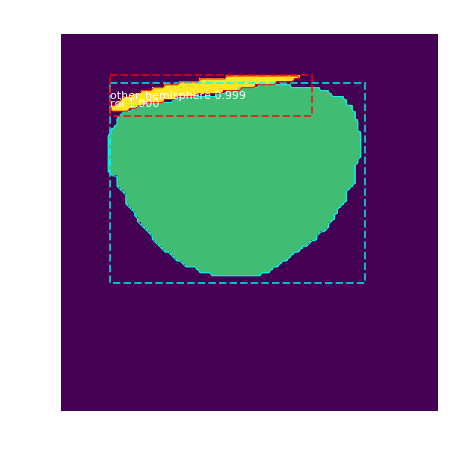

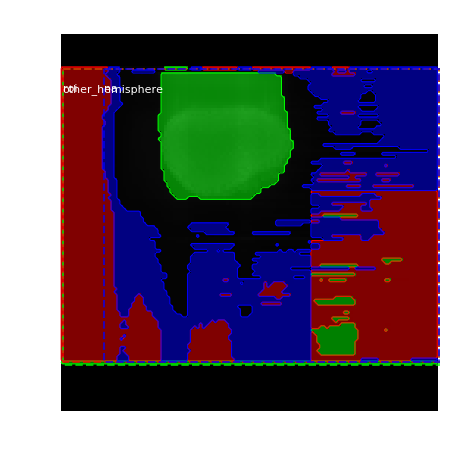

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   64.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -39.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 72%|███████▏  | 290/404 [08:37<03:35,  1.89s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:  104.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  304.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


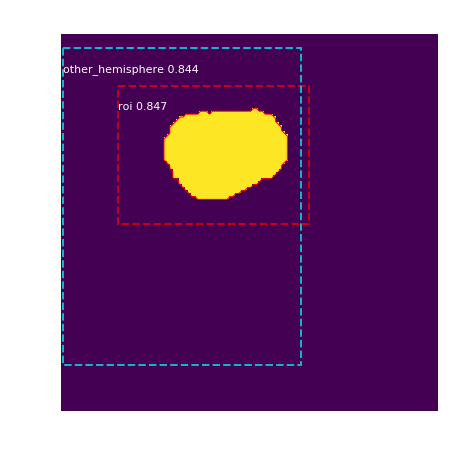

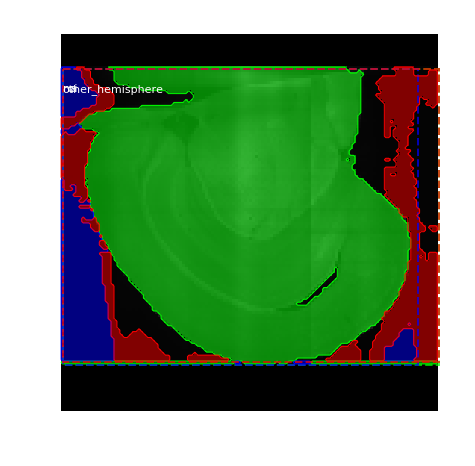

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:  104.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:    0.10000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 72%|███████▏  | 291/404 [08:39<03:23,  1.80s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   74.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


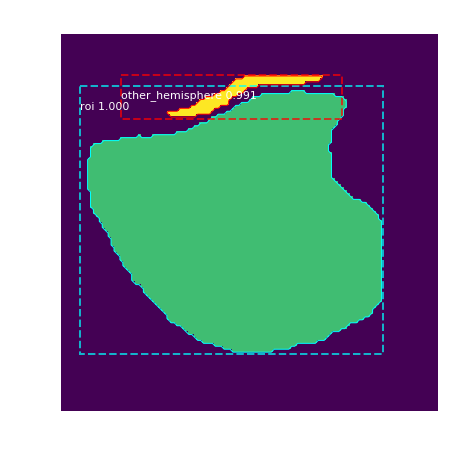

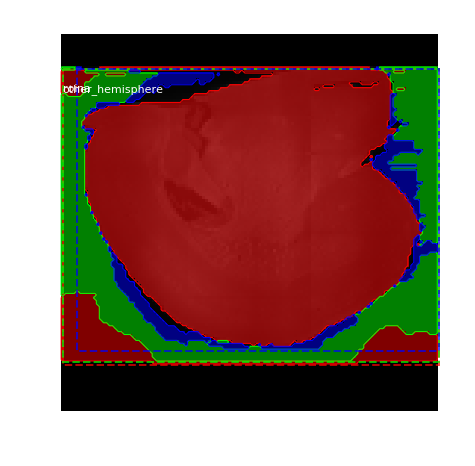

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   74.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -29.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 72%|███████▏  | 292/404 [08:41<03:15,  1.75s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   48.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


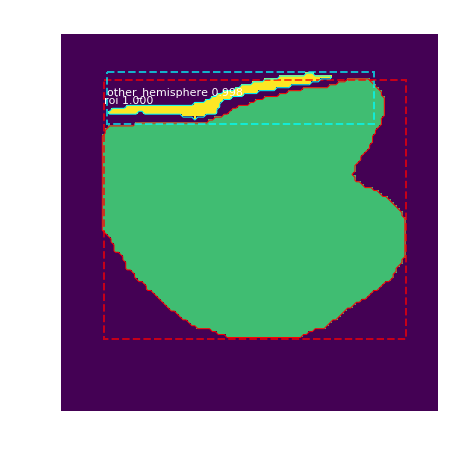

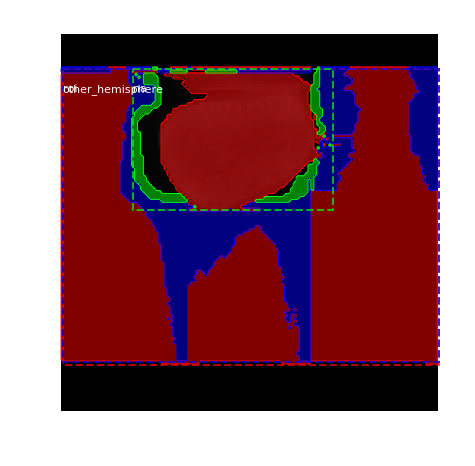

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   48.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -55.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 73%|███████▎  | 293/404 [08:43<03:20,  1.81s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   71.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


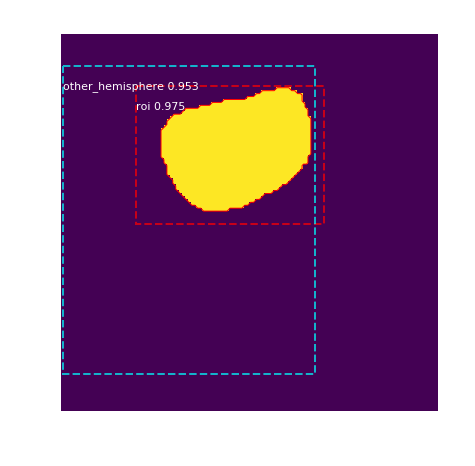

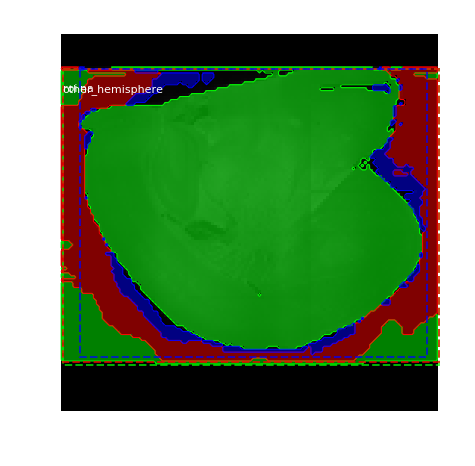

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   71.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -32.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 73%|███████▎  | 294/404 [08:44<03:18,  1.80s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   78.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


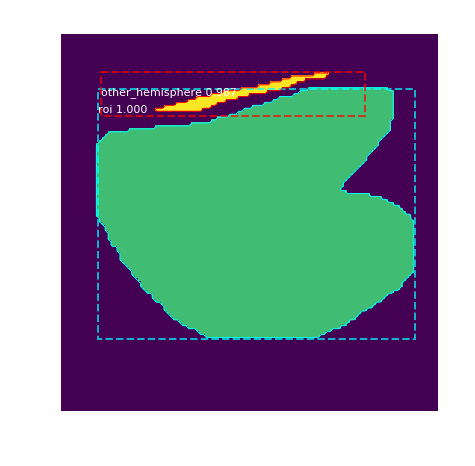

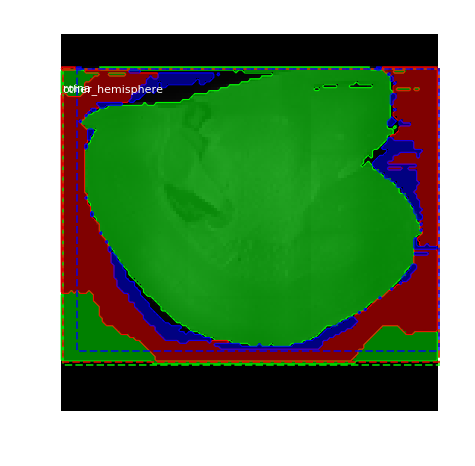

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   78.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -25.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 73%|███████▎  | 295/404 [08:46<03:25,  1.88s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   76.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


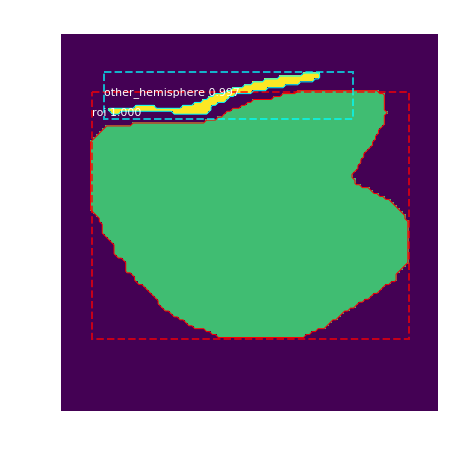

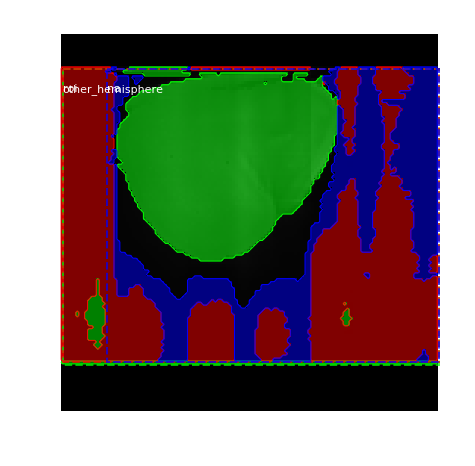

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   76.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -27.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 73%|███████▎  | 296/404 [08:48<03:19,  1.85s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   64.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


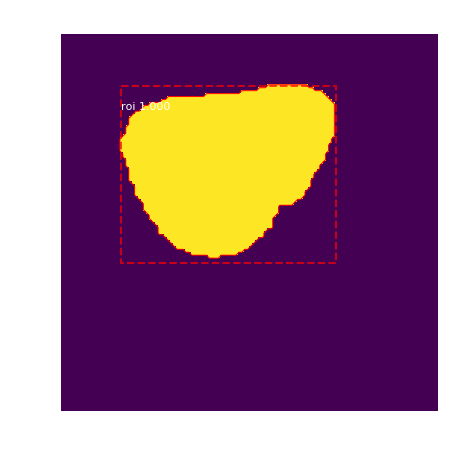

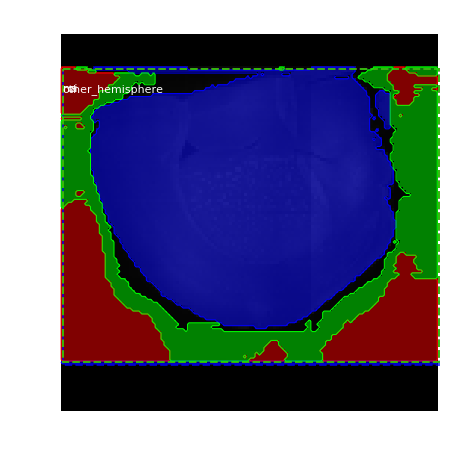

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   64.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -39.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 74%|███████▎  | 297/404 [08:50<03:13,  1.81s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   80.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


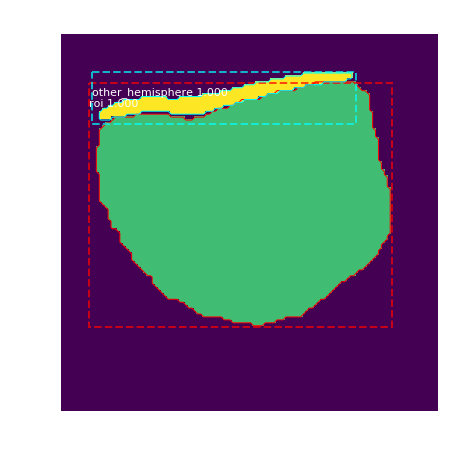

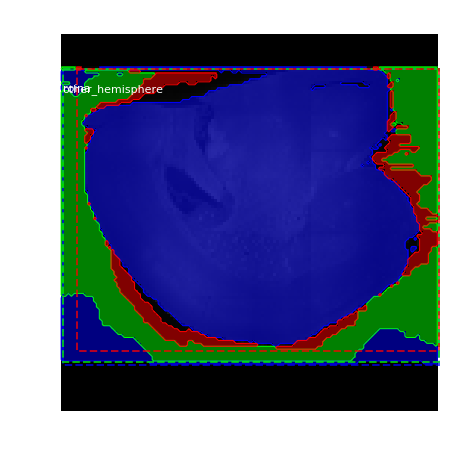

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   80.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -23.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 74%|███████▍  | 298/404 [08:52<03:13,  1.83s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   87.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


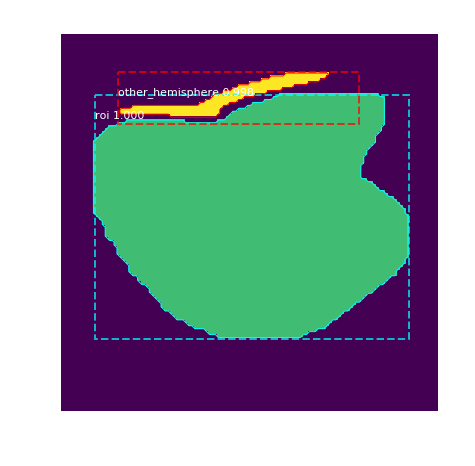

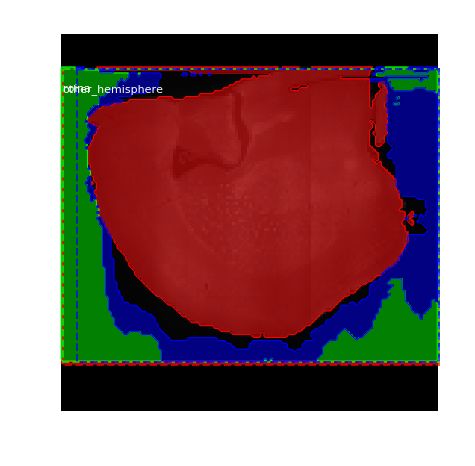

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   87.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -16.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 74%|███████▍  | 299/404 [08:53<03:06,  1.77s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   99.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  397.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


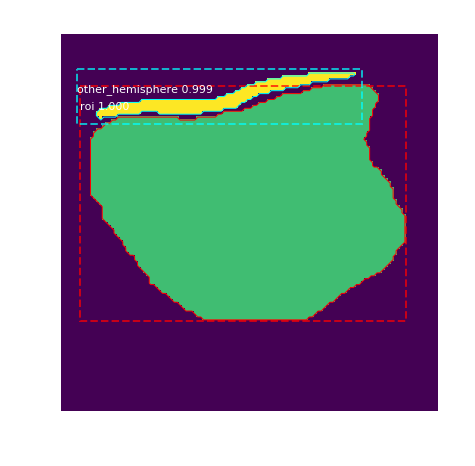

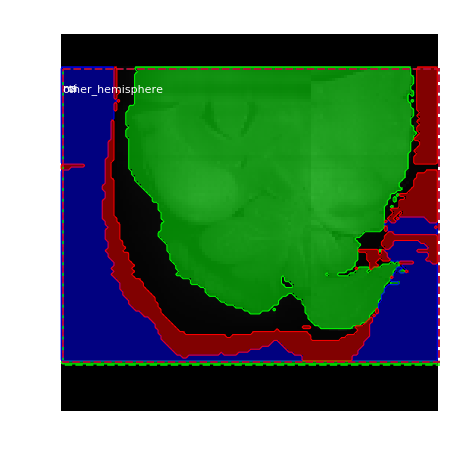

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   99.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:   -4.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 74%|███████▍  | 300/404 [08:55<03:08,  1.81s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   97.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  391.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


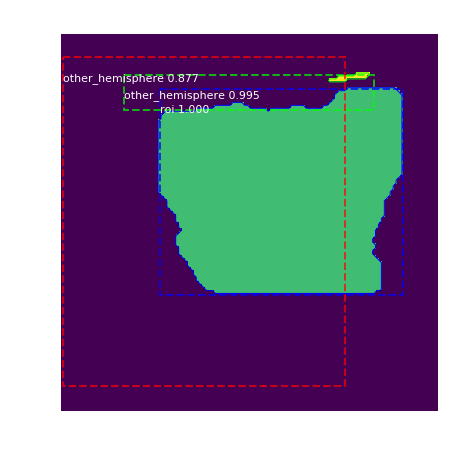

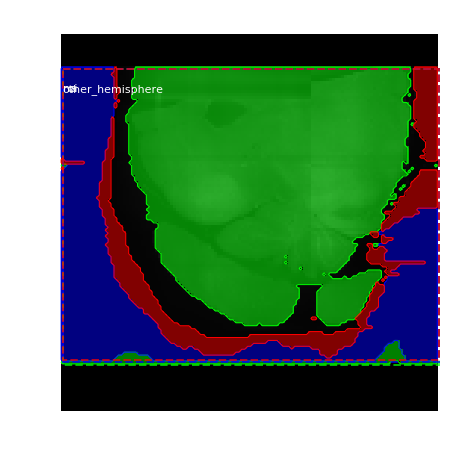

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   97.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:   -6.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 75%|███████▍  | 301/404 [08:57<03:02,  1.77s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   87.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


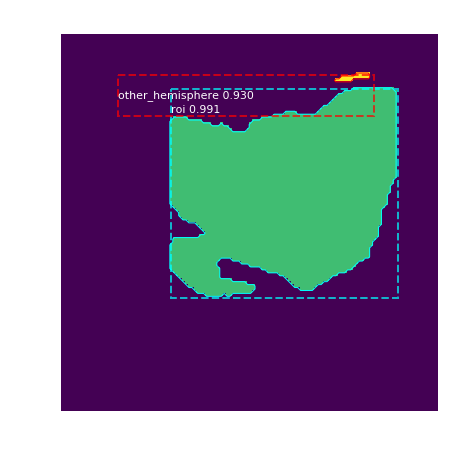

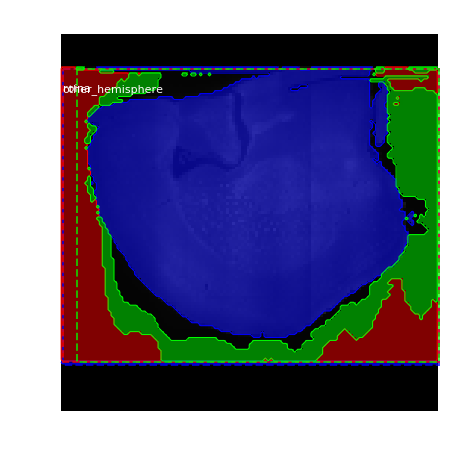

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   87.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -16.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 75%|███████▍  | 302/404 [08:59<03:04,  1.81s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   66.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


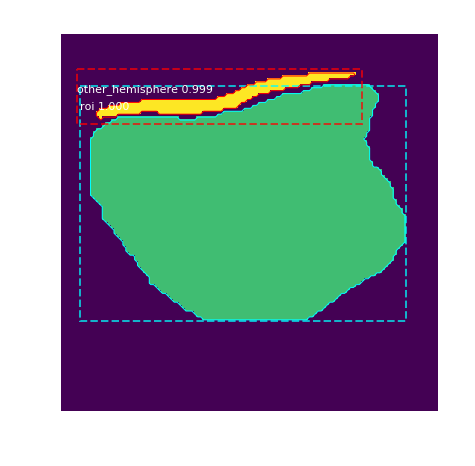

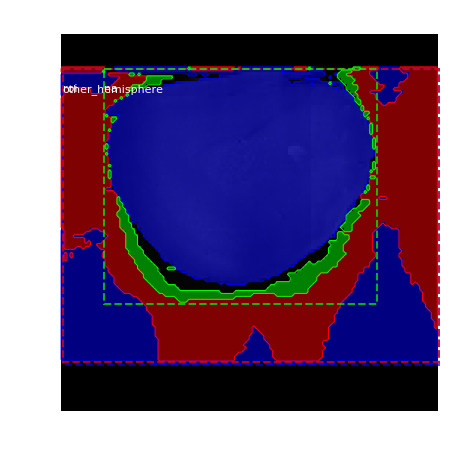

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   66.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -37.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 75%|███████▌  | 303/404 [09:01<03:02,  1.80s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:  109.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  305.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


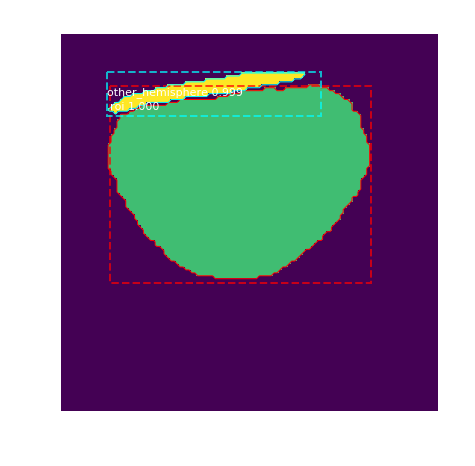

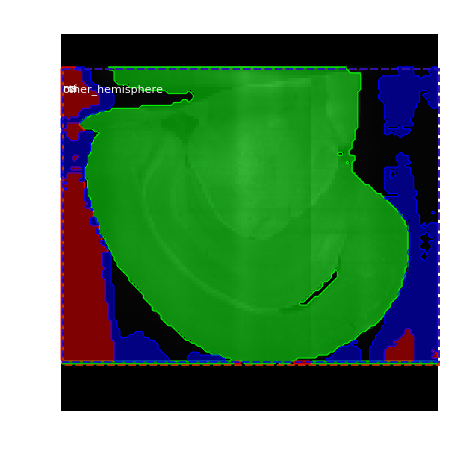

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:  109.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:    5.10000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 75%|███████▌  | 304/404 [09:03<03:01,  1.82s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:  108.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


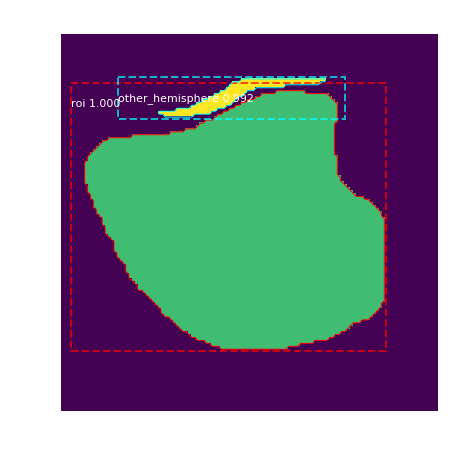

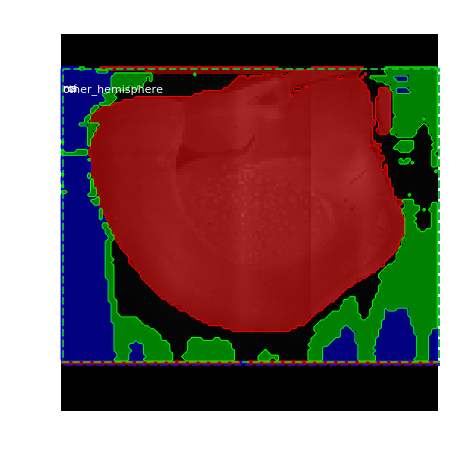

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:  108.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:    4.10000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 75%|███████▌  | 305/404 [09:04<03:00,  1.82s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   72.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


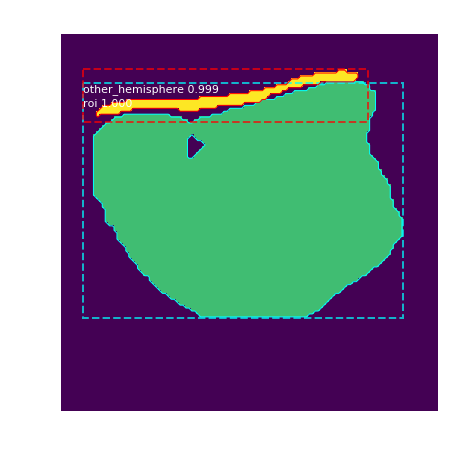

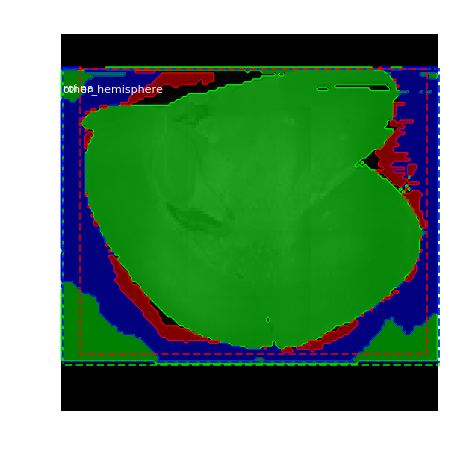

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   72.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -31.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 76%|███████▌  | 306/404 [09:06<03:06,  1.90s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   49.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


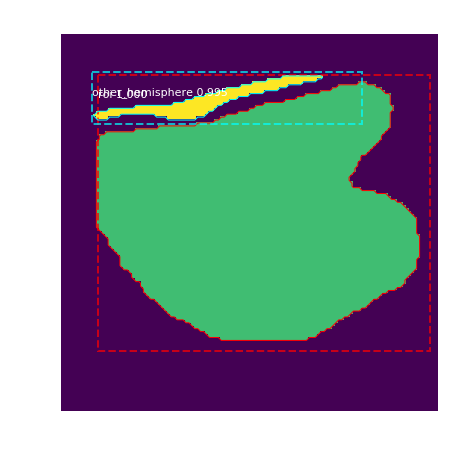

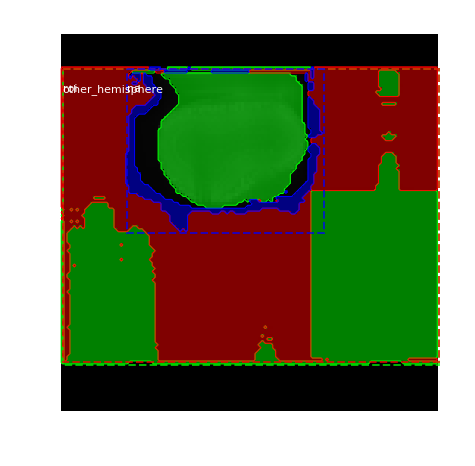

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   49.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -54.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 76%|███████▌  | 307/404 [09:08<03:04,  1.91s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:  108.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  323.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


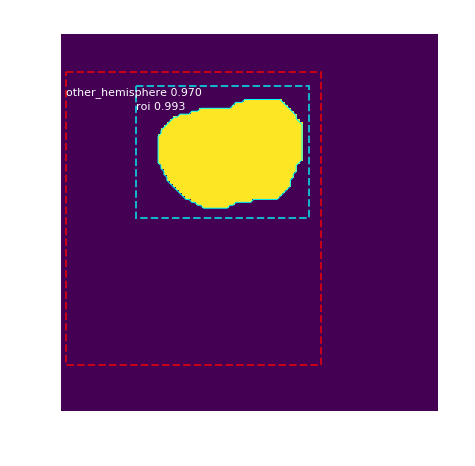

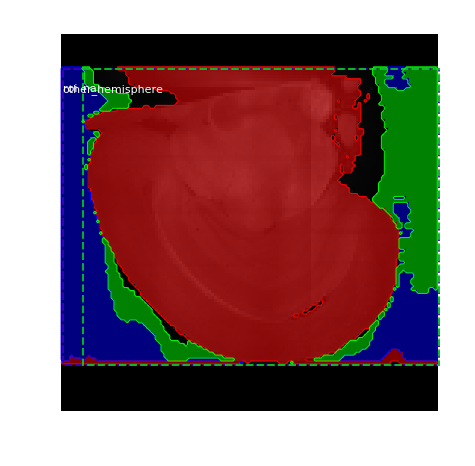

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:  108.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:    4.10000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 76%|███████▌  | 308/404 [09:10<03:00,  1.88s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   76.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


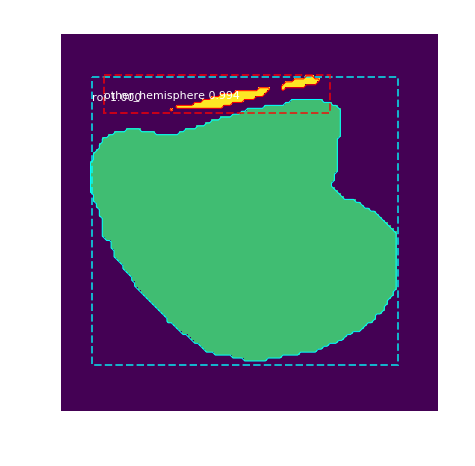

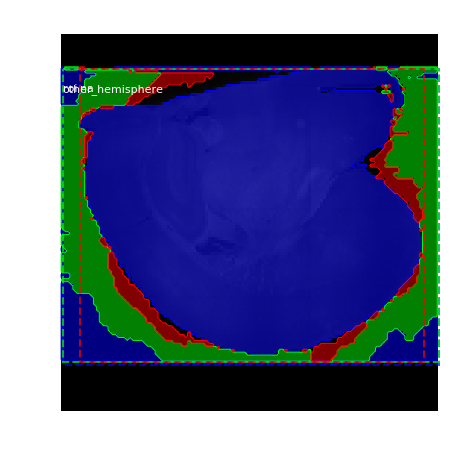

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   76.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -27.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 76%|███████▋  | 309/404 [09:12<03:09,  2.00s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   67.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


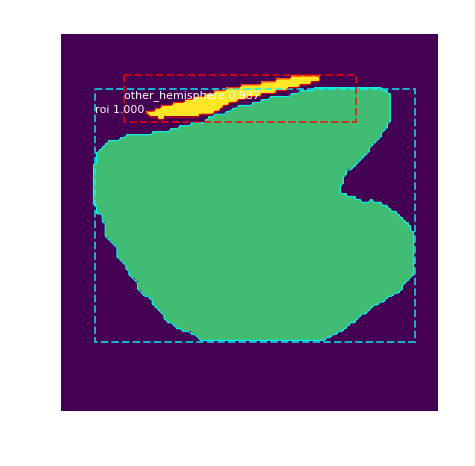

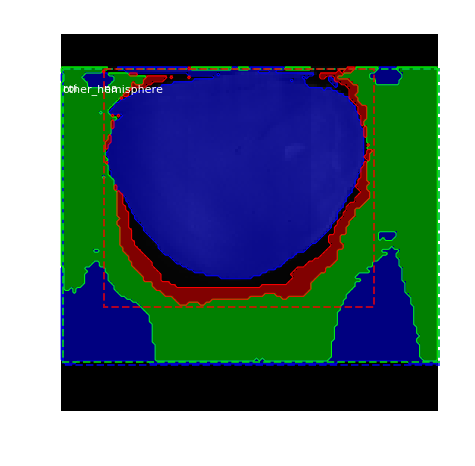

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   67.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -36.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 77%|███████▋  | 310/404 [09:14<03:02,  1.94s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   47.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


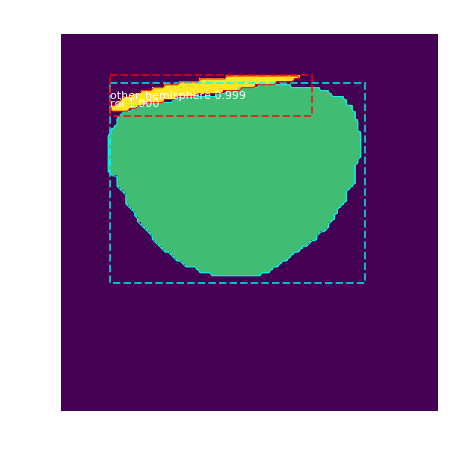

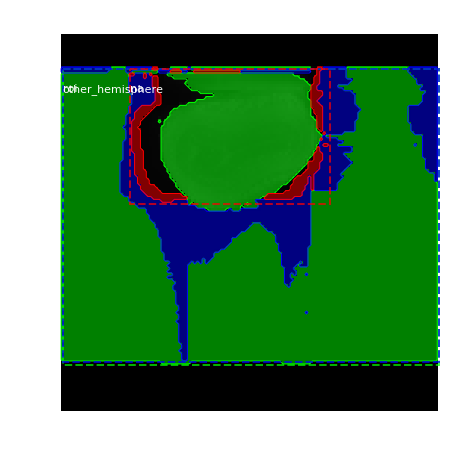

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   47.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -56.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 77%|███████▋  | 311/404 [09:16<02:59,  1.93s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   77.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  369.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


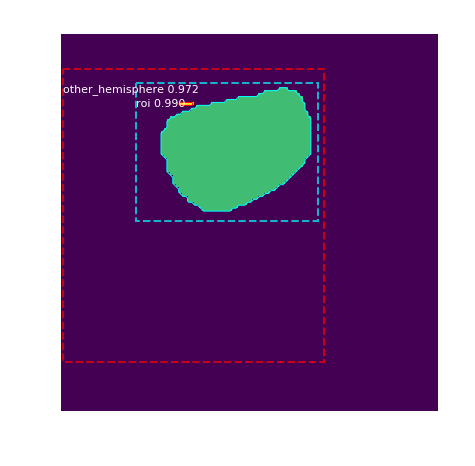

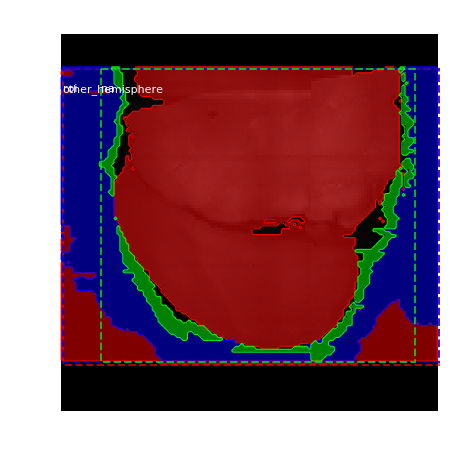

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   77.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -26.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 77%|███████▋  | 312/404 [09:18<02:55,  1.91s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   88.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  376.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


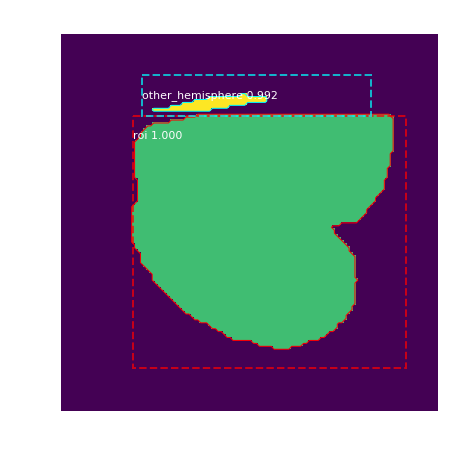

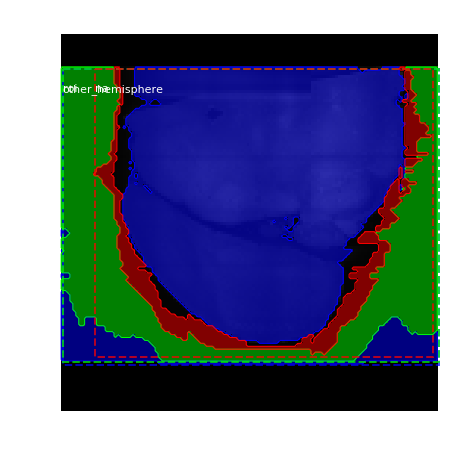

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   88.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -15.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 77%|███████▋  | 313/404 [09:20<02:52,  1.89s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   67.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


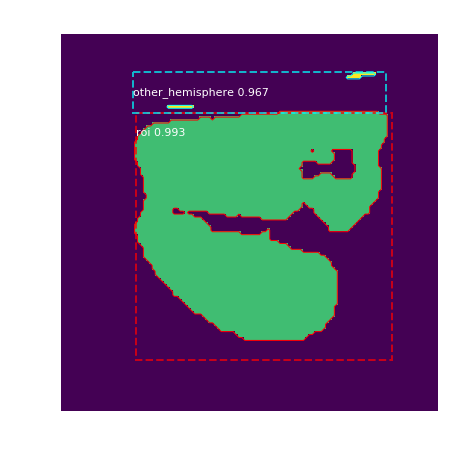

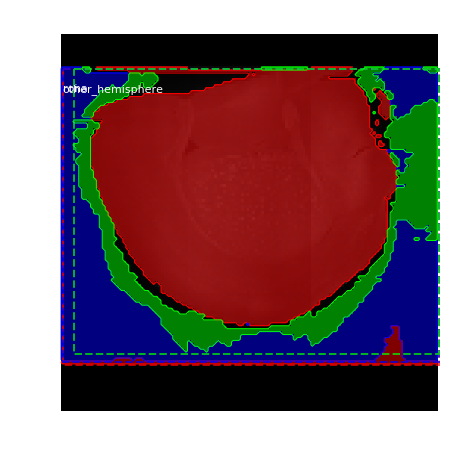

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   67.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -36.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 78%|███████▊  | 314/404 [09:22<02:50,  1.90s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   88.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


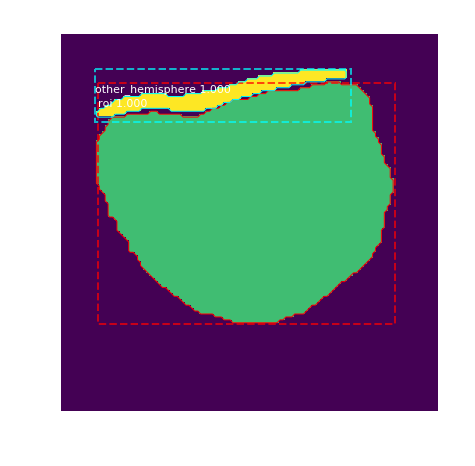

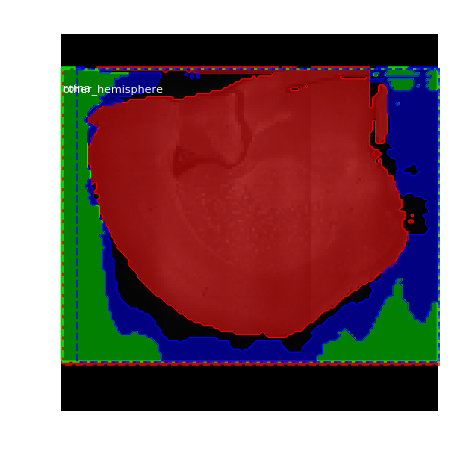

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   88.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -15.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 78%|███████▊  | 315/404 [09:24<02:47,  1.88s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   86.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  340.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


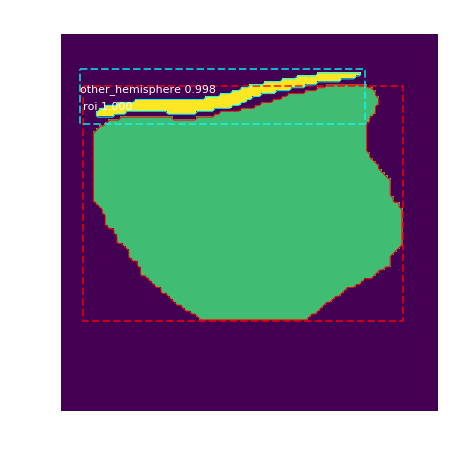

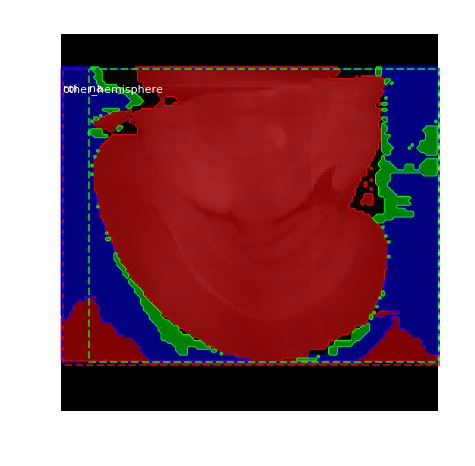

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   86.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -17.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 78%|███████▊  | 316/404 [09:26<02:46,  1.89s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   84.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  331.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


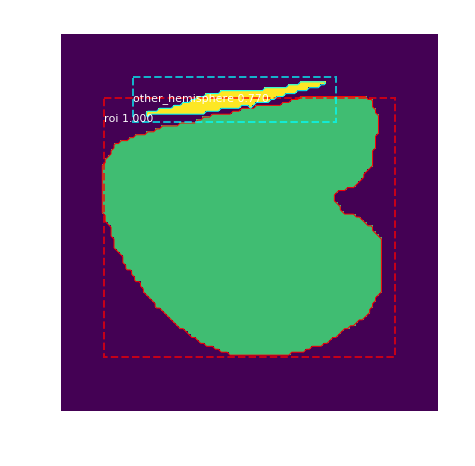

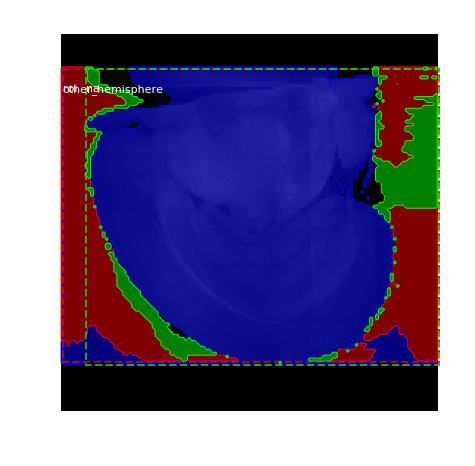

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   84.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -19.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 78%|███████▊  | 317/404 [09:27<02:44,  1.89s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   72.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


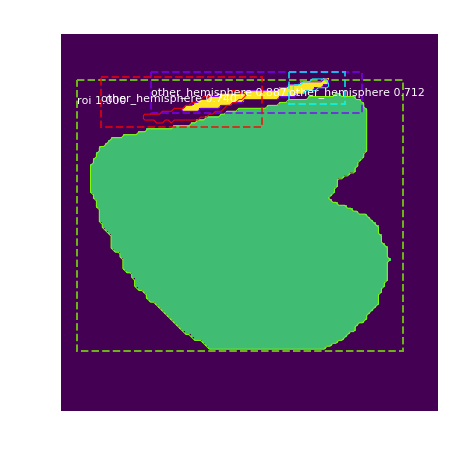

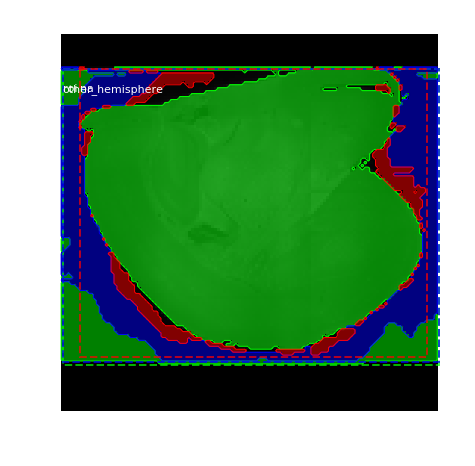

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   72.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -31.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 79%|███████▊  | 318/404 [09:29<02:43,  1.91s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   47.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


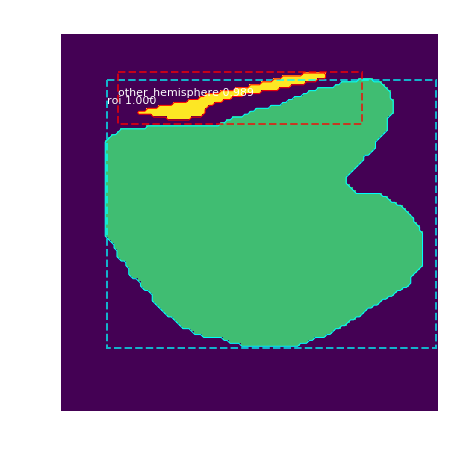

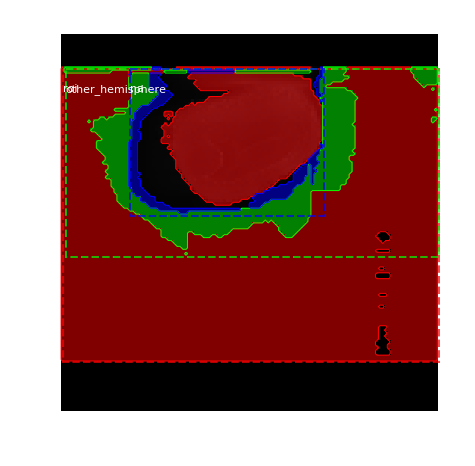

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   47.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -56.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 79%|███████▉  | 319/404 [09:31<02:42,  1.91s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   98.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


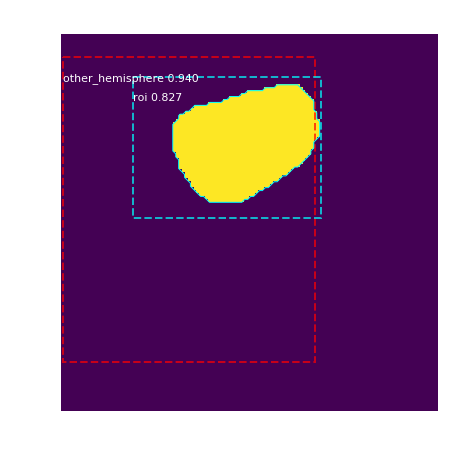

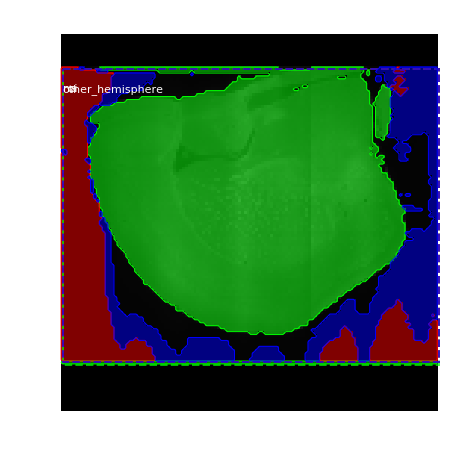

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   98.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:   -5.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 79%|███████▉  | 320/404 [09:33<02:38,  1.89s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   77.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  284.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


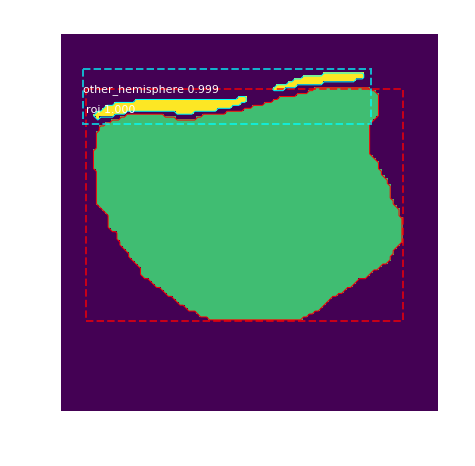

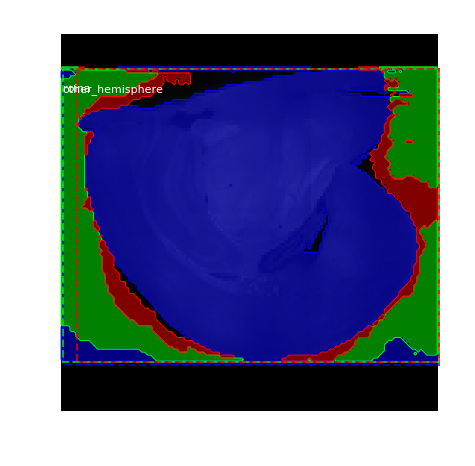

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   77.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -26.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 79%|███████▉  | 321/404 [09:35<02:41,  1.94s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   67.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


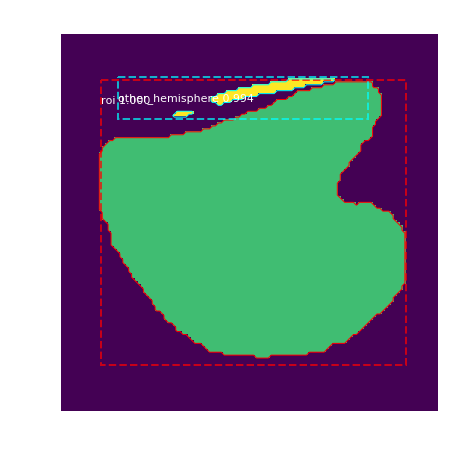

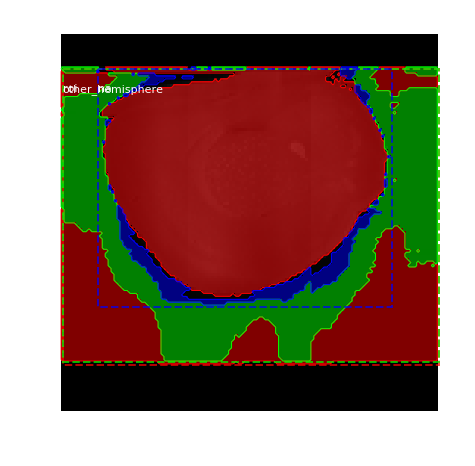

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   67.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -36.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 80%|███████▉  | 322/404 [09:37<02:47,  2.04s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   86.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


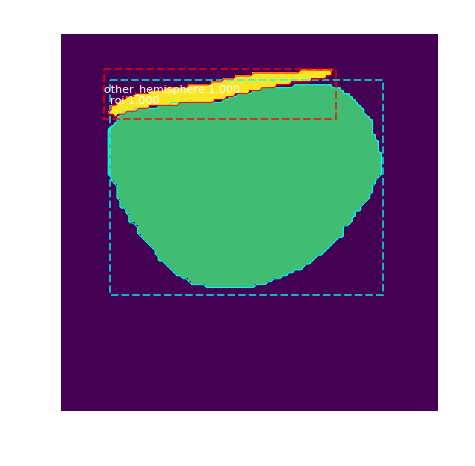

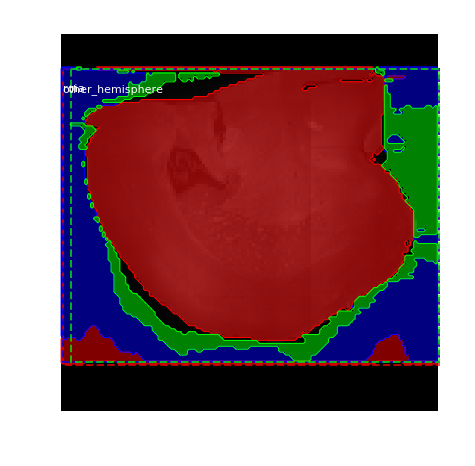

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   86.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -17.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 80%|███████▉  | 323/404 [09:40<02:46,  2.06s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   49.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


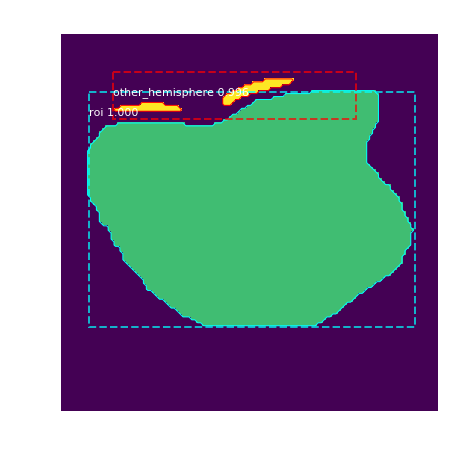

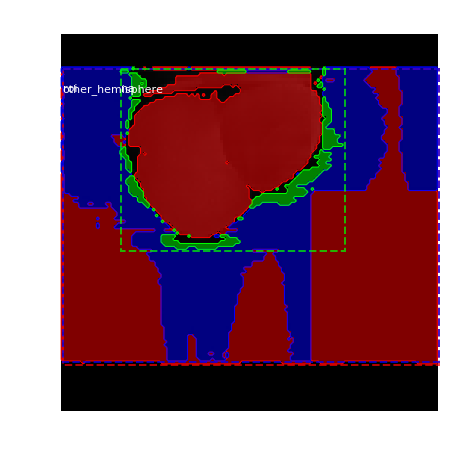

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   49.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -54.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 80%|████████  | 324/404 [09:42<02:41,  2.02s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   78.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  350.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


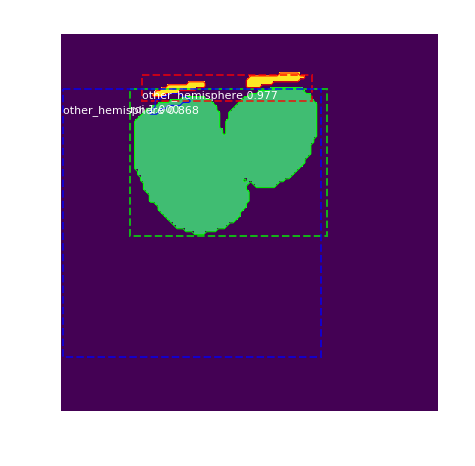

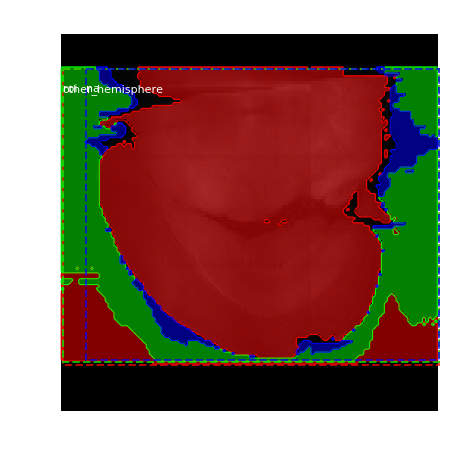

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   78.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -25.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 80%|████████  | 325/404 [09:43<02:38,  2.01s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   92.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  328.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


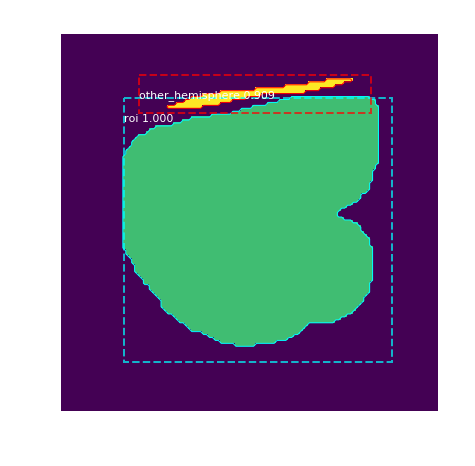

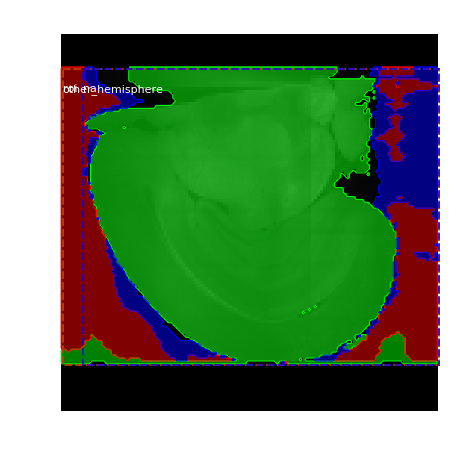

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   92.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -11.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 81%|████████  | 326/404 [09:45<02:31,  1.94s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   80.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


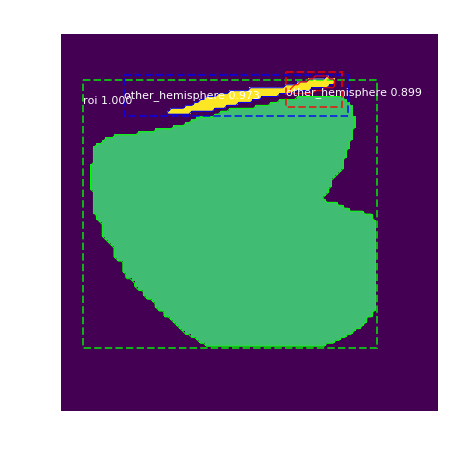

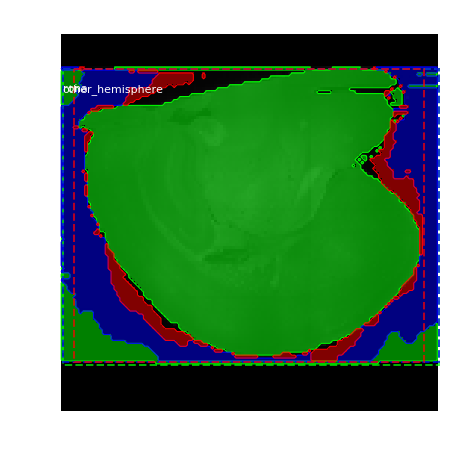

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   80.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -23.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 81%|████████  | 327/404 [09:47<02:32,  1.97s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   58.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


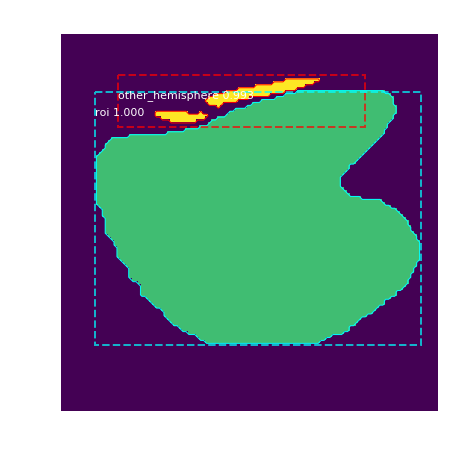

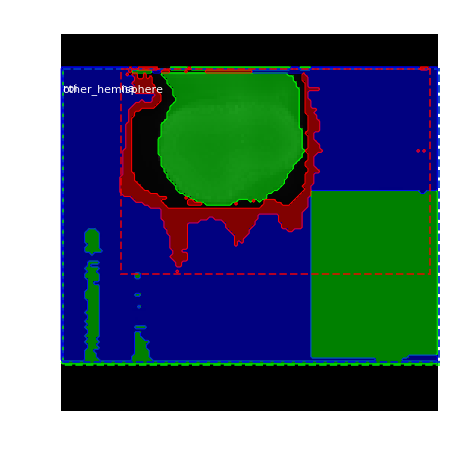

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   58.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -45.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 81%|████████  | 328/404 [09:49<02:27,  1.94s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   73.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


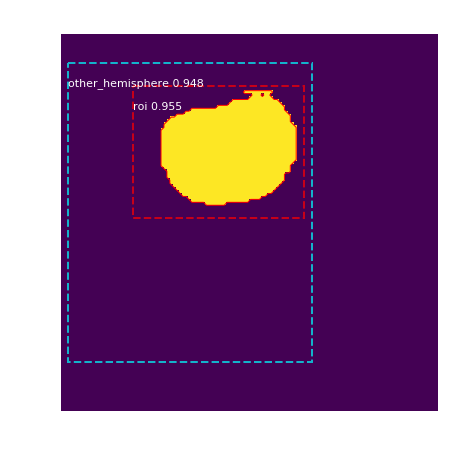

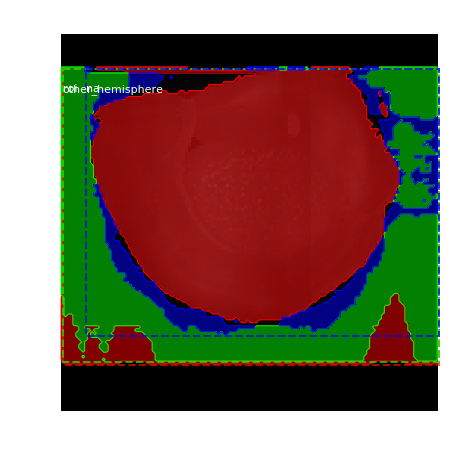

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   73.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -30.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 81%|████████▏ | 329/404 [09:51<02:27,  1.96s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:  104.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  319.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


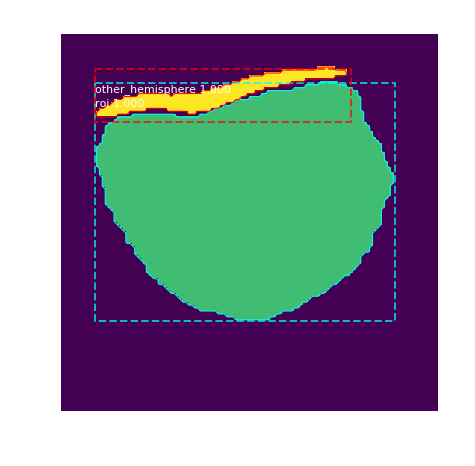

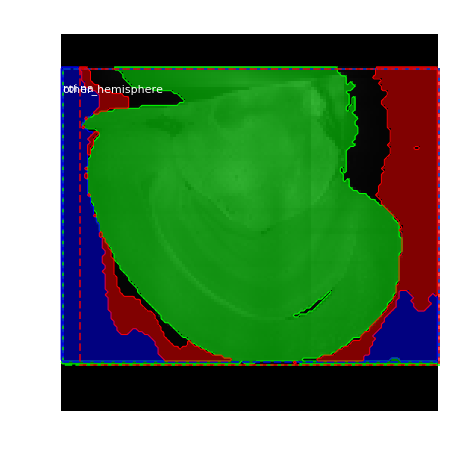

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:  104.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:    0.10000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 82%|████████▏ | 330/404 [09:53<02:22,  1.93s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   90.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  336.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


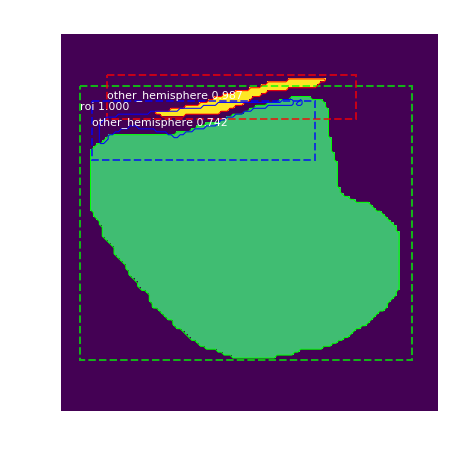

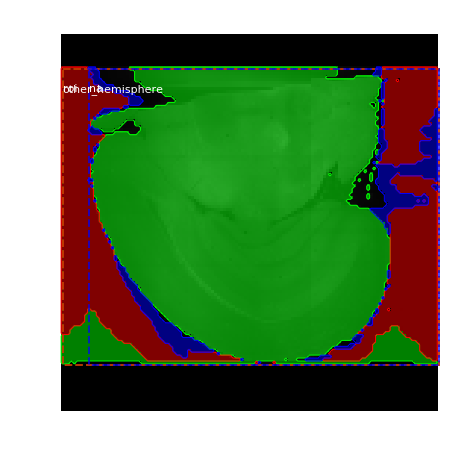

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   90.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -13.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 82%|████████▏ | 331/404 [09:55<02:18,  1.90s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   67.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


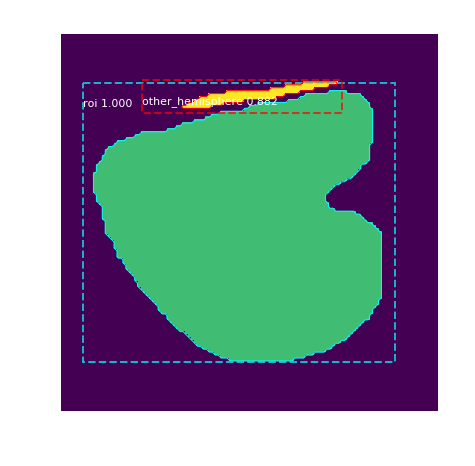

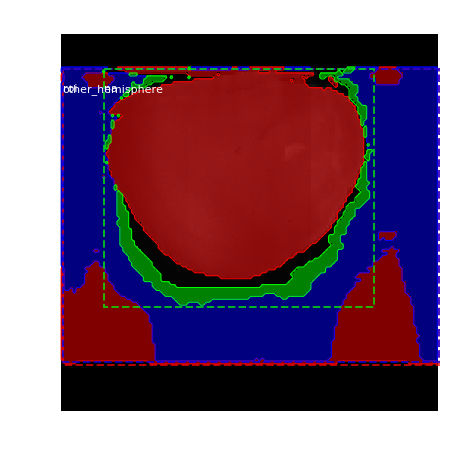

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   67.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -36.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 82%|████████▏ | 332/404 [09:57<02:15,  1.88s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   88.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  385.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


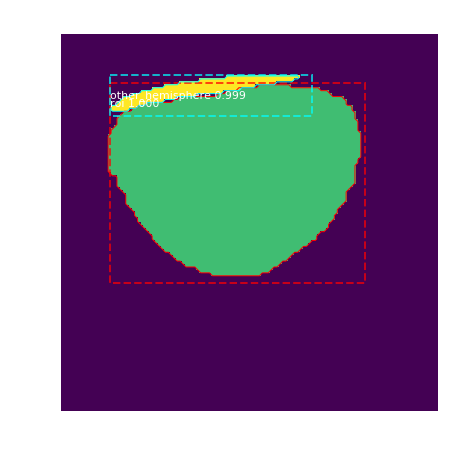

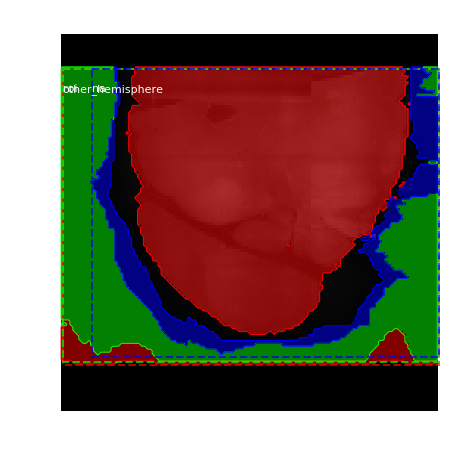

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   88.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -15.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 82%|████████▏ | 333/404 [09:59<02:12,  1.87s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   49.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


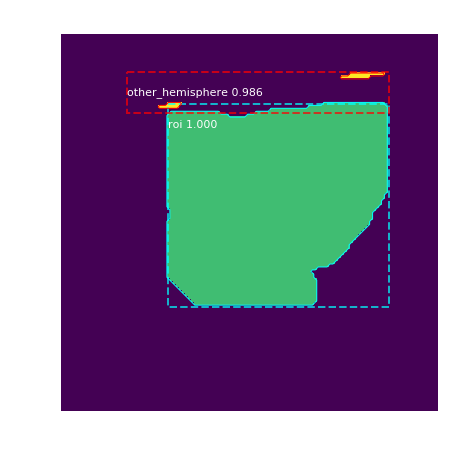

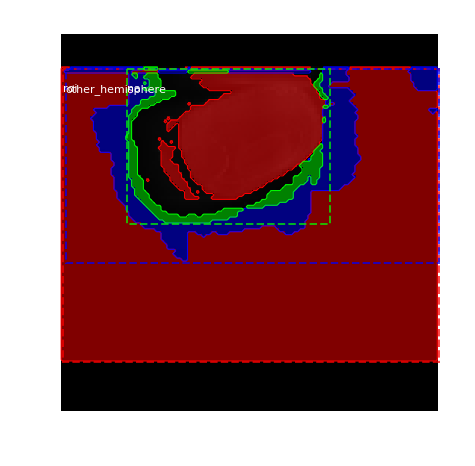

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   49.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -54.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 83%|████████▎ | 334/404 [10:00<02:05,  1.79s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   88.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  385.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


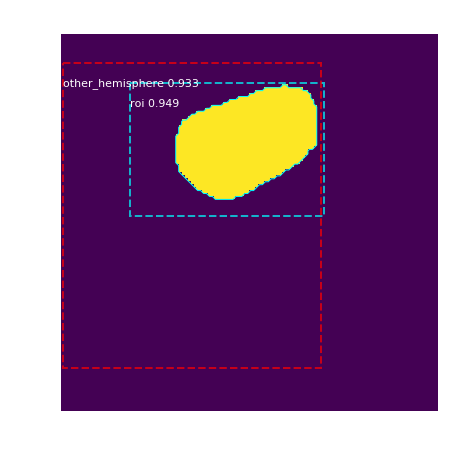

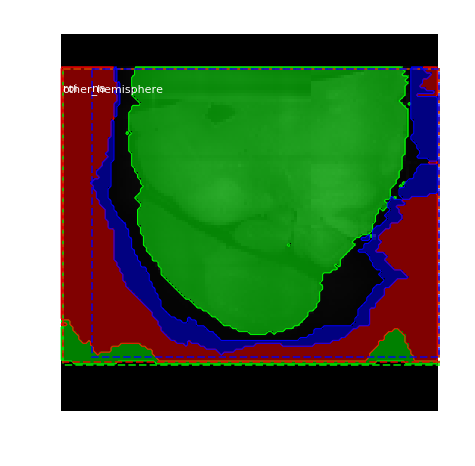

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   88.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -15.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 83%|████████▎ | 335/404 [10:02<02:06,  1.83s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   48.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


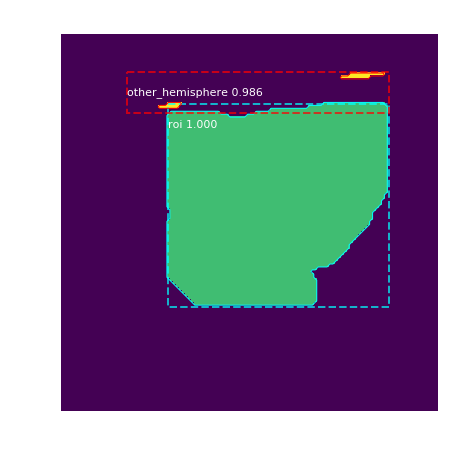

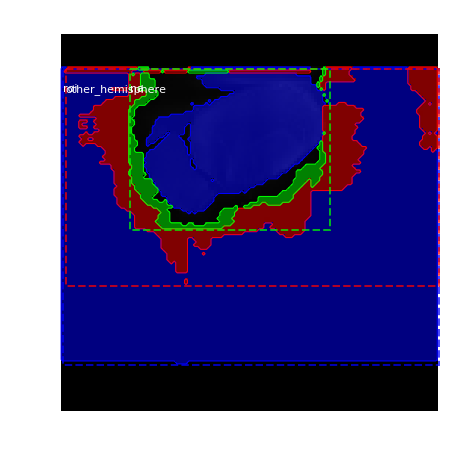

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   48.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -55.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 83%|████████▎ | 336/404 [10:04<02:05,  1.84s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   80.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


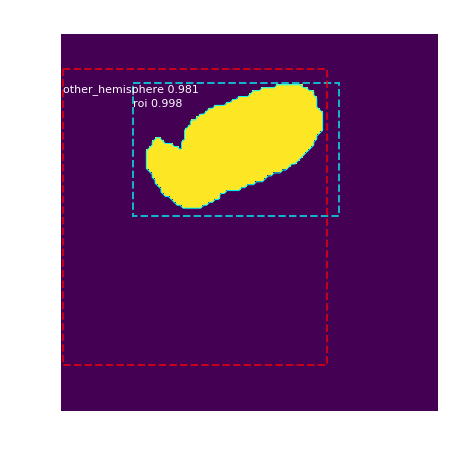

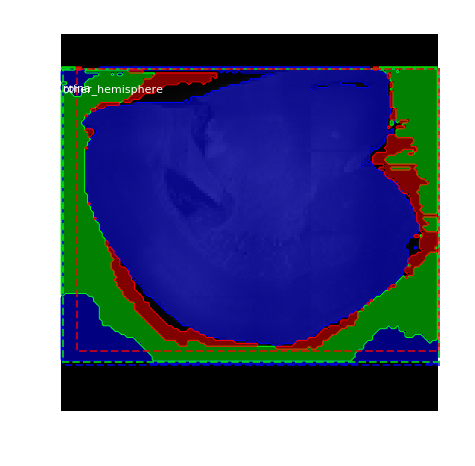

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   80.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -23.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 83%|████████▎ | 337/404 [10:06<02:08,  1.92s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   98.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


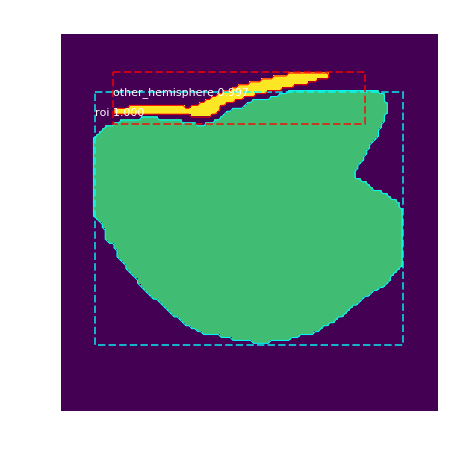

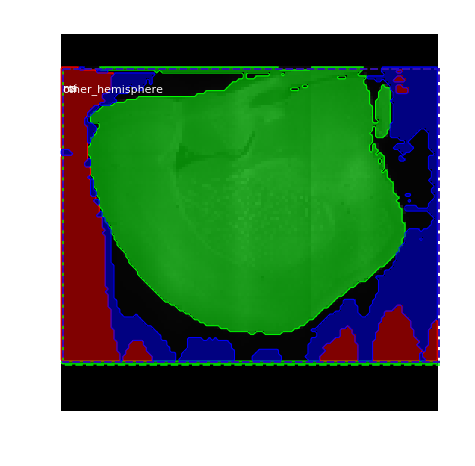

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   98.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:   -5.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 84%|████████▎ | 338/404 [10:08<02:03,  1.88s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:  100.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


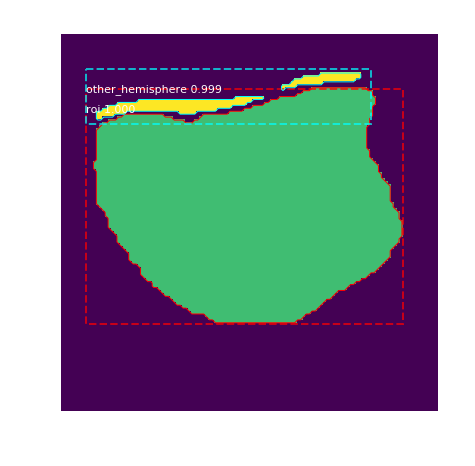

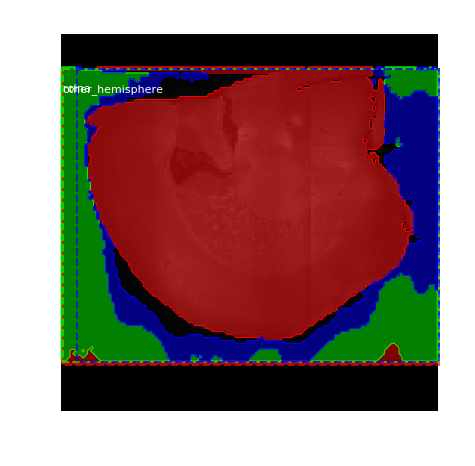

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:  100.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:   -3.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 84%|████████▍ | 339/404 [10:10<02:00,  1.86s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:  107.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  386.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


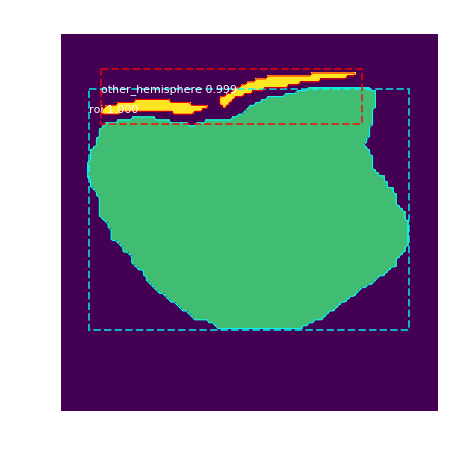

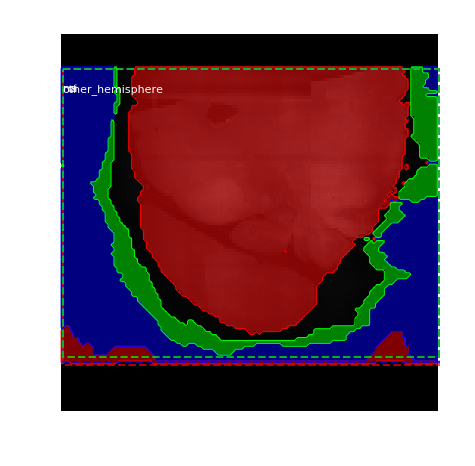

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:  107.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:    3.10000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 84%|████████▍ | 340/404 [10:11<01:58,  1.86s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   96.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  390.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


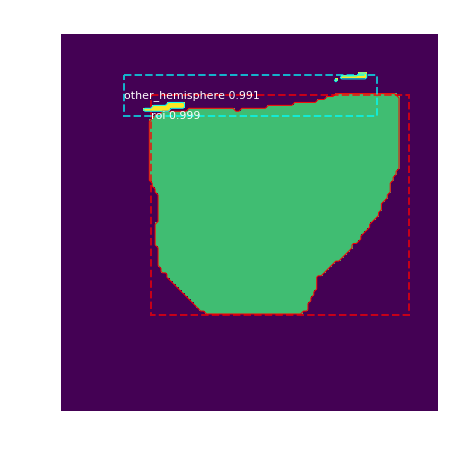

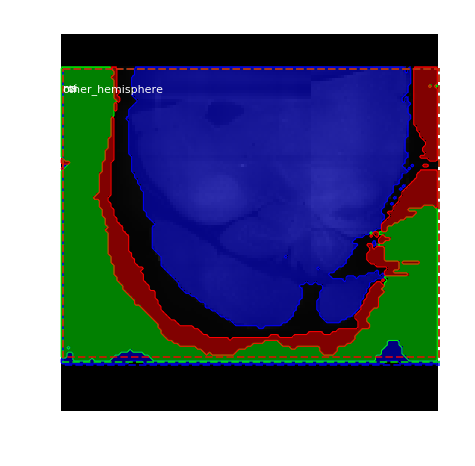

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   96.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:   -7.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 84%|████████▍ | 341/404 [10:13<01:58,  1.88s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   99.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  316.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


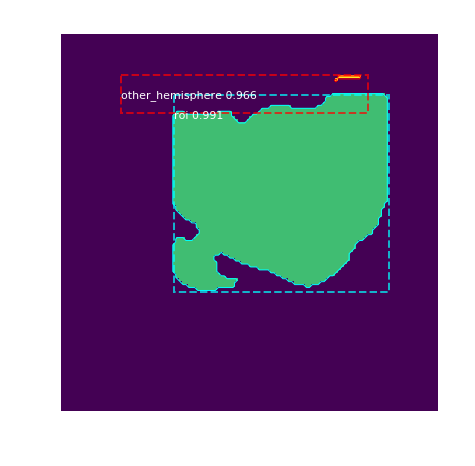

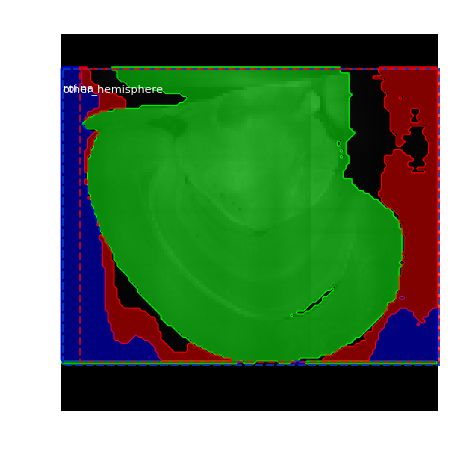

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   99.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:   -4.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 85%|████████▍ | 342/404 [10:15<01:56,  1.88s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   98.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


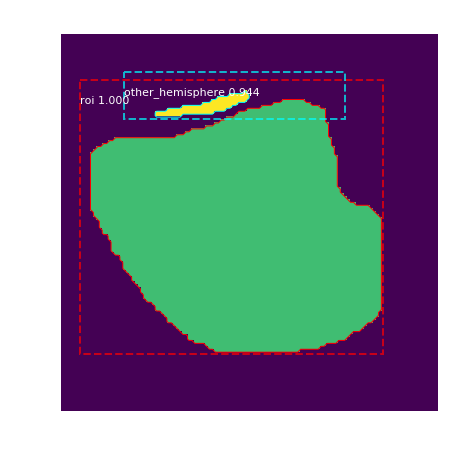

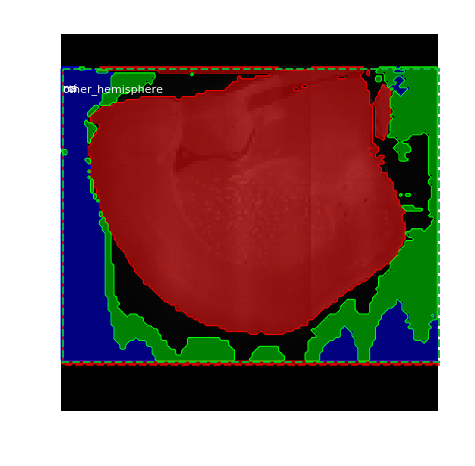

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   98.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:   -5.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 85%|████████▍ | 343/404 [10:17<01:53,  1.86s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   78.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  351.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


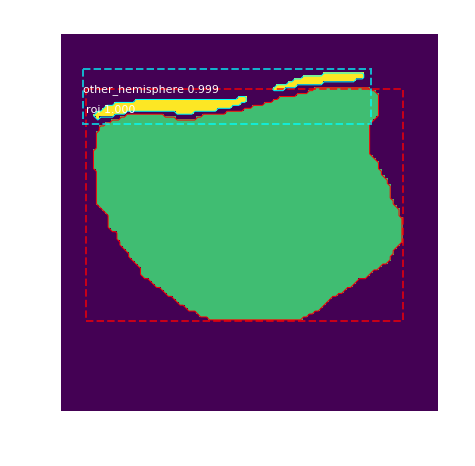

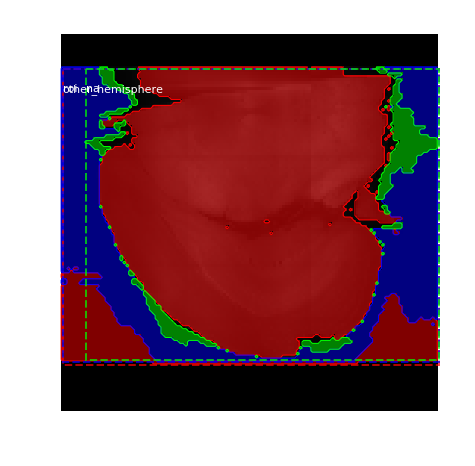

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   78.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -25.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 85%|████████▌ | 344/404 [10:19<01:53,  1.90s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:  108.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  323.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


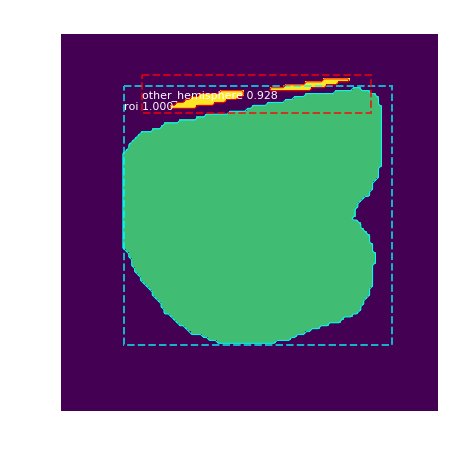

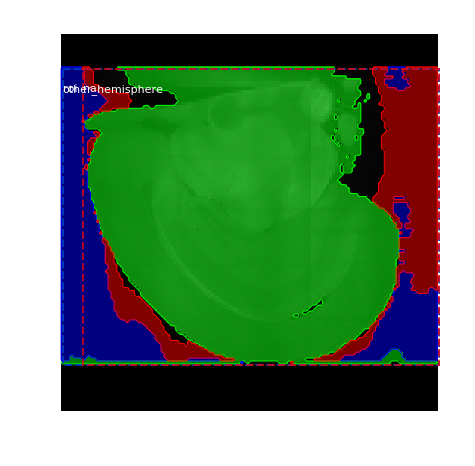

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:  108.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:    4.10000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 85%|████████▌ | 345/404 [10:21<01:53,  1.93s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   58.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


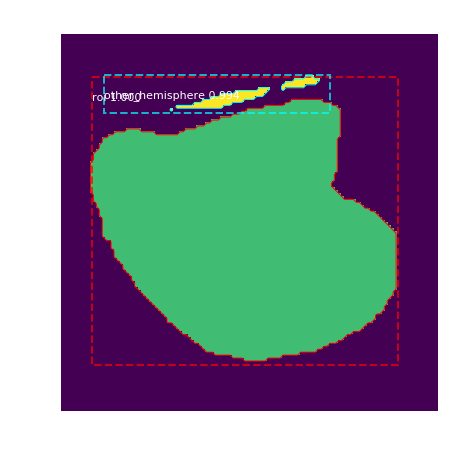

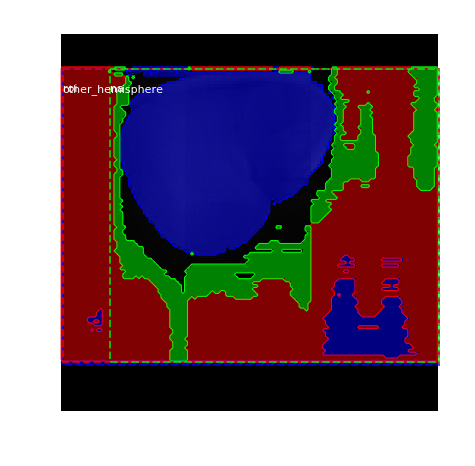

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   58.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -45.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 86%|████████▌ | 346/404 [10:23<01:51,  1.92s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   82.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  363.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


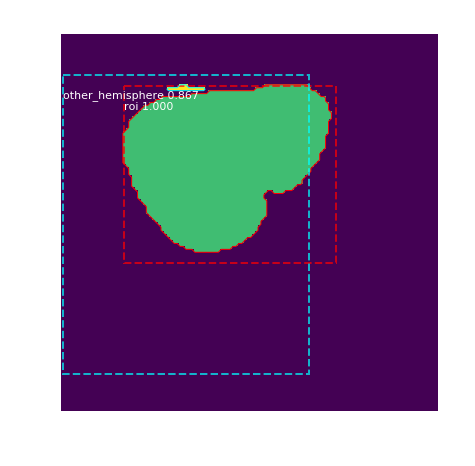

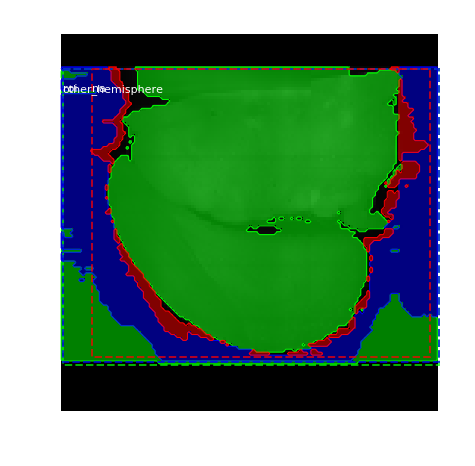

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   82.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -21.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 86%|████████▌ | 347/404 [10:25<01:47,  1.89s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   57.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


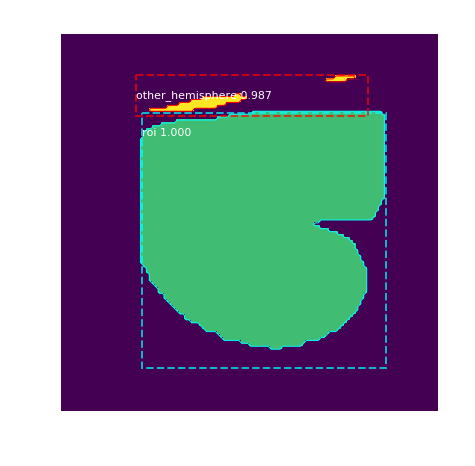

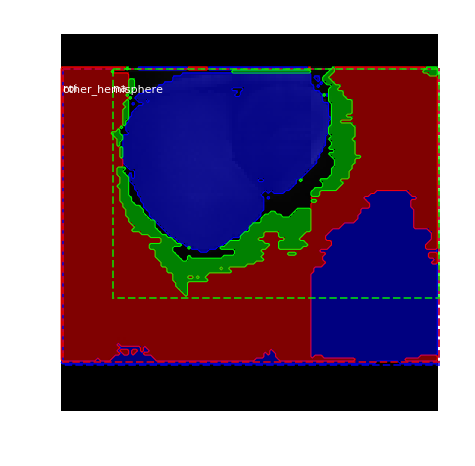

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   57.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -46.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 86%|████████▌ | 348/404 [10:26<01:41,  1.81s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   43.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


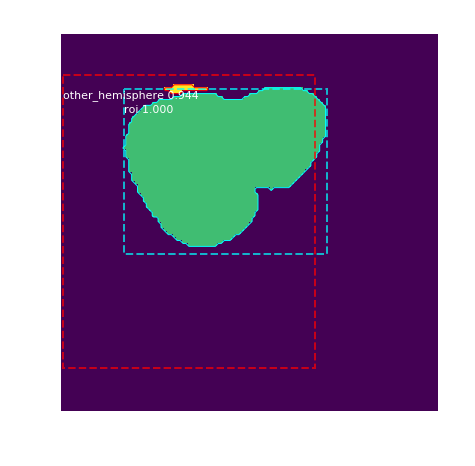

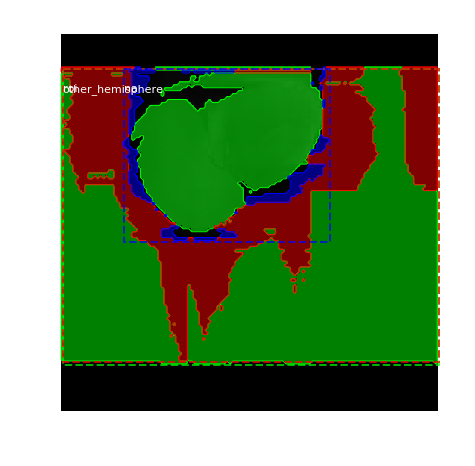

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   43.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -60.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 86%|████████▋ | 349/404 [10:28<01:42,  1.86s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   70.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


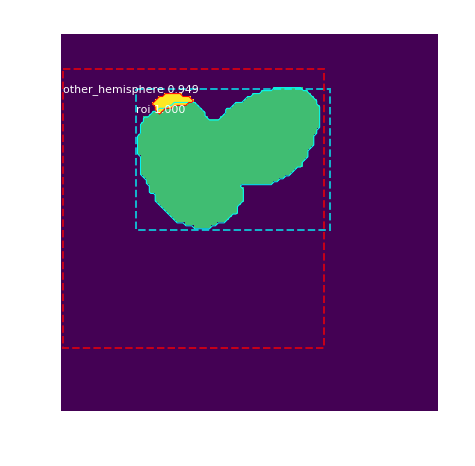

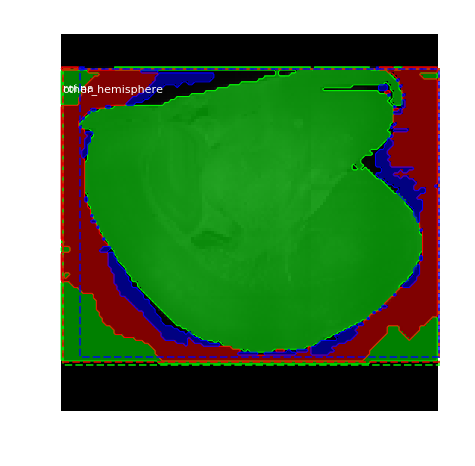

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   70.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -33.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 87%|████████▋ | 350/404 [10:30<01:37,  1.80s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:  133.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


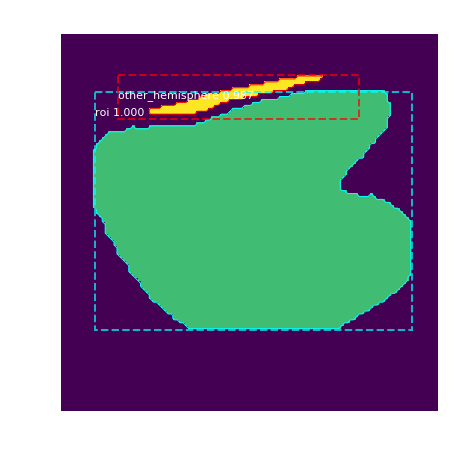

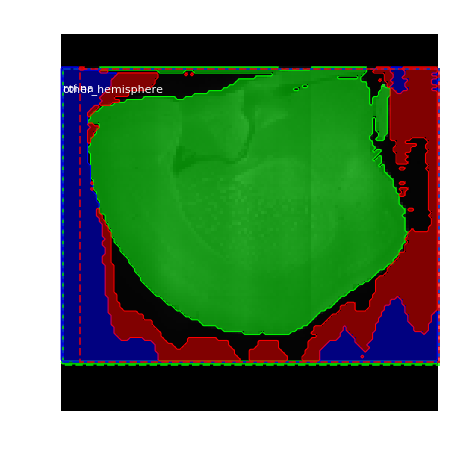

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:  133.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:   29.10000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 87%|████████▋ | 351/404 [10:32<01:39,  1.88s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   67.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


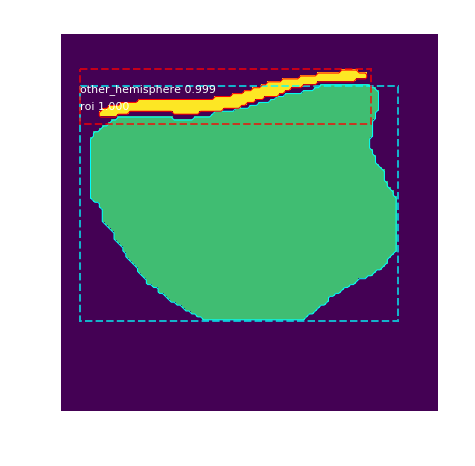

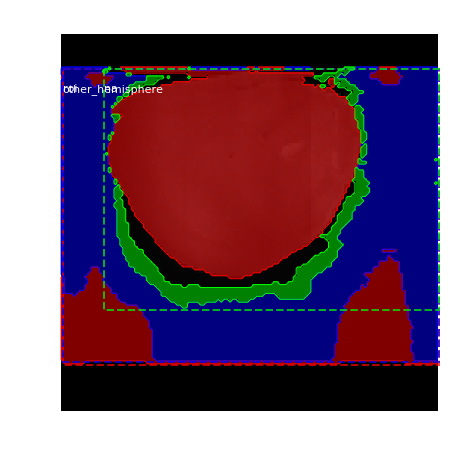

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   67.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -36.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 87%|████████▋ | 352/404 [10:34<01:36,  1.86s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   86.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


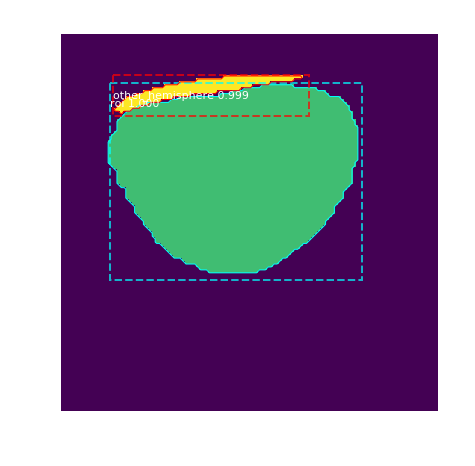

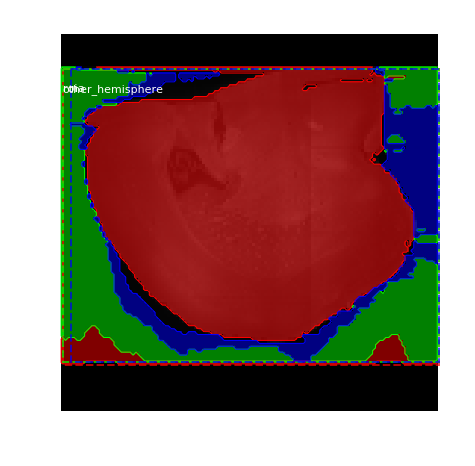

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   86.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -17.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 87%|████████▋ | 353/404 [10:36<01:37,  1.91s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   77.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


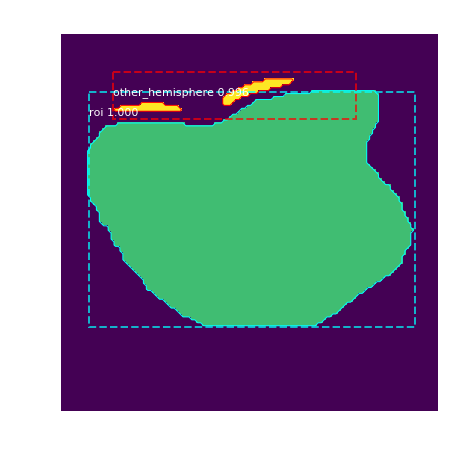

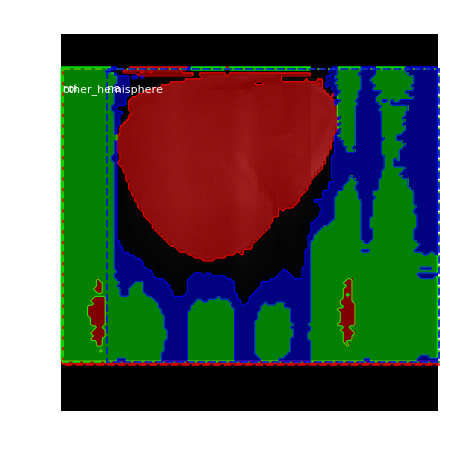

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   77.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -26.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 88%|████████▊ | 354/404 [10:38<01:33,  1.88s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   89.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  379.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


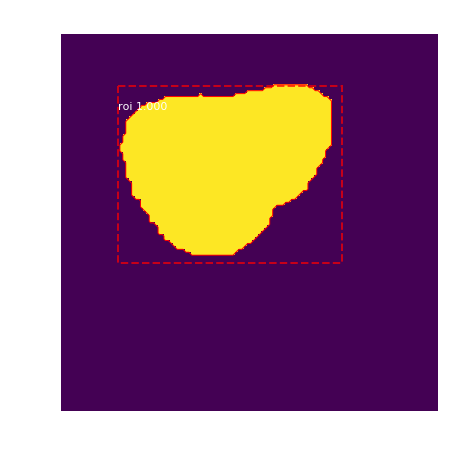

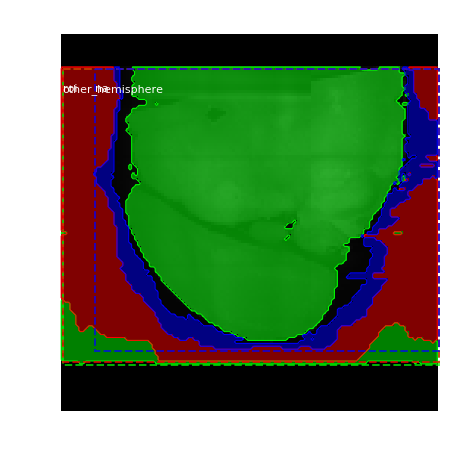

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   89.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -14.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 88%|████████▊ | 355/404 [10:40<01:30,  1.85s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   62.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


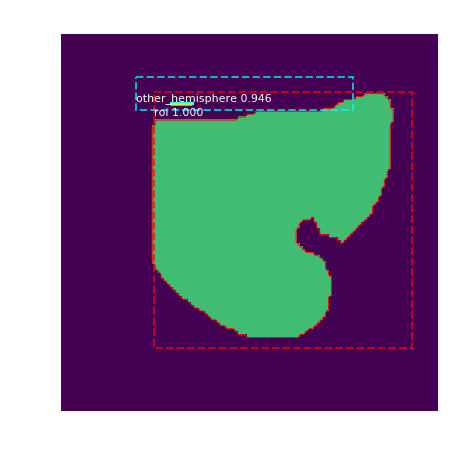

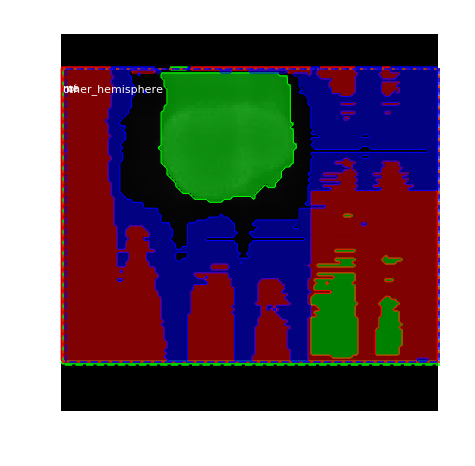

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   62.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -41.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 88%|████████▊ | 356/404 [10:42<01:30,  1.88s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   43.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


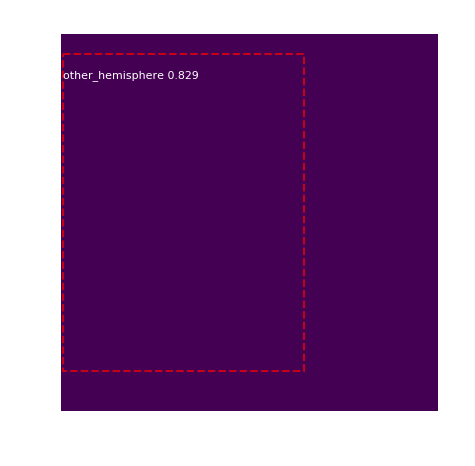

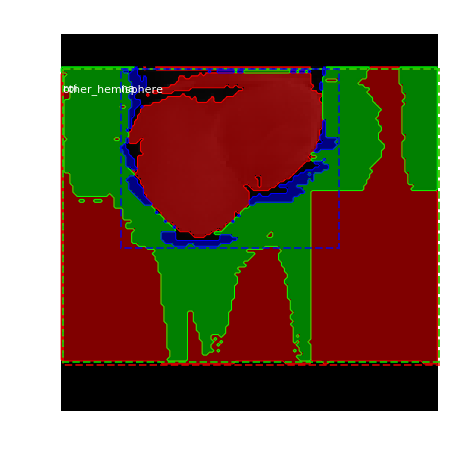

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   43.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -60.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 88%|████████▊ | 357/404 [10:43<01:29,  1.90s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   72.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


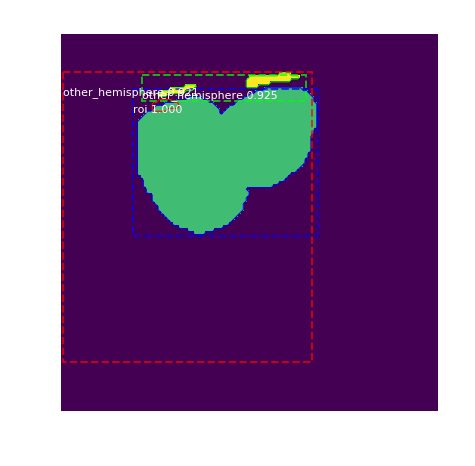

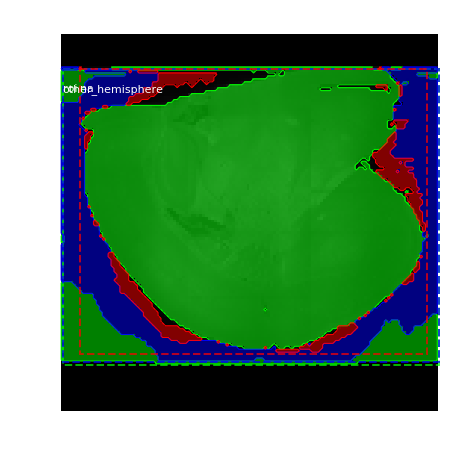

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   72.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -31.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 89%|████████▊ | 358/404 [10:45<01:28,  1.92s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   87.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


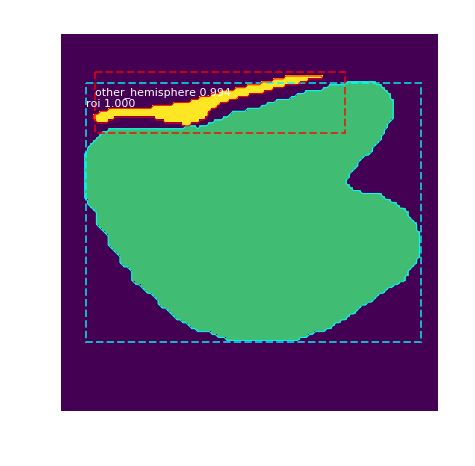

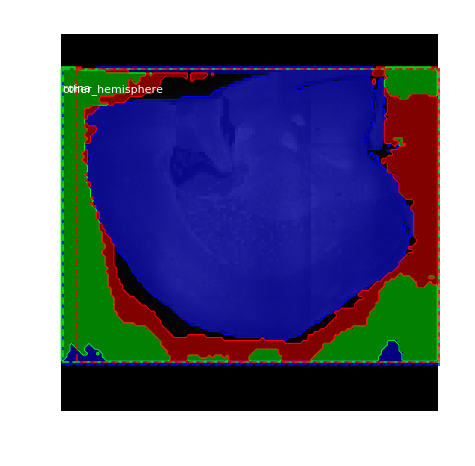

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   87.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -16.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 89%|████████▉ | 359/404 [10:47<01:27,  1.94s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:  108.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


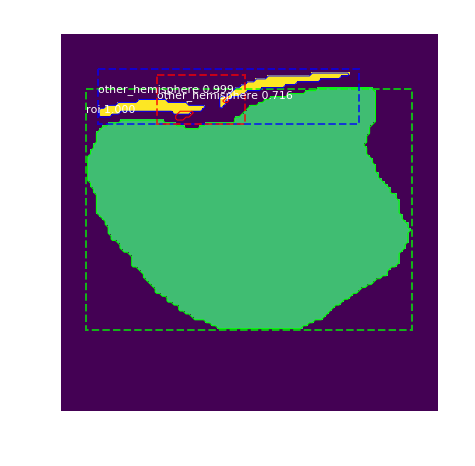

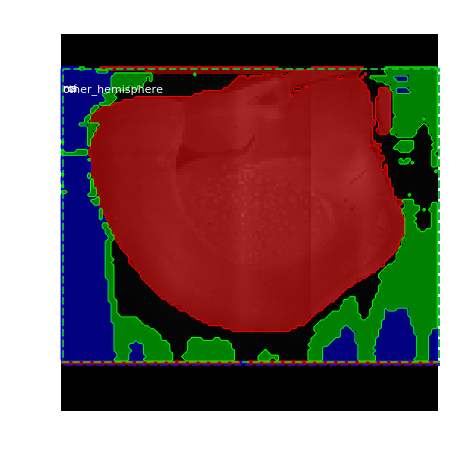

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:  108.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:    4.10000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 89%|████████▉ | 360/404 [10:49<01:22,  1.89s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   72.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


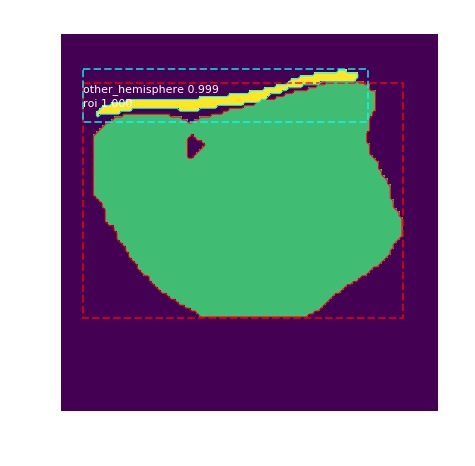

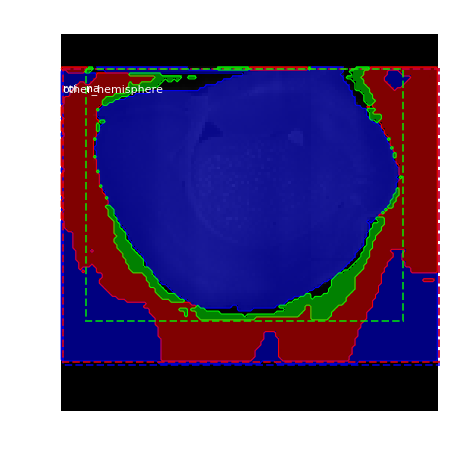

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   72.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -31.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 89%|████████▉ | 361/404 [10:51<01:21,  1.89s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   73.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


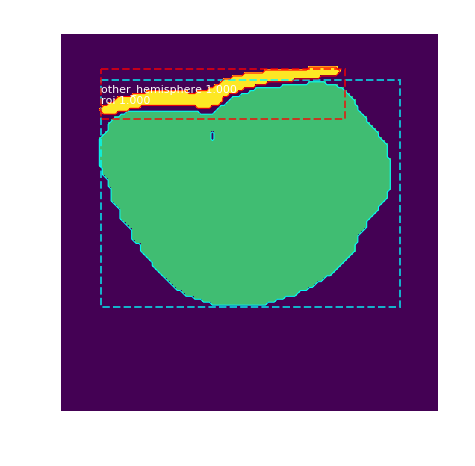

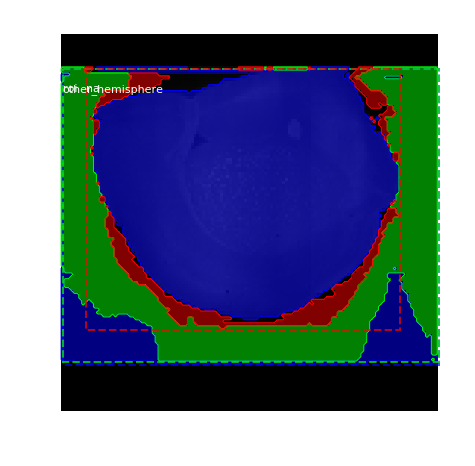

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   73.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -30.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 90%|████████▉ | 362/404 [10:53<01:19,  1.89s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   65.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


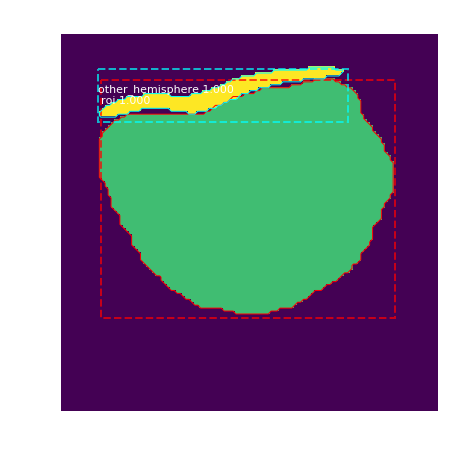

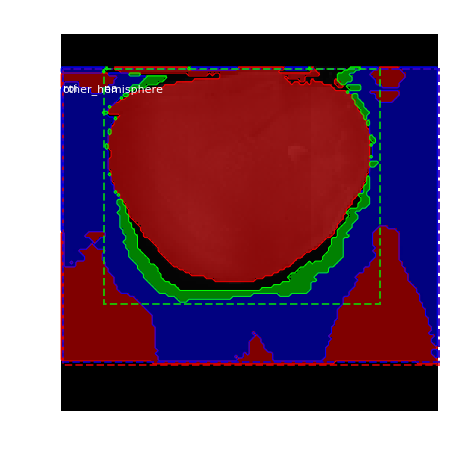

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   65.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -38.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 90%|████████▉ | 363/404 [10:55<01:19,  1.94s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   67.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


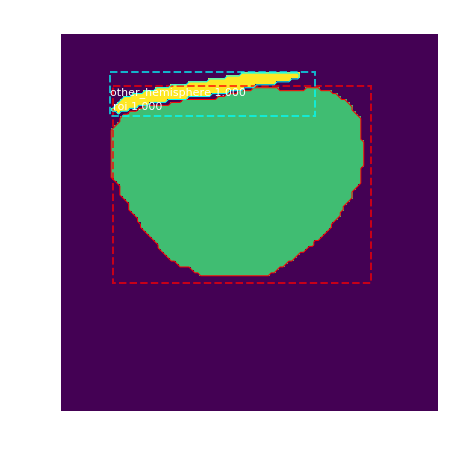

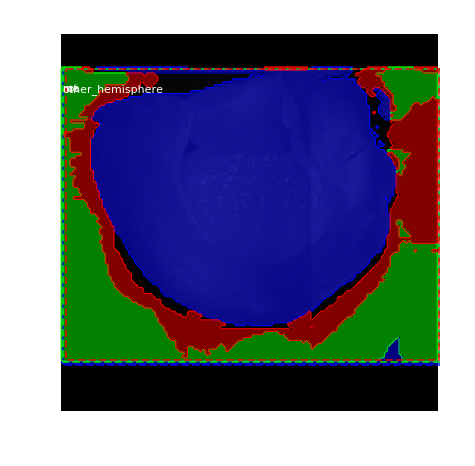

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   67.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -36.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 90%|█████████ | 364/404 [10:57<01:18,  1.95s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   74.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  293.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


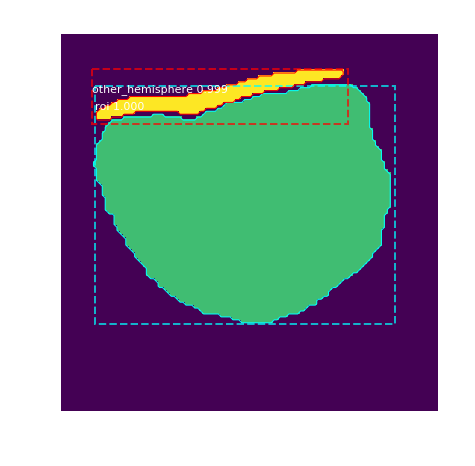

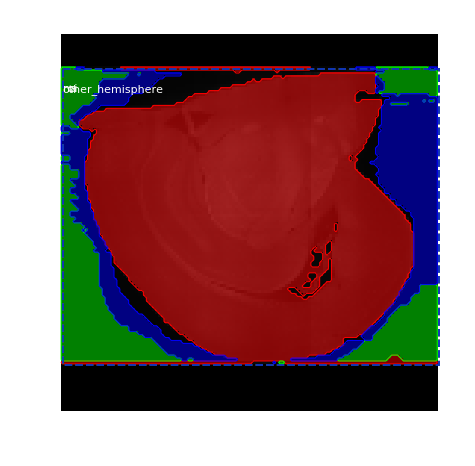

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   74.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -29.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 90%|█████████ | 365/404 [10:59<01:17,  1.99s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   97.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


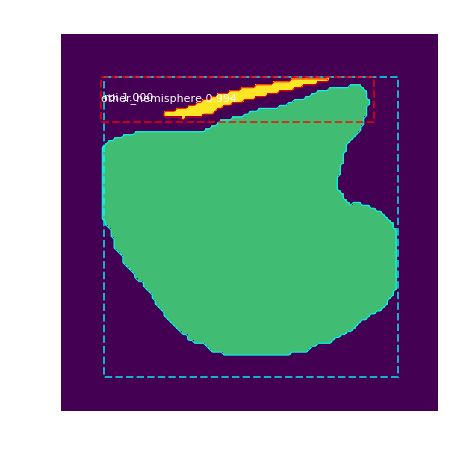

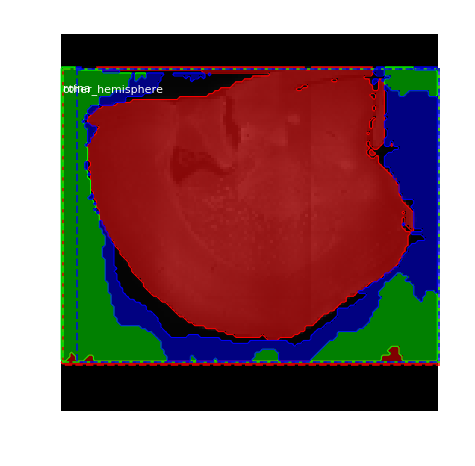

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   97.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:   -6.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 91%|█████████ | 366/404 [11:01<01:15,  1.99s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   83.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


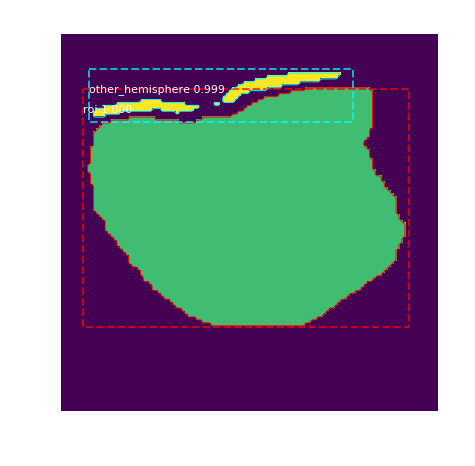

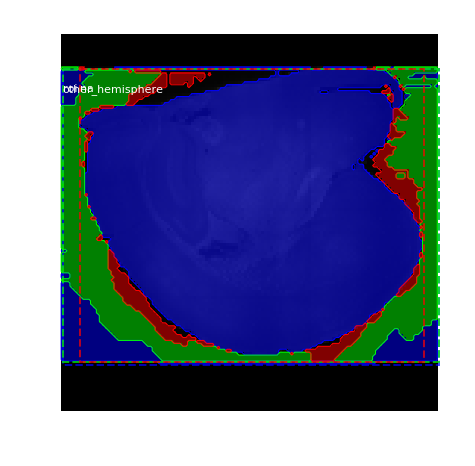

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   83.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -20.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 91%|█████████ | 367/404 [11:03<01:14,  2.02s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   86.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


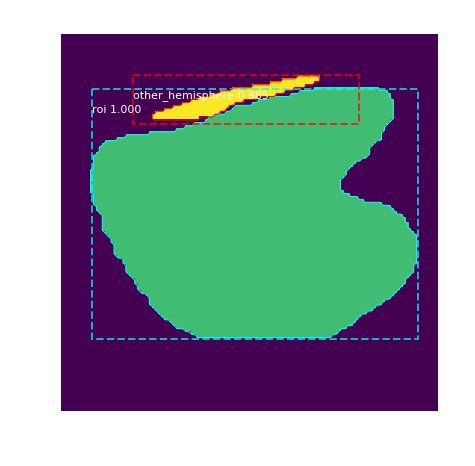

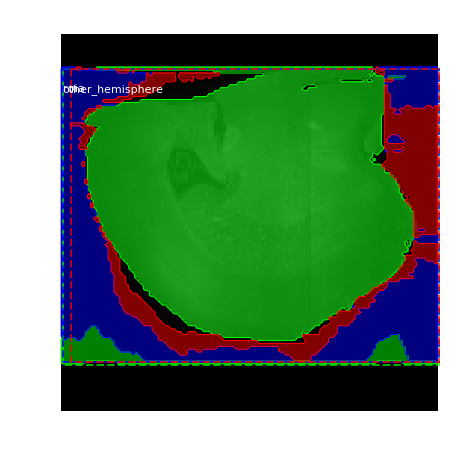

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   86.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -17.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 91%|█████████ | 368/404 [11:05<01:13,  2.04s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:  102.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


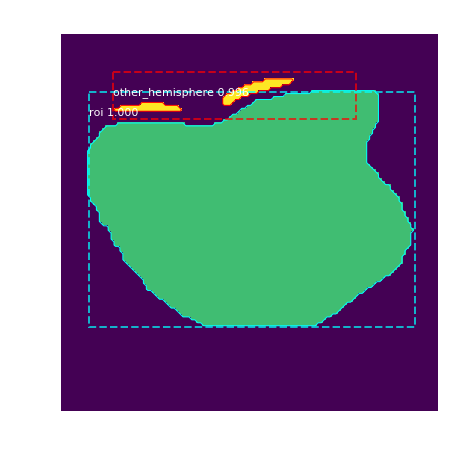

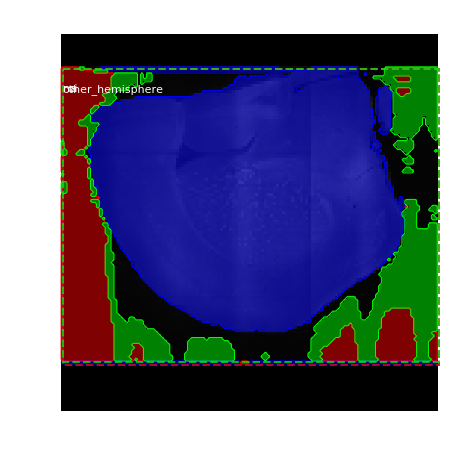

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:  102.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:   -1.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 91%|█████████▏| 369/404 [11:07<01:13,  2.09s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   89.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  378.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


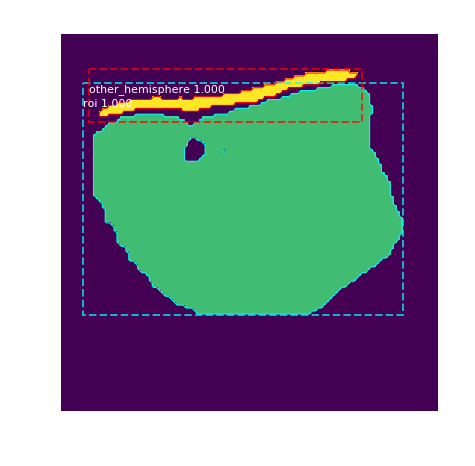

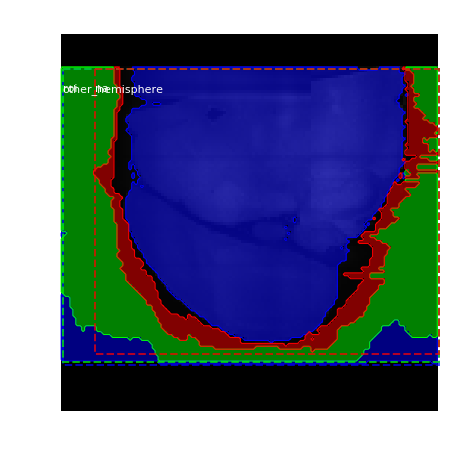

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   89.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -14.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 92%|█████████▏| 370/404 [11:10<01:10,  2.09s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   74.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


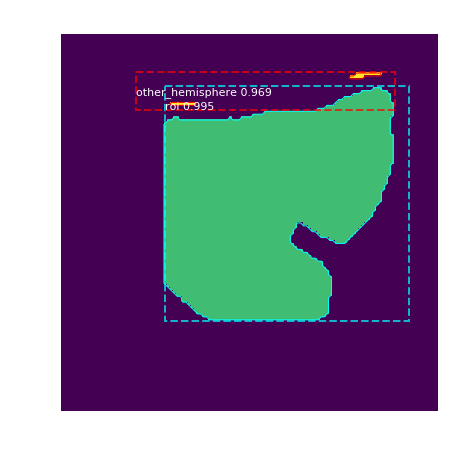

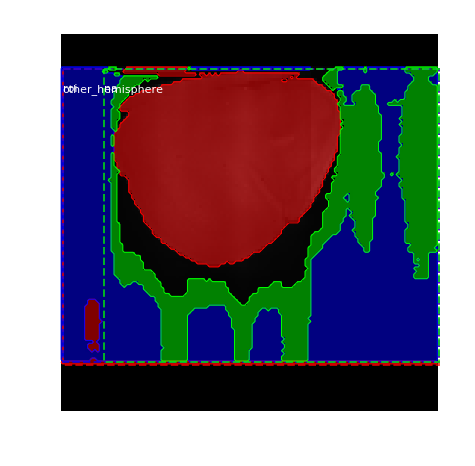

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   74.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -29.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 92%|█████████▏| 371/404 [11:12<01:09,  2.09s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   51.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


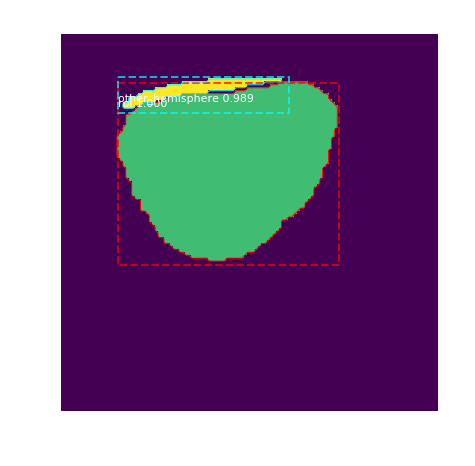

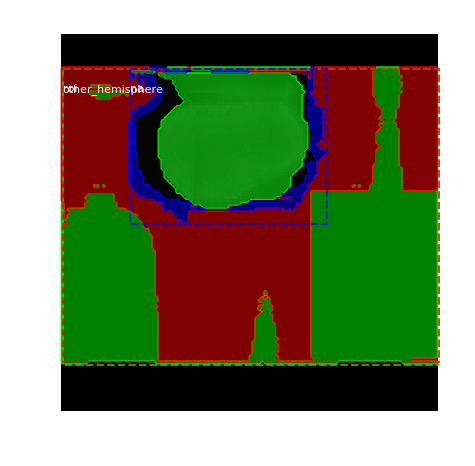

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   51.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -52.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 92%|█████████▏| 372/404 [11:14<01:06,  2.08s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   68.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


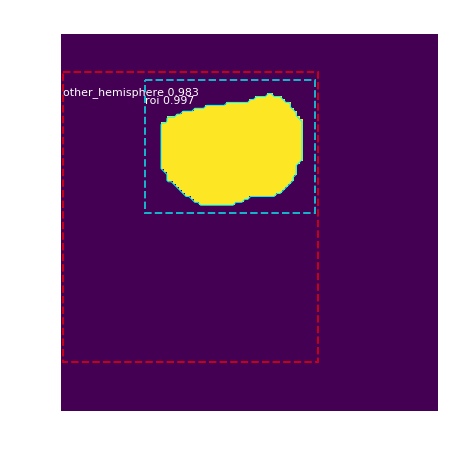

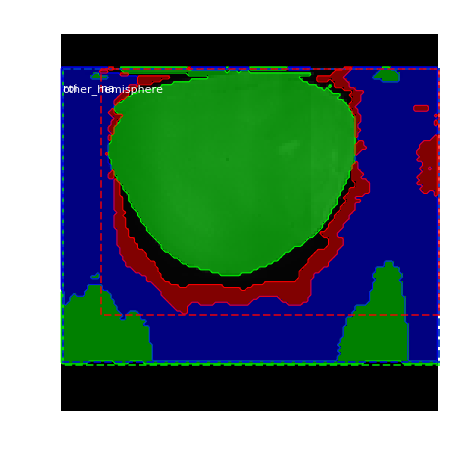

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   68.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -35.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 92%|█████████▏| 373/404 [11:16<01:03,  2.05s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   79.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  357.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


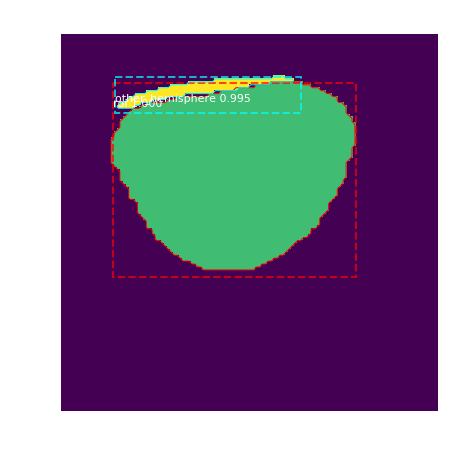

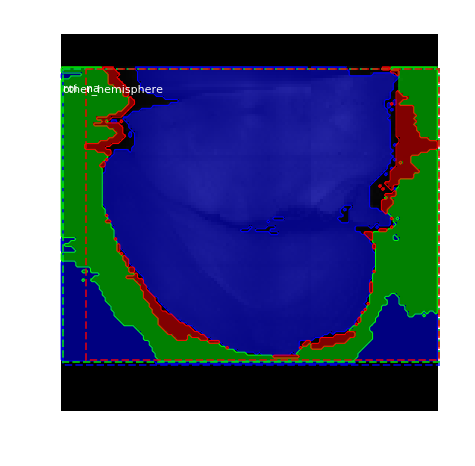

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   79.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -24.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 93%|█████████▎| 374/404 [11:17<00:58,  1.96s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   71.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


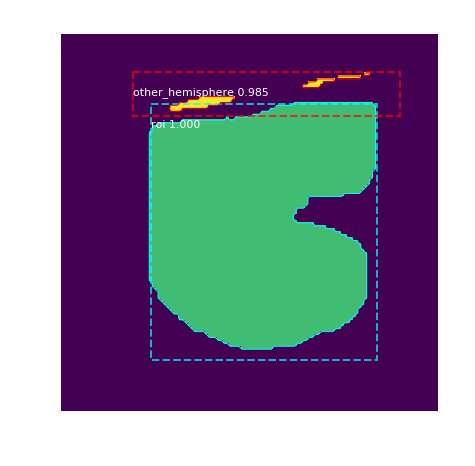

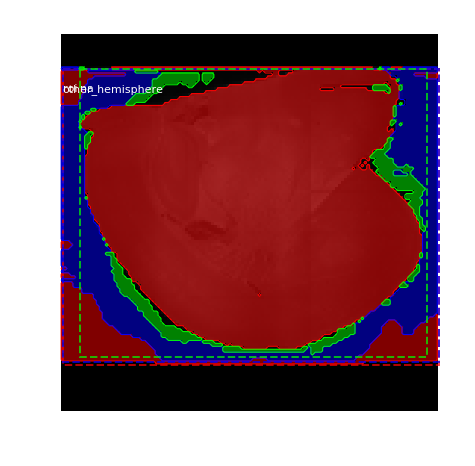

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   71.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -32.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 93%|█████████▎| 375/404 [11:19<00:54,  1.88s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   43.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


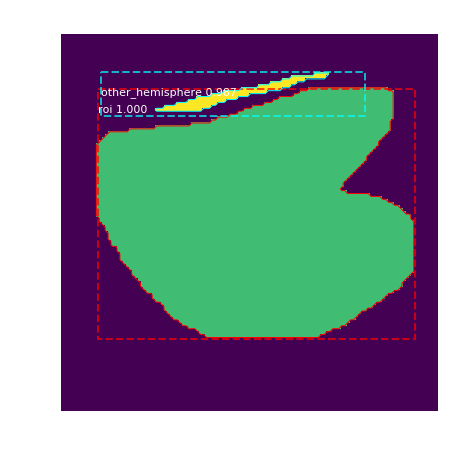

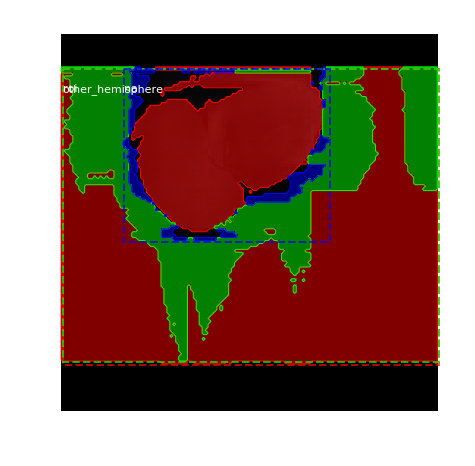

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   43.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -60.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 93%|█████████▎| 376/404 [11:21<00:50,  1.81s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   79.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


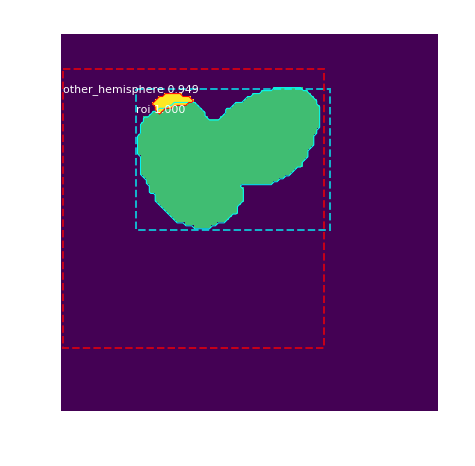

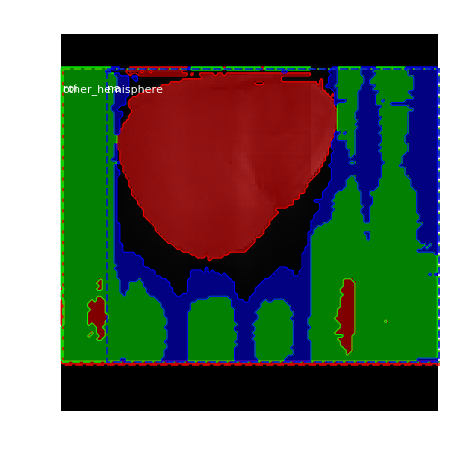

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   79.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -24.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 93%|█████████▎| 377/404 [11:23<00:48,  1.80s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   93.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  398.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


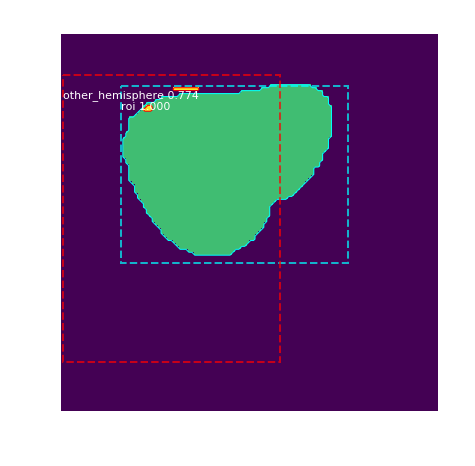

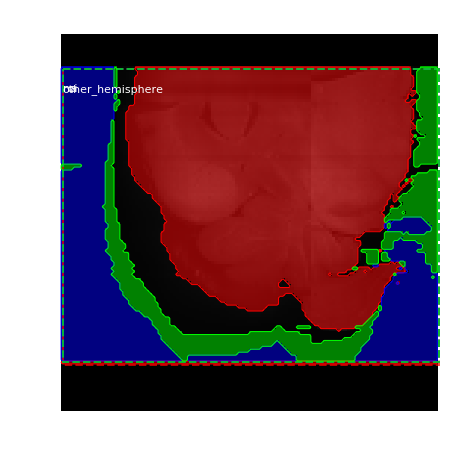

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   93.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -10.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 94%|█████████▎| 378/404 [11:25<00:48,  1.88s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   97.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  394.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


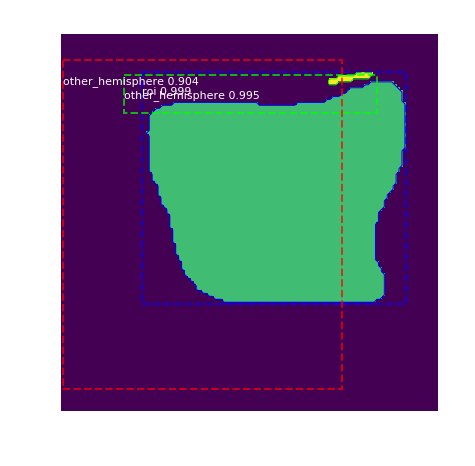

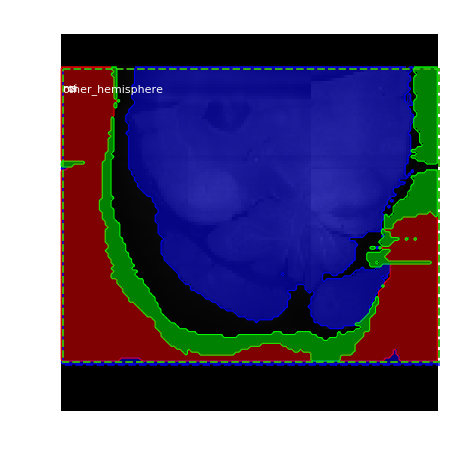

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   97.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:   -6.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 94%|█████████▍| 379/404 [11:27<00:48,  1.94s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   68.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


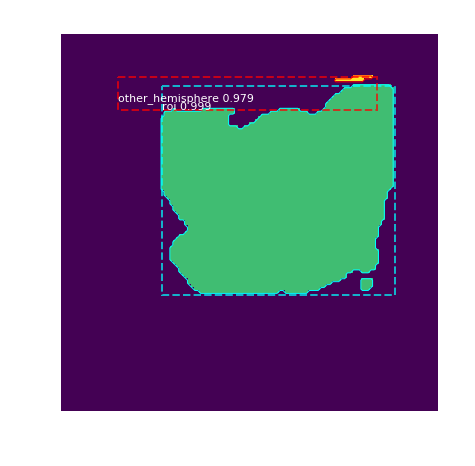

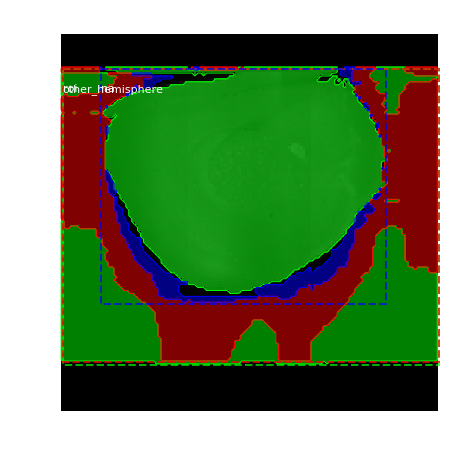

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   68.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -35.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 94%|█████████▍| 380/404 [11:29<00:46,  1.95s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   79.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  356.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


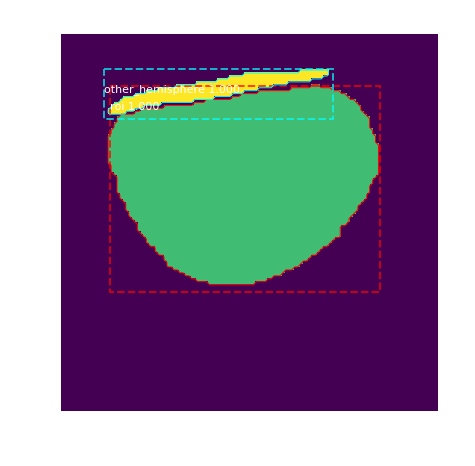

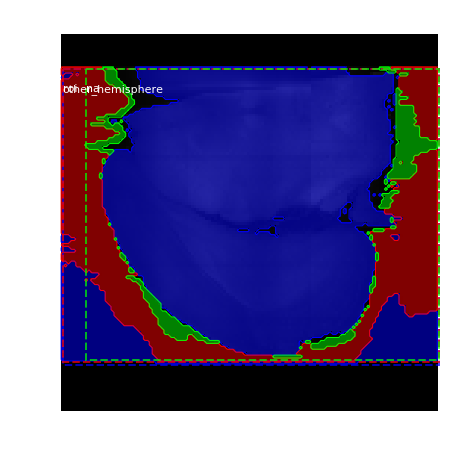

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   79.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -24.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 94%|█████████▍| 381/404 [11:31<00:46,  2.00s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   74.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  366.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


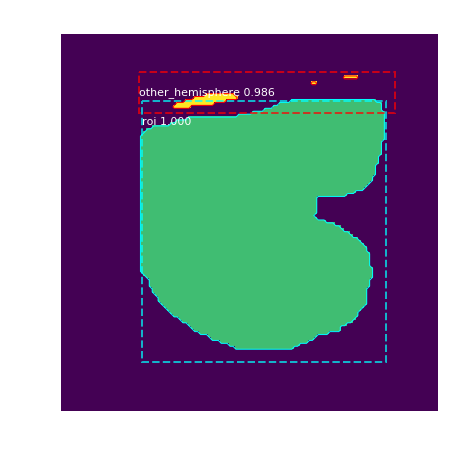

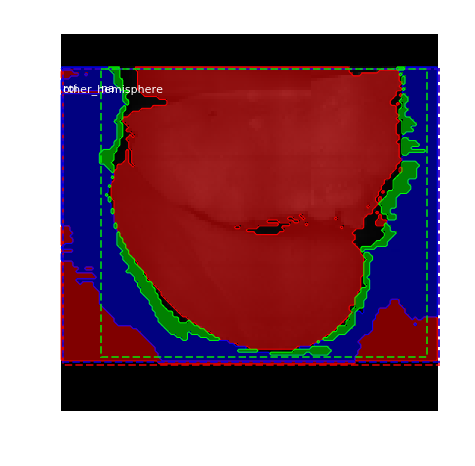

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   74.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -29.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 95%|█████████▍| 382/404 [11:33<00:44,  2.02s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   74.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


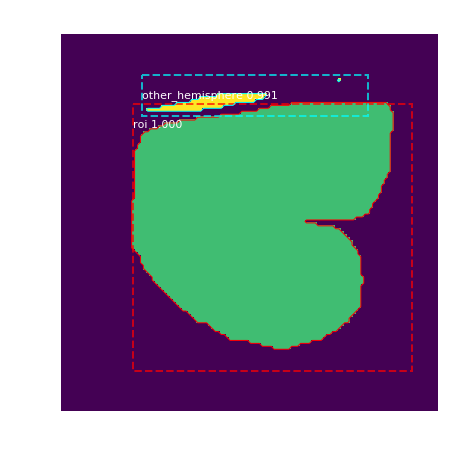

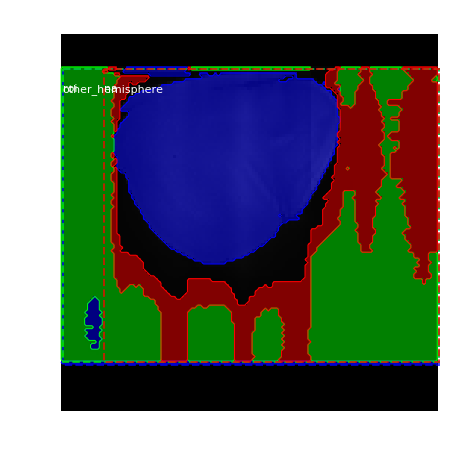

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   74.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -29.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 95%|█████████▍| 383/404 [11:35<00:42,  2.02s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   92.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  328.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


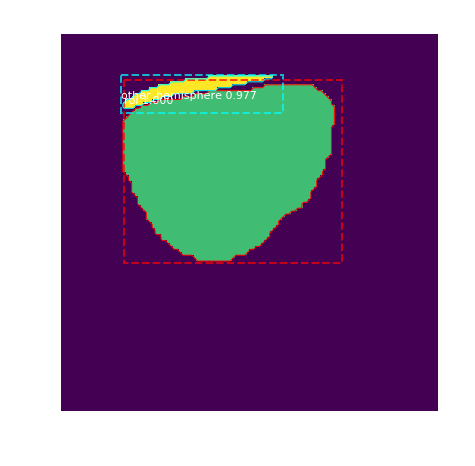

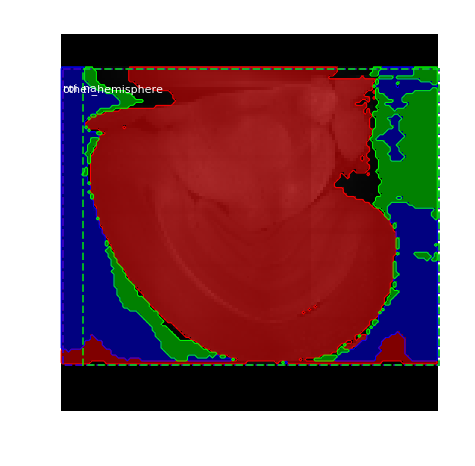

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   92.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -11.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 95%|█████████▌| 384/404 [11:37<00:42,  2.12s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   72.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


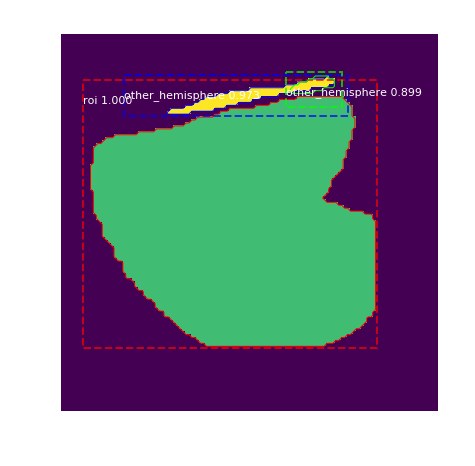

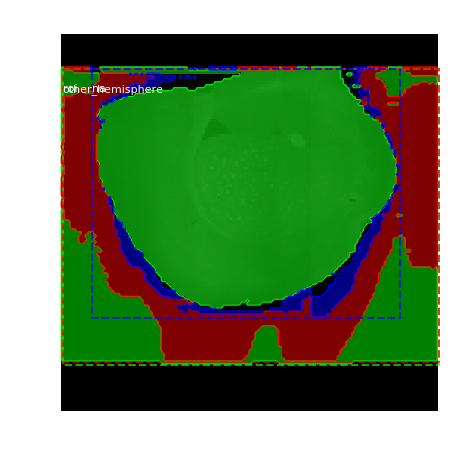

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   72.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -31.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 95%|█████████▌| 385/404 [11:39<00:39,  2.06s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   76.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


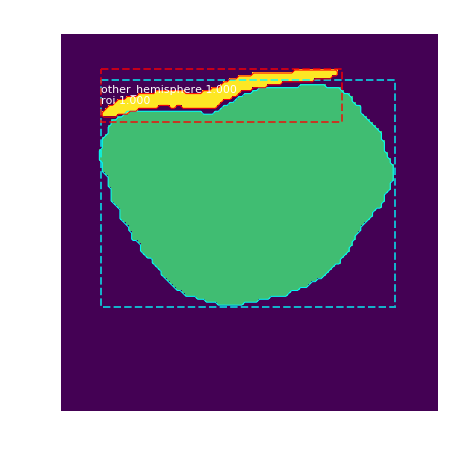

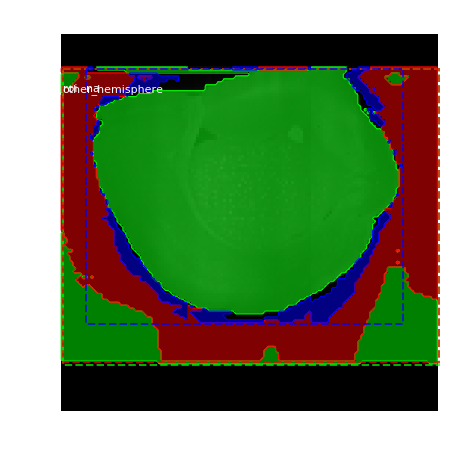

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   76.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -27.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 96%|█████████▌| 386/404 [11:41<00:35,  1.95s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   55.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


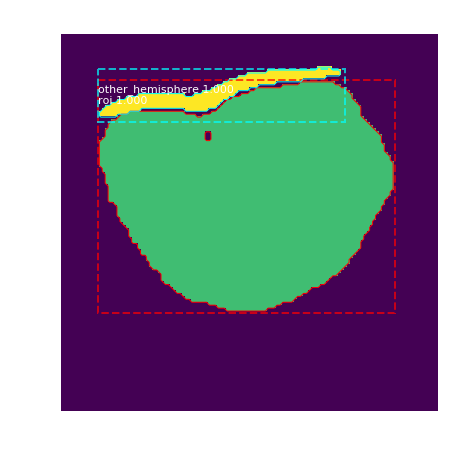

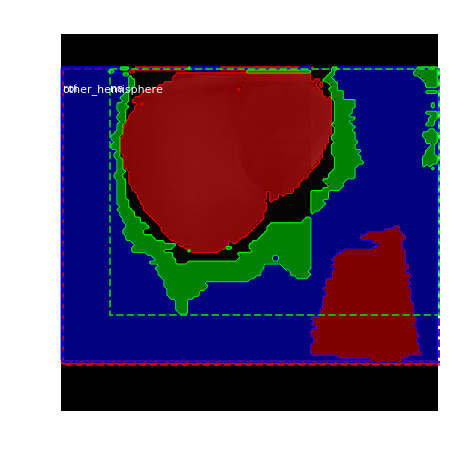

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   55.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -48.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 96%|█████████▌| 387/404 [11:43<00:32,  1.90s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   74.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


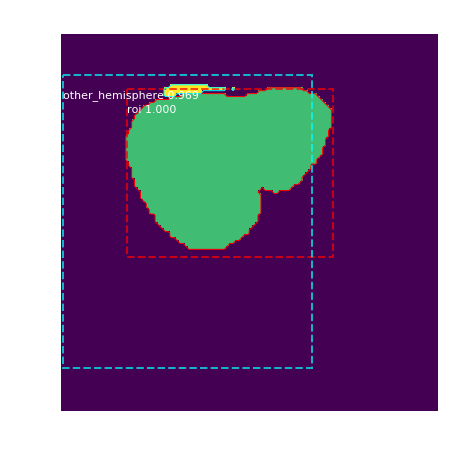

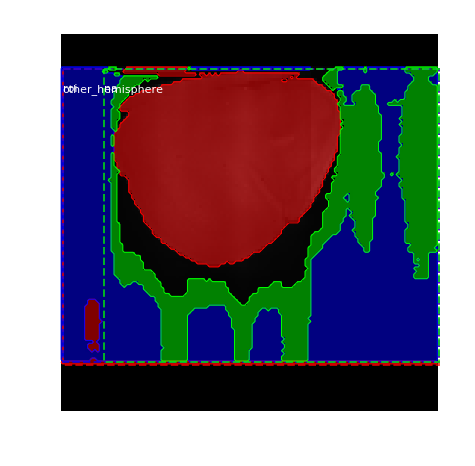

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   74.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -29.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 96%|█████████▌| 388/404 [11:44<00:29,  1.87s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   70.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  301.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


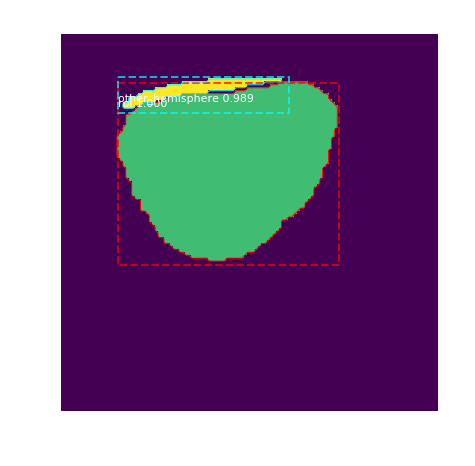

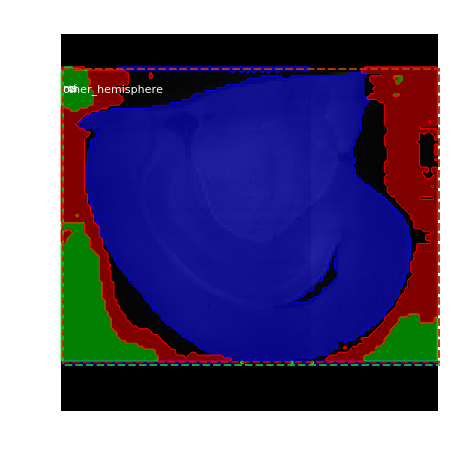

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   70.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -33.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 96%|█████████▋| 389/404 [11:46<00:27,  1.82s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   52.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


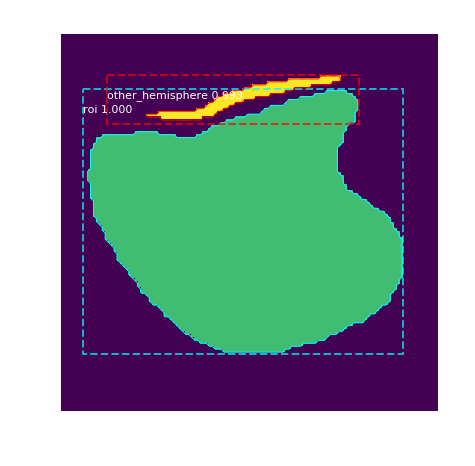

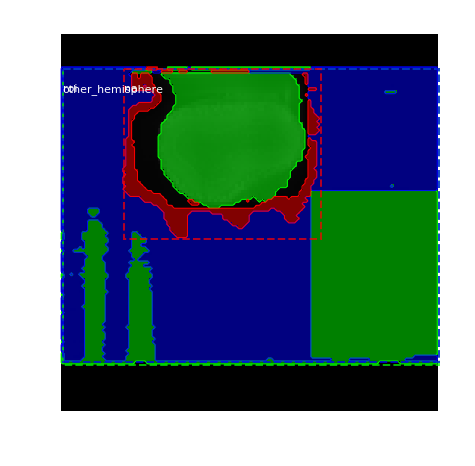

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   52.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -51.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 97%|█████████▋| 390/404 [11:48<00:26,  1.90s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   85.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  332.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


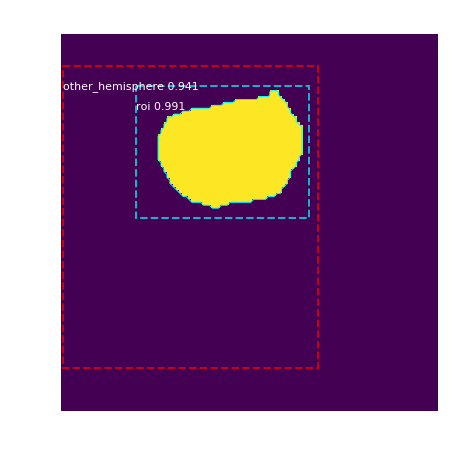

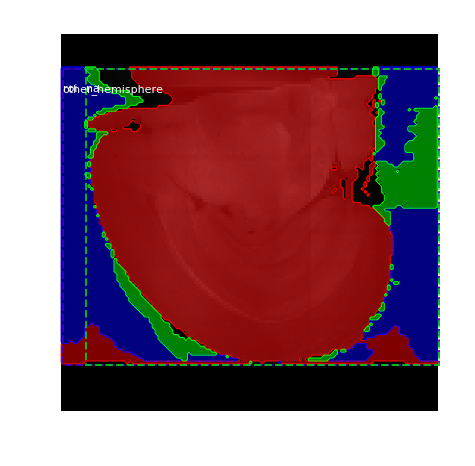

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   85.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -18.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 97%|█████████▋| 391/404 [11:50<00:25,  1.93s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   77.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


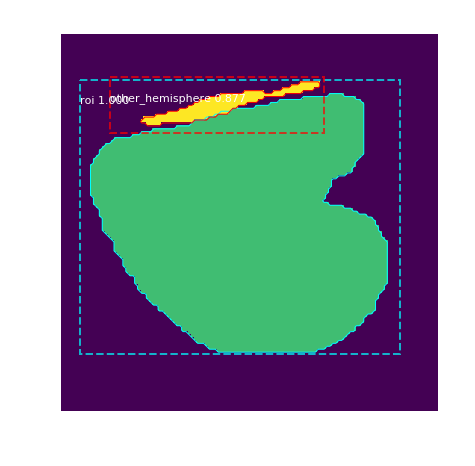

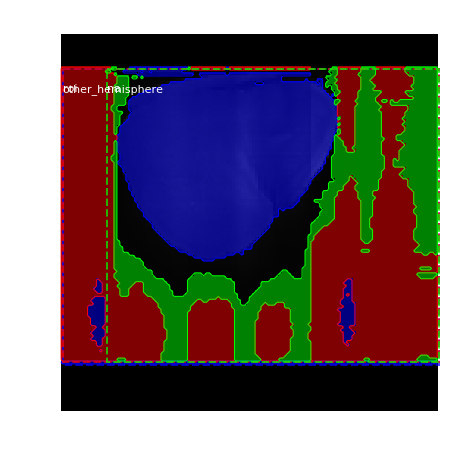

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   77.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -26.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 97%|█████████▋| 392/404 [11:52<00:22,  1.87s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   87.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  329.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


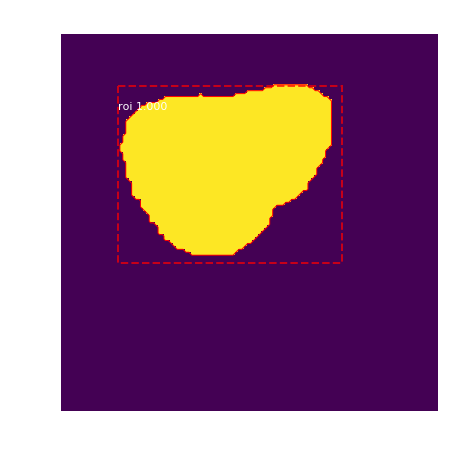

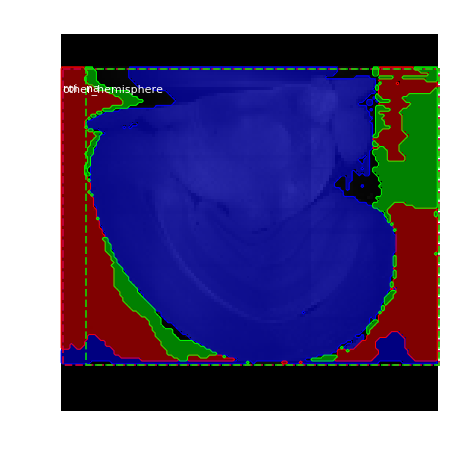

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   87.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -16.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 97%|█████████▋| 393/404 [11:54<00:20,  1.87s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   58.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


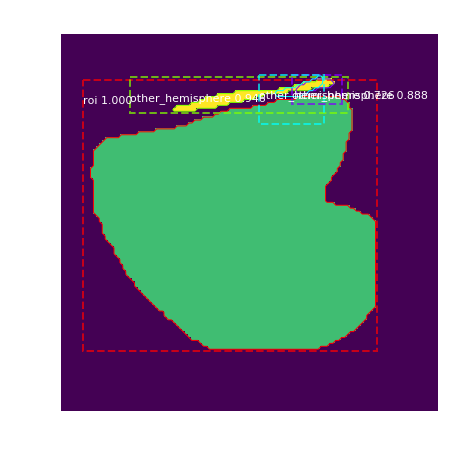

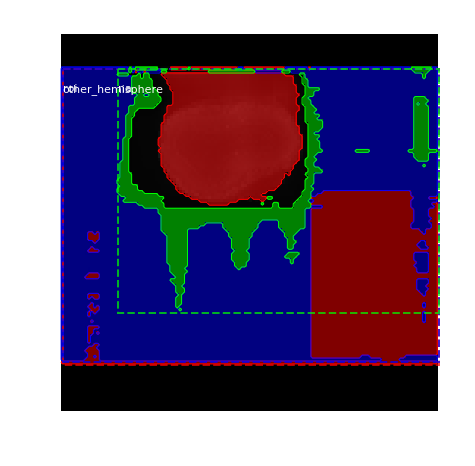

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   58.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -45.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 98%|█████████▊| 394/404 [11:55<00:18,  1.82s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   46.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


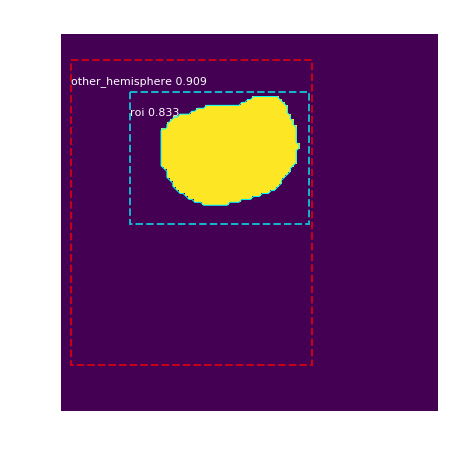

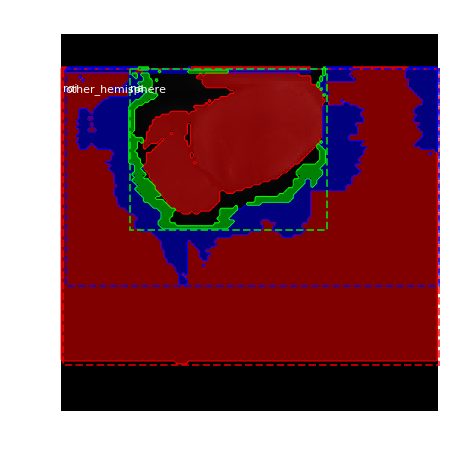

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   46.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -57.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 98%|█████████▊| 395/404 [11:57<00:16,  1.83s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   44.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


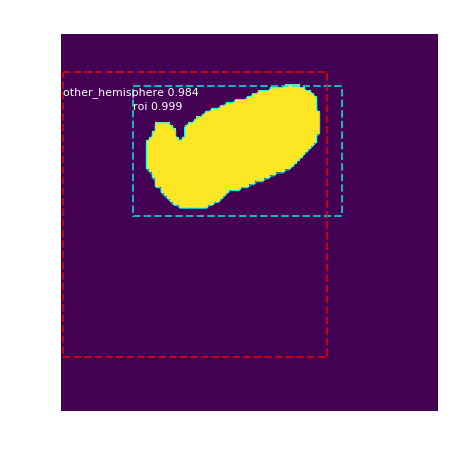

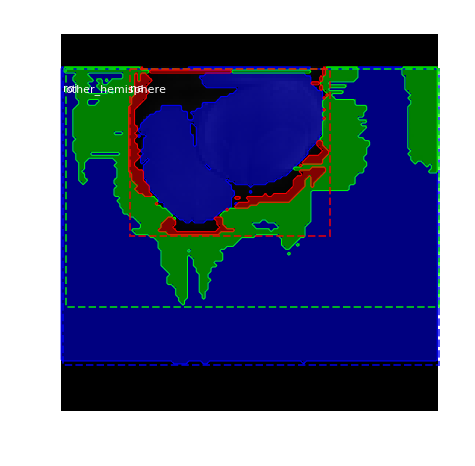

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   44.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -59.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 98%|█████████▊| 396/404 [11:59<00:14,  1.85s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   45.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


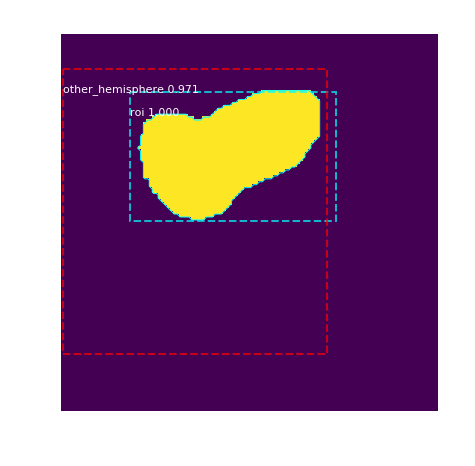

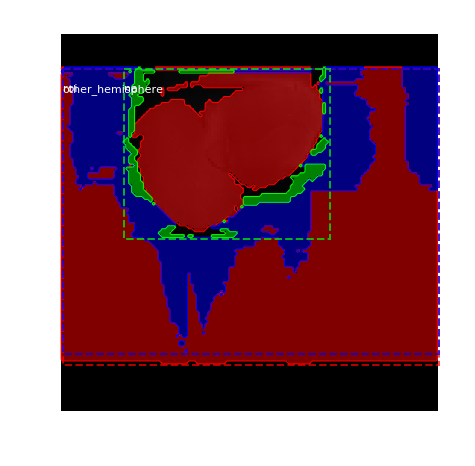

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   45.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -58.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 98%|█████████▊| 397/404 [12:01<00:13,  1.87s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   55.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


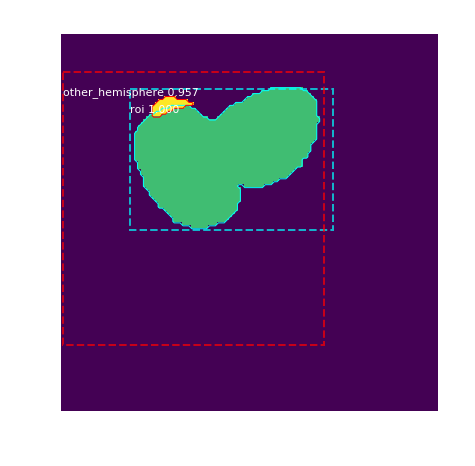

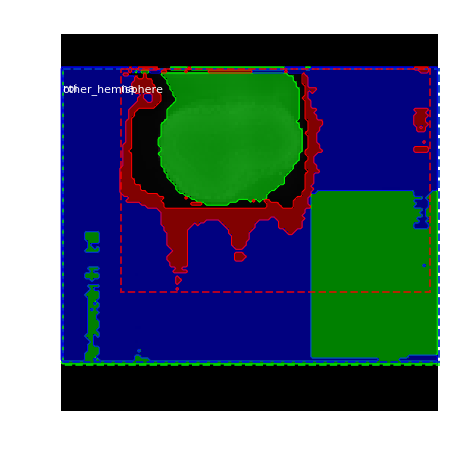

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   55.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -48.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 99%|█████████▊| 398/404 [12:03<00:11,  1.86s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   65.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


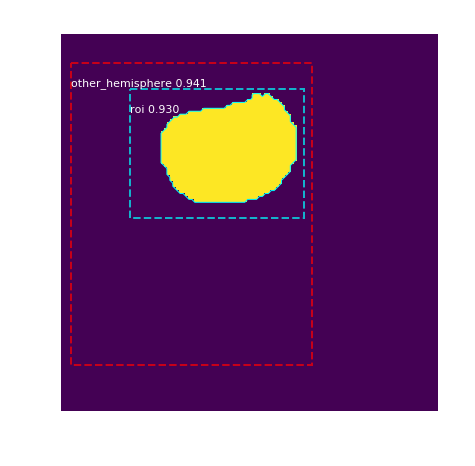

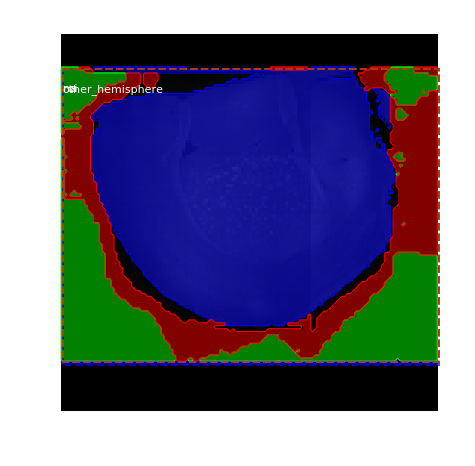

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   65.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -38.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 99%|█████████▉| 399/404 [12:05<00:10,  2.06s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   73.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  291.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


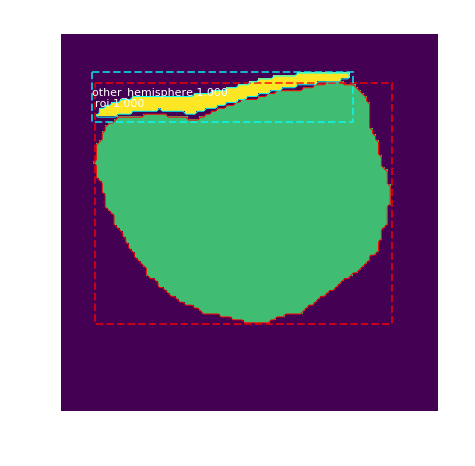

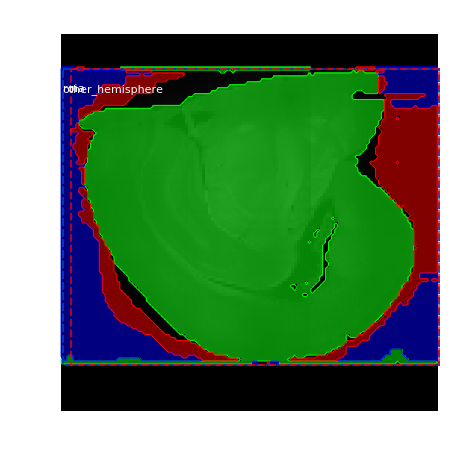

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   73.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -30.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 99%|█████████▉| 400/404 [12:07<00:08,  2.02s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   73.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


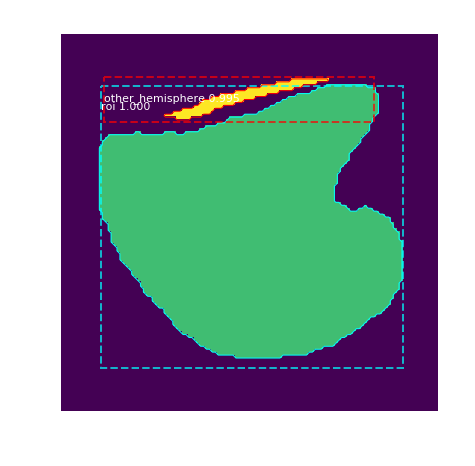

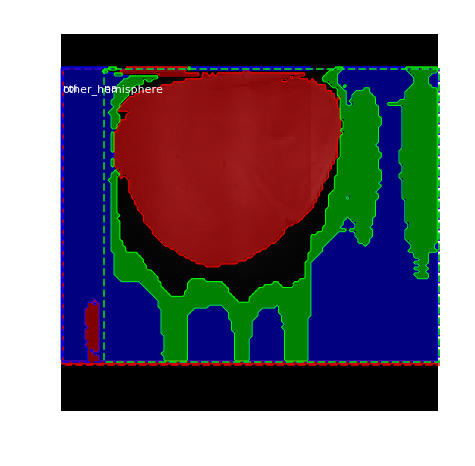

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   73.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -30.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


 99%|█████████▉| 401/404 [12:09<00:05,  1.97s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   83.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  359.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


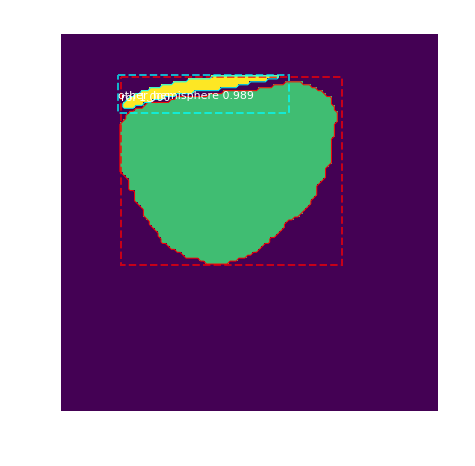

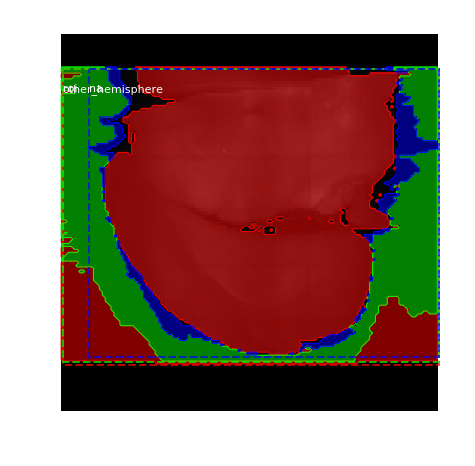

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   83.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -20.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


100%|█████████▉| 402/404 [12:11<00:03,  1.90s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   48.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


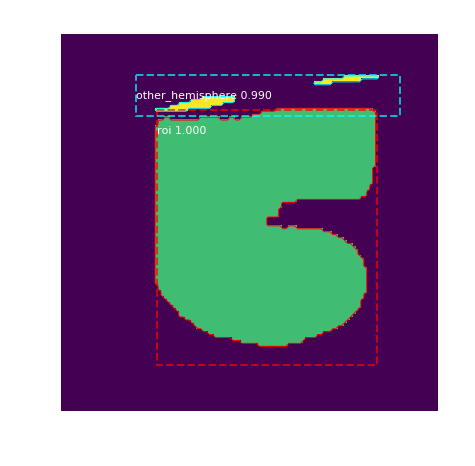

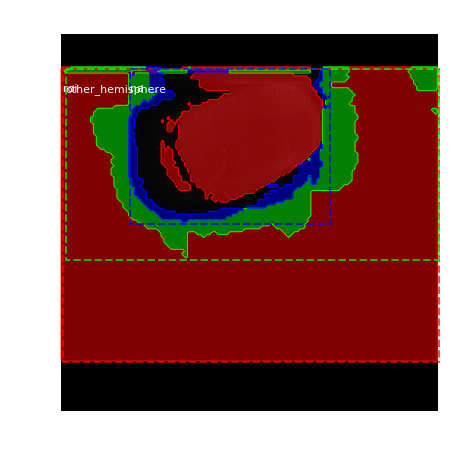

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   48.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -55.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


100%|█████████▉| 403/404 [12:13<00:01,  1.86s/it]

original_image           shape: (128, 128, 3)         min:    0.00000  max:   70.00000  uint8
image_meta               shape: (16,)                 min:    0.00000  max:  280.00000  float64
gt_class_id              shape: (3,)                  min:    1.00000  max:    3.00000  int32
gt_bbox                  shape: (3, 4)                min:    0.00000  max:  128.00000  int32
gt_mask                  shape: (128, 128, 3)         min:    0.00000  max:    1.00000  bool


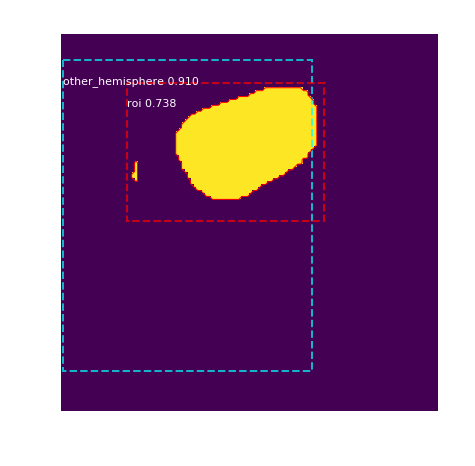

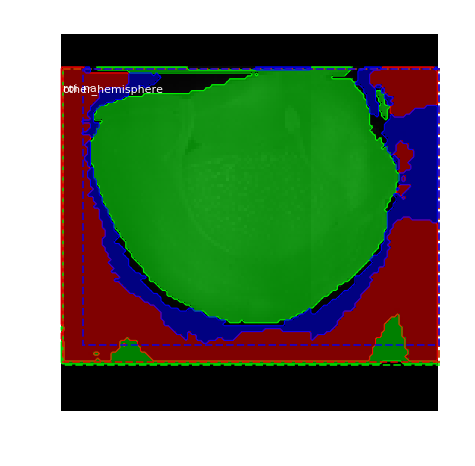

Processing 1 images
image                    shape: (128, 128, 3)         min:    0.00000  max:   70.00000  uint8
molded_images            shape: (1, 128, 128, 3)      min: -123.70000  max:  -33.90000  float64
image_metas              shape: (1, 16)               min:    0.00000  max:  128.00000  int64
anchors                  shape: (1, 4092, 4)          min:   -0.71267  max:    1.20874  float32


100%|██████████| 404/404 [12:15<00:00,  1.87s/it]


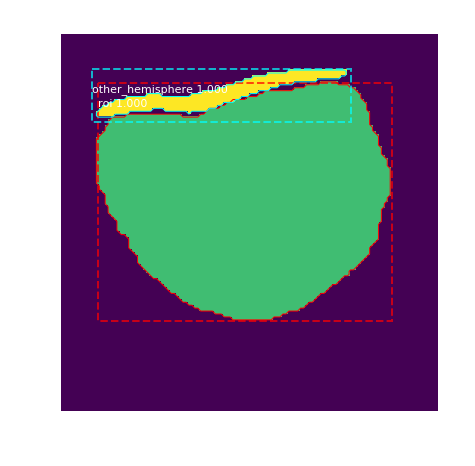

In [21]:
### teraz czas przewidziec na 00014
# Test on a random image
import nibabel as nib
for image_id in tqdm(sorted(dataset_val_14.image_ids):
    image_id = random.choice(dataset_val_14.image_ids)
    original_image, image_meta, gt_class_id, gt_bbox, gt_mask =\
    modellib.load_image_gt(dataset_val_14, inference_config, 
                           image_id, use_mini_mask=False)
    log("original_image", original_image)
    log("image_meta", image_meta)
    log("gt_class_id", gt_class_id)
    log("gt_bbox", gt_bbox)
    log("gt_mask", gt_mask)
    visualize.display_instances(original_image, gt_bbox, gt_mask, gt_class_id, 
                            dataset_train.class_names, figsize=(8, 8))
    results = model.detect([original_image], verbose=1)
    r = results[0]
    visualize.display_instances(original_image, r['rois'], r['masks'], r['class_ids'], 
                            dataset_val_14.class_names, r['scores'], ax=get_ax())
    #print(r['masks'][:,:,1])
    plt.imshow(original_image)
    img = nib.load('../../../../000014_package/000014_001_uc.nii.gz')
    data = img.get_fdata()
    original_image.shape
    x = np.zeros((original_image.shape[0],original_image.shape[1]))
    x[r['masks'][:,:,0]] = 177
    if r['masks'].shape[2] >=2:
        x[r['masks'][:,:,1]] = 255
    cv2.imwrite('%d.png' %image_id, x)
    plt.imshow(x)
    

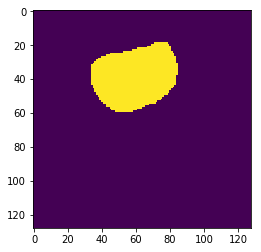

{{plt.imshow(data[:,148,:])}}

In [ ]:
original_image

## Evaluation

In [24]:
# Compute VOC-Style mAP @ IoU=0.5
# Running on 10 images. Increase for better accuracy.
image_ids = np.random.choice(dataset_val.image_ids, 10)
APs = []
for image_id in image_ids:
    # Load image and ground truth data
    image, image_meta, gt_class_id, gt_bbox, gt_mask =\
        modellib.load_image_gt(dataset_val, inference_config,
                               image_id, use_mini_mask=False)
    molded_images = np.expand_dims(modellib.mold_image(image, inference_config), 0)
    # Run object detection
    results = model.detect([image], verbose=0)
    r = results[0]
    # Compute AP
    AP, precisions, recalls, overlaps =\
        utils.compute_ap(gt_bbox, gt_class_id, gt_mask,
                         r["rois"], r["class_ids"], r["scores"], r['masks'])
    APs.append(AP)
    
print("mAP: ", np.mean(APs))

/mnt/sdb1/neuroinf/mask_rcnn_fork/Mask_RCNN/mrcnn/utils.py:733: RuntimeWarning: invalid value encountered in true_divide
  recalls = np.cumsum(pred_match > -1).astype(np.float32) / len(gt_match)
/mnt/sdb1/neuroinf/mask_rcnn_fork/Mask_RCNN/mrcnn/utils.py:733: RuntimeWarning: invalid value encountered in true_divide
  recalls = np.cumsum(pred_match > -1).astype(np.float32) / len(gt_match)


mAP:  nan
